# Importing Libraries

In [1]:
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
import os
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
import torch
import torch.nn as nn
from huggingface_hub import HfApi, HfFolder, Repository
import json 
from torch.optim.lr_scheduler import StepLR
from tqdm.notebook import tqdm

# Data Loading

In [2]:
def loading_dataset_train(path1, path2):
    
    high = []
    low = []
    
    for sub_folder in ["high", "low"]:
        sub_path = os.path.join(path1, sub_folder)
        for file in os.listdir(sub_path):
            img_path = os.path.join(sub_path, file)
            img = Image.open(img_path)
            img = img.resize((256, 256))
            img_np = np.array(img)
            if(sub_folder == "high"):
                high.append(img_np)
            else:
                low.append(img_np)
                
    noisy_images_path = []
    gt_images_path = []
    
    instances_path = os.path.join(path2, "Scene_Instances.txt")
    with open(instances_path) as f:
        instances = f.read()
    
    instances = instances.split('\n')
    for f in instances:
        images_path = os.path.join(path2, "Data")
        images_path = os.path.join(images_path, f)

        for g in os.listdir(images_path):
            image_path = os.path.join(images_path, g)

            if 'NOISY' in image_path:
                noisy_images_path.append(image_path)
            else:
                gt_images_path.append(image_path)
                
    for img_path in noisy_images_path:
            img = Image.open(img_path)
            img = img.resize((256, 256))
            img_np = np.array(img)
            low.append(img_np)
    for img_path in gt_images_path:
            img = Image.open(img_path)
            img = img.resize((256, 256))
            img_np = np.array(img)
            high.append(img_np)
    return low, high

In [3]:
def loading_dataset_val(path1):
    
    high = []
    low = []
    
    for sub_folder in ["high", "low"]:
        sub_path = os.path.join(path1, sub_folder)
        for file in os.listdir(sub_path):
            img_path = os.path.join(sub_path, file)
            img = Image.open(img_path)
            img = img.resize((256, 256))
            img_np = np.array(img)
            if(sub_folder == "high"):
                high.append(img_np)
            else:
                low.append(img_np)
                
    return low, high

In [4]:
train_low, train_high = loading_dataset_train("/kaggle/input/lol-dataset/lol_dataset/our485", "/kaggle/input/smartphone-image-denoising-dataset/SIDD_Small_sRGB_Only")

In [5]:
val_low, val_high = loading_dataset_val("/kaggle/input/lol-dataset/lol_dataset/eval15")

# Image Display Fucntions

In [6]:
def dis_img(img1, img2):
    
    plt.figure(figsize=(18, 10))
    
    plt.subplot(1, 2, 1)
    plt.imshow(img1/255)
    plt.title("Low Quality Image")
    plt.axis("off")
    
    plt.subplot(1, 2, 2)
    plt.imshow(img2/255)
    plt.title("High Quality Image")
    plt.axis("off")
    
    plt.show()

In [7]:
def dis_img_test(img1, img2, img3):
    
    plt.figure(figsize=(18, 10))
    
    plt.subplot(1, 3, 1)
    plt.imshow(img1/255)
    plt.title("Low Quality Image")
    plt.axis("off")
    
    plt.subplot(1, 3, 2)
    plt.imshow(img2/255)
    plt.title("High Quality Image(Target)")
    plt.axis("off")
    
    plt.subplot(1, 3, 3)
    plt.imshow(img3/255)
    plt.title("High Quality Image(Predicted)")
    plt.axis("off")
    
    plt.show()

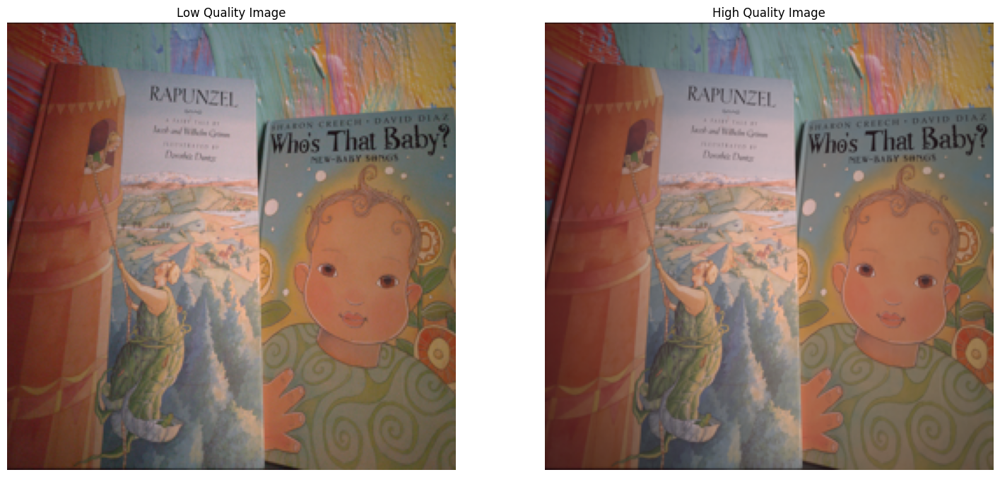

In [8]:
dis_img(train_low[644], train_high[644])

# PSNR Calculation

In [9]:
def calculate_psnr(original_img, denoised_img):
    
    original_img = original_img.astype(np.float64)
    denoised_img = denoised_img.astype(np.float64)
    
    mse = np.mean((original_img - denoised_img) ** 2)
    
    if mse == 0:
        return float('inf')
    
    max_pixel = original_img.max() - original_img.min()
    
    psnr = 20 * np.log10(max_pixel / np.sqrt(mse))
    return psnr

# Creating Patches

In [10]:
def create_patches(images, patch_size=(256, 256, 3)):
    combined_patches = []

    for image in images:
        H, W, C = image.shape
        patch_height, patch_width, patch_channels = patch_size

        patches = []
        for i in range(0, H, patch_height):
            for j in range(0, W, patch_width):
                patch = image[i:i + patch_height, j:j + patch_width, :]
                patches.append(patch)

        combined_patches.extend(patches)

    return combined_patches

# Applying transform and loading the dataset into dataloader

In [11]:
class CustomDataset(Dataset):
    def __init__(self, X, y, transform=None):
        self.X = X
        self.y = y
        self.transform = transform
    
    def __len__(self):
        return len(self.X)
    
    def __getitem__(self, idx):
        
        input_image = self.X[idx]
        denoised_image = self.y[idx]
        
        if self.transform:
            input_image = self.transform(input_image)
            denoised_image = self.transform(denoised_image)
        
        return input_image, denoised_image

In [12]:
input_transform = transforms.Compose([transforms.ToTensor()])

In [13]:
train_low_patches = create_patches(train_low)
train_high_patches = create_patches(train_high)

In [14]:
dataset = CustomDataset(train_low_patches, train_high_patches,input_transform)

In [15]:
dataloader = DataLoader(dataset, batch_size=32, shuffle=True)

In [16]:
val_dataset = CustomDataset(val_low, val_high, input_transform)
val_loader = DataLoader(val_dataset, batch_size=1, shuffle=False)

In [17]:
for batch in dataloader:
    i, j = batch
    print(f"i : {i.shape}, j : {j.shape}")
    break

i : torch.Size([32, 3, 256, 256]), j : torch.Size([32, 3, 256, 256])


# Defining CBDNet architecture

In [18]:
class Noise_Estimation(nn.Module):
    def __init__(self):
        super(Noise_Estimation, self).__init__()
        
        self.conv1 = nn.Conv2d(3, 32, (3,3), padding="same")
        self.relu1 = nn.ReLU()
        self.conv2 = nn.Conv2d(32, 32, (3,3), padding="same")
        self.relu2 = nn.ReLU()
        self.conv3 = nn.Conv2d(32, 32, (3,3), padding="same")
        self.relu3 = nn.ReLU()
        self.conv4 = nn.Conv2d(32, 32, (3,3), padding="same")
        self.relu4 = nn.ReLU()
        self.conv5 = nn.Conv2d(32, 3, (3,3), padding="same")
        self.relu5 = nn.ReLU()
        
    def forward(self, x):
        x = self.conv1(x)
        x = self.relu1(x)
        x = self.conv2(x)
        x = self.relu2(x)
        x = self.conv3(x)
        x = self.relu3(x)
        x = self.conv4(x)
        x = self.relu4(x)
        x = self.conv5(x)
        x = self.relu5(x)
        
        return x

In [19]:
class Denoising(nn.Module):
    def __init__(self):
        super(Denoising, self).__init__()
        
        self.conv1 = nn.Conv2d(6, 64, (3,3), padding="same")
        self.relu1 = nn.ReLU()
        self.conv2 = nn.Conv2d(64, 64, (3,3), padding="same")
        self.relu2 = nn.ReLU()
        
        self.pool1 = nn.AvgPool2d((2,2), padding=0)
        
        self.conv3 = nn.Conv2d(64, 128, (3,3), padding="same")
        self.relu3 = nn.ReLU()
        self.conv4 = nn.Conv2d(128, 128, (3,3), padding="same")
        self.relu4 = nn.ReLU()
        self.conv5 = nn.Conv2d(128, 128, (3,3), padding="same")
        self.relu5 = nn.ReLU()
        
        self.pool2 = nn.AvgPool2d((2,2), padding=0)
        
        self.conv6 = nn.Conv2d(128, 256, (3,3), padding="same")
        self.relu6 = nn.ReLU()
        self.conv7 = nn.Conv2d(256, 256, (3,3), padding="same")
        self.relu7 = nn.ReLU()
        self.conv8 = nn.Conv2d(256, 256, (3,3), padding="same")
        self.relu8 = nn.ReLU()
        self.conv9 = nn.Conv2d(256, 256, (3,3), padding="same")
        self.relu9 = nn.ReLU()
        self.conv10 = nn.Conv2d(256, 256, (3,3), padding="same")
        self.relu10 = nn.ReLU()
        self.conv11 = nn.Conv2d(256, 256, (3,3), padding="same")
        self.relu11 = nn.ReLU()
        
        self.convT1 = nn.ConvTranspose2d(256, 128, (2,2), stride=2)
        self.reluT1 = nn.ReLU()
        
        self.conv12 = nn.Conv2d(128, 128, (3,3), padding="same")
        self.relu12 = nn.ReLU()
        self.conv13 = nn.Conv2d(128, 128, (3,3), padding="same")
        self.relu13 = nn.ReLU()
        self.conv14 = nn.Conv2d(128, 128, (3,3), padding="same")
        self.relu14 = nn.ReLU()
        
        self.convT2 = nn.ConvTranspose2d(128, 64, (2,2), stride=2)
        self.reluT2 = nn.ReLU()
        
        self.conv15 = nn.Conv2d(64, 64, (3,3), padding="same")
        self.relu15 = nn.ReLU()
        self.conv16 = nn.Conv2d(64, 64, (3,3), padding="same")
        self.relu16 = nn.ReLU()
        self.conv17 = nn.Conv2d(64, 3, (3,3), padding="same")
        self.relu17 = nn.ReLU()
        
    
    def forward(self, x):
        
        x1 = self.conv1(x)
        x2 = self.relu1(x1)
        x3 = self.conv2(x2)
        x4 = self.relu2(x3)
        x5 = self.pool1(x4)
        x6 = self.conv3(x5)
        x7 = self.relu3(x6)
        x8 = self.conv4(x7)
        x9 = self.relu4(x8)
        x10 = self.conv5(x9)
        x11 = self.relu5(x10)
        x12 = self.pool2(x11)
        x13 = self.conv6(x12)
        x14 = self.relu6(x13)
        x15 = self.conv7(x14)
        x16 = self.relu7(x15)
        x17 = self.conv8(x16)
        x18 = self.relu8(x17)
        x19 = self.conv9(x18)
        x20 = self.relu9(x19)
        x21 = self.conv10(x20)
        x22 = self.relu10(x21)
        x23 = self.conv11(x22)
        x24 = self.relu11(x23)
        x25 = self.convT1(x24)
        x26 = self.reluT1(x25)
        x27 = x26 + x11
        x28 = self.conv12(x27)
        x29 = self.relu12(x28)
        x30 = self.conv13(x29)
        x31 = self.relu13(x30)
        x32 = self.conv14(x31)
        x33 = self.relu14(x32)
        x34 = self.convT2(x33)
        x35 = self.reluT2(x34)
        x36 = x35 + x4
        x37 = self.conv15(x36)
        x38 = self.relu15(x37)
        x39 = self.conv16(x38)
        x40 = self.relu16(x39)
        x41 = self.conv17(x40)
        x42 = self.relu17(x41)
        
        return x42

In [20]:
class CBDNet(nn.Module):
    def __init__(self):
        super(CBDNet, self).__init__()
        
        self.noise_estimation = Noise_Estimation()
        self.denoising = Denoising()
    def forward(self, input):
        
        x = self.noise_estimation(input)
        x = torch.cat([x, input], dim=1)
        x = self.denoising(x)
        x = x + input
        return x

In [21]:
Model = CBDNet()

# Moving the model to GPU

In [22]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

In [23]:
Model = Model.to(device)

# Loss and Optimizer

In [24]:
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(Model.parameters(), lr=1e-3, betas=(0.9,0.999))

In [25]:
scheduler = StepLR(optimizer, step_size=50, gamma=0.9)

In [26]:
loss = []

In [27]:
epochs = 2000

In [28]:
def validation(Model):
    Model.eval()
    with torch.no_grad():
        val_psnr_t = 0;
        val_min_psnr = 50
        val_max_psnr = -50
        val_loss = 0
        for batch in val_loader:
            low_img, high_img = batch
            low_img = low_img.to(device)


            denoished_img = Model(low_img)
            denoished_img = denoished_img.to("cpu")
            val_loss += criterion(denoished_img, high_img).item() 
            denoished_img = denoished_img.squeeze()
            high_img = high_img.squeeze()
            denoished_img = denoished_img.detach().numpy()
            high_img = high_img.numpy()
            denoished_img = np.transpose(denoished_img,(1,2,0))
            high_img = np.transpose(high_img,(1,2,0))
            psnr =  calculate_psnr(denoished_img, high_img)
            
            val_psnr_t += psnr
            if psnr>val_max_psnr :
                val_max_psnr = psnr
            if psnr<val_min_psnr:
                val_min_psnr = psnr

        val_psnr_t /= len(val_loader)
        val_loss /= len(val_loader)
        return val_loss, val_psnr_t

In [29]:
def training(Model):
    Model.eval()
    with torch.no_grad():
        train_psnr_t = 0;
        train_min_psnr = 50
        train_max_psnr = -50
        train_loss = 0
        for batch in dataloader:
            low_imgs, high_imgs = batch
            low_imgs = low_imgs.to(device)

            denoished_imgs = Model(low_imgs)
            denoished_imgs = denoished_imgs.to("cpu")
            train_loss += criterion(denoished_imgs, high_imgs).item() 
            batch_psnr_sum = 0
            for i in range(denoished_imgs.shape[0]):
                denoished_img = denoished_imgs[i]
                high_img = high_imgs[i]
                denoished_img = denoished_img.detach().numpy()
                high_img = high_img.numpy()
                denoished_img = np.transpose(denoished_img,(1,2,0))
                high_img = np.transpose(high_img,(1,2,0))
                psnr =  calculate_psnr(denoished_img, high_img)

                batch_psnr_sum += psnr
                if psnr>train_max_psnr :
                    train_max_psnr = psnr
                if psnr<train_min_psnr:
                    train_min_psnr = psnr
            
            train_psnr_t += batch_psnr_sum / denoished_imgs.shape[0]

        train_psnr_t /= len(dataloader)
        train_loss /= len(dataloader)
        return train_loss, train_psnr_t

# Model Training

In [30]:
for epoch in range(epochs):
    loss_e = 0
    for batch in tqdm(dataloader):
        Model.train()
        optimizer.zero_grad()
        
        low_img, high_img = batch
        low_img = low_img.to(device)
        high_img = high_img.to(device)
        
        denoished_img = Model(low_img)
        
        error = criterion(denoished_img, high_img) 
        
        error.backward()
        optimizer.step()
        loss_e += error.item()
    
    if epoch <= 500:
        scheduler.step()
    elif epoch > 500 and epoch % 10 == 0:
        scheduler.step()
        
    loss_e /= len(dataloader)
    loss.append(loss_e)
    val_loss, val_psnr = validation(Model)
    train_loss, train_psnr = training(Model)
    print(f"{epoch+1} / {epochs} Runnung Training loss : {loss_e}")
    print(f"Training loss : {train_loss:.4f} Training PSNR : {train_psnr:.4f} Validation Loss : {val_loss:.4f} Validation PSNR : {val_psnr:.4f}")

  0%|          | 0/21 [00:00<?, ?it/s]

1 / 2000 Runnung Training loss : 0.1373157057733763
Training loss : 0.0688 Training PSNR : 7.7067 Validation Loss : 0.0845 Validation PSNR : 6.6719


  0%|          | 0/21 [00:00<?, ?it/s]

2 / 2000 Runnung Training loss : 0.050022513206515996
Training loss : 0.0427 Training PSNR : 10.5096 Validation Loss : 0.0483 Validation PSNR : 8.6988


  0%|          | 0/21 [00:00<?, ?it/s]

3 / 2000 Runnung Training loss : 0.040673786330790745
Training loss : 0.0395 Training PSNR : 10.5239 Validation Loss : 0.0454 Validation PSNR : 8.7001


  0%|          | 0/21 [00:00<?, ?it/s]

4 / 2000 Runnung Training loss : 0.03908169739657924
Training loss : 0.0345 Training PSNR : 12.3572 Validation Loss : 0.0353 Validation PSNR : 10.6982


  0%|          | 0/21 [00:00<?, ?it/s]

5 / 2000 Runnung Training loss : 0.03527961981793245
Training loss : 0.0316 Training PSNR : 13.5513 Validation Loss : 0.0303 Validation PSNR : 12.4464


  0%|          | 0/21 [00:00<?, ?it/s]

6 / 2000 Runnung Training loss : 0.033745912391515004
Training loss : 0.0312 Training PSNR : 13.2153 Validation Loss : 0.0303 Validation PSNR : 11.3374


  0%|          | 0/21 [00:00<?, ?it/s]

7 / 2000 Runnung Training loss : 0.03341871198444139
Training loss : 0.0310 Training PSNR : 13.7699 Validation Loss : 0.0250 Validation PSNR : 13.1270


  0%|          | 0/21 [00:00<?, ?it/s]

8 / 2000 Runnung Training loss : 0.03320050416957764
Training loss : 0.0320 Training PSNR : 13.0143 Validation Loss : 0.0263 Validation PSNR : 12.6969


  0%|          | 0/21 [00:00<?, ?it/s]

9 / 2000 Runnung Training loss : 0.036146655678749084
Training loss : 0.0330 Training PSNR : 13.0378 Validation Loss : 0.0335 Validation PSNR : 10.4903


  0%|          | 0/21 [00:00<?, ?it/s]

10 / 2000 Runnung Training loss : 0.032562165920223506
Training loss : 0.0310 Training PSNR : 14.6365 Validation Loss : 0.0279 Validation PSNR : 12.2512


  0%|          | 0/21 [00:00<?, ?it/s]

11 / 2000 Runnung Training loss : 0.03465442927110763
Training loss : 0.0342 Training PSNR : 13.5497 Validation Loss : 0.0344 Validation PSNR : 10.4436


  0%|          | 0/21 [00:00<?, ?it/s]

12 / 2000 Runnung Training loss : 0.02971376780243147
Training loss : 0.0288 Training PSNR : 14.9825 Validation Loss : 0.0247 Validation PSNR : 13.2397


  0%|          | 0/21 [00:00<?, ?it/s]

13 / 2000 Runnung Training loss : 0.02941827742116792
Training loss : 0.0366 Training PSNR : 13.6575 Validation Loss : 0.0411 Validation PSNR : 10.9317


  0%|          | 0/21 [00:00<?, ?it/s]

14 / 2000 Runnung Training loss : 0.028256199100897425
Training loss : 0.0295 Training PSNR : 13.3040 Validation Loss : 0.0231 Validation PSNR : 13.8151


  0%|          | 0/21 [00:00<?, ?it/s]

15 / 2000 Runnung Training loss : 0.02732907510584309
Training loss : 0.0261 Training PSNR : 14.9934 Validation Loss : 0.0247 Validation PSNR : 13.0693


  0%|          | 0/21 [00:00<?, ?it/s]

16 / 2000 Runnung Training loss : 0.026902045744160812
Training loss : 0.0258 Training PSNR : 15.9321 Validation Loss : 0.0222 Validation PSNR : 14.8072


  0%|          | 0/21 [00:00<?, ?it/s]

17 / 2000 Runnung Training loss : 0.027679396438456717
Training loss : 0.0267 Training PSNR : 15.3793 Validation Loss : 0.0255 Validation PSNR : 13.0999


  0%|          | 0/21 [00:00<?, ?it/s]

18 / 2000 Runnung Training loss : 0.02632714080668631
Training loss : 0.0250 Training PSNR : 15.2886 Validation Loss : 0.0226 Validation PSNR : 13.8904


  0%|          | 0/21 [00:00<?, ?it/s]

19 / 2000 Runnung Training loss : 0.025357751264458613
Training loss : 0.0262 Training PSNR : 15.2568 Validation Loss : 0.0271 Validation PSNR : 13.1139


  0%|          | 0/21 [00:00<?, ?it/s]

20 / 2000 Runnung Training loss : 0.0254768765575829
Training loss : 0.0253 Training PSNR : 14.6359 Validation Loss : 0.0209 Validation PSNR : 14.9199


  0%|          | 0/21 [00:00<?, ?it/s]

21 / 2000 Runnung Training loss : 0.024787800475245432
Training loss : 0.0241 Training PSNR : 17.1440 Validation Loss : 0.0249 Validation PSNR : 14.1754


  0%|          | 0/21 [00:00<?, ?it/s]

22 / 2000 Runnung Training loss : 0.023367030900858697
Training loss : 0.0256 Training PSNR : 16.0010 Validation Loss : 0.0240 Validation PSNR : 15.3947


  0%|          | 0/21 [00:00<?, ?it/s]

23 / 2000 Runnung Training loss : 0.023409814884265263
Training loss : 0.0237 Training PSNR : 15.0494 Validation Loss : 0.0266 Validation PSNR : 13.8785


  0%|          | 0/21 [00:00<?, ?it/s]

24 / 2000 Runnung Training loss : 0.023464720962303027
Training loss : 0.0230 Training PSNR : 17.1777 Validation Loss : 0.0210 Validation PSNR : 16.5241


  0%|          | 0/21 [00:00<?, ?it/s]

25 / 2000 Runnung Training loss : 0.02156156651853096
Training loss : 0.0207 Training PSNR : 17.4582 Validation Loss : 0.0207 Validation PSNR : 16.1511


  0%|          | 0/21 [00:00<?, ?it/s]

26 / 2000 Runnung Training loss : 0.022003733641689734
Training loss : 0.0265 Training PSNR : 15.8871 Validation Loss : 0.0211 Validation PSNR : 16.2844


  0%|          | 0/21 [00:00<?, ?it/s]

27 / 2000 Runnung Training loss : 0.02330604891869284
Training loss : 0.0209 Training PSNR : 17.1258 Validation Loss : 0.0199 Validation PSNR : 16.4342


  0%|          | 0/21 [00:00<?, ?it/s]

28 / 2000 Runnung Training loss : 0.021534492261707783
Training loss : 0.0262 Training PSNR : 17.1441 Validation Loss : 0.0278 Validation PSNR : 14.3512


  0%|          | 0/21 [00:00<?, ?it/s]

29 / 2000 Runnung Training loss : 0.022028200328350067
Training loss : 0.0200 Training PSNR : 17.5551 Validation Loss : 0.0187 Validation PSNR : 17.2187


  0%|          | 0/21 [00:00<?, ?it/s]

30 / 2000 Runnung Training loss : 0.021929960875284104
Training loss : 0.0277 Training PSNR : 17.2820 Validation Loss : 0.0251 Validation PSNR : 16.4795


  0%|          | 0/21 [00:00<?, ?it/s]

31 / 2000 Runnung Training loss : 0.021932740562728474
Training loss : 0.0198 Training PSNR : 18.3235 Validation Loss : 0.0220 Validation PSNR : 15.9414


  0%|          | 0/21 [00:00<?, ?it/s]

32 / 2000 Runnung Training loss : 0.020676813132706143
Training loss : 0.0194 Training PSNR : 17.5816 Validation Loss : 0.0185 Validation PSNR : 17.3098


  0%|          | 0/21 [00:00<?, ?it/s]

33 / 2000 Runnung Training loss : 0.019296282503221716
Training loss : 0.0181 Training PSNR : 18.9745 Validation Loss : 0.0200 Validation PSNR : 17.0675


  0%|          | 0/21 [00:00<?, ?it/s]

34 / 2000 Runnung Training loss : 0.018869983076694467
Training loss : 0.0214 Training PSNR : 18.9247 Validation Loss : 0.0225 Validation PSNR : 17.4656


  0%|          | 0/21 [00:00<?, ?it/s]

35 / 2000 Runnung Training loss : 0.020633207279301825
Training loss : 0.0247 Training PSNR : 18.0367 Validation Loss : 0.0255 Validation PSNR : 15.2494


  0%|          | 0/21 [00:00<?, ?it/s]

36 / 2000 Runnung Training loss : 0.023569798983988307
Training loss : 0.0223 Training PSNR : 18.5517 Validation Loss : 0.0223 Validation PSNR : 15.8350


  0%|          | 0/21 [00:00<?, ?it/s]

37 / 2000 Runnung Training loss : 0.02135605342863571
Training loss : 0.0193 Training PSNR : 17.8484 Validation Loss : 0.0190 Validation PSNR : 16.6456


  0%|          | 0/21 [00:00<?, ?it/s]

38 / 2000 Runnung Training loss : 0.020116751437031087
Training loss : 0.0189 Training PSNR : 19.2852 Validation Loss : 0.0202 Validation PSNR : 17.2668


  0%|          | 0/21 [00:00<?, ?it/s]

39 / 2000 Runnung Training loss : 0.018854284570330664
Training loss : 0.0175 Training PSNR : 19.1659 Validation Loss : 0.0199 Validation PSNR : 16.8968


  0%|          | 0/21 [00:00<?, ?it/s]

40 / 2000 Runnung Training loss : 0.020534898864016646
Training loss : 0.0172 Training PSNR : 19.2177 Validation Loss : 0.0201 Validation PSNR : 16.7638


  0%|          | 0/21 [00:00<?, ?it/s]

41 / 2000 Runnung Training loss : 0.018706381365302064
Training loss : 0.0169 Training PSNR : 19.1336 Validation Loss : 0.0192 Validation PSNR : 17.1454


  0%|          | 0/21 [00:00<?, ?it/s]

42 / 2000 Runnung Training loss : 0.0181598203877608
Training loss : 0.0170 Training PSNR : 19.3170 Validation Loss : 0.0191 Validation PSNR : 17.4073


  0%|          | 0/21 [00:00<?, ?it/s]

43 / 2000 Runnung Training loss : 0.01780067410852228
Training loss : 0.0172 Training PSNR : 19.6681 Validation Loss : 0.0190 Validation PSNR : 17.4413


  0%|          | 0/21 [00:00<?, ?it/s]

44 / 2000 Runnung Training loss : 0.01702992662432648
Training loss : 0.0159 Training PSNR : 19.5582 Validation Loss : 0.0189 Validation PSNR : 17.4485


  0%|          | 0/21 [00:00<?, ?it/s]

45 / 2000 Runnung Training loss : 0.017292094993449393
Training loss : 0.0171 Training PSNR : 19.8376 Validation Loss : 0.0199 Validation PSNR : 17.2581


  0%|          | 0/21 [00:00<?, ?it/s]

46 / 2000 Runnung Training loss : 0.017915586187016396
Training loss : 0.0173 Training PSNR : 18.9559 Validation Loss : 0.0184 Validation PSNR : 17.9735


  0%|          | 0/21 [00:00<?, ?it/s]

47 / 2000 Runnung Training loss : 0.016089640380371185
Training loss : 0.0161 Training PSNR : 19.7237 Validation Loss : 0.0197 Validation PSNR : 17.0060


  0%|          | 0/21 [00:00<?, ?it/s]

48 / 2000 Runnung Training loss : 0.0170216289393249
Training loss : 0.0175 Training PSNR : 20.5380 Validation Loss : 0.0204 Validation PSNR : 17.1182


  0%|          | 0/21 [00:00<?, ?it/s]

49 / 2000 Runnung Training loss : 0.017404452498470033
Training loss : 0.0167 Training PSNR : 20.0098 Validation Loss : 0.0194 Validation PSNR : 17.1455


  0%|          | 0/21 [00:00<?, ?it/s]

50 / 2000 Runnung Training loss : 0.01726589294239169
Training loss : 0.0154 Training PSNR : 19.7188 Validation Loss : 0.0174 Validation PSNR : 17.9998


  0%|          | 0/21 [00:00<?, ?it/s]

51 / 2000 Runnung Training loss : 0.016307318893571694
Training loss : 0.0154 Training PSNR : 20.4974 Validation Loss : 0.0196 Validation PSNR : 17.9143


  0%|          | 0/21 [00:00<?, ?it/s]

52 / 2000 Runnung Training loss : 0.016677782937352146
Training loss : 0.0150 Training PSNR : 20.9388 Validation Loss : 0.0190 Validation PSNR : 17.6740


  0%|          | 0/21 [00:00<?, ?it/s]

53 / 2000 Runnung Training loss : 0.015754847609925838
Training loss : 0.0162 Training PSNR : 19.1189 Validation Loss : 0.0174 Validation PSNR : 17.8401


  0%|          | 0/21 [00:00<?, ?it/s]

54 / 2000 Runnung Training loss : 0.015032144706873666
Training loss : 0.0159 Training PSNR : 19.5500 Validation Loss : 0.0184 Validation PSNR : 18.0265


  0%|          | 0/21 [00:00<?, ?it/s]

55 / 2000 Runnung Training loss : 0.014865835064223834
Training loss : 0.0144 Training PSNR : 20.2836 Validation Loss : 0.0176 Validation PSNR : 18.0536


  0%|          | 0/21 [00:00<?, ?it/s]

56 / 2000 Runnung Training loss : 0.015518876635247753
Training loss : 0.0160 Training PSNR : 19.7132 Validation Loss : 0.0185 Validation PSNR : 18.4692


  0%|          | 0/21 [00:00<?, ?it/s]

57 / 2000 Runnung Training loss : 0.01539732843992256
Training loss : 0.0144 Training PSNR : 20.3504 Validation Loss : 0.0173 Validation PSNR : 18.3102


  0%|          | 0/21 [00:00<?, ?it/s]

58 / 2000 Runnung Training loss : 0.014411382687588533
Training loss : 0.0150 Training PSNR : 19.8237 Validation Loss : 0.0178 Validation PSNR : 18.4135


  0%|          | 0/21 [00:00<?, ?it/s]

59 / 2000 Runnung Training loss : 0.01448864968759673
Training loss : 0.0139 Training PSNR : 21.1057 Validation Loss : 0.0186 Validation PSNR : 17.9621


  0%|          | 0/21 [00:00<?, ?it/s]

60 / 2000 Runnung Training loss : 0.014528911715994278
Training loss : 0.0193 Training PSNR : 20.5961 Validation Loss : 0.0238 Validation PSNR : 16.9349


  0%|          | 0/21 [00:00<?, ?it/s]

61 / 2000 Runnung Training loss : 0.015429691721995672
Training loss : 0.0130 Training PSNR : 21.1165 Validation Loss : 0.0167 Validation PSNR : 18.5715


  0%|          | 0/21 [00:00<?, ?it/s]

62 / 2000 Runnung Training loss : 0.013755855061823414
Training loss : 0.0155 Training PSNR : 21.0204 Validation Loss : 0.0199 Validation PSNR : 17.5559


  0%|          | 0/21 [00:00<?, ?it/s]

63 / 2000 Runnung Training loss : 0.014524649407359817
Training loss : 0.0136 Training PSNR : 20.7173 Validation Loss : 0.0174 Validation PSNR : 18.2571


  0%|          | 0/21 [00:00<?, ?it/s]

64 / 2000 Runnung Training loss : 0.014075483705493667
Training loss : 0.0130 Training PSNR : 20.5709 Validation Loss : 0.0176 Validation PSNR : 18.0345


  0%|          | 0/21 [00:00<?, ?it/s]

65 / 2000 Runnung Training loss : 0.013238143264537766
Training loss : 0.0177 Training PSNR : 20.0120 Validation Loss : 0.0193 Validation PSNR : 18.6712


  0%|          | 0/21 [00:00<?, ?it/s]

66 / 2000 Runnung Training loss : 0.013923580492181438
Training loss : 0.0154 Training PSNR : 21.0719 Validation Loss : 0.0202 Validation PSNR : 17.7724


  0%|          | 0/21 [00:00<?, ?it/s]

67 / 2000 Runnung Training loss : 0.015010317610133262
Training loss : 0.0173 Training PSNR : 19.3710 Validation Loss : 0.0182 Validation PSNR : 18.1435


  0%|          | 0/21 [00:00<?, ?it/s]

68 / 2000 Runnung Training loss : 0.015820153456713473
Training loss : 0.0154 Training PSNR : 20.0415 Validation Loss : 0.0190 Validation PSNR : 17.6671


  0%|          | 0/21 [00:00<?, ?it/s]

69 / 2000 Runnung Training loss : 0.014958012117339032
Training loss : 0.0177 Training PSNR : 19.5638 Validation Loss : 0.0176 Validation PSNR : 18.7852


  0%|          | 0/21 [00:00<?, ?it/s]

70 / 2000 Runnung Training loss : 0.014861908386505786
Training loss : 0.0125 Training PSNR : 21.3137 Validation Loss : 0.0170 Validation PSNR : 18.5481


  0%|          | 0/21 [00:00<?, ?it/s]

71 / 2000 Runnung Training loss : 0.013223766615348203
Training loss : 0.0130 Training PSNR : 21.5374 Validation Loss : 0.0164 Validation PSNR : 19.2352


  0%|          | 0/21 [00:00<?, ?it/s]

72 / 2000 Runnung Training loss : 0.014898967130907945
Training loss : 0.0161 Training PSNR : 19.3242 Validation Loss : 0.0176 Validation PSNR : 18.3187


  0%|          | 0/21 [00:00<?, ?it/s]

73 / 2000 Runnung Training loss : 0.013796988209443433
Training loss : 0.0131 Training PSNR : 21.3119 Validation Loss : 0.0175 Validation PSNR : 18.1994


  0%|          | 0/21 [00:00<?, ?it/s]

74 / 2000 Runnung Training loss : 0.013251479537714096
Training loss : 0.0122 Training PSNR : 21.4249 Validation Loss : 0.0170 Validation PSNR : 18.6022


  0%|          | 0/21 [00:00<?, ?it/s]

75 / 2000 Runnung Training loss : 0.014754997078506719
Training loss : 0.0123 Training PSNR : 21.7188 Validation Loss : 0.0168 Validation PSNR : 18.7314


  0%|          | 0/21 [00:00<?, ?it/s]

76 / 2000 Runnung Training loss : 0.013508689855890614
Training loss : 0.0121 Training PSNR : 22.1567 Validation Loss : 0.0169 Validation PSNR : 18.8737


  0%|          | 0/21 [00:00<?, ?it/s]

77 / 2000 Runnung Training loss : 0.01244064886122942
Training loss : 0.0118 Training PSNR : 22.7096 Validation Loss : 0.0160 Validation PSNR : 19.3132


  0%|          | 0/21 [00:00<?, ?it/s]

78 / 2000 Runnung Training loss : 0.01230685439492975
Training loss : 0.0165 Training PSNR : 20.7799 Validation Loss : 0.0197 Validation PSNR : 19.3405


  0%|          | 0/21 [00:00<?, ?it/s]

79 / 2000 Runnung Training loss : 0.015055773469309012
Training loss : 0.0131 Training PSNR : 20.5843 Validation Loss : 0.0182 Validation PSNR : 17.9195


  0%|          | 0/21 [00:00<?, ?it/s]

80 / 2000 Runnung Training loss : 0.012873037141703424
Training loss : 0.0119 Training PSNR : 21.7011 Validation Loss : 0.0178 Validation PSNR : 18.2578


  0%|          | 0/21 [00:00<?, ?it/s]

81 / 2000 Runnung Training loss : 0.012095895861940724
Training loss : 0.0111 Training PSNR : 22.0078 Validation Loss : 0.0160 Validation PSNR : 19.2970


  0%|          | 0/21 [00:00<?, ?it/s]

82 / 2000 Runnung Training loss : 0.011663700032624461
Training loss : 0.0110 Training PSNR : 22.2996 Validation Loss : 0.0167 Validation PSNR : 18.7786


  0%|          | 0/21 [00:00<?, ?it/s]

83 / 2000 Runnung Training loss : 0.011384487462540468
Training loss : 0.0134 Training PSNR : 21.7494 Validation Loss : 0.0204 Validation PSNR : 17.8218


  0%|          | 0/21 [00:00<?, ?it/s]

84 / 2000 Runnung Training loss : 0.012206007416049639
Training loss : 0.0115 Training PSNR : 21.7781 Validation Loss : 0.0160 Validation PSNR : 19.1565


  0%|          | 0/21 [00:00<?, ?it/s]

85 / 2000 Runnung Training loss : 0.013011647720954247
Training loss : 0.0110 Training PSNR : 22.4862 Validation Loss : 0.0171 Validation PSNR : 18.9815


  0%|          | 0/21 [00:00<?, ?it/s]

86 / 2000 Runnung Training loss : 0.01221449968094627
Training loss : 0.0115 Training PSNR : 21.3618 Validation Loss : 0.0171 Validation PSNR : 18.3342


  0%|          | 0/21 [00:00<?, ?it/s]

87 / 2000 Runnung Training loss : 0.0113252495814647
Training loss : 0.0113 Training PSNR : 22.3464 Validation Loss : 0.0173 Validation PSNR : 18.6042


  0%|          | 0/21 [00:00<?, ?it/s]

88 / 2000 Runnung Training loss : 0.011025698545078436
Training loss : 0.0101 Training PSNR : 22.8718 Validation Loss : 0.0162 Validation PSNR : 19.1918


  0%|          | 0/21 [00:00<?, ?it/s]

89 / 2000 Runnung Training loss : 0.010751026349940471
Training loss : 0.0111 Training PSNR : 22.4754 Validation Loss : 0.0157 Validation PSNR : 19.4433


  0%|          | 0/21 [00:00<?, ?it/s]

90 / 2000 Runnung Training loss : 0.010775056889369375
Training loss : 0.0106 Training PSNR : 22.2022 Validation Loss : 0.0166 Validation PSNR : 18.9093


  0%|          | 0/21 [00:00<?, ?it/s]

91 / 2000 Runnung Training loss : 0.012177684898709967
Training loss : 0.0128 Training PSNR : 21.1997 Validation Loss : 0.0162 Validation PSNR : 19.0958


  0%|          | 0/21 [00:00<?, ?it/s]

92 / 2000 Runnung Training loss : 0.0116551723331213
Training loss : 0.0113 Training PSNR : 22.3275 Validation Loss : 0.0182 Validation PSNR : 18.8604


  0%|          | 0/21 [00:00<?, ?it/s]

93 / 2000 Runnung Training loss : 0.011527194685879209
Training loss : 0.0119 Training PSNR : 22.1649 Validation Loss : 0.0199 Validation PSNR : 17.7932


  0%|          | 0/21 [00:00<?, ?it/s]

94 / 2000 Runnung Training loss : 0.011174358782314119
Training loss : 0.0108 Training PSNR : 22.5454 Validation Loss : 0.0177 Validation PSNR : 18.2586


  0%|          | 0/21 [00:00<?, ?it/s]

95 / 2000 Runnung Training loss : 0.010669537797747623
Training loss : 0.0104 Training PSNR : 22.7407 Validation Loss : 0.0166 Validation PSNR : 19.0435


  0%|          | 0/21 [00:00<?, ?it/s]

96 / 2000 Runnung Training loss : 0.01032567820290015
Training loss : 0.0098 Training PSNR : 23.0727 Validation Loss : 0.0156 Validation PSNR : 19.4240


  0%|          | 0/21 [00:00<?, ?it/s]

97 / 2000 Runnung Training loss : 0.011075690699120363
Training loss : 0.0099 Training PSNR : 22.9017 Validation Loss : 0.0157 Validation PSNR : 19.3942


  0%|          | 0/21 [00:00<?, ?it/s]

98 / 2000 Runnung Training loss : 0.012850550712928885
Training loss : 0.0124 Training PSNR : 21.9605 Validation Loss : 0.0183 Validation PSNR : 17.9885


  0%|          | 0/21 [00:00<?, ?it/s]

99 / 2000 Runnung Training loss : 0.011301488881664616
Training loss : 0.0098 Training PSNR : 22.9261 Validation Loss : 0.0167 Validation PSNR : 18.9147


  0%|          | 0/21 [00:00<?, ?it/s]

100 / 2000 Runnung Training loss : 0.009924248858754123
Training loss : 0.0094 Training PSNR : 23.6417 Validation Loss : 0.0156 Validation PSNR : 19.6463


  0%|          | 0/21 [00:00<?, ?it/s]

101 / 2000 Runnung Training loss : 0.010359549207524174
Training loss : 0.0092 Training PSNR : 23.8053 Validation Loss : 0.0157 Validation PSNR : 19.5923


  0%|          | 0/21 [00:00<?, ?it/s]

102 / 2000 Runnung Training loss : 0.01008934760466218
Training loss : 0.0121 Training PSNR : 21.9444 Validation Loss : 0.0160 Validation PSNR : 19.9127


  0%|          | 0/21 [00:00<?, ?it/s]

103 / 2000 Runnung Training loss : 0.010494157960194917
Training loss : 0.0107 Training PSNR : 22.5513 Validation Loss : 0.0192 Validation PSNR : 18.1297


  0%|          | 0/21 [00:00<?, ?it/s]

104 / 2000 Runnung Training loss : 0.010102403461046162
Training loss : 0.0117 Training PSNR : 23.0925 Validation Loss : 0.0194 Validation PSNR : 18.6352


  0%|          | 0/21 [00:00<?, ?it/s]

105 / 2000 Runnung Training loss : 0.01032108019682623
Training loss : 0.0097 Training PSNR : 22.7791 Validation Loss : 0.0160 Validation PSNR : 19.4890


  0%|          | 0/21 [00:00<?, ?it/s]

106 / 2000 Runnung Training loss : 0.01063621383426445
Training loss : 0.0090 Training PSNR : 23.0043 Validation Loss : 0.0160 Validation PSNR : 19.1522


  0%|          | 0/21 [00:00<?, ?it/s]

107 / 2000 Runnung Training loss : 0.009357048065534659
Training loss : 0.0106 Training PSNR : 22.8502 Validation Loss : 0.0185 Validation PSNR : 18.4076


  0%|          | 0/21 [00:00<?, ?it/s]

108 / 2000 Runnung Training loss : 0.009218735021672078
Training loss : 0.0086 Training PSNR : 23.7060 Validation Loss : 0.0152 Validation PSNR : 19.7040


  0%|          | 0/21 [00:00<?, ?it/s]

109 / 2000 Runnung Training loss : 0.008817987960009347
Training loss : 0.0087 Training PSNR : 23.6816 Validation Loss : 0.0161 Validation PSNR : 19.2554


  0%|          | 0/21 [00:00<?, ?it/s]

110 / 2000 Runnung Training loss : 0.009519839459764106
Training loss : 0.0106 Training PSNR : 23.1041 Validation Loss : 0.0173 Validation PSNR : 19.7071


  0%|          | 0/21 [00:00<?, ?it/s]

111 / 2000 Runnung Training loss : 0.00964957278310543
Training loss : 0.0084 Training PSNR : 23.7763 Validation Loss : 0.0159 Validation PSNR : 19.4856


  0%|          | 0/21 [00:00<?, ?it/s]

112 / 2000 Runnung Training loss : 0.008951458836063034
Training loss : 0.0083 Training PSNR : 24.0586 Validation Loss : 0.0156 Validation PSNR : 19.5023


  0%|          | 0/21 [00:00<?, ?it/s]

113 / 2000 Runnung Training loss : 0.00839398843458011
Training loss : 0.0085 Training PSNR : 23.9177 Validation Loss : 0.0159 Validation PSNR : 19.5759


  0%|          | 0/21 [00:00<?, ?it/s]

114 / 2000 Runnung Training loss : 0.008436762417356173
Training loss : 0.0081 Training PSNR : 23.4026 Validation Loss : 0.0150 Validation PSNR : 19.7609


  0%|          | 0/21 [00:00<?, ?it/s]

115 / 2000 Runnung Training loss : 0.008188552444889433
Training loss : 0.0085 Training PSNR : 23.6413 Validation Loss : 0.0157 Validation PSNR : 19.7572


  0%|          | 0/21 [00:00<?, ?it/s]

116 / 2000 Runnung Training loss : 0.008676037990621157
Training loss : 0.0079 Training PSNR : 23.8747 Validation Loss : 0.0153 Validation PSNR : 19.6394


  0%|          | 0/21 [00:00<?, ?it/s]

117 / 2000 Runnung Training loss : 0.008626919638897692
Training loss : 0.0092 Training PSNR : 23.0352 Validation Loss : 0.0152 Validation PSNR : 19.8745


  0%|          | 0/21 [00:00<?, ?it/s]

118 / 2000 Runnung Training loss : 0.008137091484275601
Training loss : 0.0086 Training PSNR : 23.8789 Validation Loss : 0.0174 Validation PSNR : 19.1167


  0%|          | 0/21 [00:00<?, ?it/s]

119 / 2000 Runnung Training loss : 0.008326154690058459
Training loss : 0.0079 Training PSNR : 24.0835 Validation Loss : 0.0153 Validation PSNR : 19.7058


  0%|          | 0/21 [00:00<?, ?it/s]

120 / 2000 Runnung Training loss : 0.008166475332386437
Training loss : 0.0077 Training PSNR : 24.1767 Validation Loss : 0.0145 Validation PSNR : 20.0956


  0%|          | 0/21 [00:00<?, ?it/s]

121 / 2000 Runnung Training loss : 0.008025730228317636
Training loss : 0.0084 Training PSNR : 23.9783 Validation Loss : 0.0161 Validation PSNR : 19.3684


  0%|          | 0/21 [00:00<?, ?it/s]

122 / 2000 Runnung Training loss : 0.00813164905689302
Training loss : 0.0074 Training PSNR : 24.3892 Validation Loss : 0.0154 Validation PSNR : 19.3081


  0%|          | 0/21 [00:00<?, ?it/s]

123 / 2000 Runnung Training loss : 0.007607063167684135
Training loss : 0.0074 Training PSNR : 24.4195 Validation Loss : 0.0156 Validation PSNR : 19.5887


  0%|          | 0/21 [00:00<?, ?it/s]

124 / 2000 Runnung Training loss : 0.007446892803446168
Training loss : 0.0067 Training PSNR : 24.4865 Validation Loss : 0.0147 Validation PSNR : 19.9663


  0%|          | 0/21 [00:00<?, ?it/s]

125 / 2000 Runnung Training loss : 0.007245012958134923
Training loss : 0.0067 Training PSNR : 24.4501 Validation Loss : 0.0155 Validation PSNR : 19.5229


  0%|          | 0/21 [00:00<?, ?it/s]

126 / 2000 Runnung Training loss : 0.007369441955926872
Training loss : 0.0077 Training PSNR : 23.7463 Validation Loss : 0.0159 Validation PSNR : 19.3513


  0%|          | 0/21 [00:00<?, ?it/s]

127 / 2000 Runnung Training loss : 0.00730127151612015
Training loss : 0.0077 Training PSNR : 24.2242 Validation Loss : 0.0175 Validation PSNR : 18.9803


  0%|          | 0/21 [00:00<?, ?it/s]

128 / 2000 Runnung Training loss : 0.007235912317853598
Training loss : 0.0069 Training PSNR : 24.2714 Validation Loss : 0.0154 Validation PSNR : 19.3324


  0%|          | 0/21 [00:00<?, ?it/s]

129 / 2000 Runnung Training loss : 0.006886842594082866
Training loss : 0.0065 Training PSNR : 24.8729 Validation Loss : 0.0157 Validation PSNR : 19.7650


  0%|          | 0/21 [00:00<?, ?it/s]

130 / 2000 Runnung Training loss : 0.006986077387063276
Training loss : 0.0064 Training PSNR : 25.1222 Validation Loss : 0.0144 Validation PSNR : 20.2765


  0%|          | 0/21 [00:00<?, ?it/s]

131 / 2000 Runnung Training loss : 0.00683114520229754
Training loss : 0.0069 Training PSNR : 24.4720 Validation Loss : 0.0151 Validation PSNR : 19.5946


  0%|          | 0/21 [00:00<?, ?it/s]

132 / 2000 Runnung Training loss : 0.006896974042146688
Training loss : 0.0071 Training PSNR : 24.0786 Validation Loss : 0.0149 Validation PSNR : 19.9585


  0%|          | 0/21 [00:00<?, ?it/s]

133 / 2000 Runnung Training loss : 0.007117800525433961
Training loss : 0.0071 Training PSNR : 24.4734 Validation Loss : 0.0166 Validation PSNR : 19.1974


  0%|          | 0/21 [00:00<?, ?it/s]

134 / 2000 Runnung Training loss : 0.007256029218080498
Training loss : 0.0074 Training PSNR : 24.1494 Validation Loss : 0.0166 Validation PSNR : 18.9746


  0%|          | 0/21 [00:00<?, ?it/s]

135 / 2000 Runnung Training loss : 0.006918495232682852
Training loss : 0.0064 Training PSNR : 24.5201 Validation Loss : 0.0140 Validation PSNR : 20.4073


  0%|          | 0/21 [00:00<?, ?it/s]

136 / 2000 Runnung Training loss : 0.006201783882542735
Training loss : 0.0058 Training PSNR : 25.2892 Validation Loss : 0.0144 Validation PSNR : 20.0691


  0%|          | 0/21 [00:00<?, ?it/s]

137 / 2000 Runnung Training loss : 0.006372423266016301
Training loss : 0.0062 Training PSNR : 24.8576 Validation Loss : 0.0151 Validation PSNR : 19.5191


  0%|          | 0/21 [00:00<?, ?it/s]

138 / 2000 Runnung Training loss : 0.006284557826196154
Training loss : 0.0059 Training PSNR : 25.0133 Validation Loss : 0.0142 Validation PSNR : 20.2947


  0%|          | 0/21 [00:00<?, ?it/s]

139 / 2000 Runnung Training loss : 0.006377126821982009
Training loss : 0.0057 Training PSNR : 25.0401 Validation Loss : 0.0148 Validation PSNR : 19.7748


  0%|          | 0/21 [00:00<?, ?it/s]

140 / 2000 Runnung Training loss : 0.005849740534488644
Training loss : 0.0055 Training PSNR : 25.5760 Validation Loss : 0.0146 Validation PSNR : 20.0594


  0%|          | 0/21 [00:00<?, ?it/s]

141 / 2000 Runnung Training loss : 0.0059133679827763925
Training loss : 0.0063 Training PSNR : 24.3749 Validation Loss : 0.0144 Validation PSNR : 20.3280


  0%|          | 0/21 [00:00<?, ?it/s]

142 / 2000 Runnung Training loss : 0.006062386646157219
Training loss : 0.0057 Training PSNR : 25.2868 Validation Loss : 0.0150 Validation PSNR : 19.7413


  0%|          | 0/21 [00:00<?, ?it/s]

143 / 2000 Runnung Training loss : 0.005742434744856187
Training loss : 0.0057 Training PSNR : 25.3706 Validation Loss : 0.0157 Validation PSNR : 19.4714


  0%|          | 0/21 [00:00<?, ?it/s]

144 / 2000 Runnung Training loss : 0.005539606657943555
Training loss : 0.0052 Training PSNR : 25.6973 Validation Loss : 0.0142 Validation PSNR : 20.2728


  0%|          | 0/21 [00:00<?, ?it/s]

145 / 2000 Runnung Training loss : 0.005531898411434321
Training loss : 0.0063 Training PSNR : 24.9358 Validation Loss : 0.0155 Validation PSNR : 19.9424


  0%|          | 0/21 [00:00<?, ?it/s]

146 / 2000 Runnung Training loss : 0.006230033956290711
Training loss : 0.0055 Training PSNR : 25.0205 Validation Loss : 0.0143 Validation PSNR : 20.1144


  0%|          | 0/21 [00:00<?, ?it/s]

147 / 2000 Runnung Training loss : 0.005756182767938645
Training loss : 0.0054 Training PSNR : 25.3377 Validation Loss : 0.0142 Validation PSNR : 20.1998


  0%|          | 0/21 [00:00<?, ?it/s]

148 / 2000 Runnung Training loss : 0.005617962351867131
Training loss : 0.0070 Training PSNR : 24.1216 Validation Loss : 0.0150 Validation PSNR : 20.2638


  0%|          | 0/21 [00:00<?, ?it/s]

149 / 2000 Runnung Training loss : 0.005567187631857537
Training loss : 0.0053 Training PSNR : 25.6882 Validation Loss : 0.0154 Validation PSNR : 19.7461


  0%|          | 0/21 [00:00<?, ?it/s]

150 / 2000 Runnung Training loss : 0.005772314123099758
Training loss : 0.0053 Training PSNR : 25.8628 Validation Loss : 0.0157 Validation PSNR : 19.7320


  0%|          | 0/21 [00:00<?, ?it/s]

151 / 2000 Runnung Training loss : 0.005433021246322564
Training loss : 0.0060 Training PSNR : 25.3195 Validation Loss : 0.0142 Validation PSNR : 20.6218


  0%|          | 0/21 [00:00<?, ?it/s]

152 / 2000 Runnung Training loss : 0.005504540145574581
Training loss : 0.0066 Training PSNR : 24.5616 Validation Loss : 0.0144 Validation PSNR : 20.6438


  0%|          | 0/21 [00:00<?, ?it/s]

153 / 2000 Runnung Training loss : 0.005327834104675622
Training loss : 0.0049 Training PSNR : 26.0140 Validation Loss : 0.0137 Validation PSNR : 20.5557


  0%|          | 0/21 [00:00<?, ?it/s]

154 / 2000 Runnung Training loss : 0.005177311089244627
Training loss : 0.0065 Training PSNR : 25.0454 Validation Loss : 0.0142 Validation PSNR : 20.7194


  0%|          | 0/21 [00:00<?, ?it/s]

155 / 2000 Runnung Training loss : 0.006101919715071008
Training loss : 0.0052 Training PSNR : 25.4399 Validation Loss : 0.0138 Validation PSNR : 20.4668


  0%|          | 0/21 [00:00<?, ?it/s]

156 / 2000 Runnung Training loss : 0.005814931954124144
Training loss : 0.0059 Training PSNR : 24.8973 Validation Loss : 0.0139 Validation PSNR : 20.1306


  0%|          | 0/21 [00:00<?, ?it/s]

157 / 2000 Runnung Training loss : 0.00889039265790156
Training loss : 0.0076 Training PSNR : 23.4945 Validation Loss : 0.0143 Validation PSNR : 19.8802


  0%|          | 0/21 [00:00<?, ?it/s]

158 / 2000 Runnung Training loss : 0.006594396218480099
Training loss : 0.0059 Training PSNR : 25.2501 Validation Loss : 0.0156 Validation PSNR : 19.7987


  0%|          | 0/21 [00:00<?, ?it/s]

159 / 2000 Runnung Training loss : 0.005394841256063609
Training loss : 0.0049 Training PSNR : 25.8014 Validation Loss : 0.0142 Validation PSNR : 20.3540


  0%|          | 0/21 [00:00<?, ?it/s]

160 / 2000 Runnung Training loss : 0.004961142017106924
Training loss : 0.0046 Training PSNR : 25.9136 Validation Loss : 0.0145 Validation PSNR : 20.0974


  0%|          | 0/21 [00:00<?, ?it/s]

161 / 2000 Runnung Training loss : 0.004740771704486438
Training loss : 0.0043 Training PSNR : 26.1084 Validation Loss : 0.0131 Validation PSNR : 20.5971


  0%|          | 0/21 [00:00<?, ?it/s]

162 / 2000 Runnung Training loss : 0.004624863476714208
Training loss : 0.0042 Training PSNR : 26.4604 Validation Loss : 0.0141 Validation PSNR : 20.2132


  0%|          | 0/21 [00:00<?, ?it/s]

163 / 2000 Runnung Training loss : 0.004548758501186967
Training loss : 0.0041 Training PSNR : 26.4616 Validation Loss : 0.0138 Validation PSNR : 20.5467


  0%|          | 0/21 [00:00<?, ?it/s]

164 / 2000 Runnung Training loss : 0.004465082316615042
Training loss : 0.0044 Training PSNR : 26.1793 Validation Loss : 0.0134 Validation PSNR : 20.7771


  0%|          | 0/21 [00:00<?, ?it/s]

165 / 2000 Runnung Training loss : 0.004430370615972649
Training loss : 0.0039 Training PSNR : 26.7344 Validation Loss : 0.0131 Validation PSNR : 20.8843


  0%|          | 0/21 [00:00<?, ?it/s]

166 / 2000 Runnung Training loss : 0.004243577442442377
Training loss : 0.0043 Training PSNR : 26.4071 Validation Loss : 0.0150 Validation PSNR : 19.8835


  0%|          | 0/21 [00:00<?, ?it/s]

167 / 2000 Runnung Training loss : 0.004157977200867165
Training loss : 0.0040 Training PSNR : 26.4479 Validation Loss : 0.0136 Validation PSNR : 20.4457


  0%|          | 0/21 [00:00<?, ?it/s]

168 / 2000 Runnung Training loss : 0.0043485391485903946
Training loss : 0.0040 Training PSNR : 26.3190 Validation Loss : 0.0131 Validation PSNR : 20.8052


  0%|          | 0/21 [00:00<?, ?it/s]

169 / 2000 Runnung Training loss : 0.0044674688528868415
Training loss : 0.0039 Training PSNR : 26.2434 Validation Loss : 0.0137 Validation PSNR : 20.6563


  0%|          | 0/21 [00:00<?, ?it/s]

170 / 2000 Runnung Training loss : 0.00409463202092974
Training loss : 0.0041 Training PSNR : 26.5209 Validation Loss : 0.0129 Validation PSNR : 20.9716


  0%|          | 0/21 [00:00<?, ?it/s]

171 / 2000 Runnung Training loss : 0.004624715141419854
Training loss : 0.0043 Training PSNR : 26.4068 Validation Loss : 0.0142 Validation PSNR : 20.4253


  0%|          | 0/21 [00:00<?, ?it/s]

172 / 2000 Runnung Training loss : 0.0048012821491630305
Training loss : 0.0042 Training PSNR : 26.5456 Validation Loss : 0.0141 Validation PSNR : 20.3292


  0%|          | 0/21 [00:00<?, ?it/s]

173 / 2000 Runnung Training loss : 0.003986099424461524
Training loss : 0.0039 Training PSNR : 26.6562 Validation Loss : 0.0145 Validation PSNR : 20.1972


  0%|          | 0/21 [00:00<?, ?it/s]

174 / 2000 Runnung Training loss : 0.004283917735197714
Training loss : 0.0062 Training PSNR : 25.0127 Validation Loss : 0.0176 Validation PSNR : 18.8512


  0%|          | 0/21 [00:00<?, ?it/s]

175 / 2000 Runnung Training loss : 0.004895915365999653
Training loss : 0.0043 Training PSNR : 26.0123 Validation Loss : 0.0129 Validation PSNR : 20.9591


  0%|          | 0/21 [00:00<?, ?it/s]

176 / 2000 Runnung Training loss : 0.00415806800481819
Training loss : 0.0041 Training PSNR : 26.6034 Validation Loss : 0.0143 Validation PSNR : 20.2337


  0%|          | 0/21 [00:00<?, ?it/s]

177 / 2000 Runnung Training loss : 0.004798861686140299
Training loss : 0.0056 Training PSNR : 25.2864 Validation Loss : 0.0164 Validation PSNR : 19.1085


  0%|          | 0/21 [00:00<?, ?it/s]

178 / 2000 Runnung Training loss : 0.004686731545786772
Training loss : 0.0042 Training PSNR : 26.4665 Validation Loss : 0.0135 Validation PSNR : 20.6112


  0%|          | 0/21 [00:00<?, ?it/s]

179 / 2000 Runnung Training loss : 0.004467212317866229
Training loss : 0.0043 Training PSNR : 26.1445 Validation Loss : 0.0144 Validation PSNR : 19.9155


  0%|          | 0/21 [00:00<?, ?it/s]

180 / 2000 Runnung Training loss : 0.005394222214818001
Training loss : 0.0044 Training PSNR : 26.2528 Validation Loss : 0.0132 Validation PSNR : 20.7362


  0%|          | 0/21 [00:00<?, ?it/s]

181 / 2000 Runnung Training loss : 0.004579151725573908
Training loss : 0.0037 Training PSNR : 26.7775 Validation Loss : 0.0136 Validation PSNR : 20.5197


  0%|          | 0/21 [00:00<?, ?it/s]

182 / 2000 Runnung Training loss : 0.0040062524799612306
Training loss : 0.0041 Training PSNR : 26.3282 Validation Loss : 0.0130 Validation PSNR : 21.1345


  0%|          | 0/21 [00:00<?, ?it/s]

183 / 2000 Runnung Training loss : 0.0038257064076051826
Training loss : 0.0040 Training PSNR : 26.8033 Validation Loss : 0.0146 Validation PSNR : 19.8299


  0%|          | 0/21 [00:00<?, ?it/s]

184 / 2000 Runnung Training loss : 0.003683328783760468
Training loss : 0.0036 Training PSNR : 26.9196 Validation Loss : 0.0137 Validation PSNR : 20.3530


  0%|          | 0/21 [00:00<?, ?it/s]

185 / 2000 Runnung Training loss : 0.0035509082677197597
Training loss : 0.0036 Training PSNR : 27.1218 Validation Loss : 0.0136 Validation PSNR : 20.3155


  0%|          | 0/21 [00:00<?, ?it/s]

186 / 2000 Runnung Training loss : 0.0036012184850516774
Training loss : 0.0035 Training PSNR : 26.9493 Validation Loss : 0.0127 Validation PSNR : 21.0713


  0%|          | 0/21 [00:00<?, ?it/s]

187 / 2000 Runnung Training loss : 0.0036831178170229706
Training loss : 0.0033 Training PSNR : 27.4674 Validation Loss : 0.0132 Validation PSNR : 20.9054


  0%|          | 0/21 [00:00<?, ?it/s]

188 / 2000 Runnung Training loss : 0.0033430857805623894
Training loss : 0.0034 Training PSNR : 27.0580 Validation Loss : 0.0129 Validation PSNR : 21.0496


  0%|          | 0/21 [00:00<?, ?it/s]

189 / 2000 Runnung Training loss : 0.0032978507224470377
Training loss : 0.0032 Training PSNR : 27.3493 Validation Loss : 0.0131 Validation PSNR : 20.7401


  0%|          | 0/21 [00:00<?, ?it/s]

190 / 2000 Runnung Training loss : 0.0031837649266457275
Training loss : 0.0035 Training PSNR : 27.0719 Validation Loss : 0.0123 Validation PSNR : 21.4451


  0%|          | 0/21 [00:00<?, ?it/s]

191 / 2000 Runnung Training loss : 0.0031193109184858344
Training loss : 0.0034 Training PSNR : 27.1742 Validation Loss : 0.0143 Validation PSNR : 20.1057


  0%|          | 0/21 [00:00<?, ?it/s]

192 / 2000 Runnung Training loss : 0.0032039472190219733
Training loss : 0.0031 Training PSNR : 27.5048 Validation Loss : 0.0128 Validation PSNR : 20.9950


  0%|          | 0/21 [00:00<?, ?it/s]

193 / 2000 Runnung Training loss : 0.0032510478493003618
Training loss : 0.0030 Training PSNR : 27.6813 Validation Loss : 0.0130 Validation PSNR : 21.1091


  0%|          | 0/21 [00:00<?, ?it/s]

194 / 2000 Runnung Training loss : 0.003508858848363161
Training loss : 0.0034 Training PSNR : 27.1619 Validation Loss : 0.0139 Validation PSNR : 20.3400


  0%|          | 0/21 [00:00<?, ?it/s]

195 / 2000 Runnung Training loss : 0.0034637656173713153
Training loss : 0.0034 Training PSNR : 27.1952 Validation Loss : 0.0134 Validation PSNR : 20.6170


  0%|          | 0/21 [00:00<?, ?it/s]

196 / 2000 Runnung Training loss : 0.0031168878388901553
Training loss : 0.0030 Training PSNR : 27.5883 Validation Loss : 0.0141 Validation PSNR : 20.2739


  0%|          | 0/21 [00:00<?, ?it/s]

197 / 2000 Runnung Training loss : 0.003118369938983094
Training loss : 0.0031 Training PSNR : 27.5184 Validation Loss : 0.0132 Validation PSNR : 20.8391


  0%|          | 0/21 [00:00<?, ?it/s]

198 / 2000 Runnung Training loss : 0.003058622469238582
Training loss : 0.0028 Training PSNR : 27.8079 Validation Loss : 0.0127 Validation PSNR : 20.9280


  0%|          | 0/21 [00:00<?, ?it/s]

199 / 2000 Runnung Training loss : 0.0031897162996409904
Training loss : 0.0029 Training PSNR : 27.4784 Validation Loss : 0.0120 Validation PSNR : 21.3358


  0%|          | 0/21 [00:00<?, ?it/s]

200 / 2000 Runnung Training loss : 0.0030218573242780707
Training loss : 0.0030 Training PSNR : 27.7160 Validation Loss : 0.0140 Validation PSNR : 20.7090


  0%|          | 0/21 [00:00<?, ?it/s]

201 / 2000 Runnung Training loss : 0.0029517358856364375
Training loss : 0.0028 Training PSNR : 28.0207 Validation Loss : 0.0128 Validation PSNR : 21.1942


  0%|          | 0/21 [00:00<?, ?it/s]

202 / 2000 Runnung Training loss : 0.003103799463826276
Training loss : 0.0031 Training PSNR : 27.5205 Validation Loss : 0.0141 Validation PSNR : 20.1396


  0%|          | 0/21 [00:00<?, ?it/s]

203 / 2000 Runnung Training loss : 0.003253753762692213
Training loss : 0.0036 Training PSNR : 26.5641 Validation Loss : 0.0126 Validation PSNR : 21.4944


  0%|          | 0/21 [00:00<?, ?it/s]

204 / 2000 Runnung Training loss : 0.0033819607148567834
Training loss : 0.0032 Training PSNR : 27.3116 Validation Loss : 0.0137 Validation PSNR : 20.5068


  0%|          | 0/21 [00:00<?, ?it/s]

205 / 2000 Runnung Training loss : 0.003093902620353869
Training loss : 0.0027 Training PSNR : 28.0876 Validation Loss : 0.0131 Validation PSNR : 21.1755


  0%|          | 0/21 [00:00<?, ?it/s]

206 / 2000 Runnung Training loss : 0.0032447742719558022
Training loss : 0.0031 Training PSNR : 27.4467 Validation Loss : 0.0137 Validation PSNR : 20.4665


  0%|          | 0/21 [00:00<?, ?it/s]

207 / 2000 Runnung Training loss : 0.0038441303186118603
Training loss : 0.0034 Training PSNR : 27.1276 Validation Loss : 0.0139 Validation PSNR : 20.1451


  0%|          | 0/21 [00:00<?, ?it/s]

208 / 2000 Runnung Training loss : 0.0030165099028852723
Training loss : 0.0027 Training PSNR : 27.8817 Validation Loss : 0.0122 Validation PSNR : 21.4234


  0%|          | 0/21 [00:00<?, ?it/s]

209 / 2000 Runnung Training loss : 0.002763414578068824
Training loss : 0.0026 Training PSNR : 28.0899 Validation Loss : 0.0124 Validation PSNR : 21.4269


  0%|          | 0/21 [00:00<?, ?it/s]

210 / 2000 Runnung Training loss : 0.002872998970338986
Training loss : 0.0026 Training PSNR : 28.1170 Validation Loss : 0.0126 Validation PSNR : 21.4228


  0%|          | 0/21 [00:00<?, ?it/s]

211 / 2000 Runnung Training loss : 0.002661543454797495
Training loss : 0.0028 Training PSNR : 28.1046 Validation Loss : 0.0132 Validation PSNR : 20.7576


  0%|          | 0/21 [00:00<?, ?it/s]

212 / 2000 Runnung Training loss : 0.0033047548606104796
Training loss : 0.0029 Training PSNR : 27.9166 Validation Loss : 0.0128 Validation PSNR : 21.1458


  0%|          | 0/21 [00:00<?, ?it/s]

213 / 2000 Runnung Training loss : 0.00318258902102354
Training loss : 0.0027 Training PSNR : 27.9642 Validation Loss : 0.0125 Validation PSNR : 21.3170


  0%|          | 0/21 [00:00<?, ?it/s]

214 / 2000 Runnung Training loss : 0.002767923077391017
Training loss : 0.0028 Training PSNR : 27.9194 Validation Loss : 0.0132 Validation PSNR : 20.6417


  0%|          | 0/21 [00:00<?, ?it/s]

215 / 2000 Runnung Training loss : 0.0029082292014555563
Training loss : 0.0025 Training PSNR : 28.2814 Validation Loss : 0.0129 Validation PSNR : 21.1745


  0%|          | 0/21 [00:00<?, ?it/s]

216 / 2000 Runnung Training loss : 0.0027900799399330502
Training loss : 0.0026 Training PSNR : 28.0205 Validation Loss : 0.0125 Validation PSNR : 21.1421


  0%|          | 0/21 [00:00<?, ?it/s]

217 / 2000 Runnung Training loss : 0.002736282102497561
Training loss : 0.0026 Training PSNR : 28.0927 Validation Loss : 0.0131 Validation PSNR : 20.9556


  0%|          | 0/21 [00:00<?, ?it/s]

218 / 2000 Runnung Training loss : 0.0025838142305257775
Training loss : 0.0026 Training PSNR : 28.0759 Validation Loss : 0.0127 Validation PSNR : 21.1163


  0%|          | 0/21 [00:00<?, ?it/s]

219 / 2000 Runnung Training loss : 0.0026949667260937745
Training loss : 0.0028 Training PSNR : 27.7511 Validation Loss : 0.0130 Validation PSNR : 21.1878


  0%|          | 0/21 [00:00<?, ?it/s]

220 / 2000 Runnung Training loss : 0.0027449298539154584
Training loss : 0.0024 Training PSNR : 28.4967 Validation Loss : 0.0127 Validation PSNR : 21.1438


  0%|          | 0/21 [00:00<?, ?it/s]

221 / 2000 Runnung Training loss : 0.002582617375689248
Training loss : 0.0024 Training PSNR : 28.2839 Validation Loss : 0.0122 Validation PSNR : 21.4434


  0%|          | 0/21 [00:00<?, ?it/s]

222 / 2000 Runnung Training loss : 0.0026305138488255794
Training loss : 0.0025 Training PSNR : 28.2760 Validation Loss : 0.0124 Validation PSNR : 21.1102


  0%|          | 0/21 [00:00<?, ?it/s]

223 / 2000 Runnung Training loss : 0.002724667445623449
Training loss : 0.0026 Training PSNR : 28.2823 Validation Loss : 0.0118 Validation PSNR : 21.7950


  0%|          | 0/21 [00:00<?, ?it/s]

224 / 2000 Runnung Training loss : 0.002591993598755272
Training loss : 0.0025 Training PSNR : 28.3430 Validation Loss : 0.0122 Validation PSNR : 21.4607


  0%|          | 0/21 [00:00<?, ?it/s]

225 / 2000 Runnung Training loss : 0.0024065856234214847
Training loss : 0.0023 Training PSNR : 28.4439 Validation Loss : 0.0121 Validation PSNR : 21.3465


  0%|          | 0/21 [00:00<?, ?it/s]

226 / 2000 Runnung Training loss : 0.002345515437246788
Training loss : 0.0025 Training PSNR : 28.6025 Validation Loss : 0.0124 Validation PSNR : 21.3593


  0%|          | 0/21 [00:00<?, ?it/s]

227 / 2000 Runnung Training loss : 0.0024907736362712015
Training loss : 0.0033 Training PSNR : 27.0919 Validation Loss : 0.0141 Validation PSNR : 19.7983


  0%|          | 0/21 [00:00<?, ?it/s]

228 / 2000 Runnung Training loss : 0.002679873523967607
Training loss : 0.0023 Training PSNR : 28.5608 Validation Loss : 0.0126 Validation PSNR : 21.3142


  0%|          | 0/21 [00:00<?, ?it/s]

229 / 2000 Runnung Training loss : 0.00243725923688284
Training loss : 0.0023 Training PSNR : 28.3546 Validation Loss : 0.0119 Validation PSNR : 21.4872


  0%|          | 0/21 [00:00<?, ?it/s]

230 / 2000 Runnung Training loss : 0.0023357782767908205
Training loss : 0.0022 Training PSNR : 28.6557 Validation Loss : 0.0124 Validation PSNR : 21.4164


  0%|          | 0/21 [00:00<?, ?it/s]

231 / 2000 Runnung Training loss : 0.002332429423750866
Training loss : 0.0023 Training PSNR : 28.5774 Validation Loss : 0.0123 Validation PSNR : 21.7257


  0%|          | 0/21 [00:00<?, ?it/s]

232 / 2000 Runnung Training loss : 0.00254733883221412
Training loss : 0.0029 Training PSNR : 27.1525 Validation Loss : 0.0121 Validation PSNR : 21.5398


  0%|          | 0/21 [00:00<?, ?it/s]

233 / 2000 Runnung Training loss : 0.0026922865072265267
Training loss : 0.0023 Training PSNR : 28.6513 Validation Loss : 0.0127 Validation PSNR : 21.3886


  0%|          | 0/21 [00:00<?, ?it/s]

234 / 2000 Runnung Training loss : 0.0024361746673960062
Training loss : 0.0024 Training PSNR : 28.5225 Validation Loss : 0.0125 Validation PSNR : 21.3263


  0%|          | 0/21 [00:00<?, ?it/s]

235 / 2000 Runnung Training loss : 0.0023880170358877096
Training loss : 0.0025 Training PSNR : 28.0685 Validation Loss : 0.0122 Validation PSNR : 21.6076


  0%|          | 0/21 [00:00<?, ?it/s]

236 / 2000 Runnung Training loss : 0.0022899969758111097
Training loss : 0.0025 Training PSNR : 28.2747 Validation Loss : 0.0136 Validation PSNR : 20.4423


  0%|          | 0/21 [00:00<?, ?it/s]

237 / 2000 Runnung Training loss : 0.0022610407322645187
Training loss : 0.0022 Training PSNR : 28.7376 Validation Loss : 0.0120 Validation PSNR : 21.5882


  0%|          | 0/21 [00:00<?, ?it/s]

238 / 2000 Runnung Training loss : 0.002169598165589074
Training loss : 0.0022 Training PSNR : 28.6663 Validation Loss : 0.0129 Validation PSNR : 20.8660


  0%|          | 0/21 [00:00<?, ?it/s]

239 / 2000 Runnung Training loss : 0.0023913827137134617
Training loss : 0.0023 Training PSNR : 28.7081 Validation Loss : 0.0120 Validation PSNR : 21.6990


  0%|          | 0/21 [00:00<?, ?it/s]

240 / 2000 Runnung Training loss : 0.0024259378024864765
Training loss : 0.0022 Training PSNR : 28.4924 Validation Loss : 0.0123 Validation PSNR : 21.5331


  0%|          | 0/21 [00:00<?, ?it/s]

241 / 2000 Runnung Training loss : 0.0023356187434512236
Training loss : 0.0023 Training PSNR : 28.3323 Validation Loss : 0.0118 Validation PSNR : 21.6254


  0%|          | 0/21 [00:00<?, ?it/s]

242 / 2000 Runnung Training loss : 0.0023508027938771107
Training loss : 0.0022 Training PSNR : 28.6362 Validation Loss : 0.0123 Validation PSNR : 21.4508


  0%|          | 0/21 [00:00<?, ?it/s]

243 / 2000 Runnung Training loss : 0.002366073662415147
Training loss : 0.0022 Training PSNR : 28.7500 Validation Loss : 0.0121 Validation PSNR : 21.4964


  0%|          | 0/21 [00:00<?, ?it/s]

244 / 2000 Runnung Training loss : 0.002245217622701256
Training loss : 0.0022 Training PSNR : 28.7457 Validation Loss : 0.0120 Validation PSNR : 21.4779


  0%|          | 0/21 [00:00<?, ?it/s]

245 / 2000 Runnung Training loss : 0.0020793003495782614
Training loss : 0.0020 Training PSNR : 28.9356 Validation Loss : 0.0125 Validation PSNR : 21.2578


  0%|          | 0/21 [00:00<?, ?it/s]

246 / 2000 Runnung Training loss : 0.0021908643566781565
Training loss : 0.0023 Training PSNR : 28.7517 Validation Loss : 0.0121 Validation PSNR : 21.5724


  0%|          | 0/21 [00:00<?, ?it/s]

247 / 2000 Runnung Training loss : 0.0023394564299711157
Training loss : 0.0023 Training PSNR : 28.3816 Validation Loss : 0.0122 Validation PSNR : 21.2547


  0%|          | 0/21 [00:00<?, ?it/s]

248 / 2000 Runnung Training loss : 0.0022690481606072615
Training loss : 0.0022 Training PSNR : 28.5356 Validation Loss : 0.0124 Validation PSNR : 21.0996


  0%|          | 0/21 [00:00<?, ?it/s]

249 / 2000 Runnung Training loss : 0.002164893706018726
Training loss : 0.0022 Training PSNR : 28.8750 Validation Loss : 0.0130 Validation PSNR : 20.8879


  0%|          | 0/21 [00:00<?, ?it/s]

250 / 2000 Runnung Training loss : 0.0020964661990070625
Training loss : 0.0020 Training PSNR : 29.0896 Validation Loss : 0.0125 Validation PSNR : 21.5202


  0%|          | 0/21 [00:00<?, ?it/s]

251 / 2000 Runnung Training loss : 0.002059659272033189
Training loss : 0.0026 Training PSNR : 28.2580 Validation Loss : 0.0120 Validation PSNR : 22.1572


  0%|          | 0/21 [00:00<?, ?it/s]

252 / 2000 Runnung Training loss : 0.0026196594893311462
Training loss : 0.0025 Training PSNR : 28.0804 Validation Loss : 0.0119 Validation PSNR : 21.7787


  0%|          | 0/21 [00:00<?, ?it/s]

253 / 2000 Runnung Training loss : 0.0029715033791338405
Training loss : 0.0028 Training PSNR : 27.5490 Validation Loss : 0.0121 Validation PSNR : 21.6586


  0%|          | 0/21 [00:00<?, ?it/s]

254 / 2000 Runnung Training loss : 0.002589409283938862
Training loss : 0.0022 Training PSNR : 28.5554 Validation Loss : 0.0121 Validation PSNR : 21.3635


  0%|          | 0/21 [00:00<?, ?it/s]

255 / 2000 Runnung Training loss : 0.0022672350917543682
Training loss : 0.0022 Training PSNR : 28.8350 Validation Loss : 0.0129 Validation PSNR : 21.5050


  0%|          | 0/21 [00:00<?, ?it/s]

256 / 2000 Runnung Training loss : 0.0023046962783804963
Training loss : 0.0020 Training PSNR : 28.9258 Validation Loss : 0.0128 Validation PSNR : 21.0503


  0%|          | 0/21 [00:00<?, ?it/s]

257 / 2000 Runnung Training loss : 0.0019824037527931587
Training loss : 0.0019 Training PSNR : 29.4694 Validation Loss : 0.0120 Validation PSNR : 21.8467


  0%|          | 0/21 [00:00<?, ?it/s]

258 / 2000 Runnung Training loss : 0.0020105948594088354
Training loss : 0.0019 Training PSNR : 29.0544 Validation Loss : 0.0122 Validation PSNR : 21.5629


  0%|          | 0/21 [00:00<?, ?it/s]

259 / 2000 Runnung Training loss : 0.002026651098969437
Training loss : 0.0025 Training PSNR : 28.0865 Validation Loss : 0.0120 Validation PSNR : 21.9381


  0%|          | 0/21 [00:00<?, ?it/s]

260 / 2000 Runnung Training loss : 0.0020053956957001772
Training loss : 0.0020 Training PSNR : 29.1318 Validation Loss : 0.0129 Validation PSNR : 21.0844


  0%|          | 0/21 [00:00<?, ?it/s]

261 / 2000 Runnung Training loss : 0.0019246443795661132
Training loss : 0.0020 Training PSNR : 29.0106 Validation Loss : 0.0127 Validation PSNR : 21.3903


  0%|          | 0/21 [00:00<?, ?it/s]

262 / 2000 Runnung Training loss : 0.00214190362021327
Training loss : 0.0020 Training PSNR : 28.8214 Validation Loss : 0.0119 Validation PSNR : 21.5162


  0%|          | 0/21 [00:00<?, ?it/s]

263 / 2000 Runnung Training loss : 0.0020732234753224822
Training loss : 0.0019 Training PSNR : 29.2191 Validation Loss : 0.0123 Validation PSNR : 21.3903


  0%|          | 0/21 [00:00<?, ?it/s]

264 / 2000 Runnung Training loss : 0.0020518277805032475
Training loss : 0.0021 Training PSNR : 29.0509 Validation Loss : 0.0125 Validation PSNR : 21.3152


  0%|          | 0/21 [00:00<?, ?it/s]

265 / 2000 Runnung Training loss : 0.0019098013872280717
Training loss : 0.0024 Training PSNR : 28.3612 Validation Loss : 0.0126 Validation PSNR : 21.9549


  0%|          | 0/21 [00:00<?, ?it/s]

266 / 2000 Runnung Training loss : 0.0024058652842151268
Training loss : 0.0027 Training PSNR : 28.0750 Validation Loss : 0.0145 Validation PSNR : 19.9547


  0%|          | 0/21 [00:00<?, ?it/s]

267 / 2000 Runnung Training loss : 0.0028004562537673684
Training loss : 0.0040 Training PSNR : 26.4434 Validation Loss : 0.0144 Validation PSNR : 20.0959


  0%|          | 0/21 [00:00<?, ?it/s]

268 / 2000 Runnung Training loss : 0.0029993519364368347
Training loss : 0.0026 Training PSNR : 27.9107 Validation Loss : 0.0129 Validation PSNR : 20.8280


  0%|          | 0/21 [00:00<?, ?it/s]

269 / 2000 Runnung Training loss : 0.0024718320762206402
Training loss : 0.0022 Training PSNR : 28.5214 Validation Loss : 0.0119 Validation PSNR : 21.5312


  0%|          | 0/21 [00:00<?, ?it/s]

270 / 2000 Runnung Training loss : 0.0021748373761684412
Training loss : 0.0019 Training PSNR : 28.9953 Validation Loss : 0.0118 Validation PSNR : 21.6663


  0%|          | 0/21 [00:00<?, ?it/s]

271 / 2000 Runnung Training loss : 0.002139059460854956
Training loss : 0.0020 Training PSNR : 28.7551 Validation Loss : 0.0121 Validation PSNR : 21.3711


  0%|          | 0/21 [00:00<?, ?it/s]

272 / 2000 Runnung Training loss : 0.001999947541792478
Training loss : 0.0019 Training PSNR : 29.0125 Validation Loss : 0.0121 Validation PSNR : 21.1641


  0%|          | 0/21 [00:00<?, ?it/s]

273 / 2000 Runnung Training loss : 0.0019721174668077203
Training loss : 0.0020 Training PSNR : 28.9953 Validation Loss : 0.0128 Validation PSNR : 20.9202


  0%|          | 0/21 [00:00<?, ?it/s]

274 / 2000 Runnung Training loss : 0.002087715281439679
Training loss : 0.0021 Training PSNR : 29.0360 Validation Loss : 0.0128 Validation PSNR : 21.1704


  0%|          | 0/21 [00:00<?, ?it/s]

275 / 2000 Runnung Training loss : 0.0019226972002624756
Training loss : 0.0018 Training PSNR : 29.1373 Validation Loss : 0.0115 Validation PSNR : 21.9340


  0%|          | 0/21 [00:00<?, ?it/s]

276 / 2000 Runnung Training loss : 0.0017903351635184315
Training loss : 0.0017 Training PSNR : 29.6774 Validation Loss : 0.0116 Validation PSNR : 21.8581


  0%|          | 0/21 [00:00<?, ?it/s]

277 / 2000 Runnung Training loss : 0.0017494275872152122
Training loss : 0.0018 Training PSNR : 29.4668 Validation Loss : 0.0119 Validation PSNR : 21.7703


  0%|          | 0/21 [00:00<?, ?it/s]

278 / 2000 Runnung Training loss : 0.0016993942526390864
Training loss : 0.0018 Training PSNR : 29.4228 Validation Loss : 0.0121 Validation PSNR : 21.3758


  0%|          | 0/21 [00:00<?, ?it/s]

279 / 2000 Runnung Training loss : 0.0018724974000915175
Training loss : 0.0022 Training PSNR : 28.5785 Validation Loss : 0.0122 Validation PSNR : 21.8590


  0%|          | 0/21 [00:00<?, ?it/s]

280 / 2000 Runnung Training loss : 0.0021019912202886884
Training loss : 0.0021 Training PSNR : 28.9678 Validation Loss : 0.0124 Validation PSNR : 21.2265


  0%|          | 0/21 [00:00<?, ?it/s]

281 / 2000 Runnung Training loss : 0.0020175481580996086
Training loss : 0.0020 Training PSNR : 28.9497 Validation Loss : 0.0120 Validation PSNR : 21.2477


  0%|          | 0/21 [00:00<?, ?it/s]

282 / 2000 Runnung Training loss : 0.0020686149752388396
Training loss : 0.0021 Training PSNR : 28.6913 Validation Loss : 0.0121 Validation PSNR : 21.6603


  0%|          | 0/21 [00:00<?, ?it/s]

283 / 2000 Runnung Training loss : 0.0018580772282023514
Training loss : 0.0017 Training PSNR : 29.6147 Validation Loss : 0.0120 Validation PSNR : 21.5842


  0%|          | 0/21 [00:00<?, ?it/s]

284 / 2000 Runnung Training loss : 0.0017302557659734572
Training loss : 0.0019 Training PSNR : 29.2645 Validation Loss : 0.0129 Validation PSNR : 21.0067


  0%|          | 0/21 [00:00<?, ?it/s]

285 / 2000 Runnung Training loss : 0.0018717616497139847
Training loss : 0.0017 Training PSNR : 29.5750 Validation Loss : 0.0126 Validation PSNR : 21.2624


  0%|          | 0/21 [00:00<?, ?it/s]

286 / 2000 Runnung Training loss : 0.0017789488636134635
Training loss : 0.0016 Training PSNR : 29.8036 Validation Loss : 0.0119 Validation PSNR : 21.5909


  0%|          | 0/21 [00:00<?, ?it/s]

287 / 2000 Runnung Training loss : 0.0017471070168539882
Training loss : 0.0017 Training PSNR : 29.5645 Validation Loss : 0.0129 Validation PSNR : 21.0866


  0%|          | 0/21 [00:00<?, ?it/s]

288 / 2000 Runnung Training loss : 0.001756943440774367
Training loss : 0.0018 Training PSNR : 29.4016 Validation Loss : 0.0122 Validation PSNR : 21.7409


  0%|          | 0/21 [00:00<?, ?it/s]

289 / 2000 Runnung Training loss : 0.0019294826557771081
Training loss : 0.0031 Training PSNR : 27.4732 Validation Loss : 0.0154 Validation PSNR : 19.5817


  0%|          | 0/21 [00:00<?, ?it/s]

290 / 2000 Runnung Training loss : 0.002260300768761053
Training loss : 0.0021 Training PSNR : 28.9358 Validation Loss : 0.0120 Validation PSNR : 21.7173


  0%|          | 0/21 [00:00<?, ?it/s]

291 / 2000 Runnung Training loss : 0.0021432844611505666
Training loss : 0.0020 Training PSNR : 29.0359 Validation Loss : 0.0129 Validation PSNR : 20.8506


  0%|          | 0/21 [00:00<?, ?it/s]

292 / 2000 Runnung Training loss : 0.002085746958896163
Training loss : 0.0024 Training PSNR : 28.3641 Validation Loss : 0.0144 Validation PSNR : 20.2835


  0%|          | 0/21 [00:00<?, ?it/s]

293 / 2000 Runnung Training loss : 0.002170781239068934
Training loss : 0.0022 Training PSNR : 28.4371 Validation Loss : 0.0125 Validation PSNR : 21.0075


  0%|          | 0/21 [00:00<?, ?it/s]

294 / 2000 Runnung Training loss : 0.002206315741031652
Training loss : 0.0031 Training PSNR : 27.3655 Validation Loss : 0.0144 Validation PSNR : 20.0528


  0%|          | 0/21 [00:00<?, ?it/s]

295 / 2000 Runnung Training loss : 0.0023919608599195876
Training loss : 0.0019 Training PSNR : 28.9835 Validation Loss : 0.0117 Validation PSNR : 21.5745


  0%|          | 0/21 [00:00<?, ?it/s]

296 / 2000 Runnung Training loss : 0.0018420643062286434
Training loss : 0.0017 Training PSNR : 29.5468 Validation Loss : 0.0119 Validation PSNR : 21.7573


  0%|          | 0/21 [00:00<?, ?it/s]

297 / 2000 Runnung Training loss : 0.0017422816738308896
Training loss : 0.0016 Training PSNR : 30.0384 Validation Loss : 0.0120 Validation PSNR : 21.8269


  0%|          | 0/21 [00:00<?, ?it/s]

298 / 2000 Runnung Training loss : 0.0016377231527474664
Training loss : 0.0016 Training PSNR : 29.5673 Validation Loss : 0.0121 Validation PSNR : 21.4369


  0%|          | 0/21 [00:00<?, ?it/s]

299 / 2000 Runnung Training loss : 0.001724629042049249
Training loss : 0.0018 Training PSNR : 29.3649 Validation Loss : 0.0117 Validation PSNR : 21.8626


  0%|          | 0/21 [00:00<?, ?it/s]

300 / 2000 Runnung Training loss : 0.002273645701019892
Training loss : 0.0018 Training PSNR : 29.3539 Validation Loss : 0.0121 Validation PSNR : 21.7485


  0%|          | 0/21 [00:00<?, ?it/s]

301 / 2000 Runnung Training loss : 0.0024360083985985035
Training loss : 0.0021 Training PSNR : 28.8789 Validation Loss : 0.0130 Validation PSNR : 21.0383


  0%|          | 0/21 [00:00<?, ?it/s]

302 / 2000 Runnung Training loss : 0.0021265593102379214
Training loss : 0.0018 Training PSNR : 29.2324 Validation Loss : 0.0122 Validation PSNR : 21.5194


  0%|          | 0/21 [00:00<?, ?it/s]

303 / 2000 Runnung Training loss : 0.0017609319405718928
Training loss : 0.0016 Training PSNR : 29.7175 Validation Loss : 0.0120 Validation PSNR : 21.4960


  0%|          | 0/21 [00:00<?, ?it/s]

304 / 2000 Runnung Training loss : 0.0016037742995346587
Training loss : 0.0016 Training PSNR : 29.7266 Validation Loss : 0.0119 Validation PSNR : 21.8684


  0%|          | 0/21 [00:00<?, ?it/s]

305 / 2000 Runnung Training loss : 0.0015369048009493522
Training loss : 0.0015 Training PSNR : 29.9731 Validation Loss : 0.0117 Validation PSNR : 22.0957


  0%|          | 0/21 [00:00<?, ?it/s]

306 / 2000 Runnung Training loss : 0.0015335486192877095
Training loss : 0.0015 Training PSNR : 30.0573 Validation Loss : 0.0115 Validation PSNR : 22.0326


  0%|          | 0/21 [00:00<?, ?it/s]

307 / 2000 Runnung Training loss : 0.001587371752109556
Training loss : 0.0018 Training PSNR : 29.4003 Validation Loss : 0.0116 Validation PSNR : 21.8601


  0%|          | 0/21 [00:00<?, ?it/s]

308 / 2000 Runnung Training loss : 0.0022015038910987122
Training loss : 0.0018 Training PSNR : 29.3161 Validation Loss : 0.0121 Validation PSNR : 21.5311


  0%|          | 0/21 [00:00<?, ?it/s]

309 / 2000 Runnung Training loss : 0.0017874261497386865
Training loss : 0.0016 Training PSNR : 29.7585 Validation Loss : 0.0120 Validation PSNR : 21.5293


  0%|          | 0/21 [00:00<?, ?it/s]

310 / 2000 Runnung Training loss : 0.0016363194833199184
Training loss : 0.0017 Training PSNR : 29.4666 Validation Loss : 0.0128 Validation PSNR : 21.0403


  0%|          | 0/21 [00:00<?, ?it/s]

311 / 2000 Runnung Training loss : 0.001558019369397135
Training loss : 0.0014 Training PSNR : 30.5937 Validation Loss : 0.0122 Validation PSNR : 21.5144


  0%|          | 0/21 [00:00<?, ?it/s]

312 / 2000 Runnung Training loss : 0.0015618184559224617
Training loss : 0.0018 Training PSNR : 29.4344 Validation Loss : 0.0131 Validation PSNR : 20.9581


  0%|          | 0/21 [00:00<?, ?it/s]

313 / 2000 Runnung Training loss : 0.0017047641477325843
Training loss : 0.0015 Training PSNR : 29.9009 Validation Loss : 0.0116 Validation PSNR : 22.0012


  0%|          | 0/21 [00:00<?, ?it/s]

314 / 2000 Runnung Training loss : 0.001790816679463855
Training loss : 0.0018 Training PSNR : 29.5273 Validation Loss : 0.0127 Validation PSNR : 21.1970


  0%|          | 0/21 [00:00<?, ?it/s]

315 / 2000 Runnung Training loss : 0.0017038081589687084
Training loss : 0.0015 Training PSNR : 29.8418 Validation Loss : 0.0120 Validation PSNR : 21.6267


  0%|          | 0/21 [00:00<?, ?it/s]

316 / 2000 Runnung Training loss : 0.0015616098784708551
Training loss : 0.0014 Training PSNR : 29.8670 Validation Loss : 0.0117 Validation PSNR : 21.8502


  0%|          | 0/21 [00:00<?, ?it/s]

317 / 2000 Runnung Training loss : 0.0014892267617618753
Training loss : 0.0015 Training PSNR : 29.9512 Validation Loss : 0.0122 Validation PSNR : 21.2382


  0%|          | 0/21 [00:00<?, ?it/s]

318 / 2000 Runnung Training loss : 0.0015605931181371922
Training loss : 0.0015 Training PSNR : 30.0372 Validation Loss : 0.0120 Validation PSNR : 21.6253


  0%|          | 0/21 [00:00<?, ?it/s]

319 / 2000 Runnung Training loss : 0.0014806607228127263
Training loss : 0.0020 Training PSNR : 28.9748 Validation Loss : 0.0118 Validation PSNR : 22.3910


  0%|          | 0/21 [00:00<?, ?it/s]

320 / 2000 Runnung Training loss : 0.00164602142536924
Training loss : 0.0015 Training PSNR : 29.9588 Validation Loss : 0.0119 Validation PSNR : 21.6737


  0%|          | 0/21 [00:00<?, ?it/s]

321 / 2000 Runnung Training loss : 0.0015680503510382203
Training loss : 0.0015 Training PSNR : 29.7105 Validation Loss : 0.0115 Validation PSNR : 22.0607


  0%|          | 0/21 [00:00<?, ?it/s]

322 / 2000 Runnung Training loss : 0.0015721484641766264
Training loss : 0.0017 Training PSNR : 29.4842 Validation Loss : 0.0123 Validation PSNR : 21.0999


  0%|          | 0/21 [00:00<?, ?it/s]

323 / 2000 Runnung Training loss : 0.0015314310855631316
Training loss : 0.0017 Training PSNR : 29.5412 Validation Loss : 0.0126 Validation PSNR : 20.9574


  0%|          | 0/21 [00:00<?, ?it/s]

324 / 2000 Runnung Training loss : 0.0014949727420961218
Training loss : 0.0015 Training PSNR : 30.0371 Validation Loss : 0.0120 Validation PSNR : 21.5961


  0%|          | 0/21 [00:00<?, ?it/s]

325 / 2000 Runnung Training loss : 0.0014718712884045782
Training loss : 0.0015 Training PSNR : 29.5889 Validation Loss : 0.0111 Validation PSNR : 22.2588


  0%|          | 0/21 [00:00<?, ?it/s]

326 / 2000 Runnung Training loss : 0.001405240707321181
Training loss : 0.0015 Training PSNR : 30.0077 Validation Loss : 0.0117 Validation PSNR : 21.5104


  0%|          | 0/21 [00:00<?, ?it/s]

327 / 2000 Runnung Training loss : 0.0013985216916937912
Training loss : 0.0016 Training PSNR : 29.6261 Validation Loss : 0.0126 Validation PSNR : 20.9144


  0%|          | 0/21 [00:00<?, ?it/s]

328 / 2000 Runnung Training loss : 0.0014316776235188758
Training loss : 0.0014 Training PSNR : 30.4903 Validation Loss : 0.0116 Validation PSNR : 21.6031


  0%|          | 0/21 [00:00<?, ?it/s]

329 / 2000 Runnung Training loss : 0.0013962277444079518
Training loss : 0.0013 Training PSNR : 30.4169 Validation Loss : 0.0113 Validation PSNR : 21.9316


  0%|          | 0/21 [00:00<?, ?it/s]

330 / 2000 Runnung Training loss : 0.0014398356295368146
Training loss : 0.0014 Training PSNR : 30.3327 Validation Loss : 0.0122 Validation PSNR : 21.6682


  0%|          | 0/21 [00:00<?, ?it/s]

331 / 2000 Runnung Training loss : 0.001381424505130521
Training loss : 0.0015 Training PSNR : 30.0424 Validation Loss : 0.0122 Validation PSNR : 21.2692


  0%|          | 0/21 [00:00<?, ?it/s]

332 / 2000 Runnung Training loss : 0.0014302256417327694
Training loss : 0.0015 Training PSNR : 29.9544 Validation Loss : 0.0114 Validation PSNR : 22.1990


  0%|          | 0/21 [00:00<?, ?it/s]

333 / 2000 Runnung Training loss : 0.0015159847236992348
Training loss : 0.0014 Training PSNR : 30.2625 Validation Loss : 0.0114 Validation PSNR : 21.9843


  0%|          | 0/21 [00:00<?, ?it/s]

334 / 2000 Runnung Training loss : 0.0014693520386658964
Training loss : 0.0015 Training PSNR : 29.7086 Validation Loss : 0.0118 Validation PSNR : 21.9333


  0%|          | 0/21 [00:00<?, ?it/s]

335 / 2000 Runnung Training loss : 0.0013728531138483611
Training loss : 0.0013 Training PSNR : 30.4735 Validation Loss : 0.0117 Validation PSNR : 21.9148


  0%|          | 0/21 [00:00<?, ?it/s]

336 / 2000 Runnung Training loss : 0.001355703071957188
Training loss : 0.0014 Training PSNR : 30.3814 Validation Loss : 0.0122 Validation PSNR : 21.2975


  0%|          | 0/21 [00:00<?, ?it/s]

337 / 2000 Runnung Training loss : 0.001330360520764121
Training loss : 0.0013 Training PSNR : 30.4625 Validation Loss : 0.0115 Validation PSNR : 21.8697


  0%|          | 0/21 [00:00<?, ?it/s]

338 / 2000 Runnung Training loss : 0.0012961880392616703
Training loss : 0.0012 Training PSNR : 30.9116 Validation Loss : 0.0119 Validation PSNR : 21.7490


  0%|          | 0/21 [00:00<?, ?it/s]

339 / 2000 Runnung Training loss : 0.0012995295664517297
Training loss : 0.0014 Training PSNR : 30.2288 Validation Loss : 0.0121 Validation PSNR : 21.5077


  0%|          | 0/21 [00:00<?, ?it/s]

340 / 2000 Runnung Training loss : 0.0014218641777655908
Training loss : 0.0015 Training PSNR : 29.9429 Validation Loss : 0.0112 Validation PSNR : 22.2352


  0%|          | 0/21 [00:00<?, ?it/s]

341 / 2000 Runnung Training loss : 0.0013870123518808257
Training loss : 0.0013 Training PSNR : 30.3100 Validation Loss : 0.0117 Validation PSNR : 21.9348


  0%|          | 0/21 [00:00<?, ?it/s]

342 / 2000 Runnung Training loss : 0.0017031752116357286
Training loss : 0.0016 Training PSNR : 29.6630 Validation Loss : 0.0128 Validation PSNR : 20.7905


  0%|          | 0/21 [00:00<?, ?it/s]

343 / 2000 Runnung Training loss : 0.001730843264210437
Training loss : 0.0017 Training PSNR : 29.6405 Validation Loss : 0.0120 Validation PSNR : 21.4789


  0%|          | 0/21 [00:00<?, ?it/s]

344 / 2000 Runnung Training loss : 0.00186706655880525
Training loss : 0.0020 Training PSNR : 28.3460 Validation Loss : 0.0115 Validation PSNR : 22.2583


  0%|          | 0/21 [00:00<?, ?it/s]

345 / 2000 Runnung Training loss : 0.001672372410428666
Training loss : 0.0019 Training PSNR : 28.9868 Validation Loss : 0.0121 Validation PSNR : 21.9640


  0%|          | 0/21 [00:00<?, ?it/s]

346 / 2000 Runnung Training loss : 0.0019488252666113631
Training loss : 0.0016 Training PSNR : 29.3280 Validation Loss : 0.0118 Validation PSNR : 21.4577


  0%|          | 0/21 [00:00<?, ?it/s]

347 / 2000 Runnung Training loss : 0.001857121602543408
Training loss : 0.0019 Training PSNR : 29.0094 Validation Loss : 0.0126 Validation PSNR : 21.1586


  0%|          | 0/21 [00:00<?, ?it/s]

348 / 2000 Runnung Training loss : 0.001698145714943253
Training loss : 0.0016 Training PSNR : 29.8250 Validation Loss : 0.0123 Validation PSNR : 21.3612


  0%|          | 0/21 [00:00<?, ?it/s]

349 / 2000 Runnung Training loss : 0.0016318654552811669
Training loss : 0.0016 Training PSNR : 29.5927 Validation Loss : 0.0122 Validation PSNR : 21.1806


  0%|          | 0/21 [00:00<?, ?it/s]

350 / 2000 Runnung Training loss : 0.0016600620611349033
Training loss : 0.0017 Training PSNR : 29.9005 Validation Loss : 0.0125 Validation PSNR : 20.9562


  0%|          | 0/21 [00:00<?, ?it/s]

351 / 2000 Runnung Training loss : 0.001738864479453436
Training loss : 0.0016 Training PSNR : 29.7847 Validation Loss : 0.0119 Validation PSNR : 21.4862


  0%|          | 0/21 [00:00<?, ?it/s]

352 / 2000 Runnung Training loss : 0.0015801887604452315
Training loss : 0.0015 Training PSNR : 30.1530 Validation Loss : 0.0122 Validation PSNR : 21.4123


  0%|          | 0/21 [00:00<?, ?it/s]

353 / 2000 Runnung Training loss : 0.0014436917678852166
Training loss : 0.0013 Training PSNR : 30.3968 Validation Loss : 0.0121 Validation PSNR : 21.5827


  0%|          | 0/21 [00:00<?, ?it/s]

354 / 2000 Runnung Training loss : 0.0014277196494818089
Training loss : 0.0014 Training PSNR : 30.0450 Validation Loss : 0.0116 Validation PSNR : 21.9058


  0%|          | 0/21 [00:00<?, ?it/s]

355 / 2000 Runnung Training loss : 0.001456985987412433
Training loss : 0.0015 Training PSNR : 30.2294 Validation Loss : 0.0118 Validation PSNR : 22.2541


  0%|          | 0/21 [00:00<?, ?it/s]

356 / 2000 Runnung Training loss : 0.0013738101226321998
Training loss : 0.0013 Training PSNR : 30.4215 Validation Loss : 0.0117 Validation PSNR : 21.6987


  0%|          | 0/21 [00:00<?, ?it/s]

357 / 2000 Runnung Training loss : 0.001287689329945438
Training loss : 0.0012 Training PSNR : 30.6146 Validation Loss : 0.0120 Validation PSNR : 21.5643


  0%|          | 0/21 [00:00<?, ?it/s]

358 / 2000 Runnung Training loss : 0.001266492209175513
Training loss : 0.0012 Training PSNR : 30.6697 Validation Loss : 0.0119 Validation PSNR : 21.6045


  0%|          | 0/21 [00:00<?, ?it/s]

359 / 2000 Runnung Training loss : 0.0012547721077377598
Training loss : 0.0012 Training PSNR : 30.9165 Validation Loss : 0.0117 Validation PSNR : 21.8433


  0%|          | 0/21 [00:00<?, ?it/s]

360 / 2000 Runnung Training loss : 0.0013222909848471837
Training loss : 0.0014 Training PSNR : 30.3531 Validation Loss : 0.0117 Validation PSNR : 22.0780


  0%|          | 0/21 [00:00<?, ?it/s]

361 / 2000 Runnung Training loss : 0.0016886001630198387
Training loss : 0.0015 Training PSNR : 29.8987 Validation Loss : 0.0119 Validation PSNR : 21.4899


  0%|          | 0/21 [00:00<?, ?it/s]

362 / 2000 Runnung Training loss : 0.0014220198998892947
Training loss : 0.0013 Training PSNR : 30.3095 Validation Loss : 0.0119 Validation PSNR : 21.5900


  0%|          | 0/21 [00:00<?, ?it/s]

363 / 2000 Runnung Training loss : 0.0013102477394221794
Training loss : 0.0013 Training PSNR : 30.5629 Validation Loss : 0.0129 Validation PSNR : 21.2368


  0%|          | 0/21 [00:00<?, ?it/s]

364 / 2000 Runnung Training loss : 0.001400816875199477
Training loss : 0.0013 Training PSNR : 30.6442 Validation Loss : 0.0122 Validation PSNR : 21.5041


  0%|          | 0/21 [00:00<?, ?it/s]

365 / 2000 Runnung Training loss : 0.001279057114429417
Training loss : 0.0012 Training PSNR : 30.6405 Validation Loss : 0.0116 Validation PSNR : 21.6888


  0%|          | 0/21 [00:00<?, ?it/s]

366 / 2000 Runnung Training loss : 0.0012485446752093377
Training loss : 0.0012 Training PSNR : 30.8614 Validation Loss : 0.0118 Validation PSNR : 21.8308


  0%|          | 0/21 [00:00<?, ?it/s]

367 / 2000 Runnung Training loss : 0.0011695266723455418
Training loss : 0.0012 Training PSNR : 30.7126 Validation Loss : 0.0116 Validation PSNR : 21.8732


  0%|          | 0/21 [00:00<?, ?it/s]

368 / 2000 Runnung Training loss : 0.001246200253566106
Training loss : 0.0014 Training PSNR : 30.2857 Validation Loss : 0.0116 Validation PSNR : 22.1304


  0%|          | 0/21 [00:00<?, ?it/s]

369 / 2000 Runnung Training loss : 0.001330865851958238
Training loss : 0.0012 Training PSNR : 30.7006 Validation Loss : 0.0119 Validation PSNR : 21.6057


  0%|          | 0/21 [00:00<?, ?it/s]

370 / 2000 Runnung Training loss : 0.0012462012791296555
Training loss : 0.0011 Training PSNR : 30.7635 Validation Loss : 0.0116 Validation PSNR : 21.5282


  0%|          | 0/21 [00:00<?, ?it/s]

371 / 2000 Runnung Training loss : 0.0012050415195214252
Training loss : 0.0013 Training PSNR : 30.6658 Validation Loss : 0.0120 Validation PSNR : 21.4294


  0%|          | 0/21 [00:00<?, ?it/s]

372 / 2000 Runnung Training loss : 0.0012449085923089158
Training loss : 0.0012 Training PSNR : 30.6494 Validation Loss : 0.0116 Validation PSNR : 21.9113


  0%|          | 0/21 [00:00<?, ?it/s]

373 / 2000 Runnung Training loss : 0.001193486982845657
Training loss : 0.0014 Training PSNR : 30.2995 Validation Loss : 0.0123 Validation PSNR : 21.3595


  0%|          | 0/21 [00:00<?, ?it/s]

374 / 2000 Runnung Training loss : 0.0012797888290757935
Training loss : 0.0014 Training PSNR : 30.3289 Validation Loss : 0.0115 Validation PSNR : 21.6913


  0%|          | 0/21 [00:00<?, ?it/s]

375 / 2000 Runnung Training loss : 0.0014744044636331854
Training loss : 0.0017 Training PSNR : 29.5469 Validation Loss : 0.0115 Validation PSNR : 22.2085


  0%|          | 0/21 [00:00<?, ?it/s]

376 / 2000 Runnung Training loss : 0.0014526037931708352
Training loss : 0.0014 Training PSNR : 30.2003 Validation Loss : 0.0117 Validation PSNR : 21.5409


  0%|          | 0/21 [00:00<?, ?it/s]

377 / 2000 Runnung Training loss : 0.0013738299520420177
Training loss : 0.0013 Training PSNR : 30.3536 Validation Loss : 0.0118 Validation PSNR : 21.7249


  0%|          | 0/21 [00:00<?, ?it/s]

378 / 2000 Runnung Training loss : 0.0013081484052929141
Training loss : 0.0013 Training PSNR : 30.3701 Validation Loss : 0.0122 Validation PSNR : 21.4056


  0%|          | 0/21 [00:00<?, ?it/s]

379 / 2000 Runnung Training loss : 0.0012992495127643149
Training loss : 0.0012 Training PSNR : 30.4573 Validation Loss : 0.0116 Validation PSNR : 22.0220


  0%|          | 0/21 [00:00<?, ?it/s]

380 / 2000 Runnung Training loss : 0.0014684373579387153
Training loss : 0.0014 Training PSNR : 30.3146 Validation Loss : 0.0120 Validation PSNR : 21.5756


  0%|          | 0/21 [00:00<?, ?it/s]

381 / 2000 Runnung Training loss : 0.0015104694230969819
Training loss : 0.0013 Training PSNR : 30.2201 Validation Loss : 0.0116 Validation PSNR : 21.8544


  0%|          | 0/21 [00:00<?, ?it/s]

382 / 2000 Runnung Training loss : 0.0015080116545071914
Training loss : 0.0015 Training PSNR : 29.7787 Validation Loss : 0.0123 Validation PSNR : 21.0572


  0%|          | 0/21 [00:00<?, ?it/s]

383 / 2000 Runnung Training loss : 0.0015337750470886629
Training loss : 0.0014 Training PSNR : 30.1306 Validation Loss : 0.0117 Validation PSNR : 21.8852


  0%|          | 0/21 [00:00<?, ?it/s]

384 / 2000 Runnung Training loss : 0.0016488177546610434
Training loss : 0.0020 Training PSNR : 28.9573 Validation Loss : 0.0134 Validation PSNR : 20.8277


  0%|          | 0/21 [00:00<?, ?it/s]

385 / 2000 Runnung Training loss : 0.001742266251572541
Training loss : 0.0015 Training PSNR : 29.9166 Validation Loss : 0.0117 Validation PSNR : 21.8202


  0%|          | 0/21 [00:00<?, ?it/s]

386 / 2000 Runnung Training loss : 0.0015698942644078108
Training loss : 0.0014 Training PSNR : 30.2652 Validation Loss : 0.0118 Validation PSNR : 21.8420


  0%|          | 0/21 [00:00<?, ?it/s]

387 / 2000 Runnung Training loss : 0.0013197983914454068
Training loss : 0.0012 Training PSNR : 30.8516 Validation Loss : 0.0118 Validation PSNR : 21.8151


  0%|          | 0/21 [00:00<?, ?it/s]

388 / 2000 Runnung Training loss : 0.001287541357756016
Training loss : 0.0012 Training PSNR : 30.7604 Validation Loss : 0.0122 Validation PSNR : 21.5463


  0%|          | 0/21 [00:00<?, ?it/s]

389 / 2000 Runnung Training loss : 0.001297133367708219
Training loss : 0.0013 Training PSNR : 30.3112 Validation Loss : 0.0119 Validation PSNR : 21.9269


  0%|          | 0/21 [00:00<?, ?it/s]

390 / 2000 Runnung Training loss : 0.0014157952197516959
Training loss : 0.0013 Training PSNR : 30.5229 Validation Loss : 0.0116 Validation PSNR : 21.8843


  0%|          | 0/21 [00:00<?, ?it/s]

391 / 2000 Runnung Training loss : 0.0013612236140207166
Training loss : 0.0014 Training PSNR : 30.0958 Validation Loss : 0.0126 Validation PSNR : 21.1591


  0%|          | 0/21 [00:00<?, ?it/s]

392 / 2000 Runnung Training loss : 0.0013638800730751384
Training loss : 0.0013 Training PSNR : 30.6314 Validation Loss : 0.0122 Validation PSNR : 21.5707


  0%|          | 0/21 [00:00<?, ?it/s]

393 / 2000 Runnung Training loss : 0.0013316251293179534
Training loss : 0.0013 Training PSNR : 30.4221 Validation Loss : 0.0116 Validation PSNR : 21.5279


  0%|          | 0/21 [00:00<?, ?it/s]

394 / 2000 Runnung Training loss : 0.001448590093613824
Training loss : 0.0015 Training PSNR : 30.1589 Validation Loss : 0.0122 Validation PSNR : 21.7554


  0%|          | 0/21 [00:00<?, ?it/s]

395 / 2000 Runnung Training loss : 0.0013677506718695874
Training loss : 0.0016 Training PSNR : 29.7833 Validation Loss : 0.0115 Validation PSNR : 22.0540


  0%|          | 0/21 [00:00<?, ?it/s]

396 / 2000 Runnung Training loss : 0.0013130949865583154
Training loss : 0.0011 Training PSNR : 30.8803 Validation Loss : 0.0115 Validation PSNR : 21.6688


  0%|          | 0/21 [00:00<?, ?it/s]

397 / 2000 Runnung Training loss : 0.001191844664780157
Training loss : 0.0011 Training PSNR : 31.0857 Validation Loss : 0.0116 Validation PSNR : 21.8069


  0%|          | 0/21 [00:00<?, ?it/s]

398 / 2000 Runnung Training loss : 0.0012255536248197867
Training loss : 0.0011 Training PSNR : 30.9679 Validation Loss : 0.0116 Validation PSNR : 22.0417


  0%|          | 0/21 [00:00<?, ?it/s]

399 / 2000 Runnung Training loss : 0.0011317340346674125
Training loss : 0.0012 Training PSNR : 30.5052 Validation Loss : 0.0123 Validation PSNR : 21.0986


  0%|          | 0/21 [00:00<?, ?it/s]

400 / 2000 Runnung Training loss : 0.0012204981591951633
Training loss : 0.0012 Training PSNR : 30.5445 Validation Loss : 0.0119 Validation PSNR : 21.7690


  0%|          | 0/21 [00:00<?, ?it/s]

401 / 2000 Runnung Training loss : 0.0011261942064655678
Training loss : 0.0011 Training PSNR : 30.9142 Validation Loss : 0.0118 Validation PSNR : 21.8686


  0%|          | 0/21 [00:00<?, ?it/s]

402 / 2000 Runnung Training loss : 0.001101187693642541
Training loss : 0.0012 Training PSNR : 30.9087 Validation Loss : 0.0126 Validation PSNR : 21.2889


  0%|          | 0/21 [00:00<?, ?it/s]

403 / 2000 Runnung Training loss : 0.0011345294464956083
Training loss : 0.0012 Training PSNR : 30.6783 Validation Loss : 0.0118 Validation PSNR : 21.4832


  0%|          | 0/21 [00:00<?, ?it/s]

404 / 2000 Runnung Training loss : 0.0011093487791229216
Training loss : 0.0011 Training PSNR : 30.7537 Validation Loss : 0.0117 Validation PSNR : 21.6566


  0%|          | 0/21 [00:00<?, ?it/s]

405 / 2000 Runnung Training loss : 0.0012750010937452316
Training loss : 0.0012 Training PSNR : 30.8741 Validation Loss : 0.0115 Validation PSNR : 22.1332


  0%|          | 0/21 [00:00<?, ?it/s]

406 / 2000 Runnung Training loss : 0.0014564464217983186
Training loss : 0.0013 Training PSNR : 30.4125 Validation Loss : 0.0121 Validation PSNR : 21.5106


  0%|          | 0/21 [00:00<?, ?it/s]

407 / 2000 Runnung Training loss : 0.0013866993997778212
Training loss : 0.0015 Training PSNR : 29.8448 Validation Loss : 0.0121 Validation PSNR : 21.1452


  0%|          | 0/21 [00:00<?, ?it/s]

408 / 2000 Runnung Training loss : 0.0013867993949956837
Training loss : 0.0012 Training PSNR : 30.7002 Validation Loss : 0.0116 Validation PSNR : 21.8675


  0%|          | 0/21 [00:00<?, ?it/s]

409 / 2000 Runnung Training loss : 0.0013112316373735666
Training loss : 0.0012 Training PSNR : 30.5017 Validation Loss : 0.0111 Validation PSNR : 22.0050


  0%|          | 0/21 [00:00<?, ?it/s]

410 / 2000 Runnung Training loss : 0.0012468171827051612
Training loss : 0.0012 Training PSNR : 30.8643 Validation Loss : 0.0115 Validation PSNR : 21.9354


  0%|          | 0/21 [00:00<?, ?it/s]

411 / 2000 Runnung Training loss : 0.0011690969140978442
Training loss : 0.0011 Training PSNR : 31.0079 Validation Loss : 0.0118 Validation PSNR : 21.7372


  0%|          | 0/21 [00:00<?, ?it/s]

412 / 2000 Runnung Training loss : 0.0010948715221491597
Training loss : 0.0010 Training PSNR : 31.1482 Validation Loss : 0.0117 Validation PSNR : 21.6277


  0%|          | 0/21 [00:00<?, ?it/s]

413 / 2000 Runnung Training loss : 0.0010639341642326187
Training loss : 0.0010 Training PSNR : 31.1793 Validation Loss : 0.0115 Validation PSNR : 21.7446


  0%|          | 0/21 [00:00<?, ?it/s]

414 / 2000 Runnung Training loss : 0.0010966901040990792
Training loss : 0.0011 Training PSNR : 31.0418 Validation Loss : 0.0116 Validation PSNR : 22.1438


  0%|          | 0/21 [00:00<?, ?it/s]

415 / 2000 Runnung Training loss : 0.0010828798015912373
Training loss : 0.0011 Training PSNR : 30.6322 Validation Loss : 0.0118 Validation PSNR : 21.2922


  0%|          | 0/21 [00:00<?, ?it/s]

416 / 2000 Runnung Training loss : 0.001042508455048803
Training loss : 0.0010 Training PSNR : 31.1014 Validation Loss : 0.0114 Validation PSNR : 21.7626


  0%|          | 0/21 [00:00<?, ?it/s]

417 / 2000 Runnung Training loss : 0.0010167514999574493
Training loss : 0.0010 Training PSNR : 31.3326 Validation Loss : 0.0116 Validation PSNR : 21.7654


  0%|          | 0/21 [00:00<?, ?it/s]

418 / 2000 Runnung Training loss : 0.0010293585586450284
Training loss : 0.0011 Training PSNR : 30.9798 Validation Loss : 0.0122 Validation PSNR : 21.3343


  0%|          | 0/21 [00:00<?, ?it/s]

419 / 2000 Runnung Training loss : 0.0011601387412242946
Training loss : 0.0012 Training PSNR : 30.8922 Validation Loss : 0.0116 Validation PSNR : 22.1103


  0%|          | 0/21 [00:00<?, ?it/s]

420 / 2000 Runnung Training loss : 0.0011994842678264138
Training loss : 0.0013 Training PSNR : 30.4844 Validation Loss : 0.0121 Validation PSNR : 21.1766


  0%|          | 0/21 [00:00<?, ?it/s]

421 / 2000 Runnung Training loss : 0.001142591667649824
Training loss : 0.0011 Training PSNR : 31.1383 Validation Loss : 0.0116 Validation PSNR : 21.6942


  0%|          | 0/21 [00:00<?, ?it/s]

422 / 2000 Runnung Training loss : 0.001113686389068053
Training loss : 0.0011 Training PSNR : 31.1553 Validation Loss : 0.0116 Validation PSNR : 21.7362


  0%|          | 0/21 [00:00<?, ?it/s]

423 / 2000 Runnung Training loss : 0.0010662143883694495
Training loss : 0.0010 Training PSNR : 31.3529 Validation Loss : 0.0118 Validation PSNR : 21.8939


  0%|          | 0/21 [00:00<?, ?it/s]

424 / 2000 Runnung Training loss : 0.001021923522265362
Training loss : 0.0011 Training PSNR : 31.0397 Validation Loss : 0.0118 Validation PSNR : 21.3039


  0%|          | 0/21 [00:00<?, ?it/s]

425 / 2000 Runnung Training loss : 0.0010725348090220774
Training loss : 0.0011 Training PSNR : 31.0551 Validation Loss : 0.0116 Validation PSNR : 21.6720


  0%|          | 0/21 [00:00<?, ?it/s]

426 / 2000 Runnung Training loss : 0.00107454368567449
Training loss : 0.0011 Training PSNR : 30.9162 Validation Loss : 0.0116 Validation PSNR : 21.8277


  0%|          | 0/21 [00:00<?, ?it/s]

427 / 2000 Runnung Training loss : 0.0011133095859328197
Training loss : 0.0011 Training PSNR : 30.6907 Validation Loss : 0.0111 Validation PSNR : 21.9512


  0%|          | 0/21 [00:00<?, ?it/s]

428 / 2000 Runnung Training loss : 0.0012612206240495045
Training loss : 0.0012 Training PSNR : 30.6733 Validation Loss : 0.0116 Validation PSNR : 21.6007


  0%|          | 0/21 [00:00<?, ?it/s]

429 / 2000 Runnung Training loss : 0.00141963705287448
Training loss : 0.0016 Training PSNR : 29.7788 Validation Loss : 0.0118 Validation PSNR : 21.9605


  0%|          | 0/21 [00:00<?, ?it/s]

430 / 2000 Runnung Training loss : 0.0013184028904929402
Training loss : 0.0011 Training PSNR : 31.0768 Validation Loss : 0.0117 Validation PSNR : 21.7615


  0%|          | 0/21 [00:00<?, ?it/s]

431 / 2000 Runnung Training loss : 0.0011371716114115856
Training loss : 0.0011 Training PSNR : 30.9952 Validation Loss : 0.0118 Validation PSNR : 21.5448


  0%|          | 0/21 [00:00<?, ?it/s]

432 / 2000 Runnung Training loss : 0.0011163063851806025
Training loss : 0.0011 Training PSNR : 30.7722 Validation Loss : 0.0114 Validation PSNR : 21.7950


  0%|          | 0/21 [00:00<?, ?it/s]

433 / 2000 Runnung Training loss : 0.0010557819152295235
Training loss : 0.0011 Training PSNR : 31.1610 Validation Loss : 0.0116 Validation PSNR : 21.6496


  0%|          | 0/21 [00:00<?, ?it/s]

434 / 2000 Runnung Training loss : 0.0010339958188567487
Training loss : 0.0011 Training PSNR : 30.9917 Validation Loss : 0.0113 Validation PSNR : 21.6834


  0%|          | 0/21 [00:00<?, ?it/s]

435 / 2000 Runnung Training loss : 0.001117389848721879
Training loss : 0.0011 Training PSNR : 30.6652 Validation Loss : 0.0114 Validation PSNR : 22.2369


  0%|          | 0/21 [00:00<?, ?it/s]

436 / 2000 Runnung Training loss : 0.0011425671123322986
Training loss : 0.0012 Training PSNR : 30.5395 Validation Loss : 0.0121 Validation PSNR : 21.0839


  0%|          | 0/21 [00:00<?, ?it/s]

437 / 2000 Runnung Training loss : 0.0011656020124930712
Training loss : 0.0012 Training PSNR : 30.7080 Validation Loss : 0.0116 Validation PSNR : 21.6361


  0%|          | 0/21 [00:00<?, ?it/s]

438 / 2000 Runnung Training loss : 0.0010939204810364615
Training loss : 0.0011 Training PSNR : 30.9097 Validation Loss : 0.0113 Validation PSNR : 21.7437


  0%|          | 0/21 [00:00<?, ?it/s]

439 / 2000 Runnung Training loss : 0.001029029873842817
Training loss : 0.0010 Training PSNR : 31.1346 Validation Loss : 0.0115 Validation PSNR : 22.0952


  0%|          | 0/21 [00:00<?, ?it/s]

440 / 2000 Runnung Training loss : 0.001021057977119372
Training loss : 0.0010 Training PSNR : 31.3345 Validation Loss : 0.0111 Validation PSNR : 22.1222


  0%|          | 0/21 [00:00<?, ?it/s]

441 / 2000 Runnung Training loss : 0.0010361017775721848
Training loss : 0.0010 Training PSNR : 31.1256 Validation Loss : 0.0117 Validation PSNR : 21.3372


  0%|          | 0/21 [00:00<?, ?it/s]

442 / 2000 Runnung Training loss : 0.0010290532594635373
Training loss : 0.0010 Training PSNR : 31.2115 Validation Loss : 0.0114 Validation PSNR : 21.9275


  0%|          | 0/21 [00:00<?, ?it/s]

443 / 2000 Runnung Training loss : 0.0010440439274091097
Training loss : 0.0011 Training PSNR : 31.0825 Validation Loss : 0.0116 Validation PSNR : 21.8453


  0%|          | 0/21 [00:00<?, ?it/s]

444 / 2000 Runnung Training loss : 0.0011586224981805398
Training loss : 0.0011 Training PSNR : 31.1818 Validation Loss : 0.0116 Validation PSNR : 21.6673


  0%|          | 0/21 [00:00<?, ?it/s]

445 / 2000 Runnung Training loss : 0.0012159920491588612
Training loss : 0.0012 Training PSNR : 30.6552 Validation Loss : 0.0116 Validation PSNR : 21.5311


  0%|          | 0/21 [00:00<?, ?it/s]

446 / 2000 Runnung Training loss : 0.001208028124113168
Training loss : 0.0011 Training PSNR : 31.0767 Validation Loss : 0.0116 Validation PSNR : 21.9604


  0%|          | 0/21 [00:00<?, ?it/s]

447 / 2000 Runnung Training loss : 0.0012040685064026288
Training loss : 0.0011 Training PSNR : 30.9217 Validation Loss : 0.0110 Validation PSNR : 22.0123


  0%|          | 0/21 [00:00<?, ?it/s]

448 / 2000 Runnung Training loss : 0.0012261471711099148
Training loss : 0.0012 Training PSNR : 30.6579 Validation Loss : 0.0113 Validation PSNR : 21.6227


  0%|          | 0/21 [00:00<?, ?it/s]

449 / 2000 Runnung Training loss : 0.0012313357742858074
Training loss : 0.0013 Training PSNR : 30.3313 Validation Loss : 0.0121 Validation PSNR : 21.1424


  0%|          | 0/21 [00:00<?, ?it/s]

450 / 2000 Runnung Training loss : 0.0012425897709493125
Training loss : 0.0014 Training PSNR : 29.9647 Validation Loss : 0.0112 Validation PSNR : 22.0349


  0%|          | 0/21 [00:00<?, ?it/s]

451 / 2000 Runnung Training loss : 0.0013154100715404465
Training loss : 0.0012 Training PSNR : 30.6318 Validation Loss : 0.0115 Validation PSNR : 21.6497


  0%|          | 0/21 [00:00<?, ?it/s]

452 / 2000 Runnung Training loss : 0.0012614383151577343
Training loss : 0.0011 Training PSNR : 31.1006 Validation Loss : 0.0117 Validation PSNR : 21.6523


  0%|          | 0/21 [00:00<?, ?it/s]

453 / 2000 Runnung Training loss : 0.001169624178492952
Training loss : 0.0010 Training PSNR : 30.9495 Validation Loss : 0.0112 Validation PSNR : 21.8966


  0%|          | 0/21 [00:00<?, ?it/s]

454 / 2000 Runnung Training loss : 0.0010390631061801244
Training loss : 0.0010 Training PSNR : 31.0864 Validation Loss : 0.0119 Validation PSNR : 21.3499


  0%|          | 0/21 [00:00<?, ?it/s]

455 / 2000 Runnung Training loss : 0.0009985762493064005
Training loss : 0.0009 Training PSNR : 31.3835 Validation Loss : 0.0114 Validation PSNR : 21.6768


  0%|          | 0/21 [00:00<?, ?it/s]

456 / 2000 Runnung Training loss : 0.0009864544207673696
Training loss : 0.0009 Training PSNR : 31.6058 Validation Loss : 0.0114 Validation PSNR : 21.7014


  0%|          | 0/21 [00:00<?, ?it/s]

457 / 2000 Runnung Training loss : 0.0009855441083865507
Training loss : 0.0009 Training PSNR : 31.7282 Validation Loss : 0.0114 Validation PSNR : 21.6648


  0%|          | 0/21 [00:00<?, ?it/s]

458 / 2000 Runnung Training loss : 0.0009987303748771193
Training loss : 0.0009 Training PSNR : 31.5408 Validation Loss : 0.0113 Validation PSNR : 22.1759


  0%|          | 0/21 [00:00<?, ?it/s]

459 / 2000 Runnung Training loss : 0.0009680936539856096
Training loss : 0.0010 Training PSNR : 31.2724 Validation Loss : 0.0118 Validation PSNR : 21.3917


  0%|          | 0/21 [00:00<?, ?it/s]

460 / 2000 Runnung Training loss : 0.0009678784630350059
Training loss : 0.0009 Training PSNR : 31.4839 Validation Loss : 0.0112 Validation PSNR : 21.8862


  0%|          | 0/21 [00:00<?, ?it/s]

461 / 2000 Runnung Training loss : 0.0009855072407628455
Training loss : 0.0010 Training PSNR : 31.2155 Validation Loss : 0.0116 Validation PSNR : 21.4547


  0%|          | 0/21 [00:00<?, ?it/s]

462 / 2000 Runnung Training loss : 0.0009507888767291748
Training loss : 0.0009 Training PSNR : 31.5502 Validation Loss : 0.0116 Validation PSNR : 21.6608


  0%|          | 0/21 [00:00<?, ?it/s]

463 / 2000 Runnung Training loss : 0.0009298962956693556
Training loss : 0.0010 Training PSNR : 31.2088 Validation Loss : 0.0116 Validation PSNR : 21.8608


  0%|          | 0/21 [00:00<?, ?it/s]

464 / 2000 Runnung Training loss : 0.0009734179336755048
Training loss : 0.0011 Training PSNR : 31.0648 Validation Loss : 0.0111 Validation PSNR : 22.2841


  0%|          | 0/21 [00:00<?, ?it/s]

465 / 2000 Runnung Training loss : 0.0010795693794664527
Training loss : 0.0010 Training PSNR : 31.1387 Validation Loss : 0.0118 Validation PSNR : 21.4832


  0%|          | 0/21 [00:00<?, ?it/s]

466 / 2000 Runnung Training loss : 0.0010370939992190827
Training loss : 0.0009 Training PSNR : 31.4256 Validation Loss : 0.0117 Validation PSNR : 21.6999


  0%|          | 0/21 [00:00<?, ?it/s]

467 / 2000 Runnung Training loss : 0.001015369359049059
Training loss : 0.0010 Training PSNR : 30.9871 Validation Loss : 0.0113 Validation PSNR : 21.8726


  0%|          | 0/21 [00:00<?, ?it/s]

468 / 2000 Runnung Training loss : 0.0009602491086947598
Training loss : 0.0010 Training PSNR : 31.3013 Validation Loss : 0.0112 Validation PSNR : 21.9807


  0%|          | 0/21 [00:00<?, ?it/s]

469 / 2000 Runnung Training loss : 0.0009801852866075933
Training loss : 0.0009 Training PSNR : 31.5795 Validation Loss : 0.0113 Validation PSNR : 21.9988


  0%|          | 0/21 [00:00<?, ?it/s]

470 / 2000 Runnung Training loss : 0.0010231914209379326
Training loss : 0.0011 Training PSNR : 30.8161 Validation Loss : 0.0121 Validation PSNR : 21.1865


  0%|          | 0/21 [00:00<?, ?it/s]

471 / 2000 Runnung Training loss : 0.0010619706258044711
Training loss : 0.0011 Training PSNR : 30.8436 Validation Loss : 0.0121 Validation PSNR : 21.6898


  0%|          | 0/21 [00:00<?, ?it/s]

472 / 2000 Runnung Training loss : 0.0010368207031639205
Training loss : 0.0010 Training PSNR : 31.3702 Validation Loss : 0.0117 Validation PSNR : 21.6416


  0%|          | 0/21 [00:00<?, ?it/s]

473 / 2000 Runnung Training loss : 0.0009450730008427941
Training loss : 0.0009 Training PSNR : 31.5955 Validation Loss : 0.0114 Validation PSNR : 21.9101


  0%|          | 0/21 [00:00<?, ?it/s]

474 / 2000 Runnung Training loss : 0.0009024063668524226
Training loss : 0.0009 Training PSNR : 31.7287 Validation Loss : 0.0115 Validation PSNR : 21.8375


  0%|          | 0/21 [00:00<?, ?it/s]

475 / 2000 Runnung Training loss : 0.0009350405778691527
Training loss : 0.0011 Training PSNR : 31.0487 Validation Loss : 0.0126 Validation PSNR : 21.0446


  0%|          | 0/21 [00:00<?, ?it/s]

476 / 2000 Runnung Training loss : 0.0012006870044084887
Training loss : 0.0012 Training PSNR : 30.4073 Validation Loss : 0.0115 Validation PSNR : 21.3885


  0%|          | 0/21 [00:00<?, ?it/s]

477 / 2000 Runnung Training loss : 0.0015520568260745634
Training loss : 0.0014 Training PSNR : 30.1790 Validation Loss : 0.0121 Validation PSNR : 21.6515


  0%|          | 0/21 [00:00<?, ?it/s]

478 / 2000 Runnung Training loss : 0.0013175703851240022
Training loss : 0.0013 Training PSNR : 29.8535 Validation Loss : 0.0112 Validation PSNR : 22.0175


  0%|          | 0/21 [00:00<?, ?it/s]

479 / 2000 Runnung Training loss : 0.0014047349215529504
Training loss : 0.0014 Training PSNR : 30.1224 Validation Loss : 0.0122 Validation PSNR : 20.9715


  0%|          | 0/21 [00:00<?, ?it/s]

480 / 2000 Runnung Training loss : 0.0012374582140529085
Training loss : 0.0010 Training PSNR : 31.1881 Validation Loss : 0.0120 Validation PSNR : 21.5214


  0%|          | 0/21 [00:00<?, ?it/s]

481 / 2000 Runnung Training loss : 0.0010704541623237588
Training loss : 0.0011 Training PSNR : 30.9417 Validation Loss : 0.0119 Validation PSNR : 21.6276


  0%|          | 0/21 [00:00<?, ?it/s]

482 / 2000 Runnung Training loss : 0.0009910128179139324
Training loss : 0.0010 Training PSNR : 31.6086 Validation Loss : 0.0114 Validation PSNR : 21.8784


  0%|          | 0/21 [00:00<?, ?it/s]

483 / 2000 Runnung Training loss : 0.0009980824404573511
Training loss : 0.0010 Training PSNR : 31.1902 Validation Loss : 0.0121 Validation PSNR : 21.1114


  0%|          | 0/21 [00:00<?, ?it/s]

484 / 2000 Runnung Training loss : 0.0010750935152394785
Training loss : 0.0011 Training PSNR : 30.9499 Validation Loss : 0.0113 Validation PSNR : 21.9407


  0%|          | 0/21 [00:00<?, ?it/s]

485 / 2000 Runnung Training loss : 0.0010047068686357566
Training loss : 0.0011 Training PSNR : 30.9932 Validation Loss : 0.0120 Validation PSNR : 21.2032


  0%|          | 0/21 [00:00<?, ?it/s]

486 / 2000 Runnung Training loss : 0.0010443476522119628
Training loss : 0.0010 Training PSNR : 31.3631 Validation Loss : 0.0113 Validation PSNR : 21.9917


  0%|          | 0/21 [00:00<?, ?it/s]

487 / 2000 Runnung Training loss : 0.0009854178920033433
Training loss : 0.0009 Training PSNR : 31.5581 Validation Loss : 0.0116 Validation PSNR : 21.5003


  0%|          | 0/21 [00:00<?, ?it/s]

488 / 2000 Runnung Training loss : 0.0009518537470804793
Training loss : 0.0009 Training PSNR : 31.5469 Validation Loss : 0.0115 Validation PSNR : 21.7615


  0%|          | 0/21 [00:00<?, ?it/s]

489 / 2000 Runnung Training loss : 0.0009311516907820035
Training loss : 0.0009 Training PSNR : 31.7674 Validation Loss : 0.0116 Validation PSNR : 21.8627


  0%|          | 0/21 [00:00<?, ?it/s]

490 / 2000 Runnung Training loss : 0.0009317238277400888
Training loss : 0.0009 Training PSNR : 31.6211 Validation Loss : 0.0114 Validation PSNR : 21.7303


  0%|          | 0/21 [00:00<?, ?it/s]

491 / 2000 Runnung Training loss : 0.0008785363170318305
Training loss : 0.0009 Training PSNR : 31.9119 Validation Loss : 0.0114 Validation PSNR : 21.8051


  0%|          | 0/21 [00:00<?, ?it/s]

492 / 2000 Runnung Training loss : 0.0009126675791949744
Training loss : 0.0015 Training PSNR : 30.2517 Validation Loss : 0.0114 Validation PSNR : 22.0553


  0%|          | 0/21 [00:00<?, ?it/s]

493 / 2000 Runnung Training loss : 0.0018889586541003414
Training loss : 0.0028 Training PSNR : 27.0243 Validation Loss : 0.0112 Validation PSNR : 21.7736


  0%|          | 0/21 [00:00<?, ?it/s]

494 / 2000 Runnung Training loss : 0.003999207734263369
Training loss : 0.0035 Training PSNR : 26.9841 Validation Loss : 0.0129 Validation PSNR : 21.0063


  0%|          | 0/21 [00:00<?, ?it/s]

495 / 2000 Runnung Training loss : 0.0046781507498096855
Training loss : 0.0032 Training PSNR : 27.3859 Validation Loss : 0.0130 Validation PSNR : 20.8419


  0%|          | 0/21 [00:00<?, ?it/s]

496 / 2000 Runnung Training loss : 0.0033757960246432396
Training loss : 0.0024 Training PSNR : 27.7292 Validation Loss : 0.0116 Validation PSNR : 21.1979


  0%|          | 0/21 [00:00<?, ?it/s]

497 / 2000 Runnung Training loss : 0.002205840051395907
Training loss : 0.0018 Training PSNR : 29.0618 Validation Loss : 0.0124 Validation PSNR : 20.9741


  0%|          | 0/21 [00:00<?, ?it/s]

498 / 2000 Runnung Training loss : 0.0017602726695172134
Training loss : 0.0015 Training PSNR : 29.9943 Validation Loss : 0.0126 Validation PSNR : 21.0512


  0%|          | 0/21 [00:00<?, ?it/s]

499 / 2000 Runnung Training loss : 0.001458011068669813
Training loss : 0.0013 Training PSNR : 30.1069 Validation Loss : 0.0120 Validation PSNR : 21.4506


  0%|          | 0/21 [00:00<?, ?it/s]

500 / 2000 Runnung Training loss : 0.001327266024115185
Training loss : 0.0012 Training PSNR : 30.8703 Validation Loss : 0.0119 Validation PSNR : 21.6503


  0%|          | 0/21 [00:00<?, ?it/s]

501 / 2000 Runnung Training loss : 0.0011521712045318314
Training loss : 0.0010 Training PSNR : 31.1881 Validation Loss : 0.0118 Validation PSNR : 21.6724


  0%|          | 0/21 [00:00<?, ?it/s]

502 / 2000 Runnung Training loss : 0.0010264240027893158
Training loss : 0.0010 Training PSNR : 31.3292 Validation Loss : 0.0116 Validation PSNR : 21.7198


  0%|          | 0/21 [00:00<?, ?it/s]

503 / 2000 Runnung Training loss : 0.0009489210344673623
Training loss : 0.0010 Training PSNR : 31.3536 Validation Loss : 0.0115 Validation PSNR : 21.9818


  0%|          | 0/21 [00:00<?, ?it/s]

504 / 2000 Runnung Training loss : 0.0009844538040592202
Training loss : 0.0009 Training PSNR : 31.4731 Validation Loss : 0.0115 Validation PSNR : 21.9798


  0%|          | 0/21 [00:00<?, ?it/s]

505 / 2000 Runnung Training loss : 0.0009775100403376633
Training loss : 0.0009 Training PSNR : 31.7805 Validation Loss : 0.0116 Validation PSNR : 21.6925


  0%|          | 0/21 [00:00<?, ?it/s]

506 / 2000 Runnung Training loss : 0.0009438727477875849
Training loss : 0.0009 Training PSNR : 31.5002 Validation Loss : 0.0117 Validation PSNR : 21.5976


  0%|          | 0/21 [00:00<?, ?it/s]

507 / 2000 Runnung Training loss : 0.0009217943380852896
Training loss : 0.0009 Training PSNR : 31.8447 Validation Loss : 0.0115 Validation PSNR : 21.7147


  0%|          | 0/21 [00:00<?, ?it/s]

508 / 2000 Runnung Training loss : 0.0009144157742238825
Training loss : 0.0009 Training PSNR : 31.5716 Validation Loss : 0.0115 Validation PSNR : 21.7120


  0%|          | 0/21 [00:00<?, ?it/s]

509 / 2000 Runnung Training loss : 0.0008992362667673401
Training loss : 0.0009 Training PSNR : 31.4851 Validation Loss : 0.0116 Validation PSNR : 21.7284


  0%|          | 0/21 [00:00<?, ?it/s]

510 / 2000 Runnung Training loss : 0.000895789073270169
Training loss : 0.0009 Training PSNR : 32.0138 Validation Loss : 0.0116 Validation PSNR : 21.6921


  0%|          | 0/21 [00:00<?, ?it/s]

511 / 2000 Runnung Training loss : 0.0008810565036366738
Training loss : 0.0009 Training PSNR : 31.6770 Validation Loss : 0.0115 Validation PSNR : 21.6452


  0%|          | 0/21 [00:00<?, ?it/s]

512 / 2000 Runnung Training loss : 0.0009341612679972535
Training loss : 0.0009 Training PSNR : 31.4489 Validation Loss : 0.0120 Validation PSNR : 21.3278


  0%|          | 0/21 [00:00<?, ?it/s]

513 / 2000 Runnung Training loss : 0.0008866899851931347
Training loss : 0.0009 Training PSNR : 31.6352 Validation Loss : 0.0117 Validation PSNR : 21.5444


  0%|          | 0/21 [00:00<?, ?it/s]

514 / 2000 Runnung Training loss : 0.0008660435061236578
Training loss : 0.0009 Training PSNR : 31.5532 Validation Loss : 0.0113 Validation PSNR : 22.0110


  0%|          | 0/21 [00:00<?, ?it/s]

515 / 2000 Runnung Training loss : 0.0008900426799387095
Training loss : 0.0008 Training PSNR : 31.9677 Validation Loss : 0.0114 Validation PSNR : 21.8198


  0%|          | 0/21 [00:00<?, ?it/s]

516 / 2000 Runnung Training loss : 0.0008510213090284239
Training loss : 0.0009 Training PSNR : 31.7000 Validation Loss : 0.0116 Validation PSNR : 21.6318


  0%|          | 0/21 [00:00<?, ?it/s]

517 / 2000 Runnung Training loss : 0.0008607010434692105
Training loss : 0.0008 Training PSNR : 31.8991 Validation Loss : 0.0114 Validation PSNR : 21.7360


  0%|          | 0/21 [00:00<?, ?it/s]

518 / 2000 Runnung Training loss : 0.0008633495474766408
Training loss : 0.0008 Training PSNR : 31.8364 Validation Loss : 0.0114 Validation PSNR : 21.7469


  0%|          | 0/21 [00:00<?, ?it/s]

519 / 2000 Runnung Training loss : 0.0008428732066282205
Training loss : 0.0008 Training PSNR : 31.9247 Validation Loss : 0.0116 Validation PSNR : 21.6193


  0%|          | 0/21 [00:00<?, ?it/s]

520 / 2000 Runnung Training loss : 0.000855617956923587
Training loss : 0.0009 Training PSNR : 31.5500 Validation Loss : 0.0112 Validation PSNR : 22.2088


  0%|          | 0/21 [00:00<?, ?it/s]

521 / 2000 Runnung Training loss : 0.000931413345304983
Training loss : 0.0009 Training PSNR : 31.7116 Validation Loss : 0.0115 Validation PSNR : 21.6723


  0%|          | 0/21 [00:00<?, ?it/s]

522 / 2000 Runnung Training loss : 0.0009125605269911743
Training loss : 0.0009 Training PSNR : 31.6930 Validation Loss : 0.0116 Validation PSNR : 21.4086


  0%|          | 0/21 [00:00<?, ?it/s]

523 / 2000 Runnung Training loss : 0.0013538518687710166
Training loss : 0.0014 Training PSNR : 30.1277 Validation Loss : 0.0117 Validation PSNR : 21.3906


  0%|          | 0/21 [00:00<?, ?it/s]

524 / 2000 Runnung Training loss : 0.0016258048292781626
Training loss : 0.0015 Training PSNR : 29.8494 Validation Loss : 0.0112 Validation PSNR : 21.7967


  0%|          | 0/21 [00:00<?, ?it/s]

525 / 2000 Runnung Training loss : 0.0015409999482688449
Training loss : 0.0016 Training PSNR : 29.5940 Validation Loss : 0.0129 Validation PSNR : 20.5449


  0%|          | 0/21 [00:00<?, ?it/s]

526 / 2000 Runnung Training loss : 0.0012383092266862235
Training loss : 0.0010 Training PSNR : 31.3959 Validation Loss : 0.0120 Validation PSNR : 21.3772


  0%|          | 0/21 [00:00<?, ?it/s]

527 / 2000 Runnung Training loss : 0.0009979234697918098
Training loss : 0.0010 Training PSNR : 31.3905 Validation Loss : 0.0115 Validation PSNR : 21.8020


  0%|          | 0/21 [00:00<?, ?it/s]

528 / 2000 Runnung Training loss : 0.0009076783538884705
Training loss : 0.0009 Training PSNR : 31.7854 Validation Loss : 0.0117 Validation PSNR : 21.6824


  0%|          | 0/21 [00:00<?, ?it/s]

529 / 2000 Runnung Training loss : 0.0008558199347351634
Training loss : 0.0008 Training PSNR : 31.9597 Validation Loss : 0.0111 Validation PSNR : 22.0947


  0%|          | 0/21 [00:00<?, ?it/s]

530 / 2000 Runnung Training loss : 0.0008270616596010292
Training loss : 0.0008 Training PSNR : 31.9392 Validation Loss : 0.0116 Validation PSNR : 21.5693


  0%|          | 0/21 [00:00<?, ?it/s]

531 / 2000 Runnung Training loss : 0.0008516943448090128
Training loss : 0.0008 Training PSNR : 32.0073 Validation Loss : 0.0114 Validation PSNR : 21.8633


  0%|          | 0/21 [00:00<?, ?it/s]

532 / 2000 Runnung Training loss : 0.0008532076913286888
Training loss : 0.0008 Training PSNR : 32.2193 Validation Loss : 0.0115 Validation PSNR : 21.8321


  0%|          | 0/21 [00:00<?, ?it/s]

533 / 2000 Runnung Training loss : 0.000840119834590171
Training loss : 0.0008 Training PSNR : 32.1235 Validation Loss : 0.0114 Validation PSNR : 21.8894


  0%|          | 0/21 [00:00<?, ?it/s]

534 / 2000 Runnung Training loss : 0.0008561892263103454
Training loss : 0.0008 Training PSNR : 32.0732 Validation Loss : 0.0114 Validation PSNR : 21.8170


  0%|          | 0/21 [00:00<?, ?it/s]

535 / 2000 Runnung Training loss : 0.0008452225870098031
Training loss : 0.0009 Training PSNR : 31.8500 Validation Loss : 0.0113 Validation PSNR : 22.0487


  0%|          | 0/21 [00:00<?, ?it/s]

536 / 2000 Runnung Training loss : 0.0008517147036313656
Training loss : 0.0008 Training PSNR : 31.9518 Validation Loss : 0.0114 Validation PSNR : 21.8292


  0%|          | 0/21 [00:00<?, ?it/s]

537 / 2000 Runnung Training loss : 0.0008517072364200084
Training loss : 0.0008 Training PSNR : 32.0746 Validation Loss : 0.0113 Validation PSNR : 21.8597


  0%|          | 0/21 [00:00<?, ?it/s]

538 / 2000 Runnung Training loss : 0.0008197022280434058
Training loss : 0.0008 Training PSNR : 32.0573 Validation Loss : 0.0113 Validation PSNR : 21.7352


  0%|          | 0/21 [00:00<?, ?it/s]

539 / 2000 Runnung Training loss : 0.0008262473579850935
Training loss : 0.0008 Training PSNR : 31.8016 Validation Loss : 0.0110 Validation PSNR : 21.9948


  0%|          | 0/21 [00:00<?, ?it/s]

540 / 2000 Runnung Training loss : 0.000829539890955424
Training loss : 0.0009 Training PSNR : 31.5987 Validation Loss : 0.0110 Validation PSNR : 22.2475


  0%|          | 0/21 [00:00<?, ?it/s]

541 / 2000 Runnung Training loss : 0.000884128257720953
Training loss : 0.0008 Training PSNR : 31.9324 Validation Loss : 0.0117 Validation PSNR : 21.5368


  0%|          | 0/21 [00:00<?, ?it/s]

542 / 2000 Runnung Training loss : 0.0008854288774143372
Training loss : 0.0009 Training PSNR : 31.7136 Validation Loss : 0.0115 Validation PSNR : 21.7252


  0%|          | 0/21 [00:00<?, ?it/s]

543 / 2000 Runnung Training loss : 0.0008746848242091281
Training loss : 0.0008 Training PSNR : 31.9686 Validation Loss : 0.0115 Validation PSNR : 21.9470


  0%|          | 0/21 [00:00<?, ?it/s]

544 / 2000 Runnung Training loss : 0.0008607634614842633
Training loss : 0.0009 Training PSNR : 31.4192 Validation Loss : 0.0119 Validation PSNR : 21.2397


  0%|          | 0/21 [00:00<?, ?it/s]

545 / 2000 Runnung Training loss : 0.0008535828563340363
Training loss : 0.0008 Training PSNR : 31.8842 Validation Loss : 0.0116 Validation PSNR : 21.5923


  0%|          | 0/21 [00:00<?, ?it/s]

546 / 2000 Runnung Training loss : 0.000824505876239744
Training loss : 0.0008 Training PSNR : 31.9190 Validation Loss : 0.0112 Validation PSNR : 21.9857


  0%|          | 0/21 [00:00<?, ?it/s]

547 / 2000 Runnung Training loss : 0.0008424180892429181
Training loss : 0.0008 Training PSNR : 32.0047 Validation Loss : 0.0113 Validation PSNR : 21.8000


  0%|          | 0/21 [00:00<?, ?it/s]

548 / 2000 Runnung Training loss : 0.0008010259591087344
Training loss : 0.0008 Training PSNR : 32.2796 Validation Loss : 0.0114 Validation PSNR : 21.7842


  0%|          | 0/21 [00:00<?, ?it/s]

549 / 2000 Runnung Training loss : 0.0007898302948368448
Training loss : 0.0008 Training PSNR : 32.0604 Validation Loss : 0.0114 Validation PSNR : 21.7427


  0%|          | 0/21 [00:00<?, ?it/s]

550 / 2000 Runnung Training loss : 0.0008071663462379504
Training loss : 0.0008 Training PSNR : 32.1051 Validation Loss : 0.0113 Validation PSNR : 21.9652


  0%|          | 0/21 [00:00<?, ?it/s]

551 / 2000 Runnung Training loss : 0.0007780818157784996
Training loss : 0.0008 Training PSNR : 32.2139 Validation Loss : 0.0113 Validation PSNR : 21.9644


  0%|          | 0/21 [00:00<?, ?it/s]

552 / 2000 Runnung Training loss : 0.0007791363196225749
Training loss : 0.0008 Training PSNR : 32.5052 Validation Loss : 0.0115 Validation PSNR : 21.8393


  0%|          | 0/21 [00:00<?, ?it/s]

553 / 2000 Runnung Training loss : 0.0008004539413377643
Training loss : 0.0008 Training PSNR : 31.9372 Validation Loss : 0.0116 Validation PSNR : 21.6398


  0%|          | 0/21 [00:00<?, ?it/s]

554 / 2000 Runnung Training loss : 0.0008219393591086069
Training loss : 0.0008 Training PSNR : 32.1649 Validation Loss : 0.0115 Validation PSNR : 21.7029


  0%|          | 0/21 [00:00<?, ?it/s]

555 / 2000 Runnung Training loss : 0.0008199195976236037
Training loss : 0.0008 Training PSNR : 32.0142 Validation Loss : 0.0112 Validation PSNR : 21.8962


  0%|          | 0/21 [00:00<?, ?it/s]

556 / 2000 Runnung Training loss : 0.0007878669116291262
Training loss : 0.0009 Training PSNR : 31.7948 Validation Loss : 0.0116 Validation PSNR : 21.8540


  0%|          | 0/21 [00:00<?, ?it/s]

557 / 2000 Runnung Training loss : 0.0008137772840979908
Training loss : 0.0008 Training PSNR : 31.7900 Validation Loss : 0.0120 Validation PSNR : 21.3325


  0%|          | 0/21 [00:00<?, ?it/s]

558 / 2000 Runnung Training loss : 0.0008365053993960222
Training loss : 0.0008 Training PSNR : 32.1483 Validation Loss : 0.0117 Validation PSNR : 22.0438


  0%|          | 0/21 [00:00<?, ?it/s]

559 / 2000 Runnung Training loss : 0.0008417566229278842
Training loss : 0.0008 Training PSNR : 31.9427 Validation Loss : 0.0115 Validation PSNR : 21.6286


  0%|          | 0/21 [00:00<?, ?it/s]

560 / 2000 Runnung Training loss : 0.0007984195697298717
Training loss : 0.0008 Training PSNR : 31.9756 Validation Loss : 0.0113 Validation PSNR : 21.8931


  0%|          | 0/21 [00:00<?, ?it/s]

561 / 2000 Runnung Training loss : 0.0007865124941980909
Training loss : 0.0008 Training PSNR : 31.8288 Validation Loss : 0.0118 Validation PSNR : 21.5085


  0%|          | 0/21 [00:00<?, ?it/s]

562 / 2000 Runnung Training loss : 0.0008104568613427025
Training loss : 0.0009 Training PSNR : 31.6512 Validation Loss : 0.0121 Validation PSNR : 21.1598


  0%|          | 0/21 [00:00<?, ?it/s]

563 / 2000 Runnung Training loss : 0.0008332320500076527
Training loss : 0.0009 Training PSNR : 31.4313 Validation Loss : 0.0113 Validation PSNR : 22.1309


  0%|          | 0/21 [00:00<?, ?it/s]

564 / 2000 Runnung Training loss : 0.0008684016259697577
Training loss : 0.0008 Training PSNR : 31.9512 Validation Loss : 0.0114 Validation PSNR : 21.9375


  0%|          | 0/21 [00:00<?, ?it/s]

565 / 2000 Runnung Training loss : 0.0008441765981149816
Training loss : 0.0008 Training PSNR : 32.0803 Validation Loss : 0.0114 Validation PSNR : 21.9347


  0%|          | 0/21 [00:00<?, ?it/s]

566 / 2000 Runnung Training loss : 0.0008211227250285447
Training loss : 0.0008 Training PSNR : 31.9406 Validation Loss : 0.0117 Validation PSNR : 21.9140


  0%|          | 0/21 [00:00<?, ?it/s]

567 / 2000 Runnung Training loss : 0.0009021977367367418
Training loss : 0.0011 Training PSNR : 30.9091 Validation Loss : 0.0113 Validation PSNR : 22.0656


  0%|          | 0/21 [00:00<?, ?it/s]

568 / 2000 Runnung Training loss : 0.001186669571325183
Training loss : 0.0010 Training PSNR : 31.2349 Validation Loss : 0.0115 Validation PSNR : 21.8362


  0%|          | 0/21 [00:00<?, ?it/s]

569 / 2000 Runnung Training loss : 0.001453644213532763
Training loss : 0.0015 Training PSNR : 29.8215 Validation Loss : 0.0115 Validation PSNR : 21.8914


  0%|          | 0/21 [00:00<?, ?it/s]

570 / 2000 Runnung Training loss : 0.0016702243648025962
Training loss : 0.0016 Training PSNR : 29.8320 Validation Loss : 0.0121 Validation PSNR : 21.3110


  0%|          | 0/21 [00:00<?, ?it/s]

571 / 2000 Runnung Training loss : 0.001447362329123453
Training loss : 0.0017 Training PSNR : 29.6123 Validation Loss : 0.0110 Validation PSNR : 21.8142


  0%|          | 0/21 [00:00<?, ?it/s]

572 / 2000 Runnung Training loss : 0.0018730062902683304
Training loss : 0.0017 Training PSNR : 28.8030 Validation Loss : 0.0116 Validation PSNR : 21.5231


  0%|          | 0/21 [00:00<?, ?it/s]

573 / 2000 Runnung Training loss : 0.0015926801466516086
Training loss : 0.0014 Training PSNR : 30.1307 Validation Loss : 0.0120 Validation PSNR : 21.6158


  0%|          | 0/21 [00:00<?, ?it/s]

574 / 2000 Runnung Training loss : 0.0012092777317212451
Training loss : 0.0011 Training PSNR : 30.9796 Validation Loss : 0.0115 Validation PSNR : 22.0071


  0%|          | 0/21 [00:00<?, ?it/s]

575 / 2000 Runnung Training loss : 0.0011534104567198526
Training loss : 0.0013 Training PSNR : 30.2651 Validation Loss : 0.0126 Validation PSNR : 20.7255


  0%|          | 0/21 [00:00<?, ?it/s]

576 / 2000 Runnung Training loss : 0.0010695371726926947
Training loss : 0.0009 Training PSNR : 31.4440 Validation Loss : 0.0118 Validation PSNR : 21.6618


  0%|          | 0/21 [00:00<?, ?it/s]

577 / 2000 Runnung Training loss : 0.0009614978251712662
Training loss : 0.0009 Training PSNR : 31.6221 Validation Loss : 0.0118 Validation PSNR : 21.6741


  0%|          | 0/21 [00:00<?, ?it/s]

578 / 2000 Runnung Training loss : 0.0008839749221113466
Training loss : 0.0008 Training PSNR : 31.9572 Validation Loss : 0.0116 Validation PSNR : 21.6669


  0%|          | 0/21 [00:00<?, ?it/s]

579 / 2000 Runnung Training loss : 0.0008421216986053402
Training loss : 0.0008 Training PSNR : 31.9703 Validation Loss : 0.0116 Validation PSNR : 21.6443


  0%|          | 0/21 [00:00<?, ?it/s]

580 / 2000 Runnung Training loss : 0.0008109906339086592
Training loss : 0.0008 Training PSNR : 31.9568 Validation Loss : 0.0115 Validation PSNR : 21.7085


  0%|          | 0/21 [00:00<?, ?it/s]

581 / 2000 Runnung Training loss : 0.0008157795694257532
Training loss : 0.0008 Training PSNR : 31.9896 Validation Loss : 0.0115 Validation PSNR : 21.7325


  0%|          | 0/21 [00:00<?, ?it/s]

582 / 2000 Runnung Training loss : 0.0008272199359323297
Training loss : 0.0008 Training PSNR : 32.1571 Validation Loss : 0.0116 Validation PSNR : 21.7282


  0%|          | 0/21 [00:00<?, ?it/s]

583 / 2000 Runnung Training loss : 0.0008280400901899806
Training loss : 0.0010 Training PSNR : 31.4295 Validation Loss : 0.0112 Validation PSNR : 22.3952


  0%|          | 0/21 [00:00<?, ?it/s]

584 / 2000 Runnung Training loss : 0.0008462420581573886
Training loss : 0.0008 Training PSNR : 32.0371 Validation Loss : 0.0117 Validation PSNR : 21.6317


  0%|          | 0/21 [00:00<?, ?it/s]

585 / 2000 Runnung Training loss : 0.0008138144787933145
Training loss : 0.0008 Training PSNR : 32.2906 Validation Loss : 0.0117 Validation PSNR : 21.6046


  0%|          | 0/21 [00:00<?, ?it/s]

586 / 2000 Runnung Training loss : 0.0007572569939795704
Training loss : 0.0008 Training PSNR : 32.3574 Validation Loss : 0.0114 Validation PSNR : 21.7546


  0%|          | 0/21 [00:00<?, ?it/s]

587 / 2000 Runnung Training loss : 0.0007707143668085337
Training loss : 0.0007 Training PSNR : 32.3574 Validation Loss : 0.0115 Validation PSNR : 21.8148


  0%|          | 0/21 [00:00<?, ?it/s]

588 / 2000 Runnung Training loss : 0.0007702865155546793
Training loss : 0.0008 Training PSNR : 32.1500 Validation Loss : 0.0114 Validation PSNR : 22.1722


  0%|          | 0/21 [00:00<?, ?it/s]

589 / 2000 Runnung Training loss : 0.0008587674043762187
Training loss : 0.0008 Training PSNR : 32.0419 Validation Loss : 0.0114 Validation PSNR : 21.8286


  0%|          | 0/21 [00:00<?, ?it/s]

590 / 2000 Runnung Training loss : 0.000806575768538529
Training loss : 0.0008 Training PSNR : 32.1352 Validation Loss : 0.0114 Validation PSNR : 21.7722


  0%|          | 0/21 [00:00<?, ?it/s]

591 / 2000 Runnung Training loss : 0.0007732178838480087
Training loss : 0.0008 Training PSNR : 32.1264 Validation Loss : 0.0113 Validation PSNR : 21.8426


  0%|          | 0/21 [00:00<?, ?it/s]

592 / 2000 Runnung Training loss : 0.0007728771666907484
Training loss : 0.0008 Training PSNR : 32.2716 Validation Loss : 0.0116 Validation PSNR : 21.7465


  0%|          | 0/21 [00:00<?, ?it/s]

593 / 2000 Runnung Training loss : 0.0007749815953762404
Training loss : 0.0008 Training PSNR : 32.2138 Validation Loss : 0.0114 Validation PSNR : 21.9698


  0%|          | 0/21 [00:00<?, ?it/s]

594 / 2000 Runnung Training loss : 0.0007938829699664243
Training loss : 0.0009 Training PSNR : 31.6856 Validation Loss : 0.0113 Validation PSNR : 21.9909


  0%|          | 0/21 [00:00<?, ?it/s]

595 / 2000 Runnung Training loss : 0.0010985155379222263
Training loss : 0.0011 Training PSNR : 30.9854 Validation Loss : 0.0124 Validation PSNR : 20.9759


  0%|          | 0/21 [00:00<?, ?it/s]

596 / 2000 Runnung Training loss : 0.0010332252464390226
Training loss : 0.0010 Training PSNR : 31.4142 Validation Loss : 0.0113 Validation PSNR : 22.1143


  0%|          | 0/21 [00:00<?, ?it/s]

597 / 2000 Runnung Training loss : 0.0010119620987790682
Training loss : 0.0013 Training PSNR : 30.2452 Validation Loss : 0.0125 Validation PSNR : 20.7470


  0%|          | 0/21 [00:00<?, ?it/s]

598 / 2000 Runnung Training loss : 0.001347860956143233
Training loss : 0.0012 Training PSNR : 30.5149 Validation Loss : 0.0122 Validation PSNR : 21.2600


  0%|          | 0/21 [00:00<?, ?it/s]

599 / 2000 Runnung Training loss : 0.0011043849351283694
Training loss : 0.0010 Training PSNR : 31.4598 Validation Loss : 0.0118 Validation PSNR : 21.9286


  0%|          | 0/21 [00:00<?, ?it/s]

600 / 2000 Runnung Training loss : 0.0009555046951087812
Training loss : 0.0009 Training PSNR : 31.7541 Validation Loss : 0.0117 Validation PSNR : 21.5127


  0%|          | 0/21 [00:00<?, ?it/s]

601 / 2000 Runnung Training loss : 0.0008764741138466412
Training loss : 0.0009 Training PSNR : 31.6912 Validation Loss : 0.0120 Validation PSNR : 21.3853


  0%|          | 0/21 [00:00<?, ?it/s]

602 / 2000 Runnung Training loss : 0.0009131619063693853
Training loss : 0.0009 Training PSNR : 31.7214 Validation Loss : 0.0118 Validation PSNR : 21.5584


  0%|          | 0/21 [00:00<?, ?it/s]

603 / 2000 Runnung Training loss : 0.0008735866119552936
Training loss : 0.0008 Training PSNR : 32.0816 Validation Loss : 0.0113 Validation PSNR : 21.9090


  0%|          | 0/21 [00:00<?, ?it/s]

604 / 2000 Runnung Training loss : 0.000822472560685128
Training loss : 0.0008 Training PSNR : 31.9961 Validation Loss : 0.0118 Validation PSNR : 21.4918


  0%|          | 0/21 [00:00<?, ?it/s]

605 / 2000 Runnung Training loss : 0.0007770203713638087
Training loss : 0.0008 Training PSNR : 32.0105 Validation Loss : 0.0112 Validation PSNR : 21.8878


  0%|          | 0/21 [00:00<?, ?it/s]

606 / 2000 Runnung Training loss : 0.000789315417586338
Training loss : 0.0008 Training PSNR : 32.1944 Validation Loss : 0.0113 Validation PSNR : 21.8699


  0%|          | 0/21 [00:00<?, ?it/s]

607 / 2000 Runnung Training loss : 0.0007892828296116065
Training loss : 0.0007 Training PSNR : 32.2989 Validation Loss : 0.0116 Validation PSNR : 21.6948


  0%|          | 0/21 [00:00<?, ?it/s]

608 / 2000 Runnung Training loss : 0.0007696257699059234
Training loss : 0.0008 Training PSNR : 32.1747 Validation Loss : 0.0114 Validation PSNR : 21.8693


  0%|          | 0/21 [00:00<?, ?it/s]

609 / 2000 Runnung Training loss : 0.0007430760195434448
Training loss : 0.0007 Training PSNR : 32.3774 Validation Loss : 0.0116 Validation PSNR : 21.6822


  0%|          | 0/21 [00:00<?, ?it/s]

610 / 2000 Runnung Training loss : 0.0007545339952533444
Training loss : 0.0008 Training PSNR : 32.1387 Validation Loss : 0.0116 Validation PSNR : 21.6399


  0%|          | 0/21 [00:00<?, ?it/s]

611 / 2000 Runnung Training loss : 0.0007657329524157657
Training loss : 0.0008 Training PSNR : 32.2927 Validation Loss : 0.0117 Validation PSNR : 21.7748


  0%|          | 0/21 [00:00<?, ?it/s]

612 / 2000 Runnung Training loss : 0.0007872416920560811
Training loss : 0.0008 Training PSNR : 31.9822 Validation Loss : 0.0116 Validation PSNR : 21.5600


  0%|          | 0/21 [00:00<?, ?it/s]

613 / 2000 Runnung Training loss : 0.0007621485246567144
Training loss : 0.0008 Training PSNR : 31.9852 Validation Loss : 0.0112 Validation PSNR : 22.0513


  0%|          | 0/21 [00:00<?, ?it/s]

614 / 2000 Runnung Training loss : 0.0007567843366857796
Training loss : 0.0008 Training PSNR : 32.2036 Validation Loss : 0.0115 Validation PSNR : 21.6180


  0%|          | 0/21 [00:00<?, ?it/s]

615 / 2000 Runnung Training loss : 0.000771533082505422
Training loss : 0.0008 Training PSNR : 32.1549 Validation Loss : 0.0115 Validation PSNR : 21.4940


  0%|          | 0/21 [00:00<?, ?it/s]

616 / 2000 Runnung Training loss : 0.0007757415047048458
Training loss : 0.0008 Training PSNR : 32.0767 Validation Loss : 0.0111 Validation PSNR : 22.2673


  0%|          | 0/21 [00:00<?, ?it/s]

617 / 2000 Runnung Training loss : 0.0007764582461234005
Training loss : 0.0008 Training PSNR : 32.1725 Validation Loss : 0.0115 Validation PSNR : 21.7113


  0%|          | 0/21 [00:00<?, ?it/s]

618 / 2000 Runnung Training loss : 0.0007789044618783962
Training loss : 0.0008 Training PSNR : 32.3327 Validation Loss : 0.0116 Validation PSNR : 21.8143


  0%|          | 0/21 [00:00<?, ?it/s]

619 / 2000 Runnung Training loss : 0.0007526391806701819
Training loss : 0.0007 Training PSNR : 32.3786 Validation Loss : 0.0113 Validation PSNR : 21.8287


  0%|          | 0/21 [00:00<?, ?it/s]

620 / 2000 Runnung Training loss : 0.0007528117081771294
Training loss : 0.0008 Training PSNR : 31.9615 Validation Loss : 0.0116 Validation PSNR : 21.4955


  0%|          | 0/21 [00:00<?, ?it/s]

621 / 2000 Runnung Training loss : 0.0009394495420911838
Training loss : 0.0008 Training PSNR : 31.8870 Validation Loss : 0.0114 Validation PSNR : 21.7844


  0%|          | 0/21 [00:00<?, ?it/s]

622 / 2000 Runnung Training loss : 0.0008784868710097813
Training loss : 0.0008 Training PSNR : 31.8774 Validation Loss : 0.0110 Validation PSNR : 21.9858


  0%|          | 0/21 [00:00<?, ?it/s]

623 / 2000 Runnung Training loss : 0.0008785248556662173
Training loss : 0.0008 Training PSNR : 31.9900 Validation Loss : 0.0113 Validation PSNR : 21.8866


  0%|          | 0/21 [00:00<?, ?it/s]

624 / 2000 Runnung Training loss : 0.0007998416632679957
Training loss : 0.0008 Training PSNR : 32.1928 Validation Loss : 0.0114 Validation PSNR : 21.9108


  0%|          | 0/21 [00:00<?, ?it/s]

625 / 2000 Runnung Training loss : 0.0007538559245100865
Training loss : 0.0007 Training PSNR : 32.3805 Validation Loss : 0.0113 Validation PSNR : 21.8983


  0%|          | 0/21 [00:00<?, ?it/s]

626 / 2000 Runnung Training loss : 0.0007451866958512081
Training loss : 0.0007 Training PSNR : 32.2722 Validation Loss : 0.0115 Validation PSNR : 21.5986


  0%|          | 0/21 [00:00<?, ?it/s]

627 / 2000 Runnung Training loss : 0.0007715106198918962
Training loss : 0.0007 Training PSNR : 32.3356 Validation Loss : 0.0113 Validation PSNR : 22.0176


  0%|          | 0/21 [00:00<?, ?it/s]

628 / 2000 Runnung Training loss : 0.000761040250792922
Training loss : 0.0007 Training PSNR : 32.5107 Validation Loss : 0.0114 Validation PSNR : 21.7300


  0%|          | 0/21 [00:00<?, ?it/s]

629 / 2000 Runnung Training loss : 0.0007149750336317257
Training loss : 0.0008 Training PSNR : 32.0473 Validation Loss : 0.0117 Validation PSNR : 21.4134


  0%|          | 0/21 [00:00<?, ?it/s]

630 / 2000 Runnung Training loss : 0.0007406302805369099
Training loss : 0.0007 Training PSNR : 32.6617 Validation Loss : 0.0114 Validation PSNR : 21.8169


  0%|          | 0/21 [00:00<?, ?it/s]

631 / 2000 Runnung Training loss : 0.00071062184482192
Training loss : 0.0007 Training PSNR : 32.3950 Validation Loss : 0.0118 Validation PSNR : 21.5054


  0%|          | 0/21 [00:00<?, ?it/s]

632 / 2000 Runnung Training loss : 0.0006993368207033546
Training loss : 0.0007 Training PSNR : 32.8746 Validation Loss : 0.0115 Validation PSNR : 21.7104


  0%|          | 0/21 [00:00<?, ?it/s]

633 / 2000 Runnung Training loss : 0.0007110230480542495
Training loss : 0.0007 Training PSNR : 32.2773 Validation Loss : 0.0119 Validation PSNR : 21.4771


  0%|          | 0/21 [00:00<?, ?it/s]

634 / 2000 Runnung Training loss : 0.0007286779388474921
Training loss : 0.0008 Training PSNR : 32.1797 Validation Loss : 0.0113 Validation PSNR : 22.0940


  0%|          | 0/21 [00:00<?, ?it/s]

635 / 2000 Runnung Training loss : 0.0007479626441463118
Training loss : 0.0007 Training PSNR : 32.3044 Validation Loss : 0.0116 Validation PSNR : 21.6059


  0%|          | 0/21 [00:00<?, ?it/s]

636 / 2000 Runnung Training loss : 0.000744984770703706
Training loss : 0.0008 Training PSNR : 32.1033 Validation Loss : 0.0118 Validation PSNR : 21.2245


  0%|          | 0/21 [00:00<?, ?it/s]

637 / 2000 Runnung Training loss : 0.0007960524055219832
Training loss : 0.0008 Training PSNR : 31.9980 Validation Loss : 0.0116 Validation PSNR : 21.6212


  0%|          | 0/21 [00:00<?, ?it/s]

638 / 2000 Runnung Training loss : 0.0008122363027983478
Training loss : 0.0008 Training PSNR : 32.0573 Validation Loss : 0.0115 Validation PSNR : 21.7363


  0%|          | 0/21 [00:00<?, ?it/s]

639 / 2000 Runnung Training loss : 0.000806785135951248
Training loss : 0.0007 Training PSNR : 32.3756 Validation Loss : 0.0114 Validation PSNR : 21.9479


  0%|          | 0/21 [00:00<?, ?it/s]

640 / 2000 Runnung Training loss : 0.0007555942339379163
Training loss : 0.0008 Training PSNR : 32.2020 Validation Loss : 0.0112 Validation PSNR : 21.9842


  0%|          | 0/21 [00:00<?, ?it/s]

641 / 2000 Runnung Training loss : 0.0007326311121384302
Training loss : 0.0007 Training PSNR : 32.3340 Validation Loss : 0.0115 Validation PSNR : 22.0454


  0%|          | 0/21 [00:00<?, ?it/s]

642 / 2000 Runnung Training loss : 0.000749725873382496
Training loss : 0.0007 Training PSNR : 32.2871 Validation Loss : 0.0116 Validation PSNR : 21.7749


  0%|          | 0/21 [00:00<?, ?it/s]

643 / 2000 Runnung Training loss : 0.0007419363440324863
Training loss : 0.0007 Training PSNR : 32.2378 Validation Loss : 0.0114 Validation PSNR : 21.6519


  0%|          | 0/21 [00:00<?, ?it/s]

644 / 2000 Runnung Training loss : 0.0007769310032017529
Training loss : 0.0008 Training PSNR : 32.2131 Validation Loss : 0.0114 Validation PSNR : 21.5397


  0%|          | 0/21 [00:00<?, ?it/s]

645 / 2000 Runnung Training loss : 0.000991806063601481
Training loss : 0.0012 Training PSNR : 30.4804 Validation Loss : 0.0124 Validation PSNR : 20.8665


  0%|          | 0/21 [00:00<?, ?it/s]

646 / 2000 Runnung Training loss : 0.0011493735336920335
Training loss : 0.0011 Training PSNR : 30.5973 Validation Loss : 0.0119 Validation PSNR : 21.1734


  0%|          | 0/21 [00:00<?, ?it/s]

647 / 2000 Runnung Training loss : 0.0010408465501054057
Training loss : 0.0010 Training PSNR : 31.5231 Validation Loss : 0.0120 Validation PSNR : 21.4665


  0%|          | 0/21 [00:00<?, ?it/s]

648 / 2000 Runnung Training loss : 0.0010728101118556445
Training loss : 0.0013 Training PSNR : 30.5511 Validation Loss : 0.0122 Validation PSNR : 21.2463


  0%|          | 0/21 [00:00<?, ?it/s]

649 / 2000 Runnung Training loss : 0.001029057575145825
Training loss : 0.0011 Training PSNR : 30.6349 Validation Loss : 0.0113 Validation PSNR : 21.6069


  0%|          | 0/21 [00:00<?, ?it/s]

650 / 2000 Runnung Training loss : 0.0010601052005464833
Training loss : 0.0011 Training PSNR : 30.9462 Validation Loss : 0.0116 Validation PSNR : 21.5213


  0%|          | 0/21 [00:00<?, ?it/s]

651 / 2000 Runnung Training loss : 0.0011055453159358529
Training loss : 0.0010 Training PSNR : 31.2042 Validation Loss : 0.0115 Validation PSNR : 21.4833


  0%|          | 0/21 [00:00<?, ?it/s]

652 / 2000 Runnung Training loss : 0.0009504957651231615
Training loss : 0.0010 Training PSNR : 31.5058 Validation Loss : 0.0113 Validation PSNR : 21.9992


  0%|          | 0/21 [00:00<?, ?it/s]

653 / 2000 Runnung Training loss : 0.0010269755453226111
Training loss : 0.0010 Training PSNR : 31.3108 Validation Loss : 0.0116 Validation PSNR : 22.0100


  0%|          | 0/21 [00:00<?, ?it/s]

654 / 2000 Runnung Training loss : 0.0009919105435810273
Training loss : 0.0009 Training PSNR : 31.4337 Validation Loss : 0.0113 Validation PSNR : 21.8311


  0%|          | 0/21 [00:00<?, ?it/s]

655 / 2000 Runnung Training loss : 0.000860472378831002
Training loss : 0.0008 Training PSNR : 31.9734 Validation Loss : 0.0118 Validation PSNR : 21.4237


  0%|          | 0/21 [00:00<?, ?it/s]

656 / 2000 Runnung Training loss : 0.00082006719562092
Training loss : 0.0008 Training PSNR : 32.1131 Validation Loss : 0.0115 Validation PSNR : 21.8860


  0%|          | 0/21 [00:00<?, ?it/s]

657 / 2000 Runnung Training loss : 0.0008173040363804571
Training loss : 0.0007 Training PSNR : 32.3175 Validation Loss : 0.0113 Validation PSNR : 21.7561


  0%|          | 0/21 [00:00<?, ?it/s]

658 / 2000 Runnung Training loss : 0.0007410742968897379
Training loss : 0.0007 Training PSNR : 32.4046 Validation Loss : 0.0118 Validation PSNR : 21.4642


  0%|          | 0/21 [00:00<?, ?it/s]

659 / 2000 Runnung Training loss : 0.0007285499429729368
Training loss : 0.0007 Training PSNR : 32.5133 Validation Loss : 0.0114 Validation PSNR : 21.8230


  0%|          | 0/21 [00:00<?, ?it/s]

660 / 2000 Runnung Training loss : 0.0007158888869785837
Training loss : 0.0007 Training PSNR : 32.5029 Validation Loss : 0.0112 Validation PSNR : 22.0140


  0%|          | 0/21 [00:00<?, ?it/s]

661 / 2000 Runnung Training loss : 0.0006945185623841272
Training loss : 0.0007 Training PSNR : 32.7258 Validation Loss : 0.0114 Validation PSNR : 21.8178


  0%|          | 0/21 [00:00<?, ?it/s]

662 / 2000 Runnung Training loss : 0.0006720661019374217
Training loss : 0.0007 Training PSNR : 32.6926 Validation Loss : 0.0115 Validation PSNR : 21.6850


  0%|          | 0/21 [00:00<?, ?it/s]

663 / 2000 Runnung Training loss : 0.0006756323134704005
Training loss : 0.0007 Training PSNR : 32.6066 Validation Loss : 0.0115 Validation PSNR : 21.8437


  0%|          | 0/21 [00:00<?, ?it/s]

664 / 2000 Runnung Training loss : 0.0006666774348732794
Training loss : 0.0007 Training PSNR : 32.5491 Validation Loss : 0.0115 Validation PSNR : 21.7242


  0%|          | 0/21 [00:00<?, ?it/s]

665 / 2000 Runnung Training loss : 0.0006899127911310643
Training loss : 0.0007 Training PSNR : 32.6016 Validation Loss : 0.0116 Validation PSNR : 21.7464


  0%|          | 0/21 [00:00<?, ?it/s]

666 / 2000 Runnung Training loss : 0.0007329358015253785
Training loss : 0.0007 Training PSNR : 32.4986 Validation Loss : 0.0114 Validation PSNR : 21.8745


  0%|          | 0/21 [00:00<?, ?it/s]

667 / 2000 Runnung Training loss : 0.000736551933057074
Training loss : 0.0007 Training PSNR : 32.2803 Validation Loss : 0.0115 Validation PSNR : 21.9144


  0%|          | 0/21 [00:00<?, ?it/s]

668 / 2000 Runnung Training loss : 0.0007769745203577692
Training loss : 0.0008 Training PSNR : 32.2793 Validation Loss : 0.0120 Validation PSNR : 21.6089


  0%|          | 0/21 [00:00<?, ?it/s]

669 / 2000 Runnung Training loss : 0.0008200512079167224
Training loss : 0.0008 Training PSNR : 31.9869 Validation Loss : 0.0112 Validation PSNR : 22.0025


  0%|          | 0/21 [00:00<?, ?it/s]

670 / 2000 Runnung Training loss : 0.0007731864323085617
Training loss : 0.0008 Training PSNR : 32.3340 Validation Loss : 0.0114 Validation PSNR : 21.6276


  0%|          | 0/21 [00:00<?, ?it/s]

671 / 2000 Runnung Training loss : 0.000750973141596963
Training loss : 0.0008 Training PSNR : 31.9778 Validation Loss : 0.0112 Validation PSNR : 21.8545


  0%|          | 0/21 [00:00<?, ?it/s]

672 / 2000 Runnung Training loss : 0.0008034767095176946
Training loss : 0.0009 Training PSNR : 31.5067 Validation Loss : 0.0115 Validation PSNR : 21.8969


  0%|          | 0/21 [00:00<?, ?it/s]

673 / 2000 Runnung Training loss : 0.0010125556478409895
Training loss : 0.0010 Training PSNR : 31.0748 Validation Loss : 0.0116 Validation PSNR : 22.0815


  0%|          | 0/21 [00:00<?, ?it/s]

674 / 2000 Runnung Training loss : 0.0010016621617112485
Training loss : 0.0010 Training PSNR : 30.8834 Validation Loss : 0.0122 Validation PSNR : 21.1142


  0%|          | 0/21 [00:00<?, ?it/s]

675 / 2000 Runnung Training loss : 0.0009313923850034674
Training loss : 0.0010 Training PSNR : 31.1621 Validation Loss : 0.0113 Validation PSNR : 22.1348


  0%|          | 0/21 [00:00<?, ?it/s]

676 / 2000 Runnung Training loss : 0.001045449783781632
Training loss : 0.0013 Training PSNR : 30.3423 Validation Loss : 0.0115 Validation PSNR : 21.8510


  0%|          | 0/21 [00:00<?, ?it/s]

677 / 2000 Runnung Training loss : 0.0011713150777809677
Training loss : 0.0011 Training PSNR : 30.5783 Validation Loss : 0.0114 Validation PSNR : 21.5935


  0%|          | 0/21 [00:00<?, ?it/s]

678 / 2000 Runnung Training loss : 0.001077454986183771
Training loss : 0.0010 Training PSNR : 30.9664 Validation Loss : 0.0109 Validation PSNR : 22.0598


  0%|          | 0/21 [00:00<?, ?it/s]

679 / 2000 Runnung Training loss : 0.0009561713807107438
Training loss : 0.0011 Training PSNR : 30.6468 Validation Loss : 0.0118 Validation PSNR : 20.9385


  0%|          | 0/21 [00:00<?, ?it/s]

680 / 2000 Runnung Training loss : 0.0009875331334547983
Training loss : 0.0009 Training PSNR : 31.6275 Validation Loss : 0.0110 Validation PSNR : 22.2199


  0%|          | 0/21 [00:00<?, ?it/s]

681 / 2000 Runnung Training loss : 0.0008517447387843969
Training loss : 0.0008 Training PSNR : 32.0079 Validation Loss : 0.0114 Validation PSNR : 21.7407


  0%|          | 0/21 [00:00<?, ?it/s]

682 / 2000 Runnung Training loss : 0.0007645540726592852
Training loss : 0.0008 Training PSNR : 32.2044 Validation Loss : 0.0115 Validation PSNR : 21.6359


  0%|          | 0/21 [00:00<?, ?it/s]

683 / 2000 Runnung Training loss : 0.0007114741574263288
Training loss : 0.0007 Training PSNR : 32.5952 Validation Loss : 0.0112 Validation PSNR : 21.9391


  0%|          | 0/21 [00:00<?, ?it/s]

684 / 2000 Runnung Training loss : 0.000697318608650849
Training loss : 0.0007 Training PSNR : 32.6455 Validation Loss : 0.0113 Validation PSNR : 21.9288


  0%|          | 0/21 [00:00<?, ?it/s]

685 / 2000 Runnung Training loss : 0.000671728397719562
Training loss : 0.0007 Training PSNR : 32.4842 Validation Loss : 0.0115 Validation PSNR : 21.8177


  0%|          | 0/21 [00:00<?, ?it/s]

686 / 2000 Runnung Training loss : 0.0006782583465489248
Training loss : 0.0007 Training PSNR : 32.5667 Validation Loss : 0.0114 Validation PSNR : 21.6971


  0%|          | 0/21 [00:00<?, ?it/s]

687 / 2000 Runnung Training loss : 0.0006902772916613945
Training loss : 0.0007 Training PSNR : 32.6665 Validation Loss : 0.0113 Validation PSNR : 21.8645


  0%|          | 0/21 [00:00<?, ?it/s]

688 / 2000 Runnung Training loss : 0.0006681997426009426
Training loss : 0.0006 Training PSNR : 32.9757 Validation Loss : 0.0115 Validation PSNR : 21.7549


  0%|          | 0/21 [00:00<?, ?it/s]

689 / 2000 Runnung Training loss : 0.0007165828387119941
Training loss : 0.0008 Training PSNR : 32.2625 Validation Loss : 0.0116 Validation PSNR : 21.6211


  0%|          | 0/21 [00:00<?, ?it/s]

690 / 2000 Runnung Training loss : 0.000861337638482274
Training loss : 0.0009 Training PSNR : 31.6888 Validation Loss : 0.0113 Validation PSNR : 21.7095


  0%|          | 0/21 [00:00<?, ?it/s]

691 / 2000 Runnung Training loss : 0.0008207497247938244
Training loss : 0.0008 Training PSNR : 32.1725 Validation Loss : 0.0114 Validation PSNR : 21.7612


  0%|          | 0/21 [00:00<?, ?it/s]

692 / 2000 Runnung Training loss : 0.0008283595116587268
Training loss : 0.0008 Training PSNR : 31.7949 Validation Loss : 0.0118 Validation PSNR : 21.3243


  0%|          | 0/21 [00:00<?, ?it/s]

693 / 2000 Runnung Training loss : 0.0007958834342259381
Training loss : 0.0007 Training PSNR : 32.2320 Validation Loss : 0.0115 Validation PSNR : 21.6552


  0%|          | 0/21 [00:00<?, ?it/s]

694 / 2000 Runnung Training loss : 0.0007294495562313213
Training loss : 0.0007 Training PSNR : 32.7028 Validation Loss : 0.0113 Validation PSNR : 21.7732


  0%|          | 0/21 [00:00<?, ?it/s]

695 / 2000 Runnung Training loss : 0.0007155581371903065
Training loss : 0.0007 Training PSNR : 32.2555 Validation Loss : 0.0118 Validation PSNR : 21.3507


  0%|          | 0/21 [00:00<?, ?it/s]

696 / 2000 Runnung Training loss : 0.0007195022605758693
Training loss : 0.0007 Training PSNR : 32.5174 Validation Loss : 0.0114 Validation PSNR : 21.6218


  0%|          | 0/21 [00:00<?, ?it/s]

697 / 2000 Runnung Training loss : 0.0007118171807156788
Training loss : 0.0007 Training PSNR : 32.5835 Validation Loss : 0.0113 Validation PSNR : 21.8617


  0%|          | 0/21 [00:00<?, ?it/s]

698 / 2000 Runnung Training loss : 0.0006854068875933687
Training loss : 0.0007 Training PSNR : 32.4890 Validation Loss : 0.0113 Validation PSNR : 21.9334


  0%|          | 0/21 [00:00<?, ?it/s]

699 / 2000 Runnung Training loss : 0.0006698312548299631
Training loss : 0.0007 Training PSNR : 32.6138 Validation Loss : 0.0111 Validation PSNR : 21.9498


  0%|          | 0/21 [00:00<?, ?it/s]

700 / 2000 Runnung Training loss : 0.0006631771185701447
Training loss : 0.0007 Training PSNR : 32.3497 Validation Loss : 0.0111 Validation PSNR : 22.1826


  0%|          | 0/21 [00:00<?, ?it/s]

701 / 2000 Runnung Training loss : 0.0007204085011922178
Training loss : 0.0007 Training PSNR : 32.4723 Validation Loss : 0.0114 Validation PSNR : 21.7776


  0%|          | 0/21 [00:00<?, ?it/s]

702 / 2000 Runnung Training loss : 0.000700828184129759
Training loss : 0.0007 Training PSNR : 32.5908 Validation Loss : 0.0116 Validation PSNR : 21.7324


  0%|          | 0/21 [00:00<?, ?it/s]

703 / 2000 Runnung Training loss : 0.0006839809745239714
Training loss : 0.0007 Training PSNR : 32.6656 Validation Loss : 0.0115 Validation PSNR : 21.6395


  0%|          | 0/21 [00:00<?, ?it/s]

704 / 2000 Runnung Training loss : 0.0006648768377046855
Training loss : 0.0006 Training PSNR : 32.7525 Validation Loss : 0.0113 Validation PSNR : 21.9115


  0%|          | 0/21 [00:00<?, ?it/s]

705 / 2000 Runnung Training loss : 0.0006570590305186453
Training loss : 0.0006 Training PSNR : 32.7664 Validation Loss : 0.0112 Validation PSNR : 21.7654


  0%|          | 0/21 [00:00<?, ?it/s]

706 / 2000 Runnung Training loss : 0.000646164875000804
Training loss : 0.0006 Training PSNR : 32.8722 Validation Loss : 0.0112 Validation PSNR : 21.9099


  0%|          | 0/21 [00:00<?, ?it/s]

707 / 2000 Runnung Training loss : 0.000649710415884675
Training loss : 0.0006 Training PSNR : 32.9225 Validation Loss : 0.0112 Validation PSNR : 21.9936


  0%|          | 0/21 [00:00<?, ?it/s]

708 / 2000 Runnung Training loss : 0.0006553432266671388
Training loss : 0.0007 Training PSNR : 32.7465 Validation Loss : 0.0116 Validation PSNR : 21.7278


  0%|          | 0/21 [00:00<?, ?it/s]

709 / 2000 Runnung Training loss : 0.0006705481597843269
Training loss : 0.0007 Training PSNR : 32.7320 Validation Loss : 0.0113 Validation PSNR : 22.0146


  0%|          | 0/21 [00:00<?, ?it/s]

710 / 2000 Runnung Training loss : 0.0006757991588009256
Training loss : 0.0008 Training PSNR : 32.0902 Validation Loss : 0.0123 Validation PSNR : 21.1456


  0%|          | 0/21 [00:00<?, ?it/s]

711 / 2000 Runnung Training loss : 0.0007621810932288922
Training loss : 0.0008 Training PSNR : 32.0064 Validation Loss : 0.0117 Validation PSNR : 21.3189


  0%|          | 0/21 [00:00<?, ?it/s]

712 / 2000 Runnung Training loss : 0.0007031615158276898
Training loss : 0.0007 Training PSNR : 32.3749 Validation Loss : 0.0115 Validation PSNR : 21.7544


  0%|          | 0/21 [00:00<?, ?it/s]

713 / 2000 Runnung Training loss : 0.0006910565619667371
Training loss : 0.0007 Training PSNR : 32.4281 Validation Loss : 0.0114 Validation PSNR : 21.8947


  0%|          | 0/21 [00:00<?, ?it/s]

714 / 2000 Runnung Training loss : 0.0007482224609702826
Training loss : 0.0010 Training PSNR : 31.3687 Validation Loss : 0.0116 Validation PSNR : 21.4941


  0%|          | 0/21 [00:00<?, ?it/s]

715 / 2000 Runnung Training loss : 0.0010809377722796939
Training loss : 0.0010 Training PSNR : 30.9492 Validation Loss : 0.0114 Validation PSNR : 21.7855


  0%|          | 0/21 [00:00<?, ?it/s]

716 / 2000 Runnung Training loss : 0.001039919631910466
Training loss : 0.0010 Training PSNR : 31.2280 Validation Loss : 0.0122 Validation PSNR : 21.1133


  0%|          | 0/21 [00:00<?, ?it/s]

717 / 2000 Runnung Training loss : 0.0010359106873649927
Training loss : 0.0009 Training PSNR : 31.5121 Validation Loss : 0.0112 Validation PSNR : 21.6661


  0%|          | 0/21 [00:00<?, ?it/s]

718 / 2000 Runnung Training loss : 0.0009244167512016637
Training loss : 0.0009 Training PSNR : 31.6109 Validation Loss : 0.0113 Validation PSNR : 22.0076


  0%|          | 0/21 [00:00<?, ?it/s]

719 / 2000 Runnung Training loss : 0.0010166960502309458
Training loss : 0.0011 Training PSNR : 30.8018 Validation Loss : 0.0113 Validation PSNR : 22.0252


  0%|          | 0/21 [00:00<?, ?it/s]

720 / 2000 Runnung Training loss : 0.0012741571214670937
Training loss : 0.0015 Training PSNR : 30.0775 Validation Loss : 0.0114 Validation PSNR : 22.1144


  0%|          | 0/21 [00:00<?, ?it/s]

721 / 2000 Runnung Training loss : 0.0013183920832705639
Training loss : 0.0015 Training PSNR : 29.7136 Validation Loss : 0.0115 Validation PSNR : 22.2178


  0%|          | 0/21 [00:00<?, ?it/s]

722 / 2000 Runnung Training loss : 0.0012403157140527452
Training loss : 0.0011 Training PSNR : 30.9066 Validation Loss : 0.0118 Validation PSNR : 21.3924


  0%|          | 0/21 [00:00<?, ?it/s]

723 / 2000 Runnung Training loss : 0.0012255389509456499
Training loss : 0.0015 Training PSNR : 29.7785 Validation Loss : 0.0121 Validation PSNR : 20.9625


  0%|          | 0/21 [00:00<?, ?it/s]

724 / 2000 Runnung Training loss : 0.001279964835183429
Training loss : 0.0011 Training PSNR : 30.8058 Validation Loss : 0.0116 Validation PSNR : 21.5493


  0%|          | 0/21 [00:00<?, ?it/s]

725 / 2000 Runnung Training loss : 0.001030191795767418
Training loss : 0.0010 Training PSNR : 31.3517 Validation Loss : 0.0118 Validation PSNR : 21.4242


  0%|          | 0/21 [00:00<?, ?it/s]

726 / 2000 Runnung Training loss : 0.0009520309090259529
Training loss : 0.0008 Training PSNR : 31.7957 Validation Loss : 0.0115 Validation PSNR : 21.7968


  0%|          | 0/21 [00:00<?, ?it/s]

727 / 2000 Runnung Training loss : 0.0009059199669753157
Training loss : 0.0009 Training PSNR : 31.5308 Validation Loss : 0.0119 Validation PSNR : 21.3180


  0%|          | 0/21 [00:00<?, ?it/s]

728 / 2000 Runnung Training loss : 0.0008672940921747969
Training loss : 0.0008 Training PSNR : 31.6392 Validation Loss : 0.0110 Validation PSNR : 22.0655


  0%|          | 0/21 [00:00<?, ?it/s]

729 / 2000 Runnung Training loss : 0.0008065694627085966
Training loss : 0.0007 Training PSNR : 32.1771 Validation Loss : 0.0118 Validation PSNR : 21.4321


  0%|          | 0/21 [00:00<?, ?it/s]

730 / 2000 Runnung Training loss : 0.0007479000154749624
Training loss : 0.0007 Training PSNR : 32.1540 Validation Loss : 0.0110 Validation PSNR : 22.0807


  0%|          | 0/21 [00:00<?, ?it/s]

731 / 2000 Runnung Training loss : 0.0007095538090825791
Training loss : 0.0007 Training PSNR : 32.6436 Validation Loss : 0.0113 Validation PSNR : 21.7901


  0%|          | 0/21 [00:00<?, ?it/s]

732 / 2000 Runnung Training loss : 0.0006859464033152021
Training loss : 0.0007 Training PSNR : 32.5247 Validation Loss : 0.0111 Validation PSNR : 22.1016


  0%|          | 0/21 [00:00<?, ?it/s]

733 / 2000 Runnung Training loss : 0.0006850991520054993
Training loss : 0.0006 Training PSNR : 32.9168 Validation Loss : 0.0115 Validation PSNR : 21.8231


  0%|          | 0/21 [00:00<?, ?it/s]

734 / 2000 Runnung Training loss : 0.0006629827410160076
Training loss : 0.0006 Training PSNR : 32.7313 Validation Loss : 0.0117 Validation PSNR : 21.6068


  0%|          | 0/21 [00:00<?, ?it/s]

735 / 2000 Runnung Training loss : 0.0006617805296887777
Training loss : 0.0006 Training PSNR : 32.8070 Validation Loss : 0.0113 Validation PSNR : 21.8030


  0%|          | 0/21 [00:00<?, ?it/s]

736 / 2000 Runnung Training loss : 0.0006478667381175217
Training loss : 0.0006 Training PSNR : 32.7079 Validation Loss : 0.0113 Validation PSNR : 21.9991


  0%|          | 0/21 [00:00<?, ?it/s]

737 / 2000 Runnung Training loss : 0.0006404073349022795
Training loss : 0.0006 Training PSNR : 33.0153 Validation Loss : 0.0116 Validation PSNR : 21.6932


  0%|          | 0/21 [00:00<?, ?it/s]

738 / 2000 Runnung Training loss : 0.0006577637700718783
Training loss : 0.0006 Training PSNR : 32.9520 Validation Loss : 0.0115 Validation PSNR : 21.7488


  0%|          | 0/21 [00:00<?, ?it/s]

739 / 2000 Runnung Training loss : 0.000650254172450375
Training loss : 0.0006 Training PSNR : 32.9830 Validation Loss : 0.0113 Validation PSNR : 21.9695


  0%|          | 0/21 [00:00<?, ?it/s]

740 / 2000 Runnung Training loss : 0.0006770496118059825
Training loss : 0.0007 Training PSNR : 32.7866 Validation Loss : 0.0116 Validation PSNR : 21.7853


  0%|          | 0/21 [00:00<?, ?it/s]

741 / 2000 Runnung Training loss : 0.0006396342692564108
Training loss : 0.0006 Training PSNR : 32.9523 Validation Loss : 0.0115 Validation PSNR : 21.8744


  0%|          | 0/21 [00:00<?, ?it/s]

742 / 2000 Runnung Training loss : 0.0006202071353549226
Training loss : 0.0007 Training PSNR : 32.4931 Validation Loss : 0.0112 Validation PSNR : 22.2076


  0%|          | 0/21 [00:00<?, ?it/s]

743 / 2000 Runnung Training loss : 0.000662397034743446
Training loss : 0.0006 Training PSNR : 32.8823 Validation Loss : 0.0113 Validation PSNR : 22.0764


  0%|          | 0/21 [00:00<?, ?it/s]

744 / 2000 Runnung Training loss : 0.0006239650122422193
Training loss : 0.0006 Training PSNR : 33.0007 Validation Loss : 0.0114 Validation PSNR : 21.9735


  0%|          | 0/21 [00:00<?, ?it/s]

745 / 2000 Runnung Training loss : 0.0006232372390860249
Training loss : 0.0006 Training PSNR : 32.8585 Validation Loss : 0.0112 Validation PSNR : 21.9237


  0%|          | 0/21 [00:00<?, ?it/s]

746 / 2000 Runnung Training loss : 0.0006271511222058464
Training loss : 0.0006 Training PSNR : 33.0011 Validation Loss : 0.0113 Validation PSNR : 21.9366


  0%|          | 0/21 [00:00<?, ?it/s]

747 / 2000 Runnung Training loss : 0.0006539638353777784
Training loss : 0.0007 Training PSNR : 32.6061 Validation Loss : 0.0115 Validation PSNR : 21.7833


  0%|          | 0/21 [00:00<?, ?it/s]

748 / 2000 Runnung Training loss : 0.0006749240371088187
Training loss : 0.0006 Training PSNR : 32.7436 Validation Loss : 0.0113 Validation PSNR : 21.7903


  0%|          | 0/21 [00:00<?, ?it/s]

749 / 2000 Runnung Training loss : 0.0006892553092690097
Training loss : 0.0007 Training PSNR : 32.6325 Validation Loss : 0.0113 Validation PSNR : 21.9650


  0%|          | 0/21 [00:00<?, ?it/s]

750 / 2000 Runnung Training loss : 0.000652772331488363
Training loss : 0.0006 Training PSNR : 32.7278 Validation Loss : 0.0115 Validation PSNR : 21.7382


  0%|          | 0/21 [00:00<?, ?it/s]

751 / 2000 Runnung Training loss : 0.0006359386135868373
Training loss : 0.0006 Training PSNR : 33.0889 Validation Loss : 0.0115 Validation PSNR : 21.7257


  0%|          | 0/21 [00:00<?, ?it/s]

752 / 2000 Runnung Training loss : 0.0006180577966872425
Training loss : 0.0007 Training PSNR : 32.7549 Validation Loss : 0.0115 Validation PSNR : 22.0036


  0%|          | 0/21 [00:00<?, ?it/s]

753 / 2000 Runnung Training loss : 0.0006626518803559953
Training loss : 0.0007 Training PSNR : 32.5558 Validation Loss : 0.0115 Validation PSNR : 21.8951


  0%|          | 0/21 [00:00<?, ?it/s]

754 / 2000 Runnung Training loss : 0.0007055064114475888
Training loss : 0.0007 Training PSNR : 33.0086 Validation Loss : 0.0115 Validation PSNR : 21.8657


  0%|          | 0/21 [00:00<?, ?it/s]

755 / 2000 Runnung Training loss : 0.0006539145792235754
Training loss : 0.0006 Training PSNR : 32.8953 Validation Loss : 0.0116 Validation PSNR : 21.7350


  0%|          | 0/21 [00:00<?, ?it/s]

756 / 2000 Runnung Training loss : 0.0006243088545965119
Training loss : 0.0006 Training PSNR : 33.0266 Validation Loss : 0.0115 Validation PSNR : 21.7359


  0%|          | 0/21 [00:00<?, ?it/s]

757 / 2000 Runnung Training loss : 0.0006321340666285583
Training loss : 0.0006 Training PSNR : 32.8546 Validation Loss : 0.0115 Validation PSNR : 21.7270


  0%|          | 0/21 [00:00<?, ?it/s]

758 / 2000 Runnung Training loss : 0.0006409263781582316
Training loss : 0.0006 Training PSNR : 32.8394 Validation Loss : 0.0116 Validation PSNR : 21.6003


  0%|          | 0/21 [00:00<?, ?it/s]

759 / 2000 Runnung Training loss : 0.000647559426614039
Training loss : 0.0006 Training PSNR : 32.7165 Validation Loss : 0.0114 Validation PSNR : 21.8320


  0%|          | 0/21 [00:00<?, ?it/s]

760 / 2000 Runnung Training loss : 0.0006259549201266574
Training loss : 0.0006 Training PSNR : 32.8299 Validation Loss : 0.0113 Validation PSNR : 21.8700


  0%|          | 0/21 [00:00<?, ?it/s]

761 / 2000 Runnung Training loss : 0.0006291684528280582
Training loss : 0.0006 Training PSNR : 32.8847 Validation Loss : 0.0114 Validation PSNR : 21.8582


  0%|          | 0/21 [00:00<?, ?it/s]

762 / 2000 Runnung Training loss : 0.0006421799397295607
Training loss : 0.0006 Training PSNR : 32.7527 Validation Loss : 0.0113 Validation PSNR : 21.9752


  0%|          | 0/21 [00:00<?, ?it/s]

763 / 2000 Runnung Training loss : 0.0006377449899446219
Training loss : 0.0006 Training PSNR : 32.9665 Validation Loss : 0.0115 Validation PSNR : 21.8180


  0%|          | 0/21 [00:00<?, ?it/s]

764 / 2000 Runnung Training loss : 0.0006744498497850838
Training loss : 0.0006 Training PSNR : 32.8042 Validation Loss : 0.0117 Validation PSNR : 21.6680


  0%|          | 0/21 [00:00<?, ?it/s]

765 / 2000 Runnung Training loss : 0.0006234804902868788
Training loss : 0.0006 Training PSNR : 32.9113 Validation Loss : 0.0113 Validation PSNR : 21.8639


  0%|          | 0/21 [00:00<?, ?it/s]

766 / 2000 Runnung Training loss : 0.0006430773535699007
Training loss : 0.0006 Training PSNR : 32.8708 Validation Loss : 0.0113 Validation PSNR : 21.9823


  0%|          | 0/21 [00:00<?, ?it/s]

767 / 2000 Runnung Training loss : 0.0006078200392602455
Training loss : 0.0006 Training PSNR : 32.9634 Validation Loss : 0.0113 Validation PSNR : 21.8841


  0%|          | 0/21 [00:00<?, ?it/s]

768 / 2000 Runnung Training loss : 0.0006163402493777019
Training loss : 0.0006 Training PSNR : 32.7688 Validation Loss : 0.0117 Validation PSNR : 21.5438


  0%|          | 0/21 [00:00<?, ?it/s]

769 / 2000 Runnung Training loss : 0.0006304078727095787
Training loss : 0.0006 Training PSNR : 32.8148 Validation Loss : 0.0114 Validation PSNR : 21.9156


  0%|          | 0/21 [00:00<?, ?it/s]

770 / 2000 Runnung Training loss : 0.0006209531372102598
Training loss : 0.0006 Training PSNR : 33.0362 Validation Loss : 0.0115 Validation PSNR : 21.8227


  0%|          | 0/21 [00:00<?, ?it/s]

771 / 2000 Runnung Training loss : 0.0006120481384208514
Training loss : 0.0006 Training PSNR : 32.9329 Validation Loss : 0.0115 Validation PSNR : 21.6974


  0%|          | 0/21 [00:00<?, ?it/s]

772 / 2000 Runnung Training loss : 0.0006304023554548621
Training loss : 0.0007 Training PSNR : 32.6423 Validation Loss : 0.0112 Validation PSNR : 22.1339


  0%|          | 0/21 [00:00<?, ?it/s]

773 / 2000 Runnung Training loss : 0.0006622042454269138
Training loss : 0.0007 Training PSNR : 32.3680 Validation Loss : 0.0116 Validation PSNR : 21.6852


  0%|          | 0/21 [00:00<?, ?it/s]

774 / 2000 Runnung Training loss : 0.0007264191767067782
Training loss : 0.0007 Training PSNR : 32.3244 Validation Loss : 0.0113 Validation PSNR : 21.7655


  0%|          | 0/21 [00:00<?, ?it/s]

775 / 2000 Runnung Training loss : 0.00076074912656276
Training loss : 0.0008 Training PSNR : 32.2695 Validation Loss : 0.0114 Validation PSNR : 21.8850


  0%|          | 0/21 [00:00<?, ?it/s]

776 / 2000 Runnung Training loss : 0.0008212764459174304
Training loss : 0.0015 Training PSNR : 30.0562 Validation Loss : 0.0116 Validation PSNR : 21.5225


  0%|          | 0/21 [00:00<?, ?it/s]

777 / 2000 Runnung Training loss : 0.002259726259147837
Training loss : 0.0021 Training PSNR : 28.3780 Validation Loss : 0.0121 Validation PSNR : 21.2997


  0%|          | 0/21 [00:00<?, ?it/s]

778 / 2000 Runnung Training loss : 0.002838510271560933
Training loss : 0.0024 Training PSNR : 28.0077 Validation Loss : 0.0128 Validation PSNR : 20.7693


  0%|          | 0/21 [00:00<?, ?it/s]

779 / 2000 Runnung Training loss : 0.002163371265244981
Training loss : 0.0016 Training PSNR : 29.4366 Validation Loss : 0.0117 Validation PSNR : 21.3469


  0%|          | 0/21 [00:00<?, ?it/s]

780 / 2000 Runnung Training loss : 0.0016262248502157274
Training loss : 0.0014 Training PSNR : 29.7647 Validation Loss : 0.0114 Validation PSNR : 21.7413


  0%|          | 0/21 [00:00<?, ?it/s]

781 / 2000 Runnung Training loss : 0.001262520135025538
Training loss : 0.0011 Training PSNR : 30.8312 Validation Loss : 0.0118 Validation PSNR : 21.3685


  0%|          | 0/21 [00:00<?, ?it/s]

782 / 2000 Runnung Training loss : 0.0010913176866736087
Training loss : 0.0010 Training PSNR : 31.3971 Validation Loss : 0.0118 Validation PSNR : 21.4785


  0%|          | 0/21 [00:00<?, ?it/s]

783 / 2000 Runnung Training loss : 0.0009444315524195277
Training loss : 0.0009 Training PSNR : 31.3721 Validation Loss : 0.0116 Validation PSNR : 21.3787


  0%|          | 0/21 [00:00<?, ?it/s]

784 / 2000 Runnung Training loss : 0.0008432817440258251
Training loss : 0.0007 Training PSNR : 32.2937 Validation Loss : 0.0118 Validation PSNR : 21.7262


  0%|          | 0/21 [00:00<?, ?it/s]

785 / 2000 Runnung Training loss : 0.0007779230640846349
Training loss : 0.0007 Training PSNR : 32.3562 Validation Loss : 0.0115 Validation PSNR : 21.7748


  0%|          | 0/21 [00:00<?, ?it/s]

786 / 2000 Runnung Training loss : 0.0007351877991043564
Training loss : 0.0007 Training PSNR : 32.3718 Validation Loss : 0.0114 Validation PSNR : 22.0913


  0%|          | 0/21 [00:00<?, ?it/s]

787 / 2000 Runnung Training loss : 0.0007261091488457861
Training loss : 0.0007 Training PSNR : 32.5277 Validation Loss : 0.0115 Validation PSNR : 21.8450


  0%|          | 0/21 [00:00<?, ?it/s]

788 / 2000 Runnung Training loss : 0.0007047088473059592
Training loss : 0.0007 Training PSNR : 32.5818 Validation Loss : 0.0117 Validation PSNR : 21.6743


  0%|          | 0/21 [00:00<?, ?it/s]

789 / 2000 Runnung Training loss : 0.0007036239452039202
Training loss : 0.0007 Training PSNR : 32.3911 Validation Loss : 0.0113 Validation PSNR : 22.0782


  0%|          | 0/21 [00:00<?, ?it/s]

790 / 2000 Runnung Training loss : 0.0006711477291814628
Training loss : 0.0007 Training PSNR : 32.4859 Validation Loss : 0.0115 Validation PSNR : 21.7010


  0%|          | 0/21 [00:00<?, ?it/s]

791 / 2000 Runnung Training loss : 0.0006837680786182838
Training loss : 0.0006 Training PSNR : 32.7720 Validation Loss : 0.0113 Validation PSNR : 21.8972


  0%|          | 0/21 [00:00<?, ?it/s]

792 / 2000 Runnung Training loss : 0.0006610813933158559
Training loss : 0.0006 Training PSNR : 32.9082 Validation Loss : 0.0114 Validation PSNR : 22.0527


  0%|          | 0/21 [00:00<?, ?it/s]

793 / 2000 Runnung Training loss : 0.0006338991806842387
Training loss : 0.0006 Training PSNR : 32.9204 Validation Loss : 0.0113 Validation PSNR : 22.0492


  0%|          | 0/21 [00:00<?, ?it/s]

794 / 2000 Runnung Training loss : 0.0006241842846585703
Training loss : 0.0006 Training PSNR : 32.9770 Validation Loss : 0.0112 Validation PSNR : 22.1309


  0%|          | 0/21 [00:00<?, ?it/s]

795 / 2000 Runnung Training loss : 0.0006625269389977413
Training loss : 0.0007 Training PSNR : 32.8001 Validation Loss : 0.0114 Validation PSNR : 22.0980


  0%|          | 0/21 [00:00<?, ?it/s]

796 / 2000 Runnung Training loss : 0.0006480069714598358
Training loss : 0.0006 Training PSNR : 32.9843 Validation Loss : 0.0115 Validation PSNR : 21.9168


  0%|          | 0/21 [00:00<?, ?it/s]

797 / 2000 Runnung Training loss : 0.0006206256678394441
Training loss : 0.0006 Training PSNR : 32.9027 Validation Loss : 0.0114 Validation PSNR : 21.8422


  0%|          | 0/21 [00:00<?, ?it/s]

798 / 2000 Runnung Training loss : 0.0006636464275375363
Training loss : 0.0006 Training PSNR : 32.9564 Validation Loss : 0.0113 Validation PSNR : 21.9207


  0%|          | 0/21 [00:00<?, ?it/s]

799 / 2000 Runnung Training loss : 0.0006557271851869743
Training loss : 0.0006 Training PSNR : 32.9711 Validation Loss : 0.0116 Validation PSNR : 21.8390


  0%|          | 0/21 [00:00<?, ?it/s]

800 / 2000 Runnung Training loss : 0.0006057102485404661
Training loss : 0.0006 Training PSNR : 33.1684 Validation Loss : 0.0114 Validation PSNR : 21.8691


  0%|          | 0/21 [00:00<?, ?it/s]

801 / 2000 Runnung Training loss : 0.00060413296367707
Training loss : 0.0006 Training PSNR : 33.0371 Validation Loss : 0.0113 Validation PSNR : 22.0836


  0%|          | 0/21 [00:00<?, ?it/s]

802 / 2000 Runnung Training loss : 0.000616734520354796
Training loss : 0.0006 Training PSNR : 33.1534 Validation Loss : 0.0114 Validation PSNR : 22.0698


  0%|          | 0/21 [00:00<?, ?it/s]

803 / 2000 Runnung Training loss : 0.000643361226788589
Training loss : 0.0006 Training PSNR : 32.8590 Validation Loss : 0.0113 Validation PSNR : 21.9409


  0%|          | 0/21 [00:00<?, ?it/s]

804 / 2000 Runnung Training loss : 0.000642340560998058
Training loss : 0.0006 Training PSNR : 32.8546 Validation Loss : 0.0112 Validation PSNR : 22.0291


  0%|          | 0/21 [00:00<?, ?it/s]

805 / 2000 Runnung Training loss : 0.0006172218099458231
Training loss : 0.0006 Training PSNR : 32.8528 Validation Loss : 0.0111 Validation PSNR : 22.2201


  0%|          | 0/21 [00:00<?, ?it/s]

806 / 2000 Runnung Training loss : 0.0006011598660344524
Training loss : 0.0006 Training PSNR : 32.9440 Validation Loss : 0.0113 Validation PSNR : 21.7912


  0%|          | 0/21 [00:00<?, ?it/s]

807 / 2000 Runnung Training loss : 0.0006009404467130523
Training loss : 0.0006 Training PSNR : 33.1276 Validation Loss : 0.0114 Validation PSNR : 21.8228


  0%|          | 0/21 [00:00<?, ?it/s]

808 / 2000 Runnung Training loss : 0.0005920882880066832
Training loss : 0.0006 Training PSNR : 33.0793 Validation Loss : 0.0114 Validation PSNR : 21.8206


  0%|          | 0/21 [00:00<?, ?it/s]

809 / 2000 Runnung Training loss : 0.0005875114584341645
Training loss : 0.0006 Training PSNR : 33.0590 Validation Loss : 0.0114 Validation PSNR : 21.8802


  0%|          | 0/21 [00:00<?, ?it/s]

810 / 2000 Runnung Training loss : 0.0005919669347349554
Training loss : 0.0006 Training PSNR : 33.1758 Validation Loss : 0.0113 Validation PSNR : 21.9399


  0%|          | 0/21 [00:00<?, ?it/s]

811 / 2000 Runnung Training loss : 0.0005990995435110692
Training loss : 0.0006 Training PSNR : 33.0769 Validation Loss : 0.0113 Validation PSNR : 21.9984


  0%|          | 0/21 [00:00<?, ?it/s]

812 / 2000 Runnung Training loss : 0.0005933695106900164
Training loss : 0.0006 Training PSNR : 33.1171 Validation Loss : 0.0116 Validation PSNR : 21.6451


  0%|          | 0/21 [00:00<?, ?it/s]

813 / 2000 Runnung Training loss : 0.0006049351761161926
Training loss : 0.0006 Training PSNR : 33.0988 Validation Loss : 0.0113 Validation PSNR : 21.9572


  0%|          | 0/21 [00:00<?, ?it/s]

814 / 2000 Runnung Training loss : 0.0005923347087532637
Training loss : 0.0007 Training PSNR : 32.6282 Validation Loss : 0.0110 Validation PSNR : 22.2251


  0%|          | 0/21 [00:00<?, ?it/s]

815 / 2000 Runnung Training loss : 0.0006245532616352042
Training loss : 0.0007 Training PSNR : 32.3839 Validation Loss : 0.0109 Validation PSNR : 22.3493


  0%|          | 0/21 [00:00<?, ?it/s]

816 / 2000 Runnung Training loss : 0.0006507347737039838
Training loss : 0.0006 Training PSNR : 32.8417 Validation Loss : 0.0115 Validation PSNR : 21.8343


  0%|          | 0/21 [00:00<?, ?it/s]

817 / 2000 Runnung Training loss : 0.0006915182346433756
Training loss : 0.0007 Training PSNR : 32.4637 Validation Loss : 0.0112 Validation PSNR : 22.1739


  0%|          | 0/21 [00:00<?, ?it/s]

818 / 2000 Runnung Training loss : 0.0006591475615832245
Training loss : 0.0007 Training PSNR : 32.7076 Validation Loss : 0.0115 Validation PSNR : 22.0976


  0%|          | 0/21 [00:00<?, ?it/s]

819 / 2000 Runnung Training loss : 0.0006230000234652488
Training loss : 0.0006 Training PSNR : 32.8428 Validation Loss : 0.0115 Validation PSNR : 21.8265


  0%|          | 0/21 [00:00<?, ?it/s]

820 / 2000 Runnung Training loss : 0.0005959685367997736
Training loss : 0.0007 Training PSNR : 32.5352 Validation Loss : 0.0118 Validation PSNR : 21.3425


  0%|          | 0/21 [00:00<?, ?it/s]

821 / 2000 Runnung Training loss : 0.0006101415201555938
Training loss : 0.0006 Training PSNR : 33.3012 Validation Loss : 0.0114 Validation PSNR : 21.7132


  0%|          | 0/21 [00:00<?, ?it/s]

822 / 2000 Runnung Training loss : 0.0006112175455893434
Training loss : 0.0006 Training PSNR : 32.8450 Validation Loss : 0.0118 Validation PSNR : 21.4751


  0%|          | 0/21 [00:00<?, ?it/s]

823 / 2000 Runnung Training loss : 0.0006263164049457936
Training loss : 0.0006 Training PSNR : 32.9214 Validation Loss : 0.0116 Validation PSNR : 21.6945


  0%|          | 0/21 [00:00<?, ?it/s]

824 / 2000 Runnung Training loss : 0.0006031257466280035
Training loss : 0.0006 Training PSNR : 32.9559 Validation Loss : 0.0114 Validation PSNR : 21.5513


  0%|          | 0/21 [00:00<?, ?it/s]

825 / 2000 Runnung Training loss : 0.0006232990847257454
Training loss : 0.0006 Training PSNR : 32.9893 Validation Loss : 0.0113 Validation PSNR : 22.0525


  0%|          | 0/21 [00:00<?, ?it/s]

826 / 2000 Runnung Training loss : 0.0005927211480281715
Training loss : 0.0006 Training PSNR : 33.1314 Validation Loss : 0.0115 Validation PSNR : 21.6697


  0%|          | 0/21 [00:00<?, ?it/s]

827 / 2000 Runnung Training loss : 0.0005822476038398842
Training loss : 0.0006 Training PSNR : 33.1267 Validation Loss : 0.0115 Validation PSNR : 21.7962


  0%|          | 0/21 [00:00<?, ?it/s]

828 / 2000 Runnung Training loss : 0.0005750644167641266
Training loss : 0.0006 Training PSNR : 33.0699 Validation Loss : 0.0114 Validation PSNR : 21.5957


  0%|          | 0/21 [00:00<?, ?it/s]

829 / 2000 Runnung Training loss : 0.0006184685348887884
Training loss : 0.0006 Training PSNR : 33.1596 Validation Loss : 0.0113 Validation PSNR : 21.9626


  0%|          | 0/21 [00:00<?, ?it/s]

830 / 2000 Runnung Training loss : 0.0006595854453432063
Training loss : 0.0007 Training PSNR : 32.1380 Validation Loss : 0.0111 Validation PSNR : 22.3628


  0%|          | 0/21 [00:00<?, ?it/s]

831 / 2000 Runnung Training loss : 0.000695479968618158
Training loss : 0.0011 Training PSNR : 30.7625 Validation Loss : 0.0127 Validation PSNR : 20.6037


  0%|          | 0/21 [00:00<?, ?it/s]

832 / 2000 Runnung Training loss : 0.0008688675450338494
Training loss : 0.0007 Training PSNR : 32.1990 Validation Loss : 0.0118 Validation PSNR : 21.3996


  0%|          | 0/21 [00:00<?, ?it/s]

833 / 2000 Runnung Training loss : 0.000916472594586334
Training loss : 0.0012 Training PSNR : 30.5618 Validation Loss : 0.0121 Validation PSNR : 20.9328


  0%|          | 0/21 [00:00<?, ?it/s]

834 / 2000 Runnung Training loss : 0.0014303868436919792
Training loss : 0.0013 Training PSNR : 30.2995 Validation Loss : 0.0111 Validation PSNR : 21.9523


  0%|          | 0/21 [00:00<?, ?it/s]

835 / 2000 Runnung Training loss : 0.0014151271731991852
Training loss : 0.0017 Training PSNR : 29.2544 Validation Loss : 0.0130 Validation PSNR : 20.4506


  0%|          | 0/21 [00:00<?, ?it/s]

836 / 2000 Runnung Training loss : 0.0018105198784420888
Training loss : 0.0022 Training PSNR : 28.4949 Validation Loss : 0.0128 Validation PSNR : 20.4575


  0%|          | 0/21 [00:00<?, ?it/s]

837 / 2000 Runnung Training loss : 0.0019508325605697575
Training loss : 0.0018 Training PSNR : 29.0970 Validation Loss : 0.0116 Validation PSNR : 21.8554


  0%|          | 0/21 [00:00<?, ?it/s]

838 / 2000 Runnung Training loss : 0.0019305689604065957
Training loss : 0.0014 Training PSNR : 29.8425 Validation Loss : 0.0121 Validation PSNR : 21.2493


  0%|          | 0/21 [00:00<?, ?it/s]

839 / 2000 Runnung Training loss : 0.0013655033821816601
Training loss : 0.0011 Training PSNR : 31.0624 Validation Loss : 0.0118 Validation PSNR : 21.6887


  0%|          | 0/21 [00:00<?, ?it/s]

840 / 2000 Runnung Training loss : 0.0010911514234196926
Training loss : 0.0013 Training PSNR : 30.4310 Validation Loss : 0.0120 Validation PSNR : 21.6227


  0%|          | 0/21 [00:00<?, ?it/s]

841 / 2000 Runnung Training loss : 0.0022118893407640002
Training loss : 0.0016 Training PSNR : 29.2967 Validation Loss : 0.0113 Validation PSNR : 21.4515


  0%|          | 0/21 [00:00<?, ?it/s]

842 / 2000 Runnung Training loss : 0.0016678328836514126
Training loss : 0.0014 Training PSNR : 29.7260 Validation Loss : 0.0118 Validation PSNR : 21.4770


  0%|          | 0/21 [00:00<?, ?it/s]

843 / 2000 Runnung Training loss : 0.0014020493337219314
Training loss : 0.0010 Training PSNR : 31.3051 Validation Loss : 0.0117 Validation PSNR : 21.9419


  0%|          | 0/21 [00:00<?, ?it/s]

844 / 2000 Runnung Training loss : 0.000991634944165569
Training loss : 0.0009 Training PSNR : 31.7944 Validation Loss : 0.0114 Validation PSNR : 21.7567


  0%|          | 0/21 [00:00<?, ?it/s]

845 / 2000 Runnung Training loss : 0.0008219428377092949
Training loss : 0.0008 Training PSNR : 32.0654 Validation Loss : 0.0116 Validation PSNR : 21.5746


  0%|          | 0/21 [00:00<?, ?it/s]

846 / 2000 Runnung Training loss : 0.0007467480054834769
Training loss : 0.0007 Training PSNR : 32.4260 Validation Loss : 0.0114 Validation PSNR : 21.9121


  0%|          | 0/21 [00:00<?, ?it/s]

847 / 2000 Runnung Training loss : 0.0006687786870835615
Training loss : 0.0007 Training PSNR : 32.5049 Validation Loss : 0.0116 Validation PSNR : 21.5415


  0%|          | 0/21 [00:00<?, ?it/s]

848 / 2000 Runnung Training loss : 0.0006540492565060655
Training loss : 0.0006 Training PSNR : 32.8149 Validation Loss : 0.0114 Validation PSNR : 21.9235


  0%|          | 0/21 [00:00<?, ?it/s]

849 / 2000 Runnung Training loss : 0.000627444156201645
Training loss : 0.0006 Training PSNR : 33.0443 Validation Loss : 0.0113 Validation PSNR : 21.9958


  0%|          | 0/21 [00:00<?, ?it/s]

850 / 2000 Runnung Training loss : 0.0006294862500258855
Training loss : 0.0006 Training PSNR : 32.7054 Validation Loss : 0.0110 Validation PSNR : 22.2388


  0%|          | 0/21 [00:00<?, ?it/s]

851 / 2000 Runnung Training loss : 0.0006216651721236607
Training loss : 0.0006 Training PSNR : 33.0302 Validation Loss : 0.0113 Validation PSNR : 22.0939


  0%|          | 0/21 [00:00<?, ?it/s]

852 / 2000 Runnung Training loss : 0.0006195219494180666
Training loss : 0.0006 Training PSNR : 32.8882 Validation Loss : 0.0115 Validation PSNR : 21.7151


  0%|          | 0/21 [00:00<?, ?it/s]

853 / 2000 Runnung Training loss : 0.0006153723266574421
Training loss : 0.0006 Training PSNR : 33.0180 Validation Loss : 0.0114 Validation PSNR : 21.8114


  0%|          | 0/21 [00:00<?, ?it/s]

854 / 2000 Runnung Training loss : 0.0005814738771212953
Training loss : 0.0006 Training PSNR : 33.2143 Validation Loss : 0.0114 Validation PSNR : 21.9779


  0%|          | 0/21 [00:00<?, ?it/s]

855 / 2000 Runnung Training loss : 0.0005772211117714289
Training loss : 0.0006 Training PSNR : 33.2258 Validation Loss : 0.0113 Validation PSNR : 22.0009


  0%|          | 0/21 [00:00<?, ?it/s]

856 / 2000 Runnung Training loss : 0.0005919824013419982
Training loss : 0.0006 Training PSNR : 33.2229 Validation Loss : 0.0113 Validation PSNR : 21.9994


  0%|          | 0/21 [00:00<?, ?it/s]

857 / 2000 Runnung Training loss : 0.0006041597696908173
Training loss : 0.0006 Training PSNR : 32.9380 Validation Loss : 0.0111 Validation PSNR : 22.2007


  0%|          | 0/21 [00:00<?, ?it/s]

858 / 2000 Runnung Training loss : 0.0006039316704984577
Training loss : 0.0006 Training PSNR : 33.1878 Validation Loss : 0.0113 Validation PSNR : 21.9744


  0%|          | 0/21 [00:00<?, ?it/s]

859 / 2000 Runnung Training loss : 0.0006100561170439635
Training loss : 0.0006 Training PSNR : 33.0230 Validation Loss : 0.0116 Validation PSNR : 21.7532


  0%|          | 0/21 [00:00<?, ?it/s]

860 / 2000 Runnung Training loss : 0.0006084342464982044
Training loss : 0.0006 Training PSNR : 33.0808 Validation Loss : 0.0113 Validation PSNR : 22.0058


  0%|          | 0/21 [00:00<?, ?it/s]

861 / 2000 Runnung Training loss : 0.0005959474365226924
Training loss : 0.0006 Training PSNR : 33.1388 Validation Loss : 0.0112 Validation PSNR : 22.1350


  0%|          | 0/21 [00:00<?, ?it/s]

862 / 2000 Runnung Training loss : 0.0005824396544734814
Training loss : 0.0006 Training PSNR : 33.1213 Validation Loss : 0.0115 Validation PSNR : 21.8387


  0%|          | 0/21 [00:00<?, ?it/s]

863 / 2000 Runnung Training loss : 0.0005740201851863059
Training loss : 0.0006 Training PSNR : 33.3430 Validation Loss : 0.0113 Validation PSNR : 22.0184


  0%|          | 0/21 [00:00<?, ?it/s]

864 / 2000 Runnung Training loss : 0.0005676357832271606
Training loss : 0.0006 Training PSNR : 33.3600 Validation Loss : 0.0115 Validation PSNR : 21.8379


  0%|          | 0/21 [00:00<?, ?it/s]

865 / 2000 Runnung Training loss : 0.000573243376233482
Training loss : 0.0006 Training PSNR : 33.2633 Validation Loss : 0.0115 Validation PSNR : 21.8035


  0%|          | 0/21 [00:00<?, ?it/s]

866 / 2000 Runnung Training loss : 0.000554654884451468
Training loss : 0.0006 Training PSNR : 33.2720 Validation Loss : 0.0112 Validation PSNR : 22.0487


  0%|          | 0/21 [00:00<?, ?it/s]

867 / 2000 Runnung Training loss : 0.0005540678726642259
Training loss : 0.0005 Training PSNR : 33.2857 Validation Loss : 0.0114 Validation PSNR : 21.9728


  0%|          | 0/21 [00:00<?, ?it/s]

868 / 2000 Runnung Training loss : 0.000559617604483806
Training loss : 0.0006 Training PSNR : 33.3198 Validation Loss : 0.0114 Validation PSNR : 21.8221


  0%|          | 0/21 [00:00<?, ?it/s]

869 / 2000 Runnung Training loss : 0.0005565182170054565
Training loss : 0.0005 Training PSNR : 33.3891 Validation Loss : 0.0113 Validation PSNR : 22.0765


  0%|          | 0/21 [00:00<?, ?it/s]

870 / 2000 Runnung Training loss : 0.0005815073243519734
Training loss : 0.0006 Training PSNR : 33.4213 Validation Loss : 0.0114 Validation PSNR : 21.9262


  0%|          | 0/21 [00:00<?, ?it/s]

871 / 2000 Runnung Training loss : 0.0005562154651020787
Training loss : 0.0006 Training PSNR : 33.3167 Validation Loss : 0.0114 Validation PSNR : 21.8371


  0%|          | 0/21 [00:00<?, ?it/s]

872 / 2000 Runnung Training loss : 0.0005577594565693289
Training loss : 0.0006 Training PSNR : 33.3466 Validation Loss : 0.0114 Validation PSNR : 21.9594


  0%|          | 0/21 [00:00<?, ?it/s]

873 / 2000 Runnung Training loss : 0.0005619516346736678
Training loss : 0.0005 Training PSNR : 33.3015 Validation Loss : 0.0115 Validation PSNR : 21.7643


  0%|          | 0/21 [00:00<?, ?it/s]

874 / 2000 Runnung Training loss : 0.0005379374654564474
Training loss : 0.0006 Training PSNR : 33.4833 Validation Loss : 0.0115 Validation PSNR : 21.8184


  0%|          | 0/21 [00:00<?, ?it/s]

875 / 2000 Runnung Training loss : 0.0005487774823060525
Training loss : 0.0005 Training PSNR : 33.3709 Validation Loss : 0.0113 Validation PSNR : 21.9823


  0%|          | 0/21 [00:00<?, ?it/s]

876 / 2000 Runnung Training loss : 0.0005431356465643537
Training loss : 0.0006 Training PSNR : 33.3605 Validation Loss : 0.0113 Validation PSNR : 21.9118


  0%|          | 0/21 [00:00<?, ?it/s]

877 / 2000 Runnung Training loss : 0.0005590308781912816
Training loss : 0.0006 Training PSNR : 33.2096 Validation Loss : 0.0112 Validation PSNR : 22.1392


  0%|          | 0/21 [00:00<?, ?it/s]

878 / 2000 Runnung Training loss : 0.0005600766190105961
Training loss : 0.0006 Training PSNR : 33.1793 Validation Loss : 0.0115 Validation PSNR : 21.8281


  0%|          | 0/21 [00:00<?, ?it/s]

879 / 2000 Runnung Training loss : 0.0005598453876917206
Training loss : 0.0006 Training PSNR : 33.2916 Validation Loss : 0.0116 Validation PSNR : 21.6983


  0%|          | 0/21 [00:00<?, ?it/s]

880 / 2000 Runnung Training loss : 0.0005423244867762108
Training loss : 0.0005 Training PSNR : 33.4841 Validation Loss : 0.0114 Validation PSNR : 21.8412


  0%|          | 0/21 [00:00<?, ?it/s]

881 / 2000 Runnung Training loss : 0.0005329811247065663
Training loss : 0.0006 Training PSNR : 33.2275 Validation Loss : 0.0115 Validation PSNR : 21.8445


  0%|          | 0/21 [00:00<?, ?it/s]

882 / 2000 Runnung Training loss : 0.0005472888795858515
Training loss : 0.0006 Training PSNR : 33.3995 Validation Loss : 0.0113 Validation PSNR : 22.1016


  0%|          | 0/21 [00:00<?, ?it/s]

883 / 2000 Runnung Training loss : 0.0005439622452416058
Training loss : 0.0005 Training PSNR : 33.4206 Validation Loss : 0.0114 Validation PSNR : 21.8546


  0%|          | 0/21 [00:00<?, ?it/s]

884 / 2000 Runnung Training loss : 0.0005431193276308477
Training loss : 0.0005 Training PSNR : 33.4000 Validation Loss : 0.0114 Validation PSNR : 22.0570


  0%|          | 0/21 [00:00<?, ?it/s]

885 / 2000 Runnung Training loss : 0.0005544258705672941
Training loss : 0.0006 Training PSNR : 33.2451 Validation Loss : 0.0115 Validation PSNR : 21.7690


  0%|          | 0/21 [00:00<?, ?it/s]

886 / 2000 Runnung Training loss : 0.0005447593063027376
Training loss : 0.0005 Training PSNR : 33.2636 Validation Loss : 0.0114 Validation PSNR : 21.7732


  0%|          | 0/21 [00:00<?, ?it/s]

887 / 2000 Runnung Training loss : 0.0005505840831791007
Training loss : 0.0006 Training PSNR : 33.3262 Validation Loss : 0.0114 Validation PSNR : 22.0672


  0%|          | 0/21 [00:00<?, ?it/s]

888 / 2000 Runnung Training loss : 0.0005625345081733983
Training loss : 0.0006 Training PSNR : 33.2658 Validation Loss : 0.0115 Validation PSNR : 21.8091


  0%|          | 0/21 [00:00<?, ?it/s]

889 / 2000 Runnung Training loss : 0.0005527379232392247
Training loss : 0.0006 Training PSNR : 33.1893 Validation Loss : 0.0114 Validation PSNR : 21.7539


  0%|          | 0/21 [00:00<?, ?it/s]

890 / 2000 Runnung Training loss : 0.0005519119052526852
Training loss : 0.0006 Training PSNR : 33.2804 Validation Loss : 0.0114 Validation PSNR : 22.0457


  0%|          | 0/21 [00:00<?, ?it/s]

891 / 2000 Runnung Training loss : 0.0005794708447952178
Training loss : 0.0006 Training PSNR : 32.8822 Validation Loss : 0.0112 Validation PSNR : 22.1559


  0%|          | 0/21 [00:00<?, ?it/s]

892 / 2000 Runnung Training loss : 0.0007043344473155836
Training loss : 0.0007 Training PSNR : 32.3719 Validation Loss : 0.0114 Validation PSNR : 22.0999


  0%|          | 0/21 [00:00<?, ?it/s]

893 / 2000 Runnung Training loss : 0.0007413125463894435
Training loss : 0.0007 Training PSNR : 32.4554 Validation Loss : 0.0113 Validation PSNR : 21.9756


  0%|          | 0/21 [00:00<?, ?it/s]

894 / 2000 Runnung Training loss : 0.0006906228345109238
Training loss : 0.0007 Training PSNR : 32.5384 Validation Loss : 0.0110 Validation PSNR : 22.2810


  0%|          | 0/21 [00:00<?, ?it/s]

895 / 2000 Runnung Training loss : 0.0007015744950400577
Training loss : 0.0007 Training PSNR : 32.4588 Validation Loss : 0.0114 Validation PSNR : 21.5106


  0%|          | 0/21 [00:00<?, ?it/s]

896 / 2000 Runnung Training loss : 0.0006457295634650759
Training loss : 0.0006 Training PSNR : 32.7886 Validation Loss : 0.0114 Validation PSNR : 21.7833


  0%|          | 0/21 [00:00<?, ?it/s]

897 / 2000 Runnung Training loss : 0.0006013465851234893
Training loss : 0.0006 Training PSNR : 33.1946 Validation Loss : 0.0114 Validation PSNR : 21.8297


  0%|          | 0/21 [00:00<?, ?it/s]

898 / 2000 Runnung Training loss : 0.0005730804890238991
Training loss : 0.0006 Training PSNR : 32.9941 Validation Loss : 0.0114 Validation PSNR : 21.7365


  0%|          | 0/21 [00:00<?, ?it/s]

899 / 2000 Runnung Training loss : 0.0005727464615899537
Training loss : 0.0006 Training PSNR : 33.2307 Validation Loss : 0.0114 Validation PSNR : 21.9656


  0%|          | 0/21 [00:00<?, ?it/s]

900 / 2000 Runnung Training loss : 0.0005558952689170837
Training loss : 0.0005 Training PSNR : 33.3630 Validation Loss : 0.0114 Validation PSNR : 21.9099


  0%|          | 0/21 [00:00<?, ?it/s]

901 / 2000 Runnung Training loss : 0.0005536892124274303
Training loss : 0.0005 Training PSNR : 33.4728 Validation Loss : 0.0113 Validation PSNR : 21.9873


  0%|          | 0/21 [00:00<?, ?it/s]

902 / 2000 Runnung Training loss : 0.0005441876738110469
Training loss : 0.0005 Training PSNR : 33.6209 Validation Loss : 0.0114 Validation PSNR : 21.8991


  0%|          | 0/21 [00:00<?, ?it/s]

903 / 2000 Runnung Training loss : 0.0005307855317369103
Training loss : 0.0005 Training PSNR : 33.4517 Validation Loss : 0.0113 Validation PSNR : 21.9290


  0%|          | 0/21 [00:00<?, ?it/s]

904 / 2000 Runnung Training loss : 0.0005669987807604706
Training loss : 0.0005 Training PSNR : 33.4835 Validation Loss : 0.0112 Validation PSNR : 21.9986


  0%|          | 0/21 [00:00<?, ?it/s]

905 / 2000 Runnung Training loss : 0.0005558464146729204
Training loss : 0.0006 Training PSNR : 33.2228 Validation Loss : 0.0112 Validation PSNR : 22.1195


  0%|          | 0/21 [00:00<?, ?it/s]

906 / 2000 Runnung Training loss : 0.000545836120311703
Training loss : 0.0005 Training PSNR : 33.3366 Validation Loss : 0.0114 Validation PSNR : 21.8994


  0%|          | 0/21 [00:00<?, ?it/s]

907 / 2000 Runnung Training loss : 0.000536821269807184
Training loss : 0.0005 Training PSNR : 33.4429 Validation Loss : 0.0114 Validation PSNR : 21.8295


  0%|          | 0/21 [00:00<?, ?it/s]

908 / 2000 Runnung Training loss : 0.0005445751622097479
Training loss : 0.0006 Training PSNR : 33.2434 Validation Loss : 0.0112 Validation PSNR : 22.0503


  0%|          | 0/21 [00:00<?, ?it/s]

909 / 2000 Runnung Training loss : 0.0005593692005190643
Training loss : 0.0006 Training PSNR : 33.3261 Validation Loss : 0.0114 Validation PSNR : 22.1332


  0%|          | 0/21 [00:00<?, ?it/s]

910 / 2000 Runnung Training loss : 0.000568039553140157
Training loss : 0.0006 Training PSNR : 33.2434 Validation Loss : 0.0112 Validation PSNR : 22.1229


  0%|          | 0/21 [00:00<?, ?it/s]

911 / 2000 Runnung Training loss : 0.0005761227817163759
Training loss : 0.0006 Training PSNR : 32.8057 Validation Loss : 0.0120 Validation PSNR : 21.3748


  0%|          | 0/21 [00:00<?, ?it/s]

912 / 2000 Runnung Training loss : 0.000638189584216369
Training loss : 0.0009 Training PSNR : 31.6452 Validation Loss : 0.0110 Validation PSNR : 22.0675


  0%|          | 0/21 [00:00<?, ?it/s]

913 / 2000 Runnung Training loss : 0.0009408552959073512
Training loss : 0.0009 Training PSNR : 31.7424 Validation Loss : 0.0117 Validation PSNR : 21.4751


  0%|          | 0/21 [00:00<?, ?it/s]

914 / 2000 Runnung Training loss : 0.0008093782318090754
Training loss : 0.0010 Training PSNR : 31.3782 Validation Loss : 0.0116 Validation PSNR : 21.7651


  0%|          | 0/21 [00:00<?, ?it/s]

915 / 2000 Runnung Training loss : 0.0009768136189363542
Training loss : 0.0009 Training PSNR : 31.7913 Validation Loss : 0.0116 Validation PSNR : 21.8338


  0%|          | 0/21 [00:00<?, ?it/s]

916 / 2000 Runnung Training loss : 0.0011213392218840973
Training loss : 0.0015 Training PSNR : 29.3469 Validation Loss : 0.0108 Validation PSNR : 22.3356


  0%|          | 0/21 [00:00<?, ?it/s]

917 / 2000 Runnung Training loss : 0.0011590634239837527
Training loss : 0.0011 Training PSNR : 30.9038 Validation Loss : 0.0120 Validation PSNR : 21.3293


  0%|          | 0/21 [00:00<?, ?it/s]

918 / 2000 Runnung Training loss : 0.0010808658054364578
Training loss : 0.0010 Training PSNR : 31.3161 Validation Loss : 0.0120 Validation PSNR : 21.7221


  0%|          | 0/21 [00:00<?, ?it/s]

919 / 2000 Runnung Training loss : 0.0009936837263272277
Training loss : 0.0009 Training PSNR : 31.5758 Validation Loss : 0.0112 Validation PSNR : 22.0415


  0%|          | 0/21 [00:00<?, ?it/s]

920 / 2000 Runnung Training loss : 0.0009853563803647245
Training loss : 0.0008 Training PSNR : 31.7180 Validation Loss : 0.0116 Validation PSNR : 21.5783


  0%|          | 0/21 [00:00<?, ?it/s]

921 / 2000 Runnung Training loss : 0.0008007139923782754
Training loss : 0.0007 Training PSNR : 32.3649 Validation Loss : 0.0115 Validation PSNR : 21.6687


  0%|          | 0/21 [00:00<?, ?it/s]

922 / 2000 Runnung Training loss : 0.0006713830710699161
Training loss : 0.0006 Training PSNR : 32.6684 Validation Loss : 0.0118 Validation PSNR : 21.4702


  0%|          | 0/21 [00:00<?, ?it/s]

923 / 2000 Runnung Training loss : 0.0006022323920790638
Training loss : 0.0006 Training PSNR : 33.0593 Validation Loss : 0.0116 Validation PSNR : 21.7317


  0%|          | 0/21 [00:00<?, ?it/s]

924 / 2000 Runnung Training loss : 0.0005934505953475655
Training loss : 0.0006 Training PSNR : 33.2668 Validation Loss : 0.0114 Validation PSNR : 21.7941


  0%|          | 0/21 [00:00<?, ?it/s]

925 / 2000 Runnung Training loss : 0.0005594887604404773
Training loss : 0.0005 Training PSNR : 33.3434 Validation Loss : 0.0113 Validation PSNR : 21.9571


  0%|          | 0/21 [00:00<?, ?it/s]

926 / 2000 Runnung Training loss : 0.0005346182525889682
Training loss : 0.0005 Training PSNR : 33.3680 Validation Loss : 0.0113 Validation PSNR : 22.0222


  0%|          | 0/21 [00:00<?, ?it/s]

927 / 2000 Runnung Training loss : 0.0005335267383738288
Training loss : 0.0006 Training PSNR : 33.2830 Validation Loss : 0.0116 Validation PSNR : 21.6244


  0%|          | 0/21 [00:00<?, ?it/s]

928 / 2000 Runnung Training loss : 0.0005558419922765877
Training loss : 0.0005 Training PSNR : 33.4151 Validation Loss : 0.0112 Validation PSNR : 21.9935


  0%|          | 0/21 [00:00<?, ?it/s]

929 / 2000 Runnung Training loss : 0.0005320396629117784
Training loss : 0.0005 Training PSNR : 33.2726 Validation Loss : 0.0115 Validation PSNR : 21.8266


  0%|          | 0/21 [00:00<?, ?it/s]

930 / 2000 Runnung Training loss : 0.0005395790198928721
Training loss : 0.0005 Training PSNR : 33.5795 Validation Loss : 0.0112 Validation PSNR : 22.0820


  0%|          | 0/21 [00:00<?, ?it/s]

931 / 2000 Runnung Training loss : 0.0005290059918826003
Training loss : 0.0005 Training PSNR : 33.3126 Validation Loss : 0.0112 Validation PSNR : 21.9338


  0%|          | 0/21 [00:00<?, ?it/s]

932 / 2000 Runnung Training loss : 0.0005573812564502337
Training loss : 0.0005 Training PSNR : 33.5288 Validation Loss : 0.0114 Validation PSNR : 21.8885


  0%|          | 0/21 [00:00<?, ?it/s]

933 / 2000 Runnung Training loss : 0.0005422139559717228
Training loss : 0.0006 Training PSNR : 33.3462 Validation Loss : 0.0113 Validation PSNR : 22.1275


  0%|          | 0/21 [00:00<?, ?it/s]

934 / 2000 Runnung Training loss : 0.0005660208463225336
Training loss : 0.0006 Training PSNR : 33.3285 Validation Loss : 0.0114 Validation PSNR : 21.8780


  0%|          | 0/21 [00:00<?, ?it/s]

935 / 2000 Runnung Training loss : 0.0005819170314463831
Training loss : 0.0006 Training PSNR : 32.9269 Validation Loss : 0.0114 Validation PSNR : 21.6257


  0%|          | 0/21 [00:00<?, ?it/s]

936 / 2000 Runnung Training loss : 0.0005665641192102893
Training loss : 0.0005 Training PSNR : 33.3374 Validation Loss : 0.0116 Validation PSNR : 21.6925


  0%|          | 0/21 [00:00<?, ?it/s]

937 / 2000 Runnung Training loss : 0.000546479051644426
Training loss : 0.0005 Training PSNR : 33.3880 Validation Loss : 0.0114 Validation PSNR : 21.8951


  0%|          | 0/21 [00:00<?, ?it/s]

938 / 2000 Runnung Training loss : 0.0005403702657314993
Training loss : 0.0005 Training PSNR : 33.3364 Validation Loss : 0.0115 Validation PSNR : 21.8671


  0%|          | 0/21 [00:00<?, ?it/s]

939 / 2000 Runnung Training loss : 0.0005490036648032921
Training loss : 0.0005 Training PSNR : 33.6696 Validation Loss : 0.0115 Validation PSNR : 21.8873


  0%|          | 0/21 [00:00<?, ?it/s]

940 / 2000 Runnung Training loss : 0.000549344316823408
Training loss : 0.0006 Training PSNR : 33.0673 Validation Loss : 0.0117 Validation PSNR : 21.6007


  0%|          | 0/21 [00:00<?, ?it/s]

941 / 2000 Runnung Training loss : 0.0005620909131331635
Training loss : 0.0005 Training PSNR : 33.5495 Validation Loss : 0.0113 Validation PSNR : 21.9515


  0%|          | 0/21 [00:00<?, ?it/s]

942 / 2000 Runnung Training loss : 0.0005484740111222934
Training loss : 0.0005 Training PSNR : 33.4661 Validation Loss : 0.0114 Validation PSNR : 22.0996


  0%|          | 0/21 [00:00<?, ?it/s]

943 / 2000 Runnung Training loss : 0.0005338249195899282
Training loss : 0.0005 Training PSNR : 33.4438 Validation Loss : 0.0112 Validation PSNR : 22.0581


  0%|          | 0/21 [00:00<?, ?it/s]

944 / 2000 Runnung Training loss : 0.0005309739471634938
Training loss : 0.0005 Training PSNR : 33.5354 Validation Loss : 0.0113 Validation PSNR : 22.0825


  0%|          | 0/21 [00:00<?, ?it/s]

945 / 2000 Runnung Training loss : 0.0005297279137829762
Training loss : 0.0005 Training PSNR : 33.4330 Validation Loss : 0.0113 Validation PSNR : 21.9309


  0%|          | 0/21 [00:00<?, ?it/s]

946 / 2000 Runnung Training loss : 0.0005177183123859798
Training loss : 0.0005 Training PSNR : 33.6262 Validation Loss : 0.0116 Validation PSNR : 21.7495


  0%|          | 0/21 [00:00<?, ?it/s]

947 / 2000 Runnung Training loss : 0.0005205425370063278
Training loss : 0.0005 Training PSNR : 33.4699 Validation Loss : 0.0113 Validation PSNR : 22.0466


  0%|          | 0/21 [00:00<?, ?it/s]

948 / 2000 Runnung Training loss : 0.0005314710392017982
Training loss : 0.0005 Training PSNR : 33.4771 Validation Loss : 0.0118 Validation PSNR : 21.6311


  0%|          | 0/21 [00:00<?, ?it/s]

949 / 2000 Runnung Training loss : 0.0005288582608392019
Training loss : 0.0005 Training PSNR : 33.7252 Validation Loss : 0.0114 Validation PSNR : 21.9993


  0%|          | 0/21 [00:00<?, ?it/s]

950 / 2000 Runnung Training loss : 0.0005126574833411723
Training loss : 0.0005 Training PSNR : 33.5840 Validation Loss : 0.0115 Validation PSNR : 21.8534


  0%|          | 0/21 [00:00<?, ?it/s]

951 / 2000 Runnung Training loss : 0.0005132388198814754
Training loss : 0.0005 Training PSNR : 33.7259 Validation Loss : 0.0114 Validation PSNR : 21.7926


  0%|          | 0/21 [00:00<?, ?it/s]

952 / 2000 Runnung Training loss : 0.0005131793427391953
Training loss : 0.0005 Training PSNR : 33.6662 Validation Loss : 0.0116 Validation PSNR : 21.8186


  0%|          | 0/21 [00:00<?, ?it/s]

953 / 2000 Runnung Training loss : 0.0005076418844206879
Training loss : 0.0005 Training PSNR : 33.6563 Validation Loss : 0.0114 Validation PSNR : 21.9071


  0%|          | 0/21 [00:00<?, ?it/s]

954 / 2000 Runnung Training loss : 0.0005113108906828399
Training loss : 0.0005 Training PSNR : 33.6013 Validation Loss : 0.0112 Validation PSNR : 22.0357


  0%|          | 0/21 [00:00<?, ?it/s]

955 / 2000 Runnung Training loss : 0.0005227339140782576
Training loss : 0.0005 Training PSNR : 33.3166 Validation Loss : 0.0115 Validation PSNR : 21.6996


  0%|          | 0/21 [00:00<?, ?it/s]

956 / 2000 Runnung Training loss : 0.0005218020052693429
Training loss : 0.0005 Training PSNR : 33.6371 Validation Loss : 0.0111 Validation PSNR : 22.1512


  0%|          | 0/21 [00:00<?, ?it/s]

957 / 2000 Runnung Training loss : 0.0005388514269032471
Training loss : 0.0005 Training PSNR : 33.3376 Validation Loss : 0.0113 Validation PSNR : 21.9678


  0%|          | 0/21 [00:00<?, ?it/s]

958 / 2000 Runnung Training loss : 0.0005165104743181949
Training loss : 0.0006 Training PSNR : 33.2682 Validation Loss : 0.0117 Validation PSNR : 21.7155


  0%|          | 0/21 [00:00<?, ?it/s]

959 / 2000 Runnung Training loss : 0.0005512031119516385
Training loss : 0.0006 Training PSNR : 33.3586 Validation Loss : 0.0112 Validation PSNR : 22.0078


  0%|          | 0/21 [00:00<?, ?it/s]

960 / 2000 Runnung Training loss : 0.0005525199937567647
Training loss : 0.0006 Training PSNR : 33.0589 Validation Loss : 0.0114 Validation PSNR : 21.8004


  0%|          | 0/21 [00:00<?, ?it/s]

961 / 2000 Runnung Training loss : 0.0005889723820257045
Training loss : 0.0007 Training PSNR : 32.5706 Validation Loss : 0.0112 Validation PSNR : 22.0715


  0%|          | 0/21 [00:00<?, ?it/s]

962 / 2000 Runnung Training loss : 0.0008147220443268972
Training loss : 0.0011 Training PSNR : 30.5853 Validation Loss : 0.0114 Validation PSNR : 22.1913


  0%|          | 0/21 [00:00<?, ?it/s]

963 / 2000 Runnung Training loss : 0.0012721090267101924
Training loss : 0.0014 Training PSNR : 29.9691 Validation Loss : 0.0119 Validation PSNR : 21.1925


  0%|          | 0/21 [00:00<?, ?it/s]

964 / 2000 Runnung Training loss : 0.0015852757718502765
Training loss : 0.0020 Training PSNR : 28.2727 Validation Loss : 0.0124 Validation PSNR : 20.6998


  0%|          | 0/21 [00:00<?, ?it/s]

965 / 2000 Runnung Training loss : 0.0020109983216527673
Training loss : 0.0021 Training PSNR : 29.0301 Validation Loss : 0.0122 Validation PSNR : 21.4393


  0%|          | 0/21 [00:00<?, ?it/s]

966 / 2000 Runnung Training loss : 0.00336509655850629
Training loss : 0.0028 Training PSNR : 27.3258 Validation Loss : 0.0116 Validation PSNR : 21.7236


  0%|          | 0/21 [00:00<?, ?it/s]

967 / 2000 Runnung Training loss : 0.002651666390842625
Training loss : 0.0029 Training PSNR : 26.8275 Validation Loss : 0.0127 Validation PSNR : 20.2967


  0%|          | 0/21 [00:00<?, ?it/s]

968 / 2000 Runnung Training loss : 0.0021816010121256113
Training loss : 0.0026 Training PSNR : 28.0430 Validation Loss : 0.0140 Validation PSNR : 20.0724


  0%|          | 0/21 [00:00<?, ?it/s]

969 / 2000 Runnung Training loss : 0.0016209811604182636
Training loss : 0.0011 Training PSNR : 30.8120 Validation Loss : 0.0119 Validation PSNR : 21.4987


  0%|          | 0/21 [00:00<?, ?it/s]

970 / 2000 Runnung Training loss : 0.0010535150234188353
Training loss : 0.0009 Training PSNR : 31.4508 Validation Loss : 0.0114 Validation PSNR : 21.7241


  0%|          | 0/21 [00:00<?, ?it/s]

971 / 2000 Runnung Training loss : 0.0008773161015207214
Training loss : 0.0009 Training PSNR : 31.6088 Validation Loss : 0.0111 Validation PSNR : 22.2390


  0%|          | 0/21 [00:00<?, ?it/s]

972 / 2000 Runnung Training loss : 0.0008390786797029986
Training loss : 0.0008 Training PSNR : 32.0742 Validation Loss : 0.0112 Validation PSNR : 22.1052


  0%|          | 0/21 [00:00<?, ?it/s]

973 / 2000 Runnung Training loss : 0.0007199011216427953
Training loss : 0.0006 Training PSNR : 32.5194 Validation Loss : 0.0112 Validation PSNR : 22.0050


  0%|          | 0/21 [00:00<?, ?it/s]

974 / 2000 Runnung Training loss : 0.0006776808212245149
Training loss : 0.0006 Training PSNR : 32.6812 Validation Loss : 0.0116 Validation PSNR : 21.6699


  0%|          | 0/21 [00:00<?, ?it/s]

975 / 2000 Runnung Training loss : 0.0006520101312725316
Training loss : 0.0006 Training PSNR : 32.6617 Validation Loss : 0.0114 Validation PSNR : 21.5837


  0%|          | 0/21 [00:00<?, ?it/s]

976 / 2000 Runnung Training loss : 0.0006298488089149552
Training loss : 0.0006 Training PSNR : 32.7846 Validation Loss : 0.0116 Validation PSNR : 21.7506


  0%|          | 0/21 [00:00<?, ?it/s]

977 / 2000 Runnung Training loss : 0.0006116931520712873
Training loss : 0.0006 Training PSNR : 33.1811 Validation Loss : 0.0117 Validation PSNR : 21.7028


  0%|          | 0/21 [00:00<?, ?it/s]

978 / 2000 Runnung Training loss : 0.0005823403508180664
Training loss : 0.0006 Training PSNR : 33.1651 Validation Loss : 0.0113 Validation PSNR : 21.9230


  0%|          | 0/21 [00:00<?, ?it/s]

979 / 2000 Runnung Training loss : 0.0005707124918921007
Training loss : 0.0006 Training PSNR : 33.1821 Validation Loss : 0.0111 Validation PSNR : 22.0451


  0%|          | 0/21 [00:00<?, ?it/s]

980 / 2000 Runnung Training loss : 0.0005556247917757858
Training loss : 0.0006 Training PSNR : 33.2985 Validation Loss : 0.0113 Validation PSNR : 22.0631


  0%|          | 0/21 [00:00<?, ?it/s]

981 / 2000 Runnung Training loss : 0.000578454471126731
Training loss : 0.0005 Training PSNR : 33.2603 Validation Loss : 0.0114 Validation PSNR : 21.9272


  0%|          | 0/21 [00:00<?, ?it/s]

982 / 2000 Runnung Training loss : 0.0005588197673205286
Training loss : 0.0005 Training PSNR : 33.4460 Validation Loss : 0.0114 Validation PSNR : 21.9227


  0%|          | 0/21 [00:00<?, ?it/s]

983 / 2000 Runnung Training loss : 0.0005638300915182169
Training loss : 0.0005 Training PSNR : 33.4497 Validation Loss : 0.0115 Validation PSNR : 21.8864


  0%|          | 0/21 [00:00<?, ?it/s]

984 / 2000 Runnung Training loss : 0.0005373591626439953
Training loss : 0.0006 Training PSNR : 33.2648 Validation Loss : 0.0115 Validation PSNR : 21.7542


  0%|          | 0/21 [00:00<?, ?it/s]

985 / 2000 Runnung Training loss : 0.0005348132413235449
Training loss : 0.0005 Training PSNR : 33.4297 Validation Loss : 0.0113 Validation PSNR : 21.9536


  0%|          | 0/21 [00:00<?, ?it/s]

986 / 2000 Runnung Training loss : 0.0005417669751858782
Training loss : 0.0006 Training PSNR : 33.2133 Validation Loss : 0.0112 Validation PSNR : 22.1568


  0%|          | 0/21 [00:00<?, ?it/s]

987 / 2000 Runnung Training loss : 0.0005465216832124584
Training loss : 0.0005 Training PSNR : 33.4230 Validation Loss : 0.0114 Validation PSNR : 22.0238


  0%|          | 0/21 [00:00<?, ?it/s]

988 / 2000 Runnung Training loss : 0.000543716355293457
Training loss : 0.0005 Training PSNR : 33.4575 Validation Loss : 0.0114 Validation PSNR : 21.7946


  0%|          | 0/21 [00:00<?, ?it/s]

989 / 2000 Runnung Training loss : 0.0005172369502750891
Training loss : 0.0005 Training PSNR : 33.4147 Validation Loss : 0.0113 Validation PSNR : 21.9997


  0%|          | 0/21 [00:00<?, ?it/s]

990 / 2000 Runnung Training loss : 0.0005093419777473347
Training loss : 0.0005 Training PSNR : 33.6723 Validation Loss : 0.0113 Validation PSNR : 22.0431


  0%|          | 0/21 [00:00<?, ?it/s]

991 / 2000 Runnung Training loss : 0.0005107672311299082
Training loss : 0.0005 Training PSNR : 33.4408 Validation Loss : 0.0115 Validation PSNR : 21.8376


  0%|          | 0/21 [00:00<?, ?it/s]

992 / 2000 Runnung Training loss : 0.0005007399193432537
Training loss : 0.0005 Training PSNR : 33.5546 Validation Loss : 0.0114 Validation PSNR : 21.9308


  0%|          | 0/21 [00:00<?, ?it/s]

993 / 2000 Runnung Training loss : 0.000502231349292699
Training loss : 0.0005 Training PSNR : 33.7420 Validation Loss : 0.0113 Validation PSNR : 21.9739


  0%|          | 0/21 [00:00<?, ?it/s]

994 / 2000 Runnung Training loss : 0.0005131666368383559
Training loss : 0.0005 Training PSNR : 33.4796 Validation Loss : 0.0115 Validation PSNR : 21.8382


  0%|          | 0/21 [00:00<?, ?it/s]

995 / 2000 Runnung Training loss : 0.000495145091138381
Training loss : 0.0005 Training PSNR : 33.6409 Validation Loss : 0.0113 Validation PSNR : 21.9331


  0%|          | 0/21 [00:00<?, ?it/s]

996 / 2000 Runnung Training loss : 0.0005139500842363175
Training loss : 0.0005 Training PSNR : 33.6652 Validation Loss : 0.0114 Validation PSNR : 21.9704


  0%|          | 0/21 [00:00<?, ?it/s]

997 / 2000 Runnung Training loss : 0.0005166637725085907
Training loss : 0.0005 Training PSNR : 33.5384 Validation Loss : 0.0114 Validation PSNR : 21.8228


  0%|          | 0/21 [00:00<?, ?it/s]

998 / 2000 Runnung Training loss : 0.0005240319241281776
Training loss : 0.0005 Training PSNR : 33.5388 Validation Loss : 0.0114 Validation PSNR : 21.9008


  0%|          | 0/21 [00:00<?, ?it/s]

999 / 2000 Runnung Training loss : 0.000512771524621972
Training loss : 0.0005 Training PSNR : 33.5361 Validation Loss : 0.0113 Validation PSNR : 22.0100


  0%|          | 0/21 [00:00<?, ?it/s]

1000 / 2000 Runnung Training loss : 0.0005039418784214096
Training loss : 0.0005 Training PSNR : 33.6415 Validation Loss : 0.0112 Validation PSNR : 22.0836


  0%|          | 0/21 [00:00<?, ?it/s]

1001 / 2000 Runnung Training loss : 0.0004988606586786253
Training loss : 0.0005 Training PSNR : 33.7431 Validation Loss : 0.0112 Validation PSNR : 22.1600


  0%|          | 0/21 [00:00<?, ?it/s]

1002 / 2000 Runnung Training loss : 0.0005173469655260089
Training loss : 0.0005 Training PSNR : 33.7562 Validation Loss : 0.0114 Validation PSNR : 21.9618


  0%|          | 0/21 [00:00<?, ?it/s]

1003 / 2000 Runnung Training loss : 0.0005196389476103443
Training loss : 0.0005 Training PSNR : 33.5248 Validation Loss : 0.0113 Validation PSNR : 21.9533


  0%|          | 0/21 [00:00<?, ?it/s]

1004 / 2000 Runnung Training loss : 0.0005034905251315129
Training loss : 0.0005 Training PSNR : 33.7851 Validation Loss : 0.0113 Validation PSNR : 22.0557


  0%|          | 0/21 [00:00<?, ?it/s]

1005 / 2000 Runnung Training loss : 0.0004989651241062564
Training loss : 0.0005 Training PSNR : 33.5632 Validation Loss : 0.0112 Validation PSNR : 22.0781


  0%|          | 0/21 [00:00<?, ?it/s]

1006 / 2000 Runnung Training loss : 0.0004978126020259445
Training loss : 0.0005 Training PSNR : 33.8442 Validation Loss : 0.0113 Validation PSNR : 21.9645


  0%|          | 0/21 [00:00<?, ?it/s]

1007 / 2000 Runnung Training loss : 0.0005129648017741385
Training loss : 0.0005 Training PSNR : 33.5773 Validation Loss : 0.0111 Validation PSNR : 22.1918


  0%|          | 0/21 [00:00<?, ?it/s]

1008 / 2000 Runnung Training loss : 0.0005026881935052751
Training loss : 0.0005 Training PSNR : 33.5536 Validation Loss : 0.0116 Validation PSNR : 21.7992


  0%|          | 0/21 [00:00<?, ?it/s]

1009 / 2000 Runnung Training loss : 0.0005168260651684943
Training loss : 0.0005 Training PSNR : 33.7840 Validation Loss : 0.0112 Validation PSNR : 22.1108


  0%|          | 0/21 [00:00<?, ?it/s]

1010 / 2000 Runnung Training loss : 0.0005099570262245834
Training loss : 0.0005 Training PSNR : 33.5836 Validation Loss : 0.0114 Validation PSNR : 21.9566


  0%|          | 0/21 [00:00<?, ?it/s]

1011 / 2000 Runnung Training loss : 0.0004974053396532933
Training loss : 0.0005 Training PSNR : 33.8013 Validation Loss : 0.0113 Validation PSNR : 22.0610


  0%|          | 0/21 [00:00<?, ?it/s]

1012 / 2000 Runnung Training loss : 0.0005088926991447806
Training loss : 0.0005 Training PSNR : 33.6770 Validation Loss : 0.0112 Validation PSNR : 21.9902


  0%|          | 0/21 [00:00<?, ?it/s]

1013 / 2000 Runnung Training loss : 0.0005072355991052021
Training loss : 0.0005 Training PSNR : 33.4691 Validation Loss : 0.0113 Validation PSNR : 22.0549


  0%|          | 0/21 [00:00<?, ?it/s]

1014 / 2000 Runnung Training loss : 0.0005150823174820592
Training loss : 0.0005 Training PSNR : 33.6299 Validation Loss : 0.0112 Validation PSNR : 22.1448


  0%|          | 0/21 [00:00<?, ?it/s]

1015 / 2000 Runnung Training loss : 0.000527195392697606
Training loss : 0.0005 Training PSNR : 33.7075 Validation Loss : 0.0113 Validation PSNR : 22.1696


  0%|          | 0/21 [00:00<?, ?it/s]

1016 / 2000 Runnung Training loss : 0.000498928374976718
Training loss : 0.0005 Training PSNR : 33.6996 Validation Loss : 0.0113 Validation PSNR : 21.9499


  0%|          | 0/21 [00:00<?, ?it/s]

1017 / 2000 Runnung Training loss : 0.00048806715390778014
Training loss : 0.0005 Training PSNR : 33.7260 Validation Loss : 0.0114 Validation PSNR : 22.0755


  0%|          | 0/21 [00:00<?, ?it/s]

1018 / 2000 Runnung Training loss : 0.0005005201036554007
Training loss : 0.0005 Training PSNR : 33.6475 Validation Loss : 0.0112 Validation PSNR : 22.1495


  0%|          | 0/21 [00:00<?, ?it/s]

1019 / 2000 Runnung Training loss : 0.0004892407686427413
Training loss : 0.0005 Training PSNR : 33.5474 Validation Loss : 0.0113 Validation PSNR : 21.9497


  0%|          | 0/21 [00:00<?, ?it/s]

1020 / 2000 Runnung Training loss : 0.0004946620708021025
Training loss : 0.0005 Training PSNR : 33.6024 Validation Loss : 0.0112 Validation PSNR : 22.0581


  0%|          | 0/21 [00:00<?, ?it/s]

1021 / 2000 Runnung Training loss : 0.0004918768771901904
Training loss : 0.0005 Training PSNR : 33.7246 Validation Loss : 0.0113 Validation PSNR : 22.0625


  0%|          | 0/21 [00:00<?, ?it/s]

1022 / 2000 Runnung Training loss : 0.0004900434647598082
Training loss : 0.0005 Training PSNR : 33.8538 Validation Loss : 0.0114 Validation PSNR : 21.8858


  0%|          | 0/21 [00:00<?, ?it/s]

1023 / 2000 Runnung Training loss : 0.0004793111223816162
Training loss : 0.0005 Training PSNR : 33.7906 Validation Loss : 0.0114 Validation PSNR : 21.9716


  0%|          | 0/21 [00:00<?, ?it/s]

1024 / 2000 Runnung Training loss : 0.0004995005396527372
Training loss : 0.0005 Training PSNR : 33.8355 Validation Loss : 0.0113 Validation PSNR : 22.0110


  0%|          | 0/21 [00:00<?, ?it/s]

1025 / 2000 Runnung Training loss : 0.00048078716056244007
Training loss : 0.0005 Training PSNR : 33.8405 Validation Loss : 0.0113 Validation PSNR : 22.0988


  0%|          | 0/21 [00:00<?, ?it/s]

1026 / 2000 Runnung Training loss : 0.0004943484798007246
Training loss : 0.0005 Training PSNR : 33.7795 Validation Loss : 0.0113 Validation PSNR : 22.0252


  0%|          | 0/21 [00:00<?, ?it/s]

1027 / 2000 Runnung Training loss : 0.0004947312381340279
Training loss : 0.0005 Training PSNR : 33.7003 Validation Loss : 0.0114 Validation PSNR : 21.9229


  0%|          | 0/21 [00:00<?, ?it/s]

1028 / 2000 Runnung Training loss : 0.0004997058477740557
Training loss : 0.0005 Training PSNR : 33.7859 Validation Loss : 0.0113 Validation PSNR : 21.9710


  0%|          | 0/21 [00:00<?, ?it/s]

1029 / 2000 Runnung Training loss : 0.0004826548891807241
Training loss : 0.0005 Training PSNR : 33.7876 Validation Loss : 0.0115 Validation PSNR : 21.9332


  0%|          | 0/21 [00:00<?, ?it/s]

1030 / 2000 Runnung Training loss : 0.0004841413894956488
Training loss : 0.0005 Training PSNR : 33.6681 Validation Loss : 0.0113 Validation PSNR : 21.9598


  0%|          | 0/21 [00:00<?, ?it/s]

1031 / 2000 Runnung Training loss : 0.00046981143601615693
Training loss : 0.0005 Training PSNR : 33.6586 Validation Loss : 0.0114 Validation PSNR : 21.9222


  0%|          | 0/21 [00:00<?, ?it/s]

1032 / 2000 Runnung Training loss : 0.0004939624507512365
Training loss : 0.0005 Training PSNR : 33.9161 Validation Loss : 0.0113 Validation PSNR : 22.0712


  0%|          | 0/21 [00:00<?, ?it/s]

1033 / 2000 Runnung Training loss : 0.0004850655899471825
Training loss : 0.0005 Training PSNR : 33.4199 Validation Loss : 0.0115 Validation PSNR : 21.7031


  0%|          | 0/21 [00:00<?, ?it/s]

1034 / 2000 Runnung Training loss : 0.000514014522888742
Training loss : 0.0005 Training PSNR : 33.6451 Validation Loss : 0.0114 Validation PSNR : 21.9240


  0%|          | 0/21 [00:00<?, ?it/s]

1035 / 2000 Runnung Training loss : 0.0005044422009848945
Training loss : 0.0005 Training PSNR : 33.7704 Validation Loss : 0.0114 Validation PSNR : 21.8715


  0%|          | 0/21 [00:00<?, ?it/s]

1036 / 2000 Runnung Training loss : 0.0005104744715416538
Training loss : 0.0005 Training PSNR : 33.5437 Validation Loss : 0.0115 Validation PSNR : 21.8697


  0%|          | 0/21 [00:00<?, ?it/s]

1037 / 2000 Runnung Training loss : 0.000491765592457904
Training loss : 0.0005 Training PSNR : 33.6184 Validation Loss : 0.0111 Validation PSNR : 22.2489


  0%|          | 0/21 [00:00<?, ?it/s]

1038 / 2000 Runnung Training loss : 0.0005017709460974272
Training loss : 0.0005 Training PSNR : 33.6087 Validation Loss : 0.0114 Validation PSNR : 21.9437


  0%|          | 0/21 [00:00<?, ?it/s]

1039 / 2000 Runnung Training loss : 0.0005170030718935388
Training loss : 0.0005 Training PSNR : 33.6412 Validation Loss : 0.0115 Validation PSNR : 21.9051


  0%|          | 0/21 [00:00<?, ?it/s]

1040 / 2000 Runnung Training loss : 0.0004968456009269825
Training loss : 0.0005 Training PSNR : 33.5946 Validation Loss : 0.0114 Validation PSNR : 21.9289


  0%|          | 0/21 [00:00<?, ?it/s]

1041 / 2000 Runnung Training loss : 0.0005039890058382991
Training loss : 0.0005 Training PSNR : 33.8444 Validation Loss : 0.0115 Validation PSNR : 21.9546


  0%|          | 0/21 [00:00<?, ?it/s]

1042 / 2000 Runnung Training loss : 0.0004980278816739363
Training loss : 0.0005 Training PSNR : 33.7334 Validation Loss : 0.0113 Validation PSNR : 22.0757


  0%|          | 0/21 [00:00<?, ?it/s]

1043 / 2000 Runnung Training loss : 0.0005205605314889302
Training loss : 0.0006 Training PSNR : 33.3440 Validation Loss : 0.0115 Validation PSNR : 21.7483


  0%|          | 0/21 [00:00<?, ?it/s]

1044 / 2000 Runnung Training loss : 0.0006059443930141805
Training loss : 0.0007 Training PSNR : 32.0349 Validation Loss : 0.0112 Validation PSNR : 22.2198


  0%|          | 0/21 [00:00<?, ?it/s]

1045 / 2000 Runnung Training loss : 0.0007766363061299282
Training loss : 0.0013 Training PSNR : 30.2783 Validation Loss : 0.0113 Validation PSNR : 21.7380


  0%|          | 0/21 [00:00<?, ?it/s]

1046 / 2000 Runnung Training loss : 0.0013267061772889324
Training loss : 0.0011 Training PSNR : 30.7686 Validation Loss : 0.0121 Validation PSNR : 21.2991


  0%|          | 0/21 [00:00<?, ?it/s]

1047 / 2000 Runnung Training loss : 0.001170188097083675
Training loss : 0.0011 Training PSNR : 30.6216 Validation Loss : 0.0120 Validation PSNR : 21.1822


  0%|          | 0/21 [00:00<?, ?it/s]

1048 / 2000 Runnung Training loss : 0.0010632984672806092
Training loss : 0.0009 Training PSNR : 31.6435 Validation Loss : 0.0112 Validation PSNR : 22.0569


  0%|          | 0/21 [00:00<?, ?it/s]

1049 / 2000 Runnung Training loss : 0.0009175442253416847
Training loss : 0.0009 Training PSNR : 31.5198 Validation Loss : 0.0122 Validation PSNR : 21.1790


  0%|          | 0/21 [00:00<?, ?it/s]

1050 / 2000 Runnung Training loss : 0.0008143071068583854
Training loss : 0.0007 Training PSNR : 32.4022 Validation Loss : 0.0116 Validation PSNR : 22.0145


  0%|          | 0/21 [00:00<?, ?it/s]

1051 / 2000 Runnung Training loss : 0.000665729405314085
Training loss : 0.0006 Training PSNR : 32.9304 Validation Loss : 0.0115 Validation PSNR : 21.9708


  0%|          | 0/21 [00:00<?, ?it/s]

1052 / 2000 Runnung Training loss : 0.0005853603735366571
Training loss : 0.0006 Training PSNR : 33.1702 Validation Loss : 0.0112 Validation PSNR : 21.9296


  0%|          | 0/21 [00:00<?, ?it/s]

1053 / 2000 Runnung Training loss : 0.0005366485482747001
Training loss : 0.0005 Training PSNR : 33.5717 Validation Loss : 0.0113 Validation PSNR : 21.9805


  0%|          | 0/21 [00:00<?, ?it/s]

1054 / 2000 Runnung Training loss : 0.0005153966790419959
Training loss : 0.0005 Training PSNR : 33.5194 Validation Loss : 0.0115 Validation PSNR : 21.8019


  0%|          | 0/21 [00:00<?, ?it/s]

1055 / 2000 Runnung Training loss : 0.0005330125914908768
Training loss : 0.0005 Training PSNR : 33.7836 Validation Loss : 0.0113 Validation PSNR : 22.0186


  0%|          | 0/21 [00:00<?, ?it/s]

1056 / 2000 Runnung Training loss : 0.0004883101563401786
Training loss : 0.0005 Training PSNR : 33.7238 Validation Loss : 0.0114 Validation PSNR : 21.9510


  0%|          | 0/21 [00:00<?, ?it/s]

1057 / 2000 Runnung Training loss : 0.0004918334875366695
Training loss : 0.0005 Training PSNR : 33.6604 Validation Loss : 0.0112 Validation PSNR : 22.1530


  0%|          | 0/21 [00:00<?, ?it/s]

1058 / 2000 Runnung Training loss : 0.0004963473059303526
Training loss : 0.0005 Training PSNR : 33.5874 Validation Loss : 0.0111 Validation PSNR : 22.1551


  0%|          | 0/21 [00:00<?, ?it/s]

1059 / 2000 Runnung Training loss : 0.0004924820068048401
Training loss : 0.0005 Training PSNR : 33.5159 Validation Loss : 0.0114 Validation PSNR : 21.7857


  0%|          | 0/21 [00:00<?, ?it/s]

1060 / 2000 Runnung Training loss : 0.0005041123728179151
Training loss : 0.0005 Training PSNR : 33.7783 Validation Loss : 0.0114 Validation PSNR : 21.9671


  0%|          | 0/21 [00:00<?, ?it/s]

1061 / 2000 Runnung Training loss : 0.000487840996356681
Training loss : 0.0005 Training PSNR : 33.6479 Validation Loss : 0.0113 Validation PSNR : 21.9357


  0%|          | 0/21 [00:00<?, ?it/s]

1062 / 2000 Runnung Training loss : 0.0004803458425504643
Training loss : 0.0005 Training PSNR : 33.8131 Validation Loss : 0.0114 Validation PSNR : 21.9920


  0%|          | 0/21 [00:00<?, ?it/s]

1063 / 2000 Runnung Training loss : 0.0004890839946234511
Training loss : 0.0005 Training PSNR : 33.8916 Validation Loss : 0.0113 Validation PSNR : 22.1515


  0%|          | 0/21 [00:00<?, ?it/s]

1064 / 2000 Runnung Training loss : 0.0004821405815337563
Training loss : 0.0005 Training PSNR : 33.7301 Validation Loss : 0.0113 Validation PSNR : 21.9692


  0%|          | 0/21 [00:00<?, ?it/s]

1065 / 2000 Runnung Training loss : 0.00047936719298983615
Training loss : 0.0005 Training PSNR : 33.7790 Validation Loss : 0.0113 Validation PSNR : 21.9978


  0%|          | 0/21 [00:00<?, ?it/s]

1066 / 2000 Runnung Training loss : 0.000479903846835008
Training loss : 0.0005 Training PSNR : 33.9488 Validation Loss : 0.0114 Validation PSNR : 21.9420


  0%|          | 0/21 [00:00<?, ?it/s]

1067 / 2000 Runnung Training loss : 0.0004897658433210814
Training loss : 0.0005 Training PSNR : 33.2089 Validation Loss : 0.0114 Validation PSNR : 21.8858


  0%|          | 0/21 [00:00<?, ?it/s]

1068 / 2000 Runnung Training loss : 0.0004827004345965439
Training loss : 0.0005 Training PSNR : 33.7559 Validation Loss : 0.0115 Validation PSNR : 21.8238


  0%|          | 0/21 [00:00<?, ?it/s]

1069 / 2000 Runnung Training loss : 0.0004851422993288863
Training loss : 0.0005 Training PSNR : 33.7949 Validation Loss : 0.0113 Validation PSNR : 22.0439


  0%|          | 0/21 [00:00<?, ?it/s]

1070 / 2000 Runnung Training loss : 0.00048692396792050986
Training loss : 0.0005 Training PSNR : 33.7836 Validation Loss : 0.0114 Validation PSNR : 21.9541


  0%|          | 0/21 [00:00<?, ?it/s]

1071 / 2000 Runnung Training loss : 0.0005059757663513578
Training loss : 0.0005 Training PSNR : 33.7995 Validation Loss : 0.0114 Validation PSNR : 22.0513


  0%|          | 0/21 [00:00<?, ?it/s]

1072 / 2000 Runnung Training loss : 0.0004897261775719622
Training loss : 0.0005 Training PSNR : 33.7195 Validation Loss : 0.0112 Validation PSNR : 22.1861


  0%|          | 0/21 [00:00<?, ?it/s]

1073 / 2000 Runnung Training loss : 0.0004763807671787661
Training loss : 0.0005 Training PSNR : 33.8267 Validation Loss : 0.0114 Validation PSNR : 21.9907


  0%|          | 0/21 [00:00<?, ?it/s]

1074 / 2000 Runnung Training loss : 0.0004773097032392841
Training loss : 0.0005 Training PSNR : 33.9411 Validation Loss : 0.0112 Validation PSNR : 22.1619


  0%|          | 0/21 [00:00<?, ?it/s]

1075 / 2000 Runnung Training loss : 0.0004771668311496753
Training loss : 0.0005 Training PSNR : 33.7151 Validation Loss : 0.0112 Validation PSNR : 22.2150


  0%|          | 0/21 [00:00<?, ?it/s]

1076 / 2000 Runnung Training loss : 0.00048205176634447914
Training loss : 0.0005 Training PSNR : 33.2994 Validation Loss : 0.0117 Validation PSNR : 21.5252


  0%|          | 0/21 [00:00<?, ?it/s]

1077 / 2000 Runnung Training loss : 0.0005560162965030898
Training loss : 0.0005 Training PSNR : 33.4150 Validation Loss : 0.0115 Validation PSNR : 21.8965


  0%|          | 0/21 [00:00<?, ?it/s]

1078 / 2000 Runnung Training loss : 0.0005191256364230954
Training loss : 0.0005 Training PSNR : 33.5947 Validation Loss : 0.0114 Validation PSNR : 21.9347


  0%|          | 0/21 [00:00<?, ?it/s]

1079 / 2000 Runnung Training loss : 0.0004996392859279045
Training loss : 0.0005 Training PSNR : 33.6621 Validation Loss : 0.0113 Validation PSNR : 22.2568


  0%|          | 0/21 [00:00<?, ?it/s]

1080 / 2000 Runnung Training loss : 0.0005157347394353044
Training loss : 0.0005 Training PSNR : 33.6038 Validation Loss : 0.0111 Validation PSNR : 22.1538


  0%|          | 0/21 [00:00<?, ?it/s]

1081 / 2000 Runnung Training loss : 0.0005098939041740128
Training loss : 0.0005 Training PSNR : 33.4732 Validation Loss : 0.0115 Validation PSNR : 21.7831


  0%|          | 0/21 [00:00<?, ?it/s]

1082 / 2000 Runnung Training loss : 0.0005038350687495299
Training loss : 0.0005 Training PSNR : 33.7104 Validation Loss : 0.0115 Validation PSNR : 21.8585


  0%|          | 0/21 [00:00<?, ?it/s]

1083 / 2000 Runnung Training loss : 0.00047448062659463
Training loss : 0.0005 Training PSNR : 33.9481 Validation Loss : 0.0114 Validation PSNR : 21.9621


  0%|          | 0/21 [00:00<?, ?it/s]

1084 / 2000 Runnung Training loss : 0.00047113338951021433
Training loss : 0.0005 Training PSNR : 33.8144 Validation Loss : 0.0114 Validation PSNR : 21.9662


  0%|          | 0/21 [00:00<?, ?it/s]

1085 / 2000 Runnung Training loss : 0.0004718266233491401
Training loss : 0.0005 Training PSNR : 33.6550 Validation Loss : 0.0116 Validation PSNR : 21.7570


  0%|          | 0/21 [00:00<?, ?it/s]

1086 / 2000 Runnung Training loss : 0.0004722894934405174
Training loss : 0.0005 Training PSNR : 33.8223 Validation Loss : 0.0114 Validation PSNR : 21.9140


  0%|          | 0/21 [00:00<?, ?it/s]

1087 / 2000 Runnung Training loss : 0.0004707502763873587
Training loss : 0.0005 Training PSNR : 33.9694 Validation Loss : 0.0113 Validation PSNR : 22.0878


  0%|          | 0/21 [00:00<?, ?it/s]

1088 / 2000 Runnung Training loss : 0.0004768364125907066
Training loss : 0.0005 Training PSNR : 33.8725 Validation Loss : 0.0115 Validation PSNR : 21.9560


  0%|          | 0/21 [00:00<?, ?it/s]

1089 / 2000 Runnung Training loss : 0.0004822943121239188
Training loss : 0.0005 Training PSNR : 34.0116 Validation Loss : 0.0114 Validation PSNR : 22.0652


  0%|          | 0/21 [00:00<?, ?it/s]

1090 / 2000 Runnung Training loss : 0.00046216331871359477
Training loss : 0.0005 Training PSNR : 33.8680 Validation Loss : 0.0113 Validation PSNR : 22.0580


  0%|          | 0/21 [00:00<?, ?it/s]

1091 / 2000 Runnung Training loss : 0.0004740842088635656
Training loss : 0.0005 Training PSNR : 33.8427 Validation Loss : 0.0112 Validation PSNR : 22.1165


  0%|          | 0/21 [00:00<?, ?it/s]

1092 / 2000 Runnung Training loss : 0.0004720788676336053
Training loss : 0.0005 Training PSNR : 34.1045 Validation Loss : 0.0113 Validation PSNR : 22.0203


  0%|          | 0/21 [00:00<?, ?it/s]

1093 / 2000 Runnung Training loss : 0.0004729904550393777
Training loss : 0.0005 Training PSNR : 33.6296 Validation Loss : 0.0112 Validation PSNR : 22.2650


  0%|          | 0/21 [00:00<?, ?it/s]

1094 / 2000 Runnung Training loss : 0.0004947966191962006
Training loss : 0.0005 Training PSNR : 33.6791 Validation Loss : 0.0114 Validation PSNR : 21.8729


  0%|          | 0/21 [00:00<?, ?it/s]

1095 / 2000 Runnung Training loss : 0.000491900239250667
Training loss : 0.0005 Training PSNR : 33.8370 Validation Loss : 0.0114 Validation PSNR : 21.9311


  0%|          | 0/21 [00:00<?, ?it/s]

1096 / 2000 Runnung Training loss : 0.0004979246794911367
Training loss : 0.0005 Training PSNR : 33.5412 Validation Loss : 0.0112 Validation PSNR : 22.1488


  0%|          | 0/21 [00:00<?, ?it/s]

1097 / 2000 Runnung Training loss : 0.000509098115366041
Training loss : 0.0005 Training PSNR : 33.5549 Validation Loss : 0.0115 Validation PSNR : 21.8002


  0%|          | 0/21 [00:00<?, ?it/s]

1098 / 2000 Runnung Training loss : 0.0005342363937026155
Training loss : 0.0005 Training PSNR : 33.3307 Validation Loss : 0.0116 Validation PSNR : 21.7161


  0%|          | 0/21 [00:00<?, ?it/s]

1099 / 2000 Runnung Training loss : 0.0005680994765411708
Training loss : 0.0006 Training PSNR : 32.5244 Validation Loss : 0.0117 Validation PSNR : 21.6186


  0%|          | 0/21 [00:00<?, ?it/s]

1100 / 2000 Runnung Training loss : 0.000587335577057231
Training loss : 0.0006 Training PSNR : 32.9663 Validation Loss : 0.0114 Validation PSNR : 21.9118


  0%|          | 0/21 [00:00<?, ?it/s]

1101 / 2000 Runnung Training loss : 0.0005934866965704021
Training loss : 0.0006 Training PSNR : 33.0214 Validation Loss : 0.0115 Validation PSNR : 21.9719


  0%|          | 0/21 [00:00<?, ?it/s]

1102 / 2000 Runnung Training loss : 0.0006107948013647858
Training loss : 0.0006 Training PSNR : 32.7213 Validation Loss : 0.0114 Validation PSNR : 21.7413


  0%|          | 0/21 [00:00<?, ?it/s]

1103 / 2000 Runnung Training loss : 0.000697730275403176
Training loss : 0.0007 Training PSNR : 32.4817 Validation Loss : 0.0111 Validation PSNR : 22.0101


  0%|          | 0/21 [00:00<?, ?it/s]

1104 / 2000 Runnung Training loss : 0.0007582095429478656
Training loss : 0.0007 Training PSNR : 32.2899 Validation Loss : 0.0118 Validation PSNR : 21.4811


  0%|          | 0/21 [00:00<?, ?it/s]

1105 / 2000 Runnung Training loss : 0.0008483556697943381
Training loss : 0.0008 Training PSNR : 31.8025 Validation Loss : 0.0112 Validation PSNR : 22.1647


  0%|          | 0/21 [00:00<?, ?it/s]

1106 / 2000 Runnung Training loss : 0.0008690188627778774
Training loss : 0.0012 Training PSNR : 30.8436 Validation Loss : 0.0114 Validation PSNR : 21.7093


  0%|          | 0/21 [00:00<?, ?it/s]

1107 / 2000 Runnung Training loss : 0.001186883639699469
Training loss : 0.0011 Training PSNR : 30.6215 Validation Loss : 0.0114 Validation PSNR : 21.7210


  0%|          | 0/21 [00:00<?, ?it/s]

1108 / 2000 Runnung Training loss : 0.0010199501661450735
Training loss : 0.0010 Training PSNR : 31.0066 Validation Loss : 0.0114 Validation PSNR : 22.1302


  0%|          | 0/21 [00:00<?, ?it/s]

1109 / 2000 Runnung Training loss : 0.001358633281640886
Training loss : 0.0013 Training PSNR : 30.5589 Validation Loss : 0.0119 Validation PSNR : 21.6642


  0%|          | 0/21 [00:00<?, ?it/s]

1110 / 2000 Runnung Training loss : 0.001189229131254944
Training loss : 0.0011 Training PSNR : 30.9479 Validation Loss : 0.0116 Validation PSNR : 21.9214


  0%|          | 0/21 [00:00<?, ?it/s]

1111 / 2000 Runnung Training loss : 0.0010773722259771255
Training loss : 0.0009 Training PSNR : 31.5275 Validation Loss : 0.0117 Validation PSNR : 21.7332


  0%|          | 0/21 [00:00<?, ?it/s]

1112 / 2000 Runnung Training loss : 0.0009271588586714296
Training loss : 0.0011 Training PSNR : 30.9124 Validation Loss : 0.0116 Validation PSNR : 21.1788


  0%|          | 0/21 [00:00<?, ?it/s]

1113 / 2000 Runnung Training loss : 0.0010307902952523104
Training loss : 0.0009 Training PSNR : 31.4657 Validation Loss : 0.0117 Validation PSNR : 21.2950


  0%|          | 0/21 [00:00<?, ?it/s]

1114 / 2000 Runnung Training loss : 0.0008036545782704794
Training loss : 0.0008 Training PSNR : 32.0493 Validation Loss : 0.0114 Validation PSNR : 21.9756


  0%|          | 0/21 [00:00<?, ?it/s]

1115 / 2000 Runnung Training loss : 0.0006699929695709475
Training loss : 0.0007 Training PSNR : 32.5519 Validation Loss : 0.0120 Validation PSNR : 21.4240


  0%|          | 0/21 [00:00<?, ?it/s]

1116 / 2000 Runnung Training loss : 0.0006019225859615419
Training loss : 0.0005 Training PSNR : 33.2253 Validation Loss : 0.0113 Validation PSNR : 22.2466


  0%|          | 0/21 [00:00<?, ?it/s]

1117 / 2000 Runnung Training loss : 0.0005327964997074256
Training loss : 0.0005 Training PSNR : 33.4574 Validation Loss : 0.0113 Validation PSNR : 22.0333


  0%|          | 0/21 [00:00<?, ?it/s]

1118 / 2000 Runnung Training loss : 0.0005093701641141836
Training loss : 0.0005 Training PSNR : 33.3425 Validation Loss : 0.0116 Validation PSNR : 21.6925


  0%|          | 0/21 [00:00<?, ?it/s]

1119 / 2000 Runnung Training loss : 0.0005043887621944858
Training loss : 0.0005 Training PSNR : 33.5824 Validation Loss : 0.0113 Validation PSNR : 22.1127


  0%|          | 0/21 [00:00<?, ?it/s]

1120 / 2000 Runnung Training loss : 0.0004971313132305763
Training loss : 0.0005 Training PSNR : 33.7106 Validation Loss : 0.0112 Validation PSNR : 22.2170


  0%|          | 0/21 [00:00<?, ?it/s]

1121 / 2000 Runnung Training loss : 0.0004967042588673177
Training loss : 0.0005 Training PSNR : 33.7487 Validation Loss : 0.0114 Validation PSNR : 21.9747


  0%|          | 0/21 [00:00<?, ?it/s]

1122 / 2000 Runnung Training loss : 0.00048307694184283417
Training loss : 0.0005 Training PSNR : 33.8174 Validation Loss : 0.0113 Validation PSNR : 21.9372


  0%|          | 0/21 [00:00<?, ?it/s]

1123 / 2000 Runnung Training loss : 0.0004864446638662013
Training loss : 0.0005 Training PSNR : 33.8700 Validation Loss : 0.0114 Validation PSNR : 21.9291


  0%|          | 0/21 [00:00<?, ?it/s]

1124 / 2000 Runnung Training loss : 0.0004661782572622455
Training loss : 0.0005 Training PSNR : 33.8314 Validation Loss : 0.0113 Validation PSNR : 21.9567


  0%|          | 0/21 [00:00<?, ?it/s]

1125 / 2000 Runnung Training loss : 0.0004578471354242148
Training loss : 0.0005 Training PSNR : 34.1429 Validation Loss : 0.0114 Validation PSNR : 21.9423


  0%|          | 0/21 [00:00<?, ?it/s]

1126 / 2000 Runnung Training loss : 0.00046102940853286
Training loss : 0.0005 Training PSNR : 33.9338 Validation Loss : 0.0112 Validation PSNR : 22.1310


  0%|          | 0/21 [00:00<?, ?it/s]

1127 / 2000 Runnung Training loss : 0.00045953142190618176
Training loss : 0.0005 Training PSNR : 33.8528 Validation Loss : 0.0113 Validation PSNR : 22.0805


  0%|          | 0/21 [00:00<?, ?it/s]

1128 / 2000 Runnung Training loss : 0.0004660768165541369
Training loss : 0.0005 Training PSNR : 34.0030 Validation Loss : 0.0112 Validation PSNR : 22.1824


  0%|          | 0/21 [00:00<?, ?it/s]

1129 / 2000 Runnung Training loss : 0.0004752596723847091
Training loss : 0.0005 Training PSNR : 33.9303 Validation Loss : 0.0113 Validation PSNR : 22.1301


  0%|          | 0/21 [00:00<?, ?it/s]

1130 / 2000 Runnung Training loss : 0.00046477909338483146
Training loss : 0.0005 Training PSNR : 33.8856 Validation Loss : 0.0113 Validation PSNR : 22.1815


  0%|          | 0/21 [00:00<?, ?it/s]

1131 / 2000 Runnung Training loss : 0.00046293499569098157
Training loss : 0.0005 Training PSNR : 33.8433 Validation Loss : 0.0115 Validation PSNR : 21.9473


  0%|          | 0/21 [00:00<?, ?it/s]

1132 / 2000 Runnung Training loss : 0.0004795751232276892
Training loss : 0.0005 Training PSNR : 33.9720 Validation Loss : 0.0113 Validation PSNR : 22.0962


  0%|          | 0/21 [00:00<?, ?it/s]

1133 / 2000 Runnung Training loss : 0.00046008228119240986
Training loss : 0.0005 Training PSNR : 33.9539 Validation Loss : 0.0112 Validation PSNR : 22.1595


  0%|          | 0/21 [00:00<?, ?it/s]

1134 / 2000 Runnung Training loss : 0.00045774706051729267
Training loss : 0.0005 Training PSNR : 34.0091 Validation Loss : 0.0113 Validation PSNR : 22.0182


  0%|          | 0/21 [00:00<?, ?it/s]

1135 / 2000 Runnung Training loss : 0.00044635563140868077
Training loss : 0.0004 Training PSNR : 34.1111 Validation Loss : 0.0113 Validation PSNR : 22.0417


  0%|          | 0/21 [00:00<?, ?it/s]

1136 / 2000 Runnung Training loss : 0.0004642112236026497
Training loss : 0.0005 Training PSNR : 34.0114 Validation Loss : 0.0114 Validation PSNR : 22.0088


  0%|          | 0/21 [00:00<?, ?it/s]

1137 / 2000 Runnung Training loss : 0.0004585304677242502
Training loss : 0.0005 Training PSNR : 33.9303 Validation Loss : 0.0112 Validation PSNR : 22.1291


  0%|          | 0/21 [00:00<?, ?it/s]

1138 / 2000 Runnung Training loss : 0.0004529177240328863
Training loss : 0.0005 Training PSNR : 33.9056 Validation Loss : 0.0113 Validation PSNR : 22.0275


  0%|          | 0/21 [00:00<?, ?it/s]

1139 / 2000 Runnung Training loss : 0.00046782998972394994
Training loss : 0.0005 Training PSNR : 33.6571 Validation Loss : 0.0113 Validation PSNR : 22.0726


  0%|          | 0/21 [00:00<?, ?it/s]

1140 / 2000 Runnung Training loss : 0.0004678488905829865
Training loss : 0.0005 Training PSNR : 33.8717 Validation Loss : 0.0113 Validation PSNR : 22.0165


  0%|          | 0/21 [00:00<?, ?it/s]

1141 / 2000 Runnung Training loss : 0.00047330390052160336
Training loss : 0.0005 Training PSNR : 33.9167 Validation Loss : 0.0113 Validation PSNR : 22.0318


  0%|          | 0/21 [00:00<?, ?it/s]

1142 / 2000 Runnung Training loss : 0.00046143349720209484
Training loss : 0.0005 Training PSNR : 33.8433 Validation Loss : 0.0112 Validation PSNR : 22.1852


  0%|          | 0/21 [00:00<?, ?it/s]

1143 / 2000 Runnung Training loss : 0.00045658618771648475
Training loss : 0.0005 Training PSNR : 34.0488 Validation Loss : 0.0113 Validation PSNR : 22.0413


  0%|          | 0/21 [00:00<?, ?it/s]

1144 / 2000 Runnung Training loss : 0.00045913640393077264
Training loss : 0.0005 Training PSNR : 33.8513 Validation Loss : 0.0114 Validation PSNR : 21.9696


  0%|          | 0/21 [00:00<?, ?it/s]

1145 / 2000 Runnung Training loss : 0.0004575854940672538
Training loss : 0.0004 Training PSNR : 33.9860 Validation Loss : 0.0116 Validation PSNR : 21.8641


  0%|          | 0/21 [00:00<?, ?it/s]

1146 / 2000 Runnung Training loss : 0.0004666619975718537
Training loss : 0.0005 Training PSNR : 33.8201 Validation Loss : 0.0115 Validation PSNR : 21.8505


  0%|          | 0/21 [00:00<?, ?it/s]

1147 / 2000 Runnung Training loss : 0.00046648670797280615
Training loss : 0.0005 Training PSNR : 33.9539 Validation Loss : 0.0113 Validation PSNR : 22.0238


  0%|          | 0/21 [00:00<?, ?it/s]

1148 / 2000 Runnung Training loss : 0.0004556998638214455
Training loss : 0.0004 Training PSNR : 33.9773 Validation Loss : 0.0114 Validation PSNR : 21.9122


  0%|          | 0/21 [00:00<?, ?it/s]

1149 / 2000 Runnung Training loss : 0.00045466324358823753
Training loss : 0.0005 Training PSNR : 34.0162 Validation Loss : 0.0112 Validation PSNR : 22.1798


  0%|          | 0/21 [00:00<?, ?it/s]

1150 / 2000 Runnung Training loss : 0.00045260062601993836
Training loss : 0.0004 Training PSNR : 34.0849 Validation Loss : 0.0114 Validation PSNR : 21.9832


  0%|          | 0/21 [00:00<?, ?it/s]

1151 / 2000 Runnung Training loss : 0.00045180795825130885
Training loss : 0.0005 Training PSNR : 34.0479 Validation Loss : 0.0113 Validation PSNR : 22.0443


  0%|          | 0/21 [00:00<?, ?it/s]

1152 / 2000 Runnung Training loss : 0.0004736010173690461
Training loss : 0.0005 Training PSNR : 34.0845 Validation Loss : 0.0114 Validation PSNR : 22.2043


  0%|          | 0/21 [00:00<?, ?it/s]

1153 / 2000 Runnung Training loss : 0.00046943093322971395
Training loss : 0.0005 Training PSNR : 33.8050 Validation Loss : 0.0116 Validation PSNR : 21.6715


  0%|          | 0/21 [00:00<?, ?it/s]

1154 / 2000 Runnung Training loss : 0.0004729111762052136
Training loss : 0.0005 Training PSNR : 33.8687 Validation Loss : 0.0115 Validation PSNR : 21.8888


  0%|          | 0/21 [00:00<?, ?it/s]

1155 / 2000 Runnung Training loss : 0.00048175854941031763
Training loss : 0.0005 Training PSNR : 33.7944 Validation Loss : 0.0114 Validation PSNR : 21.8695


  0%|          | 0/21 [00:00<?, ?it/s]

1156 / 2000 Runnung Training loss : 0.0004582942942977839
Training loss : 0.0005 Training PSNR : 33.9796 Validation Loss : 0.0115 Validation PSNR : 21.7733


  0%|          | 0/21 [00:00<?, ?it/s]

1157 / 2000 Runnung Training loss : 0.0004510600119829178
Training loss : 0.0005 Training PSNR : 34.1489 Validation Loss : 0.0113 Validation PSNR : 22.0726


  0%|          | 0/21 [00:00<?, ?it/s]

1158 / 2000 Runnung Training loss : 0.00045557634577909044
Training loss : 0.0004 Training PSNR : 33.9869 Validation Loss : 0.0112 Validation PSNR : 22.0442


  0%|          | 0/21 [00:00<?, ?it/s]

1159 / 2000 Runnung Training loss : 0.0004835401265327597
Training loss : 0.0005 Training PSNR : 33.8188 Validation Loss : 0.0117 Validation PSNR : 21.8006


  0%|          | 0/21 [00:00<?, ?it/s]

1160 / 2000 Runnung Training loss : 0.00046429997642657587
Training loss : 0.0005 Training PSNR : 33.8528 Validation Loss : 0.0115 Validation PSNR : 21.8638


  0%|          | 0/21 [00:00<?, ?it/s]

1161 / 2000 Runnung Training loss : 0.00046448529437406077
Training loss : 0.0005 Training PSNR : 33.8068 Validation Loss : 0.0113 Validation PSNR : 22.0333


  0%|          | 0/21 [00:00<?, ?it/s]

1162 / 2000 Runnung Training loss : 0.0004694470678389605
Training loss : 0.0005 Training PSNR : 33.7695 Validation Loss : 0.0113 Validation PSNR : 22.0021


  0%|          | 0/21 [00:00<?, ?it/s]

1163 / 2000 Runnung Training loss : 0.0004579969293748339
Training loss : 0.0005 Training PSNR : 34.1203 Validation Loss : 0.0114 Validation PSNR : 21.9644


  0%|          | 0/21 [00:00<?, ?it/s]

1164 / 2000 Runnung Training loss : 0.0004476353559376938
Training loss : 0.0005 Training PSNR : 34.0383 Validation Loss : 0.0113 Validation PSNR : 22.2226


  0%|          | 0/21 [00:00<?, ?it/s]

1165 / 2000 Runnung Training loss : 0.0004459198666847355
Training loss : 0.0004 Training PSNR : 33.9390 Validation Loss : 0.0114 Validation PSNR : 21.9693


  0%|          | 0/21 [00:00<?, ?it/s]

1166 / 2000 Runnung Training loss : 0.00045425122204635827
Training loss : 0.0005 Training PSNR : 33.7140 Validation Loss : 0.0111 Validation PSNR : 22.2821


  0%|          | 0/21 [00:00<?, ?it/s]

1167 / 2000 Runnung Training loss : 0.00047582599689208324
Training loss : 0.0005 Training PSNR : 33.3924 Validation Loss : 0.0119 Validation PSNR : 21.5191


  0%|          | 0/21 [00:00<?, ?it/s]

1168 / 2000 Runnung Training loss : 0.0004972154593339102
Training loss : 0.0005 Training PSNR : 33.7453 Validation Loss : 0.0114 Validation PSNR : 21.9827


  0%|          | 0/21 [00:00<?, ?it/s]

1169 / 2000 Runnung Training loss : 0.0004747862653208098
Training loss : 0.0005 Training PSNR : 33.9393 Validation Loss : 0.0113 Validation PSNR : 21.9903


  0%|          | 0/21 [00:00<?, ?it/s]

1170 / 2000 Runnung Training loss : 0.00045643567864317447
Training loss : 0.0005 Training PSNR : 33.9174 Validation Loss : 0.0113 Validation PSNR : 21.9870


  0%|          | 0/21 [00:00<?, ?it/s]

1171 / 2000 Runnung Training loss : 0.0004497808584433404
Training loss : 0.0005 Training PSNR : 33.9035 Validation Loss : 0.0115 Validation PSNR : 21.8480


  0%|          | 0/21 [00:00<?, ?it/s]

1172 / 2000 Runnung Training loss : 0.0004586992449947589
Training loss : 0.0004 Training PSNR : 33.9564 Validation Loss : 0.0112 Validation PSNR : 22.0364


  0%|          | 0/21 [00:00<?, ?it/s]

1173 / 2000 Runnung Training loss : 0.0004460263395837198
Training loss : 0.0005 Training PSNR : 34.0068 Validation Loss : 0.0114 Validation PSNR : 21.9053


  0%|          | 0/21 [00:00<?, ?it/s]

1174 / 2000 Runnung Training loss : 0.0004474404323402615
Training loss : 0.0005 Training PSNR : 33.9513 Validation Loss : 0.0114 Validation PSNR : 21.9961


  0%|          | 0/21 [00:00<?, ?it/s]

1175 / 2000 Runnung Training loss : 0.0004504656591009171
Training loss : 0.0004 Training PSNR : 34.0025 Validation Loss : 0.0112 Validation PSNR : 22.1876


  0%|          | 0/21 [00:00<?, ?it/s]

1176 / 2000 Runnung Training loss : 0.0004863016032946429
Training loss : 0.0005 Training PSNR : 33.3471 Validation Loss : 0.0118 Validation PSNR : 21.8038


  0%|          | 0/21 [00:00<?, ?it/s]

1177 / 2000 Runnung Training loss : 0.0005141615845440399
Training loss : 0.0005 Training PSNR : 33.3913 Validation Loss : 0.0118 Validation PSNR : 21.5851


  0%|          | 0/21 [00:00<?, ?it/s]

1178 / 2000 Runnung Training loss : 0.0007165082968727109
Training loss : 0.0008 Training PSNR : 31.9130 Validation Loss : 0.0110 Validation PSNR : 22.1678


  0%|          | 0/21 [00:00<?, ?it/s]

1179 / 2000 Runnung Training loss : 0.0009789727822256584
Training loss : 0.0016 Training PSNR : 29.1535 Validation Loss : 0.0109 Validation PSNR : 22.2589


  0%|          | 0/21 [00:00<?, ?it/s]

1180 / 2000 Runnung Training loss : 0.00185053970753437
Training loss : 0.0017 Training PSNR : 29.4314 Validation Loss : 0.0124 Validation PSNR : 21.0033


  0%|          | 0/21 [00:00<?, ?it/s]

1181 / 2000 Runnung Training loss : 0.0020759033948360454
Training loss : 0.0019 Training PSNR : 28.7222 Validation Loss : 0.0129 Validation PSNR : 20.4431


  0%|          | 0/21 [00:00<?, ?it/s]

1182 / 2000 Runnung Training loss : 0.0020357228072714947
Training loss : 0.0027 Training PSNR : 27.6414 Validation Loss : 0.0124 Validation PSNR : 21.9042


  0%|          | 0/21 [00:00<?, ?it/s]

1183 / 2000 Runnung Training loss : 0.0033445072338162433
Training loss : 0.0024 Training PSNR : 28.1498 Validation Loss : 0.0118 Validation PSNR : 21.8858


  0%|          | 0/21 [00:00<?, ?it/s]

1184 / 2000 Runnung Training loss : 0.0019191046178873097
Training loss : 0.0015 Training PSNR : 28.8415 Validation Loss : 0.0111 Validation PSNR : 21.7779


  0%|          | 0/21 [00:00<?, ?it/s]

1185 / 2000 Runnung Training loss : 0.001312245326560168
Training loss : 0.0011 Training PSNR : 30.5742 Validation Loss : 0.0113 Validation PSNR : 21.6511


  0%|          | 0/21 [00:00<?, ?it/s]

1186 / 2000 Runnung Training loss : 0.0011335180440385426
Training loss : 0.0010 Training PSNR : 31.0768 Validation Loss : 0.0119 Validation PSNR : 21.1912


  0%|          | 0/21 [00:00<?, ?it/s]

1187 / 2000 Runnung Training loss : 0.0011221648864669813
Training loss : 0.0009 Training PSNR : 31.3363 Validation Loss : 0.0119 Validation PSNR : 21.3108


  0%|          | 0/21 [00:00<?, ?it/s]

1188 / 2000 Runnung Training loss : 0.0008788206503682193
Training loss : 0.0007 Training PSNR : 32.2793 Validation Loss : 0.0114 Validation PSNR : 21.9597


  0%|          | 0/21 [00:00<?, ?it/s]

1189 / 2000 Runnung Training loss : 0.0007080806036745864
Training loss : 0.0006 Training PSNR : 32.8599 Validation Loss : 0.0117 Validation PSNR : 21.8467


  0%|          | 0/21 [00:00<?, ?it/s]

1190 / 2000 Runnung Training loss : 0.0006431652762417105
Training loss : 0.0006 Training PSNR : 32.6910 Validation Loss : 0.0114 Validation PSNR : 21.8311


  0%|          | 0/21 [00:00<?, ?it/s]

1191 / 2000 Runnung Training loss : 0.0006097606549571667
Training loss : 0.0006 Training PSNR : 33.1660 Validation Loss : 0.0113 Validation PSNR : 21.9479


  0%|          | 0/21 [00:00<?, ?it/s]

1192 / 2000 Runnung Training loss : 0.0005760723302262791
Training loss : 0.0006 Training PSNR : 32.9728 Validation Loss : 0.0114 Validation PSNR : 21.7897


  0%|          | 0/21 [00:00<?, ?it/s]

1193 / 2000 Runnung Training loss : 0.0005692253887121167
Training loss : 0.0005 Training PSNR : 33.4050 Validation Loss : 0.0114 Validation PSNR : 22.0050


  0%|          | 0/21 [00:00<?, ?it/s]

1194 / 2000 Runnung Training loss : 0.0005342989641663042
Training loss : 0.0005 Training PSNR : 33.6047 Validation Loss : 0.0113 Validation PSNR : 22.0028


  0%|          | 0/21 [00:00<?, ?it/s]

1195 / 2000 Runnung Training loss : 0.0005221164790869114
Training loss : 0.0005 Training PSNR : 33.4777 Validation Loss : 0.0113 Validation PSNR : 22.1366


  0%|          | 0/21 [00:00<?, ?it/s]

1196 / 2000 Runnung Training loss : 0.0004942003385319064
Training loss : 0.0005 Training PSNR : 33.5630 Validation Loss : 0.0112 Validation PSNR : 22.0756


  0%|          | 0/21 [00:00<?, ?it/s]

1197 / 2000 Runnung Training loss : 0.0005022765503131918
Training loss : 0.0005 Training PSNR : 33.5823 Validation Loss : 0.0113 Validation PSNR : 22.0831


  0%|          | 0/21 [00:00<?, ?it/s]

1198 / 2000 Runnung Training loss : 0.000492722030252307
Training loss : 0.0005 Training PSNR : 33.7328 Validation Loss : 0.0112 Validation PSNR : 22.1611


  0%|          | 0/21 [00:00<?, ?it/s]

1199 / 2000 Runnung Training loss : 0.0004808627030191322
Training loss : 0.0005 Training PSNR : 33.6045 Validation Loss : 0.0114 Validation PSNR : 21.9865


  0%|          | 0/21 [00:00<?, ?it/s]

1200 / 2000 Runnung Training loss : 0.0004775200504809618
Training loss : 0.0005 Training PSNR : 33.6590 Validation Loss : 0.0114 Validation PSNR : 21.9602


  0%|          | 0/21 [00:00<?, ?it/s]

1201 / 2000 Runnung Training loss : 0.00047440241212912257
Training loss : 0.0005 Training PSNR : 33.6602 Validation Loss : 0.0114 Validation PSNR : 21.9404


  0%|          | 0/21 [00:00<?, ?it/s]

1202 / 2000 Runnung Training loss : 0.000473131403504383
Training loss : 0.0005 Training PSNR : 33.8598 Validation Loss : 0.0113 Validation PSNR : 21.9825


  0%|          | 0/21 [00:00<?, ?it/s]

1203 / 2000 Runnung Training loss : 0.0004674464123257037
Training loss : 0.0005 Training PSNR : 33.6134 Validation Loss : 0.0113 Validation PSNR : 21.9765


  0%|          | 0/21 [00:00<?, ?it/s]

1204 / 2000 Runnung Training loss : 0.00047014968142667344
Training loss : 0.0005 Training PSNR : 33.8856 Validation Loss : 0.0114 Validation PSNR : 22.0903


  0%|          | 0/21 [00:00<?, ?it/s]

1205 / 2000 Runnung Training loss : 0.0004569984670351481
Training loss : 0.0005 Training PSNR : 33.9039 Validation Loss : 0.0113 Validation PSNR : 22.0162


  0%|          | 0/21 [00:00<?, ?it/s]

1206 / 2000 Runnung Training loss : 0.00045695866408225683
Training loss : 0.0004 Training PSNR : 34.0945 Validation Loss : 0.0113 Validation PSNR : 22.0162


  0%|          | 0/21 [00:00<?, ?it/s]

1207 / 2000 Runnung Training loss : 0.0004504536253599716
Training loss : 0.0005 Training PSNR : 33.9272 Validation Loss : 0.0113 Validation PSNR : 22.0895


  0%|          | 0/21 [00:00<?, ?it/s]

1208 / 2000 Runnung Training loss : 0.00044700300869798023
Training loss : 0.0004 Training PSNR : 33.9689 Validation Loss : 0.0113 Validation PSNR : 22.0849


  0%|          | 0/21 [00:00<?, ?it/s]

1209 / 2000 Runnung Training loss : 0.000461509849022453
Training loss : 0.0005 Training PSNR : 33.8869 Validation Loss : 0.0113 Validation PSNR : 22.1308


  0%|          | 0/21 [00:00<?, ?it/s]

1210 / 2000 Runnung Training loss : 0.00045446891315458783
Training loss : 0.0005 Training PSNR : 33.9667 Validation Loss : 0.0116 Validation PSNR : 21.9137


  0%|          | 0/21 [00:00<?, ?it/s]

1211 / 2000 Runnung Training loss : 0.0004505270557101106
Training loss : 0.0005 Training PSNR : 33.9156 Validation Loss : 0.0113 Validation PSNR : 22.0372


  0%|          | 0/21 [00:00<?, ?it/s]

1212 / 2000 Runnung Training loss : 0.0004509040306965333
Training loss : 0.0004 Training PSNR : 34.0597 Validation Loss : 0.0113 Validation PSNR : 22.1337


  0%|          | 0/21 [00:00<?, ?it/s]

1213 / 2000 Runnung Training loss : 0.0004523355053693411
Training loss : 0.0005 Training PSNR : 33.6674 Validation Loss : 0.0115 Validation PSNR : 21.8833


  0%|          | 0/21 [00:00<?, ?it/s]

1214 / 2000 Runnung Training loss : 0.00046761873333404463
Training loss : 0.0005 Training PSNR : 33.7784 Validation Loss : 0.0116 Validation PSNR : 22.0444


  0%|          | 0/21 [00:00<?, ?it/s]

1215 / 2000 Runnung Training loss : 0.00046249046932817216
Training loss : 0.0004 Training PSNR : 33.8559 Validation Loss : 0.0112 Validation PSNR : 22.2024


  0%|          | 0/21 [00:00<?, ?it/s]

1216 / 2000 Runnung Training loss : 0.0004448954146244519
Training loss : 0.0004 Training PSNR : 34.0208 Validation Loss : 0.0113 Validation PSNR : 22.1224


  0%|          | 0/21 [00:00<?, ?it/s]

1217 / 2000 Runnung Training loss : 0.0004372208218445026
Training loss : 0.0005 Training PSNR : 33.9127 Validation Loss : 0.0113 Validation PSNR : 22.0249


  0%|          | 0/21 [00:00<?, ?it/s]

1218 / 2000 Runnung Training loss : 0.00044163355431962935
Training loss : 0.0004 Training PSNR : 34.1608 Validation Loss : 0.0114 Validation PSNR : 22.1038


  0%|          | 0/21 [00:00<?, ?it/s]

1219 / 2000 Runnung Training loss : 0.0004446294333320111
Training loss : 0.0004 Training PSNR : 33.9571 Validation Loss : 0.0112 Validation PSNR : 22.2039


  0%|          | 0/21 [00:00<?, ?it/s]

1220 / 2000 Runnung Training loss : 0.00043849759718536267
Training loss : 0.0004 Training PSNR : 34.0217 Validation Loss : 0.0115 Validation PSNR : 21.9825


  0%|          | 0/21 [00:00<?, ?it/s]

1221 / 2000 Runnung Training loss : 0.0004378349431568668
Training loss : 0.0004 Training PSNR : 34.2193 Validation Loss : 0.0114 Validation PSNR : 22.0926


  0%|          | 0/21 [00:00<?, ?it/s]

1222 / 2000 Runnung Training loss : 0.000442330582743688
Training loss : 0.0004 Training PSNR : 33.9186 Validation Loss : 0.0114 Validation PSNR : 21.9815


  0%|          | 0/21 [00:00<?, ?it/s]

1223 / 2000 Runnung Training loss : 0.00043939014791422303
Training loss : 0.0004 Training PSNR : 34.1149 Validation Loss : 0.0113 Validation PSNR : 21.9433


  0%|          | 0/21 [00:00<?, ?it/s]

1224 / 2000 Runnung Training loss : 0.00044321646037999364
Training loss : 0.0004 Training PSNR : 34.0151 Validation Loss : 0.0112 Validation PSNR : 22.1051


  0%|          | 0/21 [00:00<?, ?it/s]

1225 / 2000 Runnung Training loss : 0.0004413822607602924
Training loss : 0.0005 Training PSNR : 34.0284 Validation Loss : 0.0113 Validation PSNR : 22.1671


  0%|          | 0/21 [00:00<?, ?it/s]

1226 / 2000 Runnung Training loss : 0.0004467063935451387
Training loss : 0.0004 Training PSNR : 34.0239 Validation Loss : 0.0115 Validation PSNR : 21.9982


  0%|          | 0/21 [00:00<?, ?it/s]

1227 / 2000 Runnung Training loss : 0.00046591263353115036
Training loss : 0.0004 Training PSNR : 34.1181 Validation Loss : 0.0113 Validation PSNR : 22.1162


  0%|          | 0/21 [00:00<?, ?it/s]

1228 / 2000 Runnung Training loss : 0.00045160982768893953
Training loss : 0.0005 Training PSNR : 33.7160 Validation Loss : 0.0112 Validation PSNR : 22.1679


  0%|          | 0/21 [00:00<?, ?it/s]

1229 / 2000 Runnung Training loss : 0.00044473922268177074
Training loss : 0.0004 Training PSNR : 33.9630 Validation Loss : 0.0113 Validation PSNR : 22.0762


  0%|          | 0/21 [00:00<?, ?it/s]

1230 / 2000 Runnung Training loss : 0.0004401121404953301
Training loss : 0.0004 Training PSNR : 34.0213 Validation Loss : 0.0115 Validation PSNR : 21.8319


  0%|          | 0/21 [00:00<?, ?it/s]

1231 / 2000 Runnung Training loss : 0.00043147121739041595
Training loss : 0.0004 Training PSNR : 34.2454 Validation Loss : 0.0113 Validation PSNR : 22.0662


  0%|          | 0/21 [00:00<?, ?it/s]

1232 / 2000 Runnung Training loss : 0.0004484417232950883
Training loss : 0.0004 Training PSNR : 34.1820 Validation Loss : 0.0114 Validation PSNR : 22.0258


  0%|          | 0/21 [00:00<?, ?it/s]

1233 / 2000 Runnung Training loss : 0.00044050167586343986
Training loss : 0.0004 Training PSNR : 34.1290 Validation Loss : 0.0113 Validation PSNR : 22.1615


  0%|          | 0/21 [00:00<?, ?it/s]

1234 / 2000 Runnung Training loss : 0.00043400065762744776
Training loss : 0.0004 Training PSNR : 33.9471 Validation Loss : 0.0113 Validation PSNR : 22.1044


  0%|          | 0/21 [00:00<?, ?it/s]

1235 / 2000 Runnung Training loss : 0.00043265834323219244
Training loss : 0.0004 Training PSNR : 34.1483 Validation Loss : 0.0114 Validation PSNR : 22.1404


  0%|          | 0/21 [00:00<?, ?it/s]

1236 / 2000 Runnung Training loss : 0.0004285180600293513
Training loss : 0.0004 Training PSNR : 34.2563 Validation Loss : 0.0114 Validation PSNR : 21.9899


  0%|          | 0/21 [00:00<?, ?it/s]

1237 / 2000 Runnung Training loss : 0.00042587183166428337
Training loss : 0.0004 Training PSNR : 34.1024 Validation Loss : 0.0114 Validation PSNR : 22.0941


  0%|          | 0/21 [00:00<?, ?it/s]

1238 / 2000 Runnung Training loss : 0.0004329664543980644
Training loss : 0.0004 Training PSNR : 34.1564 Validation Loss : 0.0114 Validation PSNR : 22.0682


  0%|          | 0/21 [00:00<?, ?it/s]

1239 / 2000 Runnung Training loss : 0.00043336182300533565
Training loss : 0.0004 Training PSNR : 34.2005 Validation Loss : 0.0113 Validation PSNR : 22.1251


  0%|          | 0/21 [00:00<?, ?it/s]

1240 / 2000 Runnung Training loss : 0.00043265289943000037
Training loss : 0.0004 Training PSNR : 33.7098 Validation Loss : 0.0112 Validation PSNR : 22.2799


  0%|          | 0/21 [00:00<?, ?it/s]

1241 / 2000 Runnung Training loss : 0.00045802255044691265
Training loss : 0.0005 Training PSNR : 33.9617 Validation Loss : 0.0113 Validation PSNR : 22.2345


  0%|          | 0/21 [00:00<?, ?it/s]

1242 / 2000 Runnung Training loss : 0.0004447892493945325
Training loss : 0.0004 Training PSNR : 34.0738 Validation Loss : 0.0114 Validation PSNR : 21.9874


  0%|          | 0/21 [00:00<?, ?it/s]

1243 / 2000 Runnung Training loss : 0.0004433282149312574
Training loss : 0.0004 Training PSNR : 34.2567 Validation Loss : 0.0113 Validation PSNR : 22.0338


  0%|          | 0/21 [00:00<?, ?it/s]

1244 / 2000 Runnung Training loss : 0.0004550858312064693
Training loss : 0.0005 Training PSNR : 34.0459 Validation Loss : 0.0113 Validation PSNR : 22.1718


  0%|          | 0/21 [00:00<?, ?it/s]

1245 / 2000 Runnung Training loss : 0.0004425632193618055
Training loss : 0.0004 Training PSNR : 34.1747 Validation Loss : 0.0112 Validation PSNR : 22.1653


  0%|          | 0/21 [00:00<?, ?it/s]

1246 / 2000 Runnung Training loss : 0.000433969983576043
Training loss : 0.0004 Training PSNR : 34.1771 Validation Loss : 0.0115 Validation PSNR : 21.9426


  0%|          | 0/21 [00:00<?, ?it/s]

1247 / 2000 Runnung Training loss : 0.00043410445158813325
Training loss : 0.0004 Training PSNR : 34.1867 Validation Loss : 0.0113 Validation PSNR : 22.0582


  0%|          | 0/21 [00:00<?, ?it/s]

1248 / 2000 Runnung Training loss : 0.00043591688154265285
Training loss : 0.0004 Training PSNR : 34.2487 Validation Loss : 0.0113 Validation PSNR : 22.0498


  0%|          | 0/21 [00:00<?, ?it/s]

1249 / 2000 Runnung Training loss : 0.0004379233120874103
Training loss : 0.0004 Training PSNR : 34.0265 Validation Loss : 0.0114 Validation PSNR : 21.9458


  0%|          | 0/21 [00:00<?, ?it/s]

1250 / 2000 Runnung Training loss : 0.0004330512892920524
Training loss : 0.0004 Training PSNR : 34.2775 Validation Loss : 0.0115 Validation PSNR : 21.9400


  0%|          | 0/21 [00:00<?, ?it/s]

1251 / 2000 Runnung Training loss : 0.0004325120438200732
Training loss : 0.0004 Training PSNR : 34.2491 Validation Loss : 0.0114 Validation PSNR : 21.9683


  0%|          | 0/21 [00:00<?, ?it/s]

1252 / 2000 Runnung Training loss : 0.0004249475397435682
Training loss : 0.0004 Training PSNR : 34.3649 Validation Loss : 0.0114 Validation PSNR : 22.1301


  0%|          | 0/21 [00:00<?, ?it/s]

1253 / 2000 Runnung Training loss : 0.0004260460208613603
Training loss : 0.0004 Training PSNR : 34.1479 Validation Loss : 0.0115 Validation PSNR : 21.9385


  0%|          | 0/21 [00:00<?, ?it/s]

1254 / 2000 Runnung Training loss : 0.00042380133943100063
Training loss : 0.0004 Training PSNR : 34.2627 Validation Loss : 0.0113 Validation PSNR : 22.1090


  0%|          | 0/21 [00:00<?, ?it/s]

1255 / 2000 Runnung Training loss : 0.0004479631995006154
Training loss : 0.0004 Training PSNR : 33.8736 Validation Loss : 0.0111 Validation PSNR : 22.1047


  0%|          | 0/21 [00:00<?, ?it/s]

1256 / 2000 Runnung Training loss : 0.00045202402093092955
Training loss : 0.0004 Training PSNR : 34.0636 Validation Loss : 0.0113 Validation PSNR : 22.1347


  0%|          | 0/21 [00:00<?, ?it/s]

1257 / 2000 Runnung Training loss : 0.0004358136031355354
Training loss : 0.0004 Training PSNR : 34.0682 Validation Loss : 0.0115 Validation PSNR : 21.8536


  0%|          | 0/21 [00:00<?, ?it/s]

1258 / 2000 Runnung Training loss : 0.0004546834693645083
Training loss : 0.0004 Training PSNR : 34.2357 Validation Loss : 0.0113 Validation PSNR : 22.1093


  0%|          | 0/21 [00:00<?, ?it/s]

1259 / 2000 Runnung Training loss : 0.0004384227255026677
Training loss : 0.0004 Training PSNR : 33.9296 Validation Loss : 0.0113 Validation PSNR : 22.1435


  0%|          | 0/21 [00:00<?, ?it/s]

1260 / 2000 Runnung Training loss : 0.0004315609736035445
Training loss : 0.0004 Training PSNR : 34.2828 Validation Loss : 0.0114 Validation PSNR : 21.9947


  0%|          | 0/21 [00:00<?, ?it/s]

1261 / 2000 Runnung Training loss : 0.0004391522019258922
Training loss : 0.0004 Training PSNR : 34.1467 Validation Loss : 0.0113 Validation PSNR : 22.0521


  0%|          | 0/21 [00:00<?, ?it/s]

1262 / 2000 Runnung Training loss : 0.0004352956353354135
Training loss : 0.0004 Training PSNR : 34.0323 Validation Loss : 0.0115 Validation PSNR : 21.9085


  0%|          | 0/21 [00:00<?, ?it/s]

1263 / 2000 Runnung Training loss : 0.0004298964202115756
Training loss : 0.0005 Training PSNR : 33.8761 Validation Loss : 0.0114 Validation PSNR : 22.1070


  0%|          | 0/21 [00:00<?, ?it/s]

1264 / 2000 Runnung Training loss : 0.00044045199493190185
Training loss : 0.0005 Training PSNR : 33.8076 Validation Loss : 0.0114 Validation PSNR : 21.9003


  0%|          | 0/21 [00:00<?, ?it/s]

1265 / 2000 Runnung Training loss : 0.00047296249318779226
Training loss : 0.0005 Training PSNR : 33.9475 Validation Loss : 0.0114 Validation PSNR : 22.1159


  0%|          | 0/21 [00:00<?, ?it/s]

1266 / 2000 Runnung Training loss : 0.00048405873877484175
Training loss : 0.0005 Training PSNR : 33.4470 Validation Loss : 0.0113 Validation PSNR : 22.2803


  0%|          | 0/21 [00:00<?, ?it/s]

1267 / 2000 Runnung Training loss : 0.0005724180664401501
Training loss : 0.0005 Training PSNR : 33.0064 Validation Loss : 0.0113 Validation PSNR : 21.9008


  0%|          | 0/21 [00:00<?, ?it/s]

1268 / 2000 Runnung Training loss : 0.0005671472740470476
Training loss : 0.0006 Training PSNR : 33.1552 Validation Loss : 0.0112 Validation PSNR : 22.1111


  0%|          | 0/21 [00:00<?, ?it/s]

1269 / 2000 Runnung Training loss : 0.0005502829278287079
Training loss : 0.0006 Training PSNR : 32.9488 Validation Loss : 0.0112 Validation PSNR : 22.0138


  0%|          | 0/21 [00:00<?, ?it/s]

1270 / 2000 Runnung Training loss : 0.000542101329691442
Training loss : 0.0006 Training PSNR : 32.9734 Validation Loss : 0.0114 Validation PSNR : 21.8223


  0%|          | 0/21 [00:00<?, ?it/s]

1271 / 2000 Runnung Training loss : 0.0005552089215988028
Training loss : 0.0006 Training PSNR : 33.2680 Validation Loss : 0.0113 Validation PSNR : 22.2686


  0%|          | 0/21 [00:00<?, ?it/s]

1272 / 2000 Runnung Training loss : 0.0005622480003651054
Training loss : 0.0005 Training PSNR : 33.3915 Validation Loss : 0.0118 Validation PSNR : 21.7592


  0%|          | 0/21 [00:00<?, ?it/s]

1273 / 2000 Runnung Training loss : 0.0005345240365602963
Training loss : 0.0005 Training PSNR : 33.2641 Validation Loss : 0.0110 Validation PSNR : 22.2507


  0%|          | 0/21 [00:00<?, ?it/s]

1274 / 2000 Runnung Training loss : 0.0005425164986047007
Training loss : 0.0006 Training PSNR : 32.9585 Validation Loss : 0.0118 Validation PSNR : 21.5508


  0%|          | 0/21 [00:00<?, ?it/s]

1275 / 2000 Runnung Training loss : 0.0005877492602892397
Training loss : 0.0005 Training PSNR : 33.3377 Validation Loss : 0.0113 Validation PSNR : 22.2167


  0%|          | 0/21 [00:00<?, ?it/s]

1276 / 2000 Runnung Training loss : 0.00054130000838389
Training loss : 0.0005 Training PSNR : 33.3973 Validation Loss : 0.0116 Validation PSNR : 21.7174


  0%|          | 0/21 [00:00<?, ?it/s]

1277 / 2000 Runnung Training loss : 0.0005108683198202579
Training loss : 0.0005 Training PSNR : 33.4639 Validation Loss : 0.0112 Validation PSNR : 22.1104


  0%|          | 0/21 [00:00<?, ?it/s]

1278 / 2000 Runnung Training loss : 0.0005007703952114319
Training loss : 0.0005 Training PSNR : 33.6676 Validation Loss : 0.0112 Validation PSNR : 22.3409


  0%|          | 0/21 [00:00<?, ?it/s]

1279 / 2000 Runnung Training loss : 0.0004747143164942307
Training loss : 0.0005 Training PSNR : 33.7529 Validation Loss : 0.0113 Validation PSNR : 22.0126


  0%|          | 0/21 [00:00<?, ?it/s]

1280 / 2000 Runnung Training loss : 0.00045094743975260785
Training loss : 0.0004 Training PSNR : 33.9456 Validation Loss : 0.0113 Validation PSNR : 22.1354


  0%|          | 0/21 [00:00<?, ?it/s]

1281 / 2000 Runnung Training loss : 0.0004323489514977804
Training loss : 0.0004 Training PSNR : 34.1434 Validation Loss : 0.0114 Validation PSNR : 21.9124


  0%|          | 0/21 [00:00<?, ?it/s]

1282 / 2000 Runnung Training loss : 0.00044394389399149946
Training loss : 0.0004 Training PSNR : 34.0288 Validation Loss : 0.0111 Validation PSNR : 22.3001


  0%|          | 0/21 [00:00<?, ?it/s]

1283 / 2000 Runnung Training loss : 0.0004277888081213903
Training loss : 0.0004 Training PSNR : 34.1209 Validation Loss : 0.0113 Validation PSNR : 22.0239


  0%|          | 0/21 [00:00<?, ?it/s]

1284 / 2000 Runnung Training loss : 0.0004228619440081751
Training loss : 0.0004 Training PSNR : 34.3196 Validation Loss : 0.0113 Validation PSNR : 22.1912


  0%|          | 0/21 [00:00<?, ?it/s]

1285 / 2000 Runnung Training loss : 0.0004154725673808051
Training loss : 0.0004 Training PSNR : 34.1348 Validation Loss : 0.0114 Validation PSNR : 21.9899


  0%|          | 0/21 [00:00<?, ?it/s]

1286 / 2000 Runnung Training loss : 0.00043969843786076775
Training loss : 0.0004 Training PSNR : 33.9451 Validation Loss : 0.0112 Validation PSNR : 22.1056


  0%|          | 0/21 [00:00<?, ?it/s]

1287 / 2000 Runnung Training loss : 0.0004288294918036887
Training loss : 0.0004 Training PSNR : 34.2751 Validation Loss : 0.0114 Validation PSNR : 22.0741


  0%|          | 0/21 [00:00<?, ?it/s]

1288 / 2000 Runnung Training loss : 0.00043532717002866167
Training loss : 0.0004 Training PSNR : 33.9676 Validation Loss : 0.0113 Validation PSNR : 22.0730


  0%|          | 0/21 [00:00<?, ?it/s]

1289 / 2000 Runnung Training loss : 0.00044069364472913247
Training loss : 0.0004 Training PSNR : 34.1156 Validation Loss : 0.0113 Validation PSNR : 22.1688


  0%|          | 0/21 [00:00<?, ?it/s]

1290 / 2000 Runnung Training loss : 0.0004433629704484095
Training loss : 0.0005 Training PSNR : 33.8391 Validation Loss : 0.0111 Validation PSNR : 22.2721


  0%|          | 0/21 [00:00<?, ?it/s]

1291 / 2000 Runnung Training loss : 0.000435639380676938
Training loss : 0.0005 Training PSNR : 33.9936 Validation Loss : 0.0112 Validation PSNR : 22.3092


  0%|          | 0/21 [00:00<?, ?it/s]

1292 / 2000 Runnung Training loss : 0.0004457931153454064
Training loss : 0.0005 Training PSNR : 33.8998 Validation Loss : 0.0115 Validation PSNR : 21.8263


  0%|          | 0/21 [00:00<?, ?it/s]

1293 / 2000 Runnung Training loss : 0.0004415721999802848
Training loss : 0.0005 Training PSNR : 33.6960 Validation Loss : 0.0111 Validation PSNR : 22.3319


  0%|          | 0/21 [00:00<?, ?it/s]

1294 / 2000 Runnung Training loss : 0.0004578194195692915
Training loss : 0.0005 Training PSNR : 33.9001 Validation Loss : 0.0114 Validation PSNR : 22.0410


  0%|          | 0/21 [00:00<?, ?it/s]

1295 / 2000 Runnung Training loss : 0.0004608225717674941
Training loss : 0.0005 Training PSNR : 33.8127 Validation Loss : 0.0113 Validation PSNR : 22.1029


  0%|          | 0/21 [00:00<?, ?it/s]

1296 / 2000 Runnung Training loss : 0.00045238740997211567
Training loss : 0.0005 Training PSNR : 33.8383 Validation Loss : 0.0115 Validation PSNR : 21.8273


  0%|          | 0/21 [00:00<?, ?it/s]

1297 / 2000 Runnung Training loss : 0.00043919032655789385
Training loss : 0.0004 Training PSNR : 33.9754 Validation Loss : 0.0113 Validation PSNR : 22.0136


  0%|          | 0/21 [00:00<?, ?it/s]

1298 / 2000 Runnung Training loss : 0.00044805870302731083
Training loss : 0.0004 Training PSNR : 34.1585 Validation Loss : 0.0112 Validation PSNR : 22.2048


  0%|          | 0/21 [00:00<?, ?it/s]

1299 / 2000 Runnung Training loss : 0.00045448900172708644
Training loss : 0.0005 Training PSNR : 33.9068 Validation Loss : 0.0113 Validation PSNR : 21.9121


  0%|          | 0/21 [00:00<?, ?it/s]

1300 / 2000 Runnung Training loss : 0.0004475905845451745
Training loss : 0.0004 Training PSNR : 34.0697 Validation Loss : 0.0115 Validation PSNR : 22.0590


  0%|          | 0/21 [00:00<?, ?it/s]

1301 / 2000 Runnung Training loss : 0.0004600021098407784
Training loss : 0.0004 Training PSNR : 33.9192 Validation Loss : 0.0112 Validation PSNR : 22.0795


  0%|          | 0/21 [00:00<?, ?it/s]

1302 / 2000 Runnung Training loss : 0.0004437301416016583
Training loss : 0.0004 Training PSNR : 34.0862 Validation Loss : 0.0115 Validation PSNR : 21.8291


  0%|          | 0/21 [00:00<?, ?it/s]

1303 / 2000 Runnung Training loss : 0.0004575520191186418
Training loss : 0.0004 Training PSNR : 33.8680 Validation Loss : 0.0113 Validation PSNR : 22.2309


  0%|          | 0/21 [00:00<?, ?it/s]

1304 / 2000 Runnung Training loss : 0.00045021487277976816
Training loss : 0.0004 Training PSNR : 33.8377 Validation Loss : 0.0110 Validation PSNR : 22.1849


  0%|          | 0/21 [00:00<?, ?it/s]

1305 / 2000 Runnung Training loss : 0.00043261935657245063
Training loss : 0.0004 Training PSNR : 33.9696 Validation Loss : 0.0115 Validation PSNR : 21.8211


  0%|          | 0/21 [00:00<?, ?it/s]

1306 / 2000 Runnung Training loss : 0.00043074965305138556
Training loss : 0.0004 Training PSNR : 33.2383 Validation Loss : 0.0110 Validation PSNR : 22.2863


  0%|          | 0/21 [00:00<?, ?it/s]

1307 / 2000 Runnung Training loss : 0.0004281035896080236
Training loss : 0.0004 Training PSNR : 34.2388 Validation Loss : 0.0112 Validation PSNR : 22.0757


  0%|          | 0/21 [00:00<?, ?it/s]

1308 / 2000 Runnung Training loss : 0.0004501277622434178
Training loss : 0.0005 Training PSNR : 33.7316 Validation Loss : 0.0115 Validation PSNR : 21.8116


  0%|          | 0/21 [00:00<?, ?it/s]

1309 / 2000 Runnung Training loss : 0.0005141412409665506
Training loss : 0.0006 Training PSNR : 33.0400 Validation Loss : 0.0115 Validation PSNR : 21.6514


  0%|          | 0/21 [00:00<?, ?it/s]

1310 / 2000 Runnung Training loss : 0.0006251959642949736
Training loss : 0.0014 Training PSNR : 30.4005 Validation Loss : 0.0128 Validation PSNR : 21.1179


  0%|          | 0/21 [00:00<?, ?it/s]

1311 / 2000 Runnung Training loss : 0.0014889687105702858
Training loss : 0.0017 Training PSNR : 28.9559 Validation Loss : 0.0134 Validation PSNR : 20.3780


  0%|          | 0/21 [00:00<?, ?it/s]

1312 / 2000 Runnung Training loss : 0.001788486150049028
Training loss : 0.0019 Training PSNR : 28.8522 Validation Loss : 0.0109 Validation PSNR : 22.0462


  0%|          | 0/21 [00:00<?, ?it/s]

1313 / 2000 Runnung Training loss : 0.0019100245831179478
Training loss : 0.0021 Training PSNR : 28.5883 Validation Loss : 0.0124 Validation PSNR : 20.8287


  0%|          | 0/21 [00:00<?, ?it/s]

1314 / 2000 Runnung Training loss : 0.0017969685529048245
Training loss : 0.0014 Training PSNR : 29.6176 Validation Loss : 0.0115 Validation PSNR : 21.7963


  0%|          | 0/21 [00:00<?, ?it/s]

1315 / 2000 Runnung Training loss : 0.001281590589011709
Training loss : 0.0011 Training PSNR : 30.7537 Validation Loss : 0.0121 Validation PSNR : 21.1832


  0%|          | 0/21 [00:00<?, ?it/s]

1316 / 2000 Runnung Training loss : 0.0009873026338893744
Training loss : 0.0008 Training PSNR : 31.7258 Validation Loss : 0.0112 Validation PSNR : 21.9808


  0%|          | 0/21 [00:00<?, ?it/s]

1317 / 2000 Runnung Training loss : 0.0008100361585439671
Training loss : 0.0007 Training PSNR : 32.2011 Validation Loss : 0.0115 Validation PSNR : 21.7127


  0%|          | 0/21 [00:00<?, ?it/s]

1318 / 2000 Runnung Training loss : 0.0007406940123820234
Training loss : 0.0007 Training PSNR : 32.2230 Validation Loss : 0.0110 Validation PSNR : 22.0983


  0%|          | 0/21 [00:00<?, ?it/s]

1319 / 2000 Runnung Training loss : 0.0006252358905926702
Training loss : 0.0006 Training PSNR : 32.9265 Validation Loss : 0.0113 Validation PSNR : 21.9200


  0%|          | 0/21 [00:00<?, ?it/s]

1320 / 2000 Runnung Training loss : 0.0005510789106622161
Training loss : 0.0005 Training PSNR : 33.2135 Validation Loss : 0.0113 Validation PSNR : 21.9414


  0%|          | 0/21 [00:00<?, ?it/s]

1321 / 2000 Runnung Training loss : 0.0005144557438879495
Training loss : 0.0005 Training PSNR : 33.4747 Validation Loss : 0.0114 Validation PSNR : 21.8511


  0%|          | 0/21 [00:00<?, ?it/s]

1322 / 2000 Runnung Training loss : 0.0004901449026961234
Training loss : 0.0005 Training PSNR : 33.4703 Validation Loss : 0.0115 Validation PSNR : 21.8191


  0%|          | 0/21 [00:00<?, ?it/s]

1323 / 2000 Runnung Training loss : 0.0004757137822231189
Training loss : 0.0005 Training PSNR : 33.8324 Validation Loss : 0.0112 Validation PSNR : 22.2042


  0%|          | 0/21 [00:00<?, ?it/s]

1324 / 2000 Runnung Training loss : 0.00046030880600613145
Training loss : 0.0005 Training PSNR : 33.7985 Validation Loss : 0.0111 Validation PSNR : 22.2548


  0%|          | 0/21 [00:00<?, ?it/s]

1325 / 2000 Runnung Training loss : 0.0004515082539347488
Training loss : 0.0004 Training PSNR : 34.1341 Validation Loss : 0.0114 Validation PSNR : 22.0033


  0%|          | 0/21 [00:00<?, ?it/s]

1326 / 2000 Runnung Training loss : 0.0004404658504340443
Training loss : 0.0004 Training PSNR : 34.0201 Validation Loss : 0.0113 Validation PSNR : 22.0972


  0%|          | 0/21 [00:00<?, ?it/s]

1327 / 2000 Runnung Training loss : 0.00043497977007756985
Training loss : 0.0004 Training PSNR : 34.0934 Validation Loss : 0.0112 Validation PSNR : 22.0684


  0%|          | 0/21 [00:00<?, ?it/s]

1328 / 2000 Runnung Training loss : 0.0004307862698277902
Training loss : 0.0004 Training PSNR : 34.0921 Validation Loss : 0.0112 Validation PSNR : 22.1308


  0%|          | 0/21 [00:00<?, ?it/s]

1329 / 2000 Runnung Training loss : 0.00041780864454007575
Training loss : 0.0004 Training PSNR : 33.9694 Validation Loss : 0.0112 Validation PSNR : 22.1015


  0%|          | 0/21 [00:00<?, ?it/s]

1330 / 2000 Runnung Training loss : 0.0004319998981719393
Training loss : 0.0004 Training PSNR : 34.2806 Validation Loss : 0.0113 Validation PSNR : 22.1373


  0%|          | 0/21 [00:00<?, ?it/s]

1331 / 2000 Runnung Training loss : 0.0004257498117762485
Training loss : 0.0004 Training PSNR : 34.4783 Validation Loss : 0.0113 Validation PSNR : 22.0944


  0%|          | 0/21 [00:00<?, ?it/s]

1332 / 2000 Runnung Training loss : 0.0004153958663144814
Training loss : 0.0004 Training PSNR : 34.3334 Validation Loss : 0.0114 Validation PSNR : 22.0269


  0%|          | 0/21 [00:00<?, ?it/s]

1333 / 2000 Runnung Training loss : 0.00042168062784531644
Training loss : 0.0004 Training PSNR : 34.3119 Validation Loss : 0.0113 Validation PSNR : 22.2413


  0%|          | 0/21 [00:00<?, ?it/s]

1334 / 2000 Runnung Training loss : 0.0004225679620590416
Training loss : 0.0004 Training PSNR : 34.0426 Validation Loss : 0.0111 Validation PSNR : 22.1964


  0%|          | 0/21 [00:00<?, ?it/s]

1335 / 2000 Runnung Training loss : 0.00042184594730358747
Training loss : 0.0004 Training PSNR : 34.2268 Validation Loss : 0.0111 Validation PSNR : 22.1995


  0%|          | 0/21 [00:00<?, ?it/s]

1336 / 2000 Runnung Training loss : 0.00042137107257509516
Training loss : 0.0004 Training PSNR : 34.3589 Validation Loss : 0.0112 Validation PSNR : 22.1454


  0%|          | 0/21 [00:00<?, ?it/s]

1337 / 2000 Runnung Training loss : 0.00042200910060533455
Training loss : 0.0004 Training PSNR : 34.2234 Validation Loss : 0.0113 Validation PSNR : 22.0463


  0%|          | 0/21 [00:00<?, ?it/s]

1338 / 2000 Runnung Training loss : 0.00042452341100821894
Training loss : 0.0004 Training PSNR : 34.4237 Validation Loss : 0.0113 Validation PSNR : 22.1138


  0%|          | 0/21 [00:00<?, ?it/s]

1339 / 2000 Runnung Training loss : 0.0004041734916557159
Training loss : 0.0004 Training PSNR : 34.3408 Validation Loss : 0.0113 Validation PSNR : 21.9865


  0%|          | 0/21 [00:00<?, ?it/s]

1340 / 2000 Runnung Training loss : 0.00040709082635917833
Training loss : 0.0004 Training PSNR : 34.3521 Validation Loss : 0.0113 Validation PSNR : 22.1770


  0%|          | 0/21 [00:00<?, ?it/s]

1341 / 2000 Runnung Training loss : 0.0004138281690843758
Training loss : 0.0004 Training PSNR : 34.5335 Validation Loss : 0.0113 Validation PSNR : 22.0971


  0%|          | 0/21 [00:00<?, ?it/s]

1342 / 2000 Runnung Training loss : 0.0004120334245574971
Training loss : 0.0004 Training PSNR : 34.0761 Validation Loss : 0.0112 Validation PSNR : 22.0866


  0%|          | 0/21 [00:00<?, ?it/s]

1343 / 2000 Runnung Training loss : 0.0004075639659450168
Training loss : 0.0004 Training PSNR : 34.3500 Validation Loss : 0.0113 Validation PSNR : 22.1065


  0%|          | 0/21 [00:00<?, ?it/s]

1344 / 2000 Runnung Training loss : 0.0004075008729982766
Training loss : 0.0004 Training PSNR : 34.3568 Validation Loss : 0.0113 Validation PSNR : 22.1319


  0%|          | 0/21 [00:00<?, ?it/s]

1345 / 2000 Runnung Training loss : 0.00040612511968772324
Training loss : 0.0004 Training PSNR : 34.3578 Validation Loss : 0.0113 Validation PSNR : 22.1225


  0%|          | 0/21 [00:00<?, ?it/s]

1346 / 2000 Runnung Training loss : 0.0004075672380470981
Training loss : 0.0004 Training PSNR : 34.4300 Validation Loss : 0.0112 Validation PSNR : 22.1684


  0%|          | 0/21 [00:00<?, ?it/s]

1347 / 2000 Runnung Training loss : 0.0004085219379270538
Training loss : 0.0004 Training PSNR : 34.3561 Validation Loss : 0.0112 Validation PSNR : 22.2584


  0%|          | 0/21 [00:00<?, ?it/s]

1348 / 2000 Runnung Training loss : 0.0004005414361710704
Training loss : 0.0004 Training PSNR : 34.1233 Validation Loss : 0.0113 Validation PSNR : 22.0268


  0%|          | 0/21 [00:00<?, ?it/s]

1349 / 2000 Runnung Training loss : 0.0004109273029912618
Training loss : 0.0004 Training PSNR : 34.5373 Validation Loss : 0.0112 Validation PSNR : 22.2334


  0%|          | 0/21 [00:00<?, ?it/s]

1350 / 2000 Runnung Training loss : 0.0004065009471516879
Training loss : 0.0004 Training PSNR : 34.3765 Validation Loss : 0.0113 Validation PSNR : 22.0802


  0%|          | 0/21 [00:00<?, ?it/s]

1351 / 2000 Runnung Training loss : 0.0004037927511879908
Training loss : 0.0004 Training PSNR : 34.7262 Validation Loss : 0.0113 Validation PSNR : 22.1481


  0%|          | 0/21 [00:00<?, ?it/s]

1352 / 2000 Runnung Training loss : 0.00040531992202713375
Training loss : 0.0004 Training PSNR : 34.3026 Validation Loss : 0.0113 Validation PSNR : 22.0279


  0%|          | 0/21 [00:00<?, ?it/s]

1353 / 2000 Runnung Training loss : 0.0003963532937978882
Training loss : 0.0004 Training PSNR : 34.5189 Validation Loss : 0.0113 Validation PSNR : 22.1098


  0%|          | 0/21 [00:00<?, ?it/s]

1354 / 2000 Runnung Training loss : 0.0004055142912658907
Training loss : 0.0004 Training PSNR : 33.9732 Validation Loss : 0.0112 Validation PSNR : 22.1194


  0%|          | 0/21 [00:00<?, ?it/s]

1355 / 2000 Runnung Training loss : 0.0004039855585211799
Training loss : 0.0004 Training PSNR : 34.4225 Validation Loss : 0.0112 Validation PSNR : 22.1114


  0%|          | 0/21 [00:00<?, ?it/s]

1356 / 2000 Runnung Training loss : 0.00041231100996291
Training loss : 0.0004 Training PSNR : 34.3780 Validation Loss : 0.0114 Validation PSNR : 21.9140


  0%|          | 0/21 [00:00<?, ?it/s]

1357 / 2000 Runnung Training loss : 0.0004088053829036653
Training loss : 0.0004 Training PSNR : 34.2847 Validation Loss : 0.0113 Validation PSNR : 22.0336


  0%|          | 0/21 [00:00<?, ?it/s]

1358 / 2000 Runnung Training loss : 0.00042476427708087224
Training loss : 0.0004 Training PSNR : 34.4544 Validation Loss : 0.0114 Validation PSNR : 22.1004


  0%|          | 0/21 [00:00<?, ?it/s]

1359 / 2000 Runnung Training loss : 0.0004077515872527978
Training loss : 0.0004 Training PSNR : 34.3992 Validation Loss : 0.0115 Validation PSNR : 21.8769


  0%|          | 0/21 [00:00<?, ?it/s]

1360 / 2000 Runnung Training loss : 0.0004587656252884439
Training loss : 0.0005 Training PSNR : 33.6792 Validation Loss : 0.0111 Validation PSNR : 22.2214


  0%|          | 0/21 [00:00<?, ?it/s]

1361 / 2000 Runnung Training loss : 0.0004987954023471545
Training loss : 0.0007 Training PSNR : 32.1667 Validation Loss : 0.0124 Validation PSNR : 20.9838


  0%|          | 0/21 [00:00<?, ?it/s]

1362 / 2000 Runnung Training loss : 0.0007098395241579661
Training loss : 0.0007 Training PSNR : 32.2646 Validation Loss : 0.0118 Validation PSNR : 21.7253


  0%|          | 0/21 [00:00<?, ?it/s]

1363 / 2000 Runnung Training loss : 0.000764616762310089
Training loss : 0.0007 Training PSNR : 32.3090 Validation Loss : 0.0108 Validation PSNR : 22.1573


  0%|          | 0/21 [00:00<?, ?it/s]

1364 / 2000 Runnung Training loss : 0.0008308632476698785
Training loss : 0.0008 Training PSNR : 32.0341 Validation Loss : 0.0115 Validation PSNR : 21.9818


  0%|          | 0/21 [00:00<?, ?it/s]

1365 / 2000 Runnung Training loss : 0.0006743989444138217
Training loss : 0.0006 Training PSNR : 32.7473 Validation Loss : 0.0109 Validation PSNR : 22.1399


  0%|          | 0/21 [00:00<?, ?it/s]

1366 / 2000 Runnung Training loss : 0.0005909572244577465
Training loss : 0.0006 Training PSNR : 32.6346 Validation Loss : 0.0110 Validation PSNR : 22.4537


  0%|          | 0/21 [00:00<?, ?it/s]

1367 / 2000 Runnung Training loss : 0.0005531287849104652
Training loss : 0.0005 Training PSNR : 33.3448 Validation Loss : 0.0112 Validation PSNR : 21.9558


  0%|          | 0/21 [00:00<?, ?it/s]

1368 / 2000 Runnung Training loss : 0.0005451371114412766
Training loss : 0.0005 Training PSNR : 33.3475 Validation Loss : 0.0115 Validation PSNR : 21.7258


  0%|          | 0/21 [00:00<?, ?it/s]

1369 / 2000 Runnung Training loss : 0.0005526351700869522
Training loss : 0.0005 Training PSNR : 33.5634 Validation Loss : 0.0115 Validation PSNR : 21.8924


  0%|          | 0/21 [00:00<?, ?it/s]

1370 / 2000 Runnung Training loss : 0.0004889573250520265
Training loss : 0.0005 Training PSNR : 33.8584 Validation Loss : 0.0112 Validation PSNR : 22.2230


  0%|          | 0/21 [00:00<?, ?it/s]

1371 / 2000 Runnung Training loss : 0.0004509295533699471
Training loss : 0.0004 Training PSNR : 33.8066 Validation Loss : 0.0112 Validation PSNR : 22.0104


  0%|          | 0/21 [00:00<?, ?it/s]

1372 / 2000 Runnung Training loss : 0.0004556423477229795
Training loss : 0.0004 Training PSNR : 34.0731 Validation Loss : 0.0112 Validation PSNR : 22.2205


  0%|          | 0/21 [00:00<?, ?it/s]

1373 / 2000 Runnung Training loss : 0.0004958771903710883
Training loss : 0.0005 Training PSNR : 33.6078 Validation Loss : 0.0112 Validation PSNR : 22.1154


  0%|          | 0/21 [00:00<?, ?it/s]

1374 / 2000 Runnung Training loss : 0.000464948440258879
Training loss : 0.0005 Training PSNR : 33.7991 Validation Loss : 0.0115 Validation PSNR : 22.0121


  0%|          | 0/21 [00:00<?, ?it/s]

1375 / 2000 Runnung Training loss : 0.0004457395947870931
Training loss : 0.0004 Training PSNR : 34.2257 Validation Loss : 0.0113 Validation PSNR : 22.0949


  0%|          | 0/21 [00:00<?, ?it/s]

1376 / 2000 Runnung Training loss : 0.000423005673967834
Training loss : 0.0004 Training PSNR : 34.4152 Validation Loss : 0.0112 Validation PSNR : 22.1786


  0%|          | 0/21 [00:00<?, ?it/s]

1377 / 2000 Runnung Training loss : 0.00041290670439290505
Training loss : 0.0004 Training PSNR : 34.2533 Validation Loss : 0.0113 Validation PSNR : 22.0237


  0%|          | 0/21 [00:00<?, ?it/s]

1378 / 2000 Runnung Training loss : 0.00040692651444779974
Training loss : 0.0004 Training PSNR : 34.3401 Validation Loss : 0.0113 Validation PSNR : 22.0565


  0%|          | 0/21 [00:00<?, ?it/s]

1379 / 2000 Runnung Training loss : 0.0004051447121171458
Training loss : 0.0004 Training PSNR : 34.3110 Validation Loss : 0.0113 Validation PSNR : 22.1147


  0%|          | 0/21 [00:00<?, ?it/s]

1380 / 2000 Runnung Training loss : 0.00040841124635855
Training loss : 0.0004 Training PSNR : 34.1991 Validation Loss : 0.0115 Validation PSNR : 21.8858


  0%|          | 0/21 [00:00<?, ?it/s]

1381 / 2000 Runnung Training loss : 0.00040829351582076577
Training loss : 0.0004 Training PSNR : 34.3279 Validation Loss : 0.0114 Validation PSNR : 22.0414


  0%|          | 0/21 [00:00<?, ?it/s]

1382 / 2000 Runnung Training loss : 0.0004138023775470044
Training loss : 0.0004 Training PSNR : 34.4528 Validation Loss : 0.0113 Validation PSNR : 22.1138


  0%|          | 0/21 [00:00<?, ?it/s]

1383 / 2000 Runnung Training loss : 0.00040490390633099845
Training loss : 0.0004 Training PSNR : 34.5531 Validation Loss : 0.0113 Validation PSNR : 22.0449


  0%|          | 0/21 [00:00<?, ?it/s]

1384 / 2000 Runnung Training loss : 0.00040516767157463445
Training loss : 0.0004 Training PSNR : 34.2287 Validation Loss : 0.0112 Validation PSNR : 22.1471


  0%|          | 0/21 [00:00<?, ?it/s]

1385 / 2000 Runnung Training loss : 0.00039617118142944364
Training loss : 0.0004 Training PSNR : 34.4401 Validation Loss : 0.0112 Validation PSNR : 22.1654


  0%|          | 0/21 [00:00<?, ?it/s]

1386 / 2000 Runnung Training loss : 0.00040037018368907626
Training loss : 0.0004 Training PSNR : 34.6164 Validation Loss : 0.0113 Validation PSNR : 22.0028


  0%|          | 0/21 [00:00<?, ?it/s]

1387 / 2000 Runnung Training loss : 0.00040445178386843984
Training loss : 0.0004 Training PSNR : 34.4735 Validation Loss : 0.0112 Validation PSNR : 22.1548


  0%|          | 0/21 [00:00<?, ?it/s]

1388 / 2000 Runnung Training loss : 0.00039406581726368693
Training loss : 0.0004 Training PSNR : 34.4017 Validation Loss : 0.0112 Validation PSNR : 22.0806


  0%|          | 0/21 [00:00<?, ?it/s]

1389 / 2000 Runnung Training loss : 0.0003985527769795486
Training loss : 0.0004 Training PSNR : 34.1500 Validation Loss : 0.0112 Validation PSNR : 22.0975


  0%|          | 0/21 [00:00<?, ?it/s]

1390 / 2000 Runnung Training loss : 0.0004092179920657405
Training loss : 0.0004 Training PSNR : 34.5878 Validation Loss : 0.0113 Validation PSNR : 22.1468


  0%|          | 0/21 [00:00<?, ?it/s]

1391 / 2000 Runnung Training loss : 0.00039719276329768557
Training loss : 0.0004 Training PSNR : 34.4172 Validation Loss : 0.0113 Validation PSNR : 21.9957


  0%|          | 0/21 [00:00<?, ?it/s]

1392 / 2000 Runnung Training loss : 0.0003982293904603769
Training loss : 0.0004 Training PSNR : 34.3814 Validation Loss : 0.0112 Validation PSNR : 22.0763


  0%|          | 0/21 [00:00<?, ?it/s]

1393 / 2000 Runnung Training loss : 0.00039401069045111184
Training loss : 0.0004 Training PSNR : 34.3898 Validation Loss : 0.0114 Validation PSNR : 22.0248


  0%|          | 0/21 [00:00<?, ?it/s]

1394 / 2000 Runnung Training loss : 0.00041010660546210903
Training loss : 0.0004 Training PSNR : 34.3338 Validation Loss : 0.0113 Validation PSNR : 22.0573


  0%|          | 0/21 [00:00<?, ?it/s]

1395 / 2000 Runnung Training loss : 0.000395794442045458
Training loss : 0.0004 Training PSNR : 34.3680 Validation Loss : 0.0113 Validation PSNR : 22.0015


  0%|          | 0/21 [00:00<?, ?it/s]

1396 / 2000 Runnung Training loss : 0.0003898026867924879
Training loss : 0.0004 Training PSNR : 34.4334 Validation Loss : 0.0115 Validation PSNR : 21.9530


  0%|          | 0/21 [00:00<?, ?it/s]

1397 / 2000 Runnung Training loss : 0.0003993587992486677
Training loss : 0.0004 Training PSNR : 34.3525 Validation Loss : 0.0113 Validation PSNR : 22.1308


  0%|          | 0/21 [00:00<?, ?it/s]

1398 / 2000 Runnung Training loss : 0.00040741345202106806
Training loss : 0.0004 Training PSNR : 34.3227 Validation Loss : 0.0112 Validation PSNR : 21.9862


  0%|          | 0/21 [00:00<?, ?it/s]

1399 / 2000 Runnung Training loss : 0.0004045262716577521
Training loss : 0.0004 Training PSNR : 34.4096 Validation Loss : 0.0113 Validation PSNR : 22.1212


  0%|          | 0/21 [00:00<?, ?it/s]

1400 / 2000 Runnung Training loss : 0.00040455544894073335
Training loss : 0.0004 Training PSNR : 34.3798 Validation Loss : 0.0113 Validation PSNR : 22.0023


  0%|          | 0/21 [00:00<?, ?it/s]

1401 / 2000 Runnung Training loss : 0.00040049884479404207
Training loss : 0.0004 Training PSNR : 34.5366 Validation Loss : 0.0112 Validation PSNR : 22.2165


  0%|          | 0/21 [00:00<?, ?it/s]

1402 / 2000 Runnung Training loss : 0.0004070970213173756
Training loss : 0.0004 Training PSNR : 34.5681 Validation Loss : 0.0113 Validation PSNR : 22.0869


  0%|          | 0/21 [00:00<?, ?it/s]

1403 / 2000 Runnung Training loss : 0.00041667380719445646
Training loss : 0.0004 Training PSNR : 34.4356 Validation Loss : 0.0114 Validation PSNR : 21.9670


  0%|          | 0/21 [00:00<?, ?it/s]

1404 / 2000 Runnung Training loss : 0.0004040768655527028
Training loss : 0.0004 Training PSNR : 34.5175 Validation Loss : 0.0113 Validation PSNR : 22.0647


  0%|          | 0/21 [00:00<?, ?it/s]

1405 / 2000 Runnung Training loss : 0.0004018884986483802
Training loss : 0.0004 Training PSNR : 34.2711 Validation Loss : 0.0112 Validation PSNR : 22.2195


  0%|          | 0/21 [00:00<?, ?it/s]

1406 / 2000 Runnung Training loss : 0.00040037936109694696
Training loss : 0.0004 Training PSNR : 34.3233 Validation Loss : 0.0114 Validation PSNR : 22.0882


  0%|          | 0/21 [00:00<?, ?it/s]

1407 / 2000 Runnung Training loss : 0.00044674179766194096
Training loss : 0.0004 Training PSNR : 34.1159 Validation Loss : 0.0112 Validation PSNR : 22.0437


  0%|          | 0/21 [00:00<?, ?it/s]

1408 / 2000 Runnung Training loss : 0.00043731931197856156
Training loss : 0.0004 Training PSNR : 34.0301 Validation Loss : 0.0112 Validation PSNR : 22.1783


  0%|          | 0/21 [00:00<?, ?it/s]

1409 / 2000 Runnung Training loss : 0.00043002860565182
Training loss : 0.0004 Training PSNR : 33.8402 Validation Loss : 0.0111 Validation PSNR : 22.1099


  0%|          | 0/21 [00:00<?, ?it/s]

1410 / 2000 Runnung Training loss : 0.00041717292402782257
Training loss : 0.0004 Training PSNR : 34.3591 Validation Loss : 0.0112 Validation PSNR : 22.1240


  0%|          | 0/21 [00:00<?, ?it/s]

1411 / 2000 Runnung Training loss : 0.00040326234635098705
Training loss : 0.0004 Training PSNR : 34.2870 Validation Loss : 0.0113 Validation PSNR : 22.0363


  0%|          | 0/21 [00:00<?, ?it/s]

1412 / 2000 Runnung Training loss : 0.00041583558638757536
Training loss : 0.0004 Training PSNR : 34.3343 Validation Loss : 0.0114 Validation PSNR : 22.1086


  0%|          | 0/21 [00:00<?, ?it/s]

1413 / 2000 Runnung Training loss : 0.00040482088973346563
Training loss : 0.0004 Training PSNR : 34.3571 Validation Loss : 0.0114 Validation PSNR : 21.8948


  0%|          | 0/21 [00:00<?, ?it/s]

1414 / 2000 Runnung Training loss : 0.0003961598032176317
Training loss : 0.0004 Training PSNR : 34.3788 Validation Loss : 0.0113 Validation PSNR : 21.9954


  0%|          | 0/21 [00:00<?, ?it/s]

1415 / 2000 Runnung Training loss : 0.0003990243657469927
Training loss : 0.0004 Training PSNR : 34.4804 Validation Loss : 0.0113 Validation PSNR : 22.1734


  0%|          | 0/21 [00:00<?, ?it/s]

1416 / 2000 Runnung Training loss : 0.00039391494439249594
Training loss : 0.0004 Training PSNR : 34.4621 Validation Loss : 0.0111 Validation PSNR : 22.1969


  0%|          | 0/21 [00:00<?, ?it/s]

1417 / 2000 Runnung Training loss : 0.0004172440052830747
Training loss : 0.0004 Training PSNR : 34.0164 Validation Loss : 0.0111 Validation PSNR : 22.2277


  0%|          | 0/21 [00:00<?, ?it/s]

1418 / 2000 Runnung Training loss : 0.0004588080475860763
Training loss : 0.0005 Training PSNR : 33.8295 Validation Loss : 0.0111 Validation PSNR : 22.0238


  0%|          | 0/21 [00:00<?, ?it/s]

1419 / 2000 Runnung Training loss : 0.0005034967907704413
Training loss : 0.0005 Training PSNR : 33.2753 Validation Loss : 0.0113 Validation PSNR : 21.9903


  0%|          | 0/21 [00:00<?, ?it/s]

1420 / 2000 Runnung Training loss : 0.000482704372621984
Training loss : 0.0005 Training PSNR : 33.7366 Validation Loss : 0.0111 Validation PSNR : 22.3917


  0%|          | 0/21 [00:00<?, ?it/s]

1421 / 2000 Runnung Training loss : 0.0006022181215008633
Training loss : 0.0011 Training PSNR : 31.2211 Validation Loss : 0.0122 Validation PSNR : 21.3752


  0%|          | 0/21 [00:00<?, ?it/s]

1422 / 2000 Runnung Training loss : 0.0011568385165273433
Training loss : 0.0011 Training PSNR : 30.4842 Validation Loss : 0.0117 Validation PSNR : 21.6129


  0%|          | 0/21 [00:00<?, ?it/s]

1423 / 2000 Runnung Training loss : 0.0013007021514654514
Training loss : 0.0015 Training PSNR : 29.8667 Validation Loss : 0.0113 Validation PSNR : 21.4048


  0%|          | 0/21 [00:00<?, ?it/s]

1424 / 2000 Runnung Training loss : 0.0015432836454627769
Training loss : 0.0014 Training PSNR : 29.9458 Validation Loss : 0.0115 Validation PSNR : 22.2646


  0%|          | 0/21 [00:00<?, ?it/s]

1425 / 2000 Runnung Training loss : 0.001261941747673388
Training loss : 0.0013 Training PSNR : 30.5020 Validation Loss : 0.0120 Validation PSNR : 21.2343


  0%|          | 0/21 [00:00<?, ?it/s]

1426 / 2000 Runnung Training loss : 0.001791226771837544
Training loss : 0.0016 Training PSNR : 29.4844 Validation Loss : 0.0125 Validation PSNR : 20.9764


  0%|          | 0/21 [00:00<?, ?it/s]

1427 / 2000 Runnung Training loss : 0.0019696585479236787
Training loss : 0.0019 Training PSNR : 28.7167 Validation Loss : 0.0119 Validation PSNR : 21.7315


  0%|          | 0/21 [00:00<?, ?it/s]

1428 / 2000 Runnung Training loss : 0.0015615918230087985
Training loss : 0.0012 Training PSNR : 30.5175 Validation Loss : 0.0119 Validation PSNR : 21.6801


  0%|          | 0/21 [00:00<?, ?it/s]

1429 / 2000 Runnung Training loss : 0.001241734445405503
Training loss : 0.0017 Training PSNR : 29.0011 Validation Loss : 0.0131 Validation PSNR : 20.3079


  0%|          | 0/21 [00:00<?, ?it/s]

1430 / 2000 Runnung Training loss : 0.0012624546597223905
Training loss : 0.0012 Training PSNR : 30.2816 Validation Loss : 0.0119 Validation PSNR : 20.8332


  0%|          | 0/21 [00:00<?, ?it/s]

1431 / 2000 Runnung Training loss : 0.0008220229702558191
Training loss : 0.0007 Training PSNR : 32.4515 Validation Loss : 0.0117 Validation PSNR : 21.8620


  0%|          | 0/21 [00:00<?, ?it/s]

1432 / 2000 Runnung Training loss : 0.0006415968195402197
Training loss : 0.0006 Training PSNR : 33.1494 Validation Loss : 0.0113 Validation PSNR : 22.0287


  0%|          | 0/21 [00:00<?, ?it/s]

1433 / 2000 Runnung Training loss : 0.0005547351403427976
Training loss : 0.0005 Training PSNR : 33.2604 Validation Loss : 0.0112 Validation PSNR : 22.1174


  0%|          | 0/21 [00:00<?, ?it/s]

1434 / 2000 Runnung Training loss : 0.000501313711061985
Training loss : 0.0005 Training PSNR : 33.3513 Validation Loss : 0.0111 Validation PSNR : 22.3196


  0%|          | 0/21 [00:00<?, ?it/s]

1435 / 2000 Runnung Training loss : 0.0004946437977542658
Training loss : 0.0005 Training PSNR : 33.7716 Validation Loss : 0.0114 Validation PSNR : 22.0472


  0%|          | 0/21 [00:00<?, ?it/s]

1436 / 2000 Runnung Training loss : 0.0004679932843871592
Training loss : 0.0004 Training PSNR : 34.0227 Validation Loss : 0.0114 Validation PSNR : 21.9374


  0%|          | 0/21 [00:00<?, ?it/s]

1437 / 2000 Runnung Training loss : 0.00045892175902346414
Training loss : 0.0005 Training PSNR : 33.8737 Validation Loss : 0.0111 Validation PSNR : 22.1984


  0%|          | 0/21 [00:00<?, ?it/s]

1438 / 2000 Runnung Training loss : 0.0004748253753253569
Training loss : 0.0005 Training PSNR : 33.8995 Validation Loss : 0.0113 Validation PSNR : 22.0019


  0%|          | 0/21 [00:00<?, ?it/s]

1439 / 2000 Runnung Training loss : 0.0004568710934282059
Training loss : 0.0004 Training PSNR : 34.1672 Validation Loss : 0.0111 Validation PSNR : 22.2633


  0%|          | 0/21 [00:00<?, ?it/s]

1440 / 2000 Runnung Training loss : 0.00043450272226307007
Training loss : 0.0004 Training PSNR : 33.9353 Validation Loss : 0.0112 Validation PSNR : 22.1412


  0%|          | 0/21 [00:00<?, ?it/s]

1441 / 2000 Runnung Training loss : 0.0004447618973374899
Training loss : 0.0004 Training PSNR : 34.0646 Validation Loss : 0.0112 Validation PSNR : 22.2031


  0%|          | 0/21 [00:00<?, ?it/s]

1442 / 2000 Runnung Training loss : 0.000420795718950796
Training loss : 0.0004 Training PSNR : 34.2751 Validation Loss : 0.0112 Validation PSNR : 22.1139


  0%|          | 0/21 [00:00<?, ?it/s]

1443 / 2000 Runnung Training loss : 0.00041880535649224405
Training loss : 0.0004 Training PSNR : 34.1291 Validation Loss : 0.0112 Validation PSNR : 22.0390


  0%|          | 0/21 [00:00<?, ?it/s]

1444 / 2000 Runnung Training loss : 0.00042211780064029707
Training loss : 0.0004 Training PSNR : 33.9660 Validation Loss : 0.0111 Validation PSNR : 22.1602


  0%|          | 0/21 [00:00<?, ?it/s]

1445 / 2000 Runnung Training loss : 0.0004121557063800061
Training loss : 0.0004 Training PSNR : 34.2957 Validation Loss : 0.0111 Validation PSNR : 22.2193


  0%|          | 0/21 [00:00<?, ?it/s]

1446 / 2000 Runnung Training loss : 0.00040911522782629444
Training loss : 0.0004 Training PSNR : 34.1640 Validation Loss : 0.0112 Validation PSNR : 22.0870


  0%|          | 0/21 [00:00<?, ?it/s]

1447 / 2000 Runnung Training loss : 0.0004236214805305714
Training loss : 0.0004 Training PSNR : 34.0244 Validation Loss : 0.0110 Validation PSNR : 22.2854


  0%|          | 0/21 [00:00<?, ?it/s]

1448 / 2000 Runnung Training loss : 0.0004416548943568376
Training loss : 0.0004 Training PSNR : 34.1511 Validation Loss : 0.0112 Validation PSNR : 22.1748


  0%|          | 0/21 [00:00<?, ?it/s]

1449 / 2000 Runnung Training loss : 0.0004166853808177014
Training loss : 0.0004 Training PSNR : 34.3549 Validation Loss : 0.0111 Validation PSNR : 22.1867


  0%|          | 0/21 [00:00<?, ?it/s]

1450 / 2000 Runnung Training loss : 0.00039861082942003296
Training loss : 0.0004 Training PSNR : 34.3461 Validation Loss : 0.0111 Validation PSNR : 22.2362


  0%|          | 0/21 [00:00<?, ?it/s]

1451 / 2000 Runnung Training loss : 0.00040007602157337327
Training loss : 0.0004 Training PSNR : 34.4976 Validation Loss : 0.0112 Validation PSNR : 22.0841


  0%|          | 0/21 [00:00<?, ?it/s]

1452 / 2000 Runnung Training loss : 0.00039824661577031727
Training loss : 0.0004 Training PSNR : 34.4051 Validation Loss : 0.0111 Validation PSNR : 22.2543


  0%|          | 0/21 [00:00<?, ?it/s]

1453 / 2000 Runnung Training loss : 0.00040010373812124486
Training loss : 0.0004 Training PSNR : 34.3088 Validation Loss : 0.0113 Validation PSNR : 22.0437


  0%|          | 0/21 [00:00<?, ?it/s]

1454 / 2000 Runnung Training loss : 0.00038992485635736516
Training loss : 0.0004 Training PSNR : 34.4117 Validation Loss : 0.0113 Validation PSNR : 22.0101


  0%|          | 0/21 [00:00<?, ?it/s]

1455 / 2000 Runnung Training loss : 0.00038835700667862384
Training loss : 0.0004 Training PSNR : 34.6043 Validation Loss : 0.0111 Validation PSNR : 22.1703


  0%|          | 0/21 [00:00<?, ?it/s]

1456 / 2000 Runnung Training loss : 0.0003901962953109649
Training loss : 0.0004 Training PSNR : 34.6873 Validation Loss : 0.0112 Validation PSNR : 22.1073


  0%|          | 0/21 [00:00<?, ?it/s]

1457 / 2000 Runnung Training loss : 0.0003843139787758922
Training loss : 0.0004 Training PSNR : 34.5728 Validation Loss : 0.0112 Validation PSNR : 22.0888


  0%|          | 0/21 [00:00<?, ?it/s]

1458 / 2000 Runnung Training loss : 0.0003901066139362575
Training loss : 0.0004 Training PSNR : 34.3726 Validation Loss : 0.0112 Validation PSNR : 22.1401


  0%|          | 0/21 [00:00<?, ?it/s]

1459 / 2000 Runnung Training loss : 0.0003867445616162426
Training loss : 0.0004 Training PSNR : 34.6774 Validation Loss : 0.0113 Validation PSNR : 22.1155


  0%|          | 0/21 [00:00<?, ?it/s]

1460 / 2000 Runnung Training loss : 0.00039080190444586887
Training loss : 0.0004 Training PSNR : 34.5830 Validation Loss : 0.0112 Validation PSNR : 22.1911


  0%|          | 0/21 [00:00<?, ?it/s]

1461 / 2000 Runnung Training loss : 0.0003822324548049697
Training loss : 0.0004 Training PSNR : 34.2422 Validation Loss : 0.0112 Validation PSNR : 22.0821


  0%|          | 0/21 [00:00<?, ?it/s]

1462 / 2000 Runnung Training loss : 0.0003874211896410478
Training loss : 0.0004 Training PSNR : 34.5356 Validation Loss : 0.0113 Validation PSNR : 22.0707


  0%|          | 0/21 [00:00<?, ?it/s]

1463 / 2000 Runnung Training loss : 0.00038945760960424583
Training loss : 0.0004 Training PSNR : 34.5468 Validation Loss : 0.0112 Validation PSNR : 22.1471


  0%|          | 0/21 [00:00<?, ?it/s]

1464 / 2000 Runnung Training loss : 0.00038312012717748684
Training loss : 0.0004 Training PSNR : 34.5103 Validation Loss : 0.0112 Validation PSNR : 22.1627


  0%|          | 0/21 [00:00<?, ?it/s]

1465 / 2000 Runnung Training loss : 0.00038733924434165514
Training loss : 0.0004 Training PSNR : 34.5782 Validation Loss : 0.0111 Validation PSNR : 22.1801


  0%|          | 0/21 [00:00<?, ?it/s]

1466 / 2000 Runnung Training loss : 0.0003869644937194174
Training loss : 0.0004 Training PSNR : 34.5754 Validation Loss : 0.0114 Validation PSNR : 22.0022


  0%|          | 0/21 [00:00<?, ?it/s]

1467 / 2000 Runnung Training loss : 0.0003860329743474722
Training loss : 0.0004 Training PSNR : 34.3523 Validation Loss : 0.0113 Validation PSNR : 21.9885


  0%|          | 0/21 [00:00<?, ?it/s]

1468 / 2000 Runnung Training loss : 0.0003907293430529535
Training loss : 0.0004 Training PSNR : 34.1995 Validation Loss : 0.0114 Validation PSNR : 21.8960


  0%|          | 0/21 [00:00<?, ?it/s]

1469 / 2000 Runnung Training loss : 0.00040525195626763715
Training loss : 0.0004 Training PSNR : 34.2867 Validation Loss : 0.0112 Validation PSNR : 21.9572


  0%|          | 0/21 [00:00<?, ?it/s]

1470 / 2000 Runnung Training loss : 0.00040336132154888694
Training loss : 0.0004 Training PSNR : 34.5391 Validation Loss : 0.0113 Validation PSNR : 22.0169


  0%|          | 0/21 [00:00<?, ?it/s]

1471 / 2000 Runnung Training loss : 0.0003874429191152255
Training loss : 0.0004 Training PSNR : 34.3649 Validation Loss : 0.0112 Validation PSNR : 22.1015


  0%|          | 0/21 [00:00<?, ?it/s]

1472 / 2000 Runnung Training loss : 0.0003851191237724076
Training loss : 0.0004 Training PSNR : 34.6421 Validation Loss : 0.0113 Validation PSNR : 22.1154


  0%|          | 0/21 [00:00<?, ?it/s]

1473 / 2000 Runnung Training loss : 0.0003826368012509885
Training loss : 0.0004 Training PSNR : 34.6604 Validation Loss : 0.0112 Validation PSNR : 22.1095


  0%|          | 0/21 [00:00<?, ?it/s]

1474 / 2000 Runnung Training loss : 0.0003830341295161772
Training loss : 0.0004 Training PSNR : 34.4549 Validation Loss : 0.0113 Validation PSNR : 22.0961


  0%|          | 0/21 [00:00<?, ?it/s]

1475 / 2000 Runnung Training loss : 0.0003802014024196459
Training loss : 0.0004 Training PSNR : 34.5065 Validation Loss : 0.0112 Validation PSNR : 22.2534


  0%|          | 0/21 [00:00<?, ?it/s]

1476 / 2000 Runnung Training loss : 0.00039323910910059654
Training loss : 0.0004 Training PSNR : 34.5482 Validation Loss : 0.0112 Validation PSNR : 22.1802


  0%|          | 0/21 [00:00<?, ?it/s]

1477 / 2000 Runnung Training loss : 0.0003903657253388138
Training loss : 0.0004 Training PSNR : 34.3616 Validation Loss : 0.0112 Validation PSNR : 22.0565


  0%|          | 0/21 [00:00<?, ?it/s]

1478 / 2000 Runnung Training loss : 0.000385715034402286
Training loss : 0.0004 Training PSNR : 34.5892 Validation Loss : 0.0112 Validation PSNR : 22.1581


  0%|          | 0/21 [00:00<?, ?it/s]

1479 / 2000 Runnung Training loss : 0.00038020699312688695
Training loss : 0.0004 Training PSNR : 34.5709 Validation Loss : 0.0112 Validation PSNR : 22.0913


  0%|          | 0/21 [00:00<?, ?it/s]

1480 / 2000 Runnung Training loss : 0.0003773970432424297
Training loss : 0.0004 Training PSNR : 34.7438 Validation Loss : 0.0112 Validation PSNR : 22.2036


  0%|          | 0/21 [00:00<?, ?it/s]

1481 / 2000 Runnung Training loss : 0.00037396787333169153
Training loss : 0.0004 Training PSNR : 34.6384 Validation Loss : 0.0113 Validation PSNR : 22.1369


  0%|          | 0/21 [00:00<?, ?it/s]

1482 / 2000 Runnung Training loss : 0.00036998140803050426
Training loss : 0.0004 Training PSNR : 34.5414 Validation Loss : 0.0112 Validation PSNR : 22.0644


  0%|          | 0/21 [00:00<?, ?it/s]

1483 / 2000 Runnung Training loss : 0.0003807406908544224
Training loss : 0.0004 Training PSNR : 34.6719 Validation Loss : 0.0113 Validation PSNR : 22.0711


  0%|          | 0/21 [00:00<?, ?it/s]

1484 / 2000 Runnung Training loss : 0.0003775897937538546
Training loss : 0.0004 Training PSNR : 34.6271 Validation Loss : 0.0112 Validation PSNR : 22.1483


  0%|          | 0/21 [00:00<?, ?it/s]

1485 / 2000 Runnung Training loss : 0.0003792622453710508
Training loss : 0.0004 Training PSNR : 34.7712 Validation Loss : 0.0114 Validation PSNR : 22.0107


  0%|          | 0/21 [00:00<?, ?it/s]

1486 / 2000 Runnung Training loss : 0.0003828569176784229
Training loss : 0.0004 Training PSNR : 34.6478 Validation Loss : 0.0112 Validation PSNR : 22.1584


  0%|          | 0/21 [00:00<?, ?it/s]

1487 / 2000 Runnung Training loss : 0.0004021549816354222
Training loss : 0.0004 Training PSNR : 34.2908 Validation Loss : 0.0112 Validation PSNR : 22.1232


  0%|          | 0/21 [00:00<?, ?it/s]

1488 / 2000 Runnung Training loss : 0.0003868255478751269
Training loss : 0.0004 Training PSNR : 34.4848 Validation Loss : 0.0112 Validation PSNR : 22.0449


  0%|          | 0/21 [00:00<?, ?it/s]

1489 / 2000 Runnung Training loss : 0.00038941830973185246
Training loss : 0.0004 Training PSNR : 34.6350 Validation Loss : 0.0113 Validation PSNR : 22.1191


  0%|          | 0/21 [00:00<?, ?it/s]

1490 / 2000 Runnung Training loss : 0.00038902026080038575
Training loss : 0.0004 Training PSNR : 34.2920 Validation Loss : 0.0112 Validation PSNR : 22.1487


  0%|          | 0/21 [00:00<?, ?it/s]

1491 / 2000 Runnung Training loss : 0.00038262277320470837
Training loss : 0.0004 Training PSNR : 34.6559 Validation Loss : 0.0113 Validation PSNR : 22.1208


  0%|          | 0/21 [00:00<?, ?it/s]

1492 / 2000 Runnung Training loss : 0.0003841489295674754
Training loss : 0.0004 Training PSNR : 34.7668 Validation Loss : 0.0113 Validation PSNR : 22.0124


  0%|          | 0/21 [00:00<?, ?it/s]

1493 / 2000 Runnung Training loss : 0.00037183871609158814
Training loss : 0.0004 Training PSNR : 34.5873 Validation Loss : 0.0113 Validation PSNR : 22.1093


  0%|          | 0/21 [00:00<?, ?it/s]

1494 / 2000 Runnung Training loss : 0.0003758878835166494
Training loss : 0.0004 Training PSNR : 34.6262 Validation Loss : 0.0113 Validation PSNR : 21.9940


  0%|          | 0/21 [00:00<?, ?it/s]

1495 / 2000 Runnung Training loss : 0.00037388683995231986
Training loss : 0.0004 Training PSNR : 34.3984 Validation Loss : 0.0113 Validation PSNR : 21.9460


  0%|          | 0/21 [00:00<?, ?it/s]

1496 / 2000 Runnung Training loss : 0.00038440570434821505
Training loss : 0.0004 Training PSNR : 34.6188 Validation Loss : 0.0112 Validation PSNR : 22.1161


  0%|          | 0/21 [00:00<?, ?it/s]

1497 / 2000 Runnung Training loss : 0.00037719301707554785
Training loss : 0.0004 Training PSNR : 34.5908 Validation Loss : 0.0112 Validation PSNR : 22.1068


  0%|          | 0/21 [00:00<?, ?it/s]

1498 / 2000 Runnung Training loss : 0.00037704332498833537
Training loss : 0.0004 Training PSNR : 34.3885 Validation Loss : 0.0112 Validation PSNR : 22.0637


  0%|          | 0/21 [00:00<?, ?it/s]

1499 / 2000 Runnung Training loss : 0.00041171112596722584
Training loss : 0.0004 Training PSNR : 34.4109 Validation Loss : 0.0114 Validation PSNR : 21.9893


  0%|          | 0/21 [00:00<?, ?it/s]

1500 / 2000 Runnung Training loss : 0.0004063753239322631
Training loss : 0.0004 Training PSNR : 34.4177 Validation Loss : 0.0114 Validation PSNR : 21.9363


  0%|          | 0/21 [00:00<?, ?it/s]

1501 / 2000 Runnung Training loss : 0.0004041299273792122
Training loss : 0.0004 Training PSNR : 34.2414 Validation Loss : 0.0113 Validation PSNR : 22.0976


  0%|          | 0/21 [00:00<?, ?it/s]

1502 / 2000 Runnung Training loss : 0.0004007898941857829
Training loss : 0.0004 Training PSNR : 34.3531 Validation Loss : 0.0110 Validation PSNR : 22.3459


  0%|          | 0/21 [00:00<?, ?it/s]

1503 / 2000 Runnung Training loss : 0.00040548260828169685
Training loss : 0.0004 Training PSNR : 34.5842 Validation Loss : 0.0113 Validation PSNR : 22.0231


  0%|          | 0/21 [00:00<?, ?it/s]

1504 / 2000 Runnung Training loss : 0.00038453714417604107
Training loss : 0.0004 Training PSNR : 34.4679 Validation Loss : 0.0113 Validation PSNR : 21.9411


  0%|          | 0/21 [00:00<?, ?it/s]

1505 / 2000 Runnung Training loss : 0.00039205239348423976
Training loss : 0.0004 Training PSNR : 34.2244 Validation Loss : 0.0111 Validation PSNR : 22.2944


  0%|          | 0/21 [00:00<?, ?it/s]

1506 / 2000 Runnung Training loss : 0.0004426411109133845
Training loss : 0.0005 Training PSNR : 33.4127 Validation Loss : 0.0116 Validation PSNR : 21.7055


  0%|          | 0/21 [00:00<?, ?it/s]

1507 / 2000 Runnung Training loss : 0.00045347106476713506
Training loss : 0.0004 Training PSNR : 33.6478 Validation Loss : 0.0114 Validation PSNR : 22.0716


  0%|          | 0/21 [00:00<?, ?it/s]

1508 / 2000 Runnung Training loss : 0.00048283865769571134
Training loss : 0.0005 Training PSNR : 33.8925 Validation Loss : 0.0116 Validation PSNR : 21.9172


  0%|          | 0/21 [00:00<?, ?it/s]

1509 / 2000 Runnung Training loss : 0.00047202780842781067
Training loss : 0.0005 Training PSNR : 33.9593 Validation Loss : 0.0112 Validation PSNR : 22.2749


  0%|          | 0/21 [00:00<?, ?it/s]

1510 / 2000 Runnung Training loss : 0.00043187094880046235
Training loss : 0.0004 Training PSNR : 34.2978 Validation Loss : 0.0113 Validation PSNR : 22.0840


  0%|          | 0/21 [00:00<?, ?it/s]

1511 / 2000 Runnung Training loss : 0.00040901559016977745
Training loss : 0.0004 Training PSNR : 34.5238 Validation Loss : 0.0113 Validation PSNR : 22.0585


  0%|          | 0/21 [00:00<?, ?it/s]

1512 / 2000 Runnung Training loss : 0.0003941160671058155
Training loss : 0.0004 Training PSNR : 34.4561 Validation Loss : 0.0111 Validation PSNR : 22.0224


  0%|          | 0/21 [00:00<?, ?it/s]

1513 / 2000 Runnung Training loss : 0.00039262813238781833
Training loss : 0.0004 Training PSNR : 34.2999 Validation Loss : 0.0112 Validation PSNR : 22.0657


  0%|          | 0/21 [00:00<?, ?it/s]

1514 / 2000 Runnung Training loss : 0.0003828879506770699
Training loss : 0.0004 Training PSNR : 34.5836 Validation Loss : 0.0113 Validation PSNR : 22.0919


  0%|          | 0/21 [00:00<?, ?it/s]

1515 / 2000 Runnung Training loss : 0.00037720728626785177
Training loss : 0.0004 Training PSNR : 34.3385 Validation Loss : 0.0112 Validation PSNR : 22.0502


  0%|          | 0/21 [00:00<?, ?it/s]

1516 / 2000 Runnung Training loss : 0.00038806465731578923
Training loss : 0.0004 Training PSNR : 34.5653 Validation Loss : 0.0112 Validation PSNR : 22.1158


  0%|          | 0/21 [00:00<?, ?it/s]

1517 / 2000 Runnung Training loss : 0.00039333880080708435
Training loss : 0.0004 Training PSNR : 34.5570 Validation Loss : 0.0110 Validation PSNR : 22.1911


  0%|          | 0/21 [00:00<?, ?it/s]

1518 / 2000 Runnung Training loss : 0.00037881858519367163
Training loss : 0.0004 Training PSNR : 34.4550 Validation Loss : 0.0113 Validation PSNR : 22.0345


  0%|          | 0/21 [00:00<?, ?it/s]

1519 / 2000 Runnung Training loss : 0.0003753963849573795
Training loss : 0.0004 Training PSNR : 34.6117 Validation Loss : 0.0112 Validation PSNR : 22.1093


  0%|          | 0/21 [00:00<?, ?it/s]

1520 / 2000 Runnung Training loss : 0.0003684841988918682
Training loss : 0.0004 Training PSNR : 34.7138 Validation Loss : 0.0113 Validation PSNR : 22.1078


  0%|          | 0/21 [00:00<?, ?it/s]

1521 / 2000 Runnung Training loss : 0.0003659530304416659
Training loss : 0.0004 Training PSNR : 34.5672 Validation Loss : 0.0112 Validation PSNR : 22.0963


  0%|          | 0/21 [00:00<?, ?it/s]

1522 / 2000 Runnung Training loss : 0.00036341423124429726
Training loss : 0.0004 Training PSNR : 34.7873 Validation Loss : 0.0113 Validation PSNR : 22.0629


  0%|          | 0/21 [00:00<?, ?it/s]

1523 / 2000 Runnung Training loss : 0.0003661119373559597
Training loss : 0.0004 Training PSNR : 34.4988 Validation Loss : 0.0112 Validation PSNR : 22.0783


  0%|          | 0/21 [00:00<?, ?it/s]

1524 / 2000 Runnung Training loss : 0.00037357984997686886
Training loss : 0.0004 Training PSNR : 34.5343 Validation Loss : 0.0112 Validation PSNR : 22.0913


  0%|          | 0/21 [00:00<?, ?it/s]

1525 / 2000 Runnung Training loss : 0.0003760298665535326
Training loss : 0.0004 Training PSNR : 34.8407 Validation Loss : 0.0112 Validation PSNR : 22.0417


  0%|          | 0/21 [00:00<?, ?it/s]

1526 / 2000 Runnung Training loss : 0.0003942975682938205
Training loss : 0.0004 Training PSNR : 34.4759 Validation Loss : 0.0114 Validation PSNR : 21.9161


  0%|          | 0/21 [00:00<?, ?it/s]

1527 / 2000 Runnung Training loss : 0.00039068982143708995
Training loss : 0.0004 Training PSNR : 34.3816 Validation Loss : 0.0112 Validation PSNR : 22.1289


  0%|          | 0/21 [00:00<?, ?it/s]

1528 / 2000 Runnung Training loss : 0.00038597679841110395
Training loss : 0.0004 Training PSNR : 34.6885 Validation Loss : 0.0112 Validation PSNR : 22.2127


  0%|          | 0/21 [00:00<?, ?it/s]

1529 / 2000 Runnung Training loss : 0.00038521065116150393
Training loss : 0.0004 Training PSNR : 34.3458 Validation Loss : 0.0111 Validation PSNR : 22.3706


  0%|          | 0/21 [00:00<?, ?it/s]

1530 / 2000 Runnung Training loss : 0.00040276152209290083
Training loss : 0.0004 Training PSNR : 34.2682 Validation Loss : 0.0112 Validation PSNR : 22.0081


  0%|          | 0/21 [00:00<?, ?it/s]

1531 / 2000 Runnung Training loss : 0.00040993103729782714
Training loss : 0.0004 Training PSNR : 34.3728 Validation Loss : 0.0113 Validation PSNR : 22.0000


  0%|          | 0/21 [00:00<?, ?it/s]

1532 / 2000 Runnung Training loss : 0.0004092093523857849
Training loss : 0.0005 Training PSNR : 33.7148 Validation Loss : 0.0110 Validation PSNR : 22.4588


  0%|          | 0/21 [00:00<?, ?it/s]

1533 / 2000 Runnung Training loss : 0.0004409210551308379
Training loss : 0.0004 Training PSNR : 34.0693 Validation Loss : 0.0115 Validation PSNR : 22.0143


  0%|          | 0/21 [00:00<?, ?it/s]

1534 / 2000 Runnung Training loss : 0.00041966008610047753
Training loss : 0.0004 Training PSNR : 34.2427 Validation Loss : 0.0115 Validation PSNR : 21.8539


  0%|          | 0/21 [00:00<?, ?it/s]

1535 / 2000 Runnung Training loss : 0.00040778983107191466
Training loss : 0.0004 Training PSNR : 34.2990 Validation Loss : 0.0114 Validation PSNR : 22.0469


  0%|          | 0/21 [00:00<?, ?it/s]

1536 / 2000 Runnung Training loss : 0.00040348447787220634
Training loss : 0.0004 Training PSNR : 34.1617 Validation Loss : 0.0111 Validation PSNR : 22.2624


  0%|          | 0/21 [00:00<?, ?it/s]

1537 / 2000 Runnung Training loss : 0.00040020586484821425
Training loss : 0.0004 Training PSNR : 34.1414 Validation Loss : 0.0112 Validation PSNR : 22.1775


  0%|          | 0/21 [00:00<?, ?it/s]

1538 / 2000 Runnung Training loss : 0.0004101842198343504
Training loss : 0.0004 Training PSNR : 33.8535 Validation Loss : 0.0108 Validation PSNR : 22.2876


  0%|          | 0/21 [00:00<?, ?it/s]

1539 / 2000 Runnung Training loss : 0.0004656728692463643
Training loss : 0.0005 Training PSNR : 33.6679 Validation Loss : 0.0113 Validation PSNR : 22.1950


  0%|          | 0/21 [00:00<?, ?it/s]

1540 / 2000 Runnung Training loss : 0.00047960344679831037
Training loss : 0.0005 Training PSNR : 33.3600 Validation Loss : 0.0111 Validation PSNR : 22.3051


  0%|          | 0/21 [00:00<?, ?it/s]

1541 / 2000 Runnung Training loss : 0.000476439960212225
Training loss : 0.0005 Training PSNR : 33.4364 Validation Loss : 0.0112 Validation PSNR : 22.3009


  0%|          | 0/21 [00:00<?, ?it/s]

1542 / 2000 Runnung Training loss : 0.0005928758473601192
Training loss : 0.0007 Training PSNR : 32.3468 Validation Loss : 0.0123 Validation PSNR : 21.2368


  0%|          | 0/21 [00:00<?, ?it/s]

1543 / 2000 Runnung Training loss : 0.0006342739216051996
Training loss : 0.0010 Training PSNR : 31.0246 Validation Loss : 0.0108 Validation PSNR : 22.5096


  0%|          | 0/21 [00:00<?, ?it/s]

1544 / 2000 Runnung Training loss : 0.0011591036648799975
Training loss : 0.0013 Training PSNR : 30.0393 Validation Loss : 0.0116 Validation PSNR : 21.3629


  0%|          | 0/21 [00:00<?, ?it/s]

1545 / 2000 Runnung Training loss : 0.0012418735728022597
Training loss : 0.0014 Training PSNR : 29.7881 Validation Loss : 0.0116 Validation PSNR : 22.2943


  0%|          | 0/21 [00:00<?, ?it/s]

1546 / 2000 Runnung Training loss : 0.0012544177810750192
Training loss : 0.0013 Training PSNR : 29.9977 Validation Loss : 0.0113 Validation PSNR : 21.8813


  0%|          | 0/21 [00:00<?, ?it/s]

1547 / 2000 Runnung Training loss : 0.0010331173460664494
Training loss : 0.0008 Training PSNR : 31.8621 Validation Loss : 0.0112 Validation PSNR : 21.9909


  0%|          | 0/21 [00:00<?, ?it/s]

1548 / 2000 Runnung Training loss : 0.0011160955459456005
Training loss : 0.0011 Training PSNR : 30.7529 Validation Loss : 0.0113 Validation PSNR : 21.7576


  0%|          | 0/21 [00:00<?, ?it/s]

1549 / 2000 Runnung Training loss : 0.0008767138407122166
Training loss : 0.0007 Training PSNR : 32.1390 Validation Loss : 0.0116 Validation PSNR : 21.7061


  0%|          | 0/21 [00:00<?, ?it/s]

1550 / 2000 Runnung Training loss : 0.0006590224857929917
Training loss : 0.0006 Training PSNR : 32.7586 Validation Loss : 0.0113 Validation PSNR : 22.0389


  0%|          | 0/21 [00:00<?, ?it/s]

1551 / 2000 Runnung Training loss : 0.0005827972906575139
Training loss : 0.0005 Training PSNR : 33.6074 Validation Loss : 0.0113 Validation PSNR : 21.8549


  0%|          | 0/21 [00:00<?, ?it/s]

1552 / 2000 Runnung Training loss : 0.0004759210416869748
Training loss : 0.0004 Training PSNR : 33.9883 Validation Loss : 0.0112 Validation PSNR : 22.2109


  0%|          | 0/21 [00:00<?, ?it/s]

1553 / 2000 Runnung Training loss : 0.0004388033994473517
Training loss : 0.0004 Training PSNR : 34.1748 Validation Loss : 0.0112 Validation PSNR : 22.0278


  0%|          | 0/21 [00:00<?, ?it/s]

1554 / 2000 Runnung Training loss : 0.0004308504590188109
Training loss : 0.0004 Training PSNR : 34.3923 Validation Loss : 0.0113 Validation PSNR : 22.1221


  0%|          | 0/21 [00:00<?, ?it/s]

1555 / 2000 Runnung Training loss : 0.0004113690631042811
Training loss : 0.0004 Training PSNR : 34.5014 Validation Loss : 0.0112 Validation PSNR : 22.0825


  0%|          | 0/21 [00:00<?, ?it/s]

1556 / 2000 Runnung Training loss : 0.0003970144385848904
Training loss : 0.0004 Training PSNR : 34.3961 Validation Loss : 0.0113 Validation PSNR : 22.0998


  0%|          | 0/21 [00:00<?, ?it/s]

1557 / 2000 Runnung Training loss : 0.0003910490500164174
Training loss : 0.0004 Training PSNR : 34.4171 Validation Loss : 0.0112 Validation PSNR : 22.1700


  0%|          | 0/21 [00:00<?, ?it/s]

1558 / 2000 Runnung Training loss : 0.00038199780032127385
Training loss : 0.0004 Training PSNR : 34.5252 Validation Loss : 0.0112 Validation PSNR : 22.1025


  0%|          | 0/21 [00:00<?, ?it/s]

1559 / 2000 Runnung Training loss : 0.000381771913020029
Training loss : 0.0004 Training PSNR : 34.5528 Validation Loss : 0.0111 Validation PSNR : 22.1933


  0%|          | 0/21 [00:00<?, ?it/s]

1560 / 2000 Runnung Training loss : 0.0003820855982623817
Training loss : 0.0004 Training PSNR : 34.6178 Validation Loss : 0.0112 Validation PSNR : 22.1113


  0%|          | 0/21 [00:00<?, ?it/s]

1561 / 2000 Runnung Training loss : 0.00038297552826060423
Training loss : 0.0004 Training PSNR : 34.6618 Validation Loss : 0.0112 Validation PSNR : 22.1011


  0%|          | 0/21 [00:00<?, ?it/s]

1562 / 2000 Runnung Training loss : 0.0003750602551181579
Training loss : 0.0004 Training PSNR : 34.5441 Validation Loss : 0.0112 Validation PSNR : 22.1496


  0%|          | 0/21 [00:00<?, ?it/s]

1563 / 2000 Runnung Training loss : 0.0003781707630315352
Training loss : 0.0004 Training PSNR : 34.6733 Validation Loss : 0.0112 Validation PSNR : 22.1919


  0%|          | 0/21 [00:00<?, ?it/s]

1564 / 2000 Runnung Training loss : 0.00037703576630779674
Training loss : 0.0004 Training PSNR : 34.7424 Validation Loss : 0.0112 Validation PSNR : 22.1520


  0%|          | 0/21 [00:00<?, ?it/s]

1565 / 2000 Runnung Training loss : 0.0003729099650324012
Training loss : 0.0004 Training PSNR : 34.4730 Validation Loss : 0.0112 Validation PSNR : 22.0649


  0%|          | 0/21 [00:00<?, ?it/s]

1566 / 2000 Runnung Training loss : 0.0003708977947965087
Training loss : 0.0004 Training PSNR : 34.8671 Validation Loss : 0.0113 Validation PSNR : 22.1028


  0%|          | 0/21 [00:00<?, ?it/s]

1567 / 2000 Runnung Training loss : 0.00036874734879737455
Training loss : 0.0004 Training PSNR : 34.7600 Validation Loss : 0.0111 Validation PSNR : 22.2258


  0%|          | 0/21 [00:00<?, ?it/s]

1568 / 2000 Runnung Training loss : 0.00036343824606211415
Training loss : 0.0004 Training PSNR : 34.7200 Validation Loss : 0.0112 Validation PSNR : 22.2238


  0%|          | 0/21 [00:00<?, ?it/s]

1569 / 2000 Runnung Training loss : 0.0003897175788768523
Training loss : 0.0004 Training PSNR : 34.6806 Validation Loss : 0.0112 Validation PSNR : 22.1844


  0%|          | 0/21 [00:00<?, ?it/s]

1570 / 2000 Runnung Training loss : 0.0003816634250272598
Training loss : 0.0004 Training PSNR : 34.7360 Validation Loss : 0.0112 Validation PSNR : 22.0995


  0%|          | 0/21 [00:00<?, ?it/s]

1571 / 2000 Runnung Training loss : 0.00036486715821194507
Training loss : 0.0004 Training PSNR : 34.9775 Validation Loss : 0.0113 Validation PSNR : 22.0918


  0%|          | 0/21 [00:00<?, ?it/s]

1572 / 2000 Runnung Training loss : 0.000367051596099156
Training loss : 0.0004 Training PSNR : 34.7983 Validation Loss : 0.0113 Validation PSNR : 22.0492


  0%|          | 0/21 [00:00<?, ?it/s]

1573 / 2000 Runnung Training loss : 0.00036934254846225184
Training loss : 0.0004 Training PSNR : 34.7480 Validation Loss : 0.0113 Validation PSNR : 22.0875


  0%|          | 0/21 [00:00<?, ?it/s]

1574 / 2000 Runnung Training loss : 0.0003696783304414047
Training loss : 0.0004 Training PSNR : 34.4670 Validation Loss : 0.0112 Validation PSNR : 22.0124


  0%|          | 0/21 [00:00<?, ?it/s]

1575 / 2000 Runnung Training loss : 0.0003664788105414205
Training loss : 0.0004 Training PSNR : 34.7106 Validation Loss : 0.0111 Validation PSNR : 22.2200


  0%|          | 0/21 [00:00<?, ?it/s]

1576 / 2000 Runnung Training loss : 0.00036205416697720507
Training loss : 0.0004 Training PSNR : 34.7764 Validation Loss : 0.0112 Validation PSNR : 22.1839


  0%|          | 0/21 [00:00<?, ?it/s]

1577 / 2000 Runnung Training loss : 0.00035925061508480994
Training loss : 0.0004 Training PSNR : 34.8057 Validation Loss : 0.0113 Validation PSNR : 22.1167


  0%|          | 0/21 [00:00<?, ?it/s]

1578 / 2000 Runnung Training loss : 0.0003573848010828009
Training loss : 0.0004 Training PSNR : 34.8095 Validation Loss : 0.0113 Validation PSNR : 22.0154


  0%|          | 0/21 [00:00<?, ?it/s]

1579 / 2000 Runnung Training loss : 0.00037417937641120736
Training loss : 0.0004 Training PSNR : 34.6103 Validation Loss : 0.0112 Validation PSNR : 22.1863


  0%|          | 0/21 [00:00<?, ?it/s]

1580 / 2000 Runnung Training loss : 0.0003615365699044473
Training loss : 0.0004 Training PSNR : 34.7020 Validation Loss : 0.0112 Validation PSNR : 22.1354


  0%|          | 0/21 [00:00<?, ?it/s]

1581 / 2000 Runnung Training loss : 0.000364406593559709
Training loss : 0.0004 Training PSNR : 34.6781 Validation Loss : 0.0111 Validation PSNR : 22.2606


  0%|          | 0/21 [00:00<?, ?it/s]

1582 / 2000 Runnung Training loss : 0.00037142326168361164
Training loss : 0.0004 Training PSNR : 34.6974 Validation Loss : 0.0112 Validation PSNR : 22.0549


  0%|          | 0/21 [00:00<?, ?it/s]

1583 / 2000 Runnung Training loss : 0.0003693631997088059
Training loss : 0.0004 Training PSNR : 34.7750 Validation Loss : 0.0113 Validation PSNR : 22.1186


  0%|          | 0/21 [00:00<?, ?it/s]

1584 / 2000 Runnung Training loss : 0.00036225315610257286
Training loss : 0.0004 Training PSNR : 34.7342 Validation Loss : 0.0112 Validation PSNR : 22.1208


  0%|          | 0/21 [00:00<?, ?it/s]

1585 / 2000 Runnung Training loss : 0.00035969976757076525
Training loss : 0.0004 Training PSNR : 34.7269 Validation Loss : 0.0112 Validation PSNR : 22.1053


  0%|          | 0/21 [00:00<?, ?it/s]

1586 / 2000 Runnung Training loss : 0.0003623129824908184
Training loss : 0.0004 Training PSNR : 34.7272 Validation Loss : 0.0111 Validation PSNR : 22.1518


  0%|          | 0/21 [00:00<?, ?it/s]

1587 / 2000 Runnung Training loss : 0.00035423705273950913
Training loss : 0.0004 Training PSNR : 34.6827 Validation Loss : 0.0112 Validation PSNR : 22.0331


  0%|          | 0/21 [00:00<?, ?it/s]

1588 / 2000 Runnung Training loss : 0.0003574225445932132
Training loss : 0.0004 Training PSNR : 34.6890 Validation Loss : 0.0112 Validation PSNR : 22.1640


  0%|          | 0/21 [00:00<?, ?it/s]

1589 / 2000 Runnung Training loss : 0.00035758184718101153
Training loss : 0.0004 Training PSNR : 34.8699 Validation Loss : 0.0112 Validation PSNR : 22.0989


  0%|          | 0/21 [00:00<?, ?it/s]

1590 / 2000 Runnung Training loss : 0.00036444131096470214
Training loss : 0.0004 Training PSNR : 34.7792 Validation Loss : 0.0112 Validation PSNR : 22.1238


  0%|          | 0/21 [00:00<?, ?it/s]

1591 / 2000 Runnung Training loss : 0.00035635262472732434
Training loss : 0.0004 Training PSNR : 34.8543 Validation Loss : 0.0112 Validation PSNR : 22.0038


  0%|          | 0/21 [00:00<?, ?it/s]

1592 / 2000 Runnung Training loss : 0.0003583434376023
Training loss : 0.0004 Training PSNR : 34.8599 Validation Loss : 0.0112 Validation PSNR : 22.1489


  0%|          | 0/21 [00:00<?, ?it/s]

1593 / 2000 Runnung Training loss : 0.00036142774375288615
Training loss : 0.0004 Training PSNR : 34.5612 Validation Loss : 0.0111 Validation PSNR : 22.1376


  0%|          | 0/21 [00:00<?, ?it/s]

1594 / 2000 Runnung Training loss : 0.0003623906162656134
Training loss : 0.0004 Training PSNR : 34.5908 Validation Loss : 0.0112 Validation PSNR : 22.0926


  0%|          | 0/21 [00:00<?, ?it/s]

1595 / 2000 Runnung Training loss : 0.0003607545375070047
Training loss : 0.0004 Training PSNR : 34.4994 Validation Loss : 0.0113 Validation PSNR : 21.9339


  0%|          | 0/21 [00:00<?, ?it/s]

1596 / 2000 Runnung Training loss : 0.00035988287501303215
Training loss : 0.0004 Training PSNR : 34.5644 Validation Loss : 0.0112 Validation PSNR : 22.2906


  0%|          | 0/21 [00:00<?, ?it/s]

1597 / 2000 Runnung Training loss : 0.00037253871795699177
Training loss : 0.0004 Training PSNR : 34.5001 Validation Loss : 0.0113 Validation PSNR : 21.9174


  0%|          | 0/21 [00:00<?, ?it/s]

1598 / 2000 Runnung Training loss : 0.00037678025685073367
Training loss : 0.0004 Training PSNR : 34.5871 Validation Loss : 0.0113 Validation PSNR : 22.1371


  0%|          | 0/21 [00:00<?, ?it/s]

1599 / 2000 Runnung Training loss : 0.00037432537785553864
Training loss : 0.0004 Training PSNR : 34.6264 Validation Loss : 0.0112 Validation PSNR : 22.1340


  0%|          | 0/21 [00:00<?, ?it/s]

1600 / 2000 Runnung Training loss : 0.0003736817272424343
Training loss : 0.0004 Training PSNR : 34.6672 Validation Loss : 0.0112 Validation PSNR : 22.1234


  0%|          | 0/21 [00:00<?, ?it/s]

1601 / 2000 Runnung Training loss : 0.00036282851838872636
Training loss : 0.0004 Training PSNR : 34.4524 Validation Loss : 0.0113 Validation PSNR : 21.9433


  0%|          | 0/21 [00:00<?, ?it/s]

1602 / 2000 Runnung Training loss : 0.0003740764749679892
Training loss : 0.0004 Training PSNR : 34.5581 Validation Loss : 0.0112 Validation PSNR : 22.0917


  0%|          | 0/21 [00:00<?, ?it/s]

1603 / 2000 Runnung Training loss : 0.00036629112409649505
Training loss : 0.0004 Training PSNR : 34.7632 Validation Loss : 0.0111 Validation PSNR : 22.1844


  0%|          | 0/21 [00:00<?, ?it/s]

1604 / 2000 Runnung Training loss : 0.0003806144058693289
Training loss : 0.0004 Training PSNR : 34.5339 Validation Loss : 0.0113 Validation PSNR : 22.0543


  0%|          | 0/21 [00:00<?, ?it/s]

1605 / 2000 Runnung Training loss : 0.0003846457499700288
Training loss : 0.0004 Training PSNR : 34.5229 Validation Loss : 0.0112 Validation PSNR : 22.1755


  0%|          | 0/21 [00:00<?, ?it/s]

1606 / 2000 Runnung Training loss : 0.00039107862643764487
Training loss : 0.0004 Training PSNR : 34.4461 Validation Loss : 0.0111 Validation PSNR : 22.2191


  0%|          | 0/21 [00:00<?, ?it/s]

1607 / 2000 Runnung Training loss : 0.00039529913504208835
Training loss : 0.0004 Training PSNR : 34.2935 Validation Loss : 0.0112 Validation PSNR : 21.9095


  0%|          | 0/21 [00:00<?, ?it/s]

1608 / 2000 Runnung Training loss : 0.0003916650436752077
Training loss : 0.0004 Training PSNR : 34.4933 Validation Loss : 0.0111 Validation PSNR : 22.3330


  0%|          | 0/21 [00:00<?, ?it/s]

1609 / 2000 Runnung Training loss : 0.00038166407847754834
Training loss : 0.0004 Training PSNR : 34.7297 Validation Loss : 0.0113 Validation PSNR : 22.1030


  0%|          | 0/21 [00:00<?, ?it/s]

1610 / 2000 Runnung Training loss : 0.00038608902693903515
Training loss : 0.0004 Training PSNR : 34.5767 Validation Loss : 0.0112 Validation PSNR : 21.9861


  0%|          | 0/21 [00:00<?, ?it/s]

1611 / 2000 Runnung Training loss : 0.00038753465993241187
Training loss : 0.0004 Training PSNR : 34.5913 Validation Loss : 0.0113 Validation PSNR : 22.0663


  0%|          | 0/21 [00:00<?, ?it/s]

1612 / 2000 Runnung Training loss : 0.00037517221893982163
Training loss : 0.0004 Training PSNR : 34.6446 Validation Loss : 0.0112 Validation PSNR : 22.1145


  0%|          | 0/21 [00:00<?, ?it/s]

1613 / 2000 Runnung Training loss : 0.00037387095480447723
Training loss : 0.0004 Training PSNR : 34.3696 Validation Loss : 0.0117 Validation PSNR : 21.7105


  0%|          | 0/21 [00:00<?, ?it/s]

1614 / 2000 Runnung Training loss : 0.0003803874632077558
Training loss : 0.0004 Training PSNR : 34.6039 Validation Loss : 0.0112 Validation PSNR : 22.0744


  0%|          | 0/21 [00:00<?, ?it/s]

1615 / 2000 Runnung Training loss : 0.00038306544939543876
Training loss : 0.0004 Training PSNR : 34.6945 Validation Loss : 0.0114 Validation PSNR : 22.0249


  0%|          | 0/21 [00:00<?, ?it/s]

1616 / 2000 Runnung Training loss : 0.0003775732017987009
Training loss : 0.0004 Training PSNR : 34.5594 Validation Loss : 0.0112 Validation PSNR : 22.1010


  0%|          | 0/21 [00:00<?, ?it/s]

1617 / 2000 Runnung Training loss : 0.0003718919081923862
Training loss : 0.0004 Training PSNR : 34.5275 Validation Loss : 0.0114 Validation PSNR : 21.9221


  0%|          | 0/21 [00:00<?, ?it/s]

1618 / 2000 Runnung Training loss : 0.0003694664684146465
Training loss : 0.0004 Training PSNR : 34.5148 Validation Loss : 0.0115 Validation PSNR : 21.8034


  0%|          | 0/21 [00:00<?, ?it/s]

1619 / 2000 Runnung Training loss : 0.00037148390575090335
Training loss : 0.0004 Training PSNR : 34.6422 Validation Loss : 0.0113 Validation PSNR : 22.0503


  0%|          | 0/21 [00:00<?, ?it/s]

1620 / 2000 Runnung Training loss : 0.0003766173058899031
Training loss : 0.0004 Training PSNR : 34.8910 Validation Loss : 0.0112 Validation PSNR : 22.1424


  0%|          | 0/21 [00:00<?, ?it/s]

1621 / 2000 Runnung Training loss : 0.00036491874683027464
Training loss : 0.0004 Training PSNR : 34.6770 Validation Loss : 0.0113 Validation PSNR : 21.9956


  0%|          | 0/21 [00:00<?, ?it/s]

1622 / 2000 Runnung Training loss : 0.000362624915959757
Training loss : 0.0004 Training PSNR : 34.7172 Validation Loss : 0.0113 Validation PSNR : 21.9628


  0%|          | 0/21 [00:00<?, ?it/s]

1623 / 2000 Runnung Training loss : 0.00037847560625301586
Training loss : 0.0004 Training PSNR : 34.7613 Validation Loss : 0.0113 Validation PSNR : 22.1695


  0%|          | 0/21 [00:00<?, ?it/s]

1624 / 2000 Runnung Training loss : 0.00036792117004681913
Training loss : 0.0004 Training PSNR : 34.8149 Validation Loss : 0.0113 Validation PSNR : 21.9981


  0%|          | 0/21 [00:00<?, ?it/s]

1625 / 2000 Runnung Training loss : 0.0003622269543397817
Training loss : 0.0004 Training PSNR : 34.4538 Validation Loss : 0.0111 Validation PSNR : 22.1823


  0%|          | 0/21 [00:00<?, ?it/s]

1626 / 2000 Runnung Training loss : 0.00036737522861498987
Training loss : 0.0004 Training PSNR : 34.7034 Validation Loss : 0.0112 Validation PSNR : 22.0847


  0%|          | 0/21 [00:00<?, ?it/s]

1627 / 2000 Runnung Training loss : 0.00036464810338137407
Training loss : 0.0004 Training PSNR : 34.5411 Validation Loss : 0.0110 Validation PSNR : 22.1348


  0%|          | 0/21 [00:00<?, ?it/s]

1628 / 2000 Runnung Training loss : 0.0003694273237626822
Training loss : 0.0004 Training PSNR : 34.5577 Validation Loss : 0.0111 Validation PSNR : 22.1752


  0%|          | 0/21 [00:00<?, ?it/s]

1629 / 2000 Runnung Training loss : 0.0003677768399938941
Training loss : 0.0004 Training PSNR : 34.7430 Validation Loss : 0.0112 Validation PSNR : 22.0934


  0%|          | 0/21 [00:00<?, ?it/s]

1630 / 2000 Runnung Training loss : 0.0003905066821191992
Training loss : 0.0004 Training PSNR : 34.6606 Validation Loss : 0.0110 Validation PSNR : 22.3295


  0%|          | 0/21 [00:00<?, ?it/s]

1631 / 2000 Runnung Training loss : 0.00037623523773315054
Training loss : 0.0004 Training PSNR : 34.3070 Validation Loss : 0.0115 Validation PSNR : 21.7736


  0%|          | 0/21 [00:00<?, ?it/s]

1632 / 2000 Runnung Training loss : 0.00041872384497851486
Training loss : 0.0004 Training PSNR : 34.2352 Validation Loss : 0.0115 Validation PSNR : 21.8377


  0%|          | 0/21 [00:00<?, ?it/s]

1633 / 2000 Runnung Training loss : 0.0004286739456888643
Training loss : 0.0004 Training PSNR : 33.9646 Validation Loss : 0.0112 Validation PSNR : 22.1998


  0%|          | 0/21 [00:00<?, ?it/s]

1634 / 2000 Runnung Training loss : 0.0004723062517032737
Training loss : 0.0005 Training PSNR : 33.8514 Validation Loss : 0.0115 Validation PSNR : 21.9072


  0%|          | 0/21 [00:00<?, ?it/s]

1635 / 2000 Runnung Training loss : 0.0006458605819803086
Training loss : 0.0010 Training PSNR : 30.7353 Validation Loss : 0.0111 Validation PSNR : 22.0374


  0%|          | 0/21 [00:00<?, ?it/s]

1636 / 2000 Runnung Training loss : 0.0010835633147507906
Training loss : 0.0011 Training PSNR : 30.8713 Validation Loss : 0.0120 Validation PSNR : 21.3137


  0%|          | 0/21 [00:00<?, ?it/s]

1637 / 2000 Runnung Training loss : 0.0012256188589769106
Training loss : 0.0013 Training PSNR : 30.5974 Validation Loss : 0.0124 Validation PSNR : 21.6477


  0%|          | 0/21 [00:00<?, ?it/s]

1638 / 2000 Runnung Training loss : 0.0010653331243832196
Training loss : 0.0010 Training PSNR : 30.6243 Validation Loss : 0.0117 Validation PSNR : 21.2743


  0%|          | 0/21 [00:00<?, ?it/s]

1639 / 2000 Runnung Training loss : 0.0009255994698919711
Training loss : 0.0008 Training PSNR : 31.7035 Validation Loss : 0.0113 Validation PSNR : 21.6971


  0%|          | 0/21 [00:00<?, ?it/s]

1640 / 2000 Runnung Training loss : 0.0009133893791364418
Training loss : 0.0007 Training PSNR : 32.2312 Validation Loss : 0.0118 Validation PSNR : 21.7539


  0%|          | 0/21 [00:00<?, ?it/s]

1641 / 2000 Runnung Training loss : 0.0008060489309996012
Training loss : 0.0008 Training PSNR : 31.8840 Validation Loss : 0.0117 Validation PSNR : 21.4995


  0%|          | 0/21 [00:00<?, ?it/s]

1642 / 2000 Runnung Training loss : 0.0006732546192194734
Training loss : 0.0006 Training PSNR : 32.7689 Validation Loss : 0.0115 Validation PSNR : 21.7367


  0%|          | 0/21 [00:00<?, ?it/s]

1643 / 2000 Runnung Training loss : 0.000553787988056207
Training loss : 0.0006 Training PSNR : 32.8239 Validation Loss : 0.0118 Validation PSNR : 21.4542


  0%|          | 0/21 [00:00<?, ?it/s]

1644 / 2000 Runnung Training loss : 0.000509932680177458
Training loss : 0.0005 Training PSNR : 33.4393 Validation Loss : 0.0112 Validation PSNR : 22.3186


  0%|          | 0/21 [00:00<?, ?it/s]

1645 / 2000 Runnung Training loss : 0.0005333415617878061
Training loss : 0.0005 Training PSNR : 33.7169 Validation Loss : 0.0115 Validation PSNR : 21.9871


  0%|          | 0/21 [00:00<?, ?it/s]

1646 / 2000 Runnung Training loss : 0.00046020573686941395
Training loss : 0.0004 Training PSNR : 33.9919 Validation Loss : 0.0112 Validation PSNR : 22.0953


  0%|          | 0/21 [00:00<?, ?it/s]

1647 / 2000 Runnung Training loss : 0.0004121734084384072
Training loss : 0.0004 Training PSNR : 34.2729 Validation Loss : 0.0111 Validation PSNR : 22.2308


  0%|          | 0/21 [00:00<?, ?it/s]

1648 / 2000 Runnung Training loss : 0.0003920899055499051
Training loss : 0.0004 Training PSNR : 34.4280 Validation Loss : 0.0112 Validation PSNR : 22.1153


  0%|          | 0/21 [00:00<?, ?it/s]

1649 / 2000 Runnung Training loss : 0.00039085624406912496
Training loss : 0.0004 Training PSNR : 34.4892 Validation Loss : 0.0112 Validation PSNR : 22.1297


  0%|          | 0/21 [00:00<?, ?it/s]

1650 / 2000 Runnung Training loss : 0.00038127799052745104
Training loss : 0.0004 Training PSNR : 34.7197 Validation Loss : 0.0112 Validation PSNR : 22.1517


  0%|          | 0/21 [00:00<?, ?it/s]

1651 / 2000 Runnung Training loss : 0.0003702499823356491
Training loss : 0.0004 Training PSNR : 34.6540 Validation Loss : 0.0112 Validation PSNR : 22.0305


  0%|          | 0/21 [00:00<?, ?it/s]

1652 / 2000 Runnung Training loss : 0.00037091586134573886
Training loss : 0.0004 Training PSNR : 34.6648 Validation Loss : 0.0111 Validation PSNR : 22.1562


  0%|          | 0/21 [00:00<?, ?it/s]

1653 / 2000 Runnung Training loss : 0.000371524412046364
Training loss : 0.0004 Training PSNR : 34.7475 Validation Loss : 0.0113 Validation PSNR : 22.0267


  0%|          | 0/21 [00:00<?, ?it/s]

1654 / 2000 Runnung Training loss : 0.0003644919848912174
Training loss : 0.0004 Training PSNR : 34.8419 Validation Loss : 0.0112 Validation PSNR : 22.1055


  0%|          | 0/21 [00:00<?, ?it/s]

1655 / 2000 Runnung Training loss : 0.000368388881075329
Training loss : 0.0003 Training PSNR : 34.8127 Validation Loss : 0.0112 Validation PSNR : 22.1094


  0%|          | 0/21 [00:00<?, ?it/s]

1656 / 2000 Runnung Training loss : 0.000358115271193951
Training loss : 0.0004 Training PSNR : 34.8674 Validation Loss : 0.0112 Validation PSNR : 22.1335


  0%|          | 0/21 [00:00<?, ?it/s]

1657 / 2000 Runnung Training loss : 0.00035826819034160247
Training loss : 0.0004 Training PSNR : 34.7936 Validation Loss : 0.0113 Validation PSNR : 22.0244


  0%|          | 0/21 [00:00<?, ?it/s]

1658 / 2000 Runnung Training loss : 0.0003546937992463687
Training loss : 0.0004 Training PSNR : 34.6543 Validation Loss : 0.0111 Validation PSNR : 22.2139


  0%|          | 0/21 [00:00<?, ?it/s]

1659 / 2000 Runnung Training loss : 0.0003535407796291457
Training loss : 0.0004 Training PSNR : 34.6747 Validation Loss : 0.0112 Validation PSNR : 22.1054


  0%|          | 0/21 [00:00<?, ?it/s]

1660 / 2000 Runnung Training loss : 0.000351728150105503
Training loss : 0.0004 Training PSNR : 34.9000 Validation Loss : 0.0112 Validation PSNR : 22.0576


  0%|          | 0/21 [00:00<?, ?it/s]

1661 / 2000 Runnung Training loss : 0.0003551281101646877
Training loss : 0.0003 Training PSNR : 34.9579 Validation Loss : 0.0112 Validation PSNR : 22.1105


  0%|          | 0/21 [00:00<?, ?it/s]

1662 / 2000 Runnung Training loss : 0.0003538811191295584
Training loss : 0.0003 Training PSNR : 34.9791 Validation Loss : 0.0112 Validation PSNR : 22.1691


  0%|          | 0/21 [00:00<?, ?it/s]

1663 / 2000 Runnung Training loss : 0.00035926414143648886
Training loss : 0.0004 Training PSNR : 34.8232 Validation Loss : 0.0112 Validation PSNR : 22.1032


  0%|          | 0/21 [00:00<?, ?it/s]

1664 / 2000 Runnung Training loss : 0.00035400092019699514
Training loss : 0.0004 Training PSNR : 34.8404 Validation Loss : 0.0112 Validation PSNR : 22.0815


  0%|          | 0/21 [00:00<?, ?it/s]

1665 / 2000 Runnung Training loss : 0.000354841783908861
Training loss : 0.0003 Training PSNR : 34.8849 Validation Loss : 0.0112 Validation PSNR : 22.0990


  0%|          | 0/21 [00:00<?, ?it/s]

1666 / 2000 Runnung Training loss : 0.0003425351474323266
Training loss : 0.0003 Training PSNR : 35.0028 Validation Loss : 0.0113 Validation PSNR : 22.0250


  0%|          | 0/21 [00:00<?, ?it/s]

1667 / 2000 Runnung Training loss : 0.00034501059452027435
Training loss : 0.0003 Training PSNR : 35.0785 Validation Loss : 0.0112 Validation PSNR : 22.1654


  0%|          | 0/21 [00:00<?, ?it/s]

1668 / 2000 Runnung Training loss : 0.00034789134986654277
Training loss : 0.0003 Training PSNR : 34.9605 Validation Loss : 0.0113 Validation PSNR : 22.0350


  0%|          | 0/21 [00:00<?, ?it/s]

1669 / 2000 Runnung Training loss : 0.0003469519045514365
Training loss : 0.0003 Training PSNR : 35.0050 Validation Loss : 0.0112 Validation PSNR : 22.0980


  0%|          | 0/21 [00:00<?, ?it/s]

1670 / 2000 Runnung Training loss : 0.00035348939404468096
Training loss : 0.0003 Training PSNR : 34.9847 Validation Loss : 0.0113 Validation PSNR : 22.0361


  0%|          | 0/21 [00:00<?, ?it/s]

1671 / 2000 Runnung Training loss : 0.0003516599092455137
Training loss : 0.0003 Training PSNR : 35.0813 Validation Loss : 0.0113 Validation PSNR : 22.0429


  0%|          | 0/21 [00:00<?, ?it/s]

1672 / 2000 Runnung Training loss : 0.0003434850708193456
Training loss : 0.0003 Training PSNR : 35.0922 Validation Loss : 0.0112 Validation PSNR : 22.1187


  0%|          | 0/21 [00:00<?, ?it/s]

1673 / 2000 Runnung Training loss : 0.00035895468872262253
Training loss : 0.0003 Training PSNR : 34.9746 Validation Loss : 0.0112 Validation PSNR : 22.1161


  0%|          | 0/21 [00:00<?, ?it/s]

1674 / 2000 Runnung Training loss : 0.00034562860188695293
Training loss : 0.0003 Training PSNR : 34.8794 Validation Loss : 0.0112 Validation PSNR : 22.0784


  0%|          | 0/21 [00:00<?, ?it/s]

1675 / 2000 Runnung Training loss : 0.000347907250259249
Training loss : 0.0003 Training PSNR : 35.0409 Validation Loss : 0.0112 Validation PSNR : 22.0637


  0%|          | 0/21 [00:00<?, ?it/s]

1676 / 2000 Runnung Training loss : 0.00035540712581548305
Training loss : 0.0003 Training PSNR : 34.9089 Validation Loss : 0.0112 Validation PSNR : 22.1090


  0%|          | 0/21 [00:00<?, ?it/s]

1677 / 2000 Runnung Training loss : 0.0003493588620109395
Training loss : 0.0004 Training PSNR : 34.8719 Validation Loss : 0.0113 Validation PSNR : 22.0340


  0%|          | 0/21 [00:00<?, ?it/s]

1678 / 2000 Runnung Training loss : 0.0003484930812625126
Training loss : 0.0003 Training PSNR : 35.0829 Validation Loss : 0.0112 Validation PSNR : 22.0952


  0%|          | 0/21 [00:00<?, ?it/s]

1679 / 2000 Runnung Training loss : 0.00034877424782496833
Training loss : 0.0003 Training PSNR : 35.1424 Validation Loss : 0.0113 Validation PSNR : 22.0652


  0%|          | 0/21 [00:00<?, ?it/s]

1680 / 2000 Runnung Training loss : 0.00034777257020496543
Training loss : 0.0004 Training PSNR : 34.8908 Validation Loss : 0.0111 Validation PSNR : 22.0981


  0%|          | 0/21 [00:00<?, ?it/s]

1681 / 2000 Runnung Training loss : 0.0003496446380657809
Training loss : 0.0004 Training PSNR : 34.9109 Validation Loss : 0.0113 Validation PSNR : 22.0518


  0%|          | 0/21 [00:00<?, ?it/s]

1682 / 2000 Runnung Training loss : 0.0003507321456535941
Training loss : 0.0003 Training PSNR : 34.7653 Validation Loss : 0.0112 Validation PSNR : 22.0698


  0%|          | 0/21 [00:00<?, ?it/s]

1683 / 2000 Runnung Training loss : 0.0003553987591571751
Training loss : 0.0004 Training PSNR : 34.8863 Validation Loss : 0.0113 Validation PSNR : 22.0709


  0%|          | 0/21 [00:00<?, ?it/s]

1684 / 2000 Runnung Training loss : 0.00037766744970299656
Training loss : 0.0004 Training PSNR : 34.8012 Validation Loss : 0.0111 Validation PSNR : 22.2666


  0%|          | 0/21 [00:00<?, ?it/s]

1685 / 2000 Runnung Training loss : 0.0003641207322722212
Training loss : 0.0004 Training PSNR : 34.6229 Validation Loss : 0.0112 Validation PSNR : 22.0069


  0%|          | 0/21 [00:00<?, ?it/s]

1686 / 2000 Runnung Training loss : 0.0003494112835531788
Training loss : 0.0004 Training PSNR : 34.9262 Validation Loss : 0.0113 Validation PSNR : 22.0264


  0%|          | 0/21 [00:00<?, ?it/s]

1687 / 2000 Runnung Training loss : 0.00034949319697694765
Training loss : 0.0003 Training PSNR : 34.8585 Validation Loss : 0.0113 Validation PSNR : 22.0318


  0%|          | 0/21 [00:00<?, ?it/s]

1688 / 2000 Runnung Training loss : 0.000354911260295748
Training loss : 0.0004 Training PSNR : 34.7567 Validation Loss : 0.0114 Validation PSNR : 21.9516


  0%|          | 0/21 [00:00<?, ?it/s]

1689 / 2000 Runnung Training loss : 0.00035930685061473576
Training loss : 0.0004 Training PSNR : 34.7169 Validation Loss : 0.0110 Validation PSNR : 22.2768


  0%|          | 0/21 [00:00<?, ?it/s]

1690 / 2000 Runnung Training loss : 0.00035360103911010637
Training loss : 0.0004 Training PSNR : 34.8502 Validation Loss : 0.0112 Validation PSNR : 22.0598


  0%|          | 0/21 [00:00<?, ?it/s]

1691 / 2000 Runnung Training loss : 0.0003550488479612839
Training loss : 0.0004 Training PSNR : 34.8605 Validation Loss : 0.0114 Validation PSNR : 22.0711


  0%|          | 0/21 [00:00<?, ?it/s]

1692 / 2000 Runnung Training loss : 0.00036624688073061407
Training loss : 0.0004 Training PSNR : 34.8868 Validation Loss : 0.0112 Validation PSNR : 22.0734


  0%|          | 0/21 [00:00<?, ?it/s]

1693 / 2000 Runnung Training loss : 0.00036329460479984324
Training loss : 0.0004 Training PSNR : 34.9450 Validation Loss : 0.0112 Validation PSNR : 22.1325


  0%|          | 0/21 [00:00<?, ?it/s]

1694 / 2000 Runnung Training loss : 0.0003586155258484983
Training loss : 0.0004 Training PSNR : 34.8562 Validation Loss : 0.0112 Validation PSNR : 22.1419


  0%|          | 0/21 [00:00<?, ?it/s]

1695 / 2000 Runnung Training loss : 0.00036440533170077415
Training loss : 0.0004 Training PSNR : 34.8233 Validation Loss : 0.0112 Validation PSNR : 22.2702


  0%|          | 0/21 [00:00<?, ?it/s]

1696 / 2000 Runnung Training loss : 0.0003685488135531722
Training loss : 0.0004 Training PSNR : 34.6924 Validation Loss : 0.0111 Validation PSNR : 22.1531


  0%|          | 0/21 [00:00<?, ?it/s]

1697 / 2000 Runnung Training loss : 0.00036928556593401093
Training loss : 0.0004 Training PSNR : 34.6162 Validation Loss : 0.0113 Validation PSNR : 21.9952


  0%|          | 0/21 [00:00<?, ?it/s]

1698 / 2000 Runnung Training loss : 0.0003657819054621671
Training loss : 0.0004 Training PSNR : 34.8014 Validation Loss : 0.0114 Validation PSNR : 21.9485


  0%|          | 0/21 [00:00<?, ?it/s]

1699 / 2000 Runnung Training loss : 0.00036896379675627466
Training loss : 0.0004 Training PSNR : 34.5932 Validation Loss : 0.0112 Validation PSNR : 22.0078


  0%|          | 0/21 [00:00<?, ?it/s]

1700 / 2000 Runnung Training loss : 0.0003598443928196849
Training loss : 0.0004 Training PSNR : 34.6896 Validation Loss : 0.0114 Validation PSNR : 21.9610


  0%|          | 0/21 [00:00<?, ?it/s]

1701 / 2000 Runnung Training loss : 0.00035699439883631257
Training loss : 0.0004 Training PSNR : 34.6007 Validation Loss : 0.0112 Validation PSNR : 22.0583


  0%|          | 0/21 [00:00<?, ?it/s]

1702 / 2000 Runnung Training loss : 0.00035399902221148035
Training loss : 0.0003 Training PSNR : 34.9972 Validation Loss : 0.0110 Validation PSNR : 22.2070


  0%|          | 0/21 [00:00<?, ?it/s]

1703 / 2000 Runnung Training loss : 0.00035133457692739157
Training loss : 0.0004 Training PSNR : 34.8122 Validation Loss : 0.0113 Validation PSNR : 22.0374


  0%|          | 0/21 [00:00<?, ?it/s]

1704 / 2000 Runnung Training loss : 0.00037962171093871194
Training loss : 0.0004 Training PSNR : 34.7866 Validation Loss : 0.0114 Validation PSNR : 21.9506


  0%|          | 0/21 [00:00<?, ?it/s]

1705 / 2000 Runnung Training loss : 0.0003658175590403733
Training loss : 0.0004 Training PSNR : 34.8141 Validation Loss : 0.0114 Validation PSNR : 22.0248


  0%|          | 0/21 [00:00<?, ?it/s]

1706 / 2000 Runnung Training loss : 0.00037179198365525475
Training loss : 0.0004 Training PSNR : 34.6575 Validation Loss : 0.0113 Validation PSNR : 21.9857


  0%|          | 0/21 [00:00<?, ?it/s]

1707 / 2000 Runnung Training loss : 0.0003737480174528346
Training loss : 0.0004 Training PSNR : 34.7161 Validation Loss : 0.0114 Validation PSNR : 21.8808


  0%|          | 0/21 [00:00<?, ?it/s]

1708 / 2000 Runnung Training loss : 0.00036822816417996017
Training loss : 0.0004 Training PSNR : 34.6437 Validation Loss : 0.0111 Validation PSNR : 22.1440


  0%|          | 0/21 [00:00<?, ?it/s]

1709 / 2000 Runnung Training loss : 0.0003554963359853164
Training loss : 0.0003 Training PSNR : 35.0535 Validation Loss : 0.0111 Validation PSNR : 22.2580


  0%|          | 0/21 [00:00<?, ?it/s]

1710 / 2000 Runnung Training loss : 0.0003510810964230803
Training loss : 0.0004 Training PSNR : 34.6834 Validation Loss : 0.0113 Validation PSNR : 22.1966


  0%|          | 0/21 [00:00<?, ?it/s]

1711 / 2000 Runnung Training loss : 0.00038955956448002586
Training loss : 0.0005 Training PSNR : 33.5190 Validation Loss : 0.0119 Validation PSNR : 21.4577


  0%|          | 0/21 [00:00<?, ?it/s]

1712 / 2000 Runnung Training loss : 0.0005738444798182519
Training loss : 0.0006 Training PSNR : 33.2494 Validation Loss : 0.0118 Validation PSNR : 21.8312


  0%|          | 0/21 [00:00<?, ?it/s]

1713 / 2000 Runnung Training loss : 0.0006540970699418159
Training loss : 0.0007 Training PSNR : 32.3021 Validation Loss : 0.0119 Validation PSNR : 21.5612


  0%|          | 0/21 [00:00<?, ?it/s]

1714 / 2000 Runnung Training loss : 0.0008298113936602714
Training loss : 0.0009 Training PSNR : 31.4338 Validation Loss : 0.0126 Validation PSNR : 21.0023


  0%|          | 0/21 [00:00<?, ?it/s]

1715 / 2000 Runnung Training loss : 0.001062868138043476
Training loss : 0.0009 Training PSNR : 31.5578 Validation Loss : 0.0116 Validation PSNR : 21.8496


  0%|          | 0/21 [00:00<?, ?it/s]

1716 / 2000 Runnung Training loss : 0.0008355204315323915
Training loss : 0.0008 Training PSNR : 31.5633 Validation Loss : 0.0114 Validation PSNR : 21.8199


  0%|          | 0/21 [00:00<?, ?it/s]

1717 / 2000 Runnung Training loss : 0.0009793908684514463
Training loss : 0.0012 Training PSNR : 30.2348 Validation Loss : 0.0124 Validation PSNR : 21.1027


  0%|          | 0/21 [00:00<?, ?it/s]

1718 / 2000 Runnung Training loss : 0.0009116070272977508
Training loss : 0.0007 Training PSNR : 32.1184 Validation Loss : 0.0115 Validation PSNR : 21.7044


  0%|          | 0/21 [00:00<?, ?it/s]

1719 / 2000 Runnung Training loss : 0.000648680338469733
Training loss : 0.0005 Training PSNR : 33.0831 Validation Loss : 0.0112 Validation PSNR : 22.0636


  0%|          | 0/21 [00:00<?, ?it/s]

1720 / 2000 Runnung Training loss : 0.0005006648827388528
Training loss : 0.0004 Training PSNR : 33.9880 Validation Loss : 0.0113 Validation PSNR : 22.0763


  0%|          | 0/21 [00:00<?, ?it/s]

1721 / 2000 Runnung Training loss : 0.00043277943872713616
Training loss : 0.0004 Training PSNR : 34.0157 Validation Loss : 0.0113 Validation PSNR : 21.9040


  0%|          | 0/21 [00:00<?, ?it/s]

1722 / 2000 Runnung Training loss : 0.00040575669568386816
Training loss : 0.0004 Training PSNR : 34.4043 Validation Loss : 0.0111 Validation PSNR : 22.1223


  0%|          | 0/21 [00:00<?, ?it/s]

1723 / 2000 Runnung Training loss : 0.00038767431535580686
Training loss : 0.0004 Training PSNR : 34.3039 Validation Loss : 0.0112 Validation PSNR : 22.0327


  0%|          | 0/21 [00:00<?, ?it/s]

1724 / 2000 Runnung Training loss : 0.0003753031418281829
Training loss : 0.0004 Training PSNR : 34.1571 Validation Loss : 0.0112 Validation PSNR : 22.0767


  0%|          | 0/21 [00:00<?, ?it/s]

1725 / 2000 Runnung Training loss : 0.00036611945445959765
Training loss : 0.0004 Training PSNR : 34.8547 Validation Loss : 0.0113 Validation PSNR : 22.0077


  0%|          | 0/21 [00:00<?, ?it/s]

1726 / 2000 Runnung Training loss : 0.00035071871354289
Training loss : 0.0004 Training PSNR : 34.6937 Validation Loss : 0.0113 Validation PSNR : 21.9908


  0%|          | 0/21 [00:00<?, ?it/s]

1727 / 2000 Runnung Training loss : 0.0003587931693930711
Training loss : 0.0004 Training PSNR : 34.6047 Validation Loss : 0.0111 Validation PSNR : 22.1724


  0%|          | 0/21 [00:00<?, ?it/s]

1728 / 2000 Runnung Training loss : 0.00035955161937246364
Training loss : 0.0004 Training PSNR : 34.6386 Validation Loss : 0.0112 Validation PSNR : 22.1082


  0%|          | 0/21 [00:00<?, ?it/s]

1729 / 2000 Runnung Training loss : 0.0003590388029503326
Training loss : 0.0004 Training PSNR : 34.6790 Validation Loss : 0.0111 Validation PSNR : 22.1365


  0%|          | 0/21 [00:00<?, ?it/s]

1730 / 2000 Runnung Training loss : 0.00035598425754523346
Training loss : 0.0004 Training PSNR : 34.7824 Validation Loss : 0.0112 Validation PSNR : 21.9962


  0%|          | 0/21 [00:00<?, ?it/s]

1731 / 2000 Runnung Training loss : 0.0003538809860834763
Training loss : 0.0003 Training PSNR : 34.9228 Validation Loss : 0.0112 Validation PSNR : 22.1038


  0%|          | 0/21 [00:00<?, ?it/s]

1732 / 2000 Runnung Training loss : 0.0003493560832880792
Training loss : 0.0003 Training PSNR : 34.9098 Validation Loss : 0.0113 Validation PSNR : 21.9605


  0%|          | 0/21 [00:00<?, ?it/s]

1733 / 2000 Runnung Training loss : 0.0003446921390215201
Training loss : 0.0003 Training PSNR : 35.0275 Validation Loss : 0.0112 Validation PSNR : 22.0495


  0%|          | 0/21 [00:00<?, ?it/s]

1734 / 2000 Runnung Training loss : 0.00034463164601696743
Training loss : 0.0003 Training PSNR : 35.0145 Validation Loss : 0.0112 Validation PSNR : 22.1813


  0%|          | 0/21 [00:00<?, ?it/s]

1735 / 2000 Runnung Training loss : 0.0003427467613835775
Training loss : 0.0003 Training PSNR : 34.9249 Validation Loss : 0.0113 Validation PSNR : 21.9553


  0%|          | 0/21 [00:00<?, ?it/s]

1736 / 2000 Runnung Training loss : 0.00033964740785969686
Training loss : 0.0003 Training PSNR : 34.8392 Validation Loss : 0.0112 Validation PSNR : 22.1216


  0%|          | 0/21 [00:00<?, ?it/s]

1737 / 2000 Runnung Training loss : 0.00034186655206472745
Training loss : 0.0003 Training PSNR : 34.9550 Validation Loss : 0.0113 Validation PSNR : 22.0402


  0%|          | 0/21 [00:00<?, ?it/s]

1738 / 2000 Runnung Training loss : 0.0003400161596281188
Training loss : 0.0003 Training PSNR : 34.9642 Validation Loss : 0.0112 Validation PSNR : 22.1448


  0%|          | 0/21 [00:00<?, ?it/s]

1739 / 2000 Runnung Training loss : 0.000333637955398964
Training loss : 0.0003 Training PSNR : 35.0996 Validation Loss : 0.0112 Validation PSNR : 22.0880


  0%|          | 0/21 [00:00<?, ?it/s]

1740 / 2000 Runnung Training loss : 0.0003432382155941533
Training loss : 0.0003 Training PSNR : 35.1363 Validation Loss : 0.0112 Validation PSNR : 22.2150


  0%|          | 0/21 [00:00<?, ?it/s]

1741 / 2000 Runnung Training loss : 0.0003415225198425885
Training loss : 0.0003 Training PSNR : 34.9025 Validation Loss : 0.0112 Validation PSNR : 22.0698


  0%|          | 0/21 [00:00<?, ?it/s]

1742 / 2000 Runnung Training loss : 0.0003418458717143429
Training loss : 0.0003 Training PSNR : 35.2226 Validation Loss : 0.0113 Validation PSNR : 22.0617


  0%|          | 0/21 [00:00<?, ?it/s]

1743 / 2000 Runnung Training loss : 0.0003417417978025263
Training loss : 0.0003 Training PSNR : 34.9712 Validation Loss : 0.0112 Validation PSNR : 22.1372


  0%|          | 0/21 [00:00<?, ?it/s]

1744 / 2000 Runnung Training loss : 0.00033583082092393724
Training loss : 0.0003 Training PSNR : 34.9208 Validation Loss : 0.0113 Validation PSNR : 21.9756


  0%|          | 0/21 [00:00<?, ?it/s]

1745 / 2000 Runnung Training loss : 0.00034349484485574067
Training loss : 0.0003 Training PSNR : 35.1022 Validation Loss : 0.0112 Validation PSNR : 22.0827


  0%|          | 0/21 [00:00<?, ?it/s]

1746 / 2000 Runnung Training loss : 0.00033727925481452116
Training loss : 0.0003 Training PSNR : 34.8028 Validation Loss : 0.0112 Validation PSNR : 22.1347


  0%|          | 0/21 [00:00<?, ?it/s]

1747 / 2000 Runnung Training loss : 0.0003438407120050951
Training loss : 0.0003 Training PSNR : 35.0588 Validation Loss : 0.0112 Validation PSNR : 22.0486


  0%|          | 0/21 [00:00<?, ?it/s]

1748 / 2000 Runnung Training loss : 0.00035113695637500354
Training loss : 0.0003 Training PSNR : 35.0105 Validation Loss : 0.0112 Validation PSNR : 22.1816


  0%|          | 0/21 [00:00<?, ?it/s]

1749 / 2000 Runnung Training loss : 0.0003481596622372135
Training loss : 0.0003 Training PSNR : 34.9701 Validation Loss : 0.0112 Validation PSNR : 22.1002


  0%|          | 0/21 [00:00<?, ?it/s]

1750 / 2000 Runnung Training loss : 0.000346403631348429
Training loss : 0.0003 Training PSNR : 34.8010 Validation Loss : 0.0111 Validation PSNR : 22.1476


  0%|          | 0/21 [00:00<?, ?it/s]

1751 / 2000 Runnung Training loss : 0.00034463272147279767
Training loss : 0.0003 Training PSNR : 35.0050 Validation Loss : 0.0114 Validation PSNR : 22.0056


  0%|          | 0/21 [00:00<?, ?it/s]

1752 / 2000 Runnung Training loss : 0.00033651632630998004
Training loss : 0.0003 Training PSNR : 34.9711 Validation Loss : 0.0113 Validation PSNR : 22.0213


  0%|          | 0/21 [00:00<?, ?it/s]

1753 / 2000 Runnung Training loss : 0.0003359947738880735
Training loss : 0.0003 Training PSNR : 34.9801 Validation Loss : 0.0112 Validation PSNR : 22.1361


  0%|          | 0/21 [00:00<?, ?it/s]

1754 / 2000 Runnung Training loss : 0.00034393437367509163
Training loss : 0.0003 Training PSNR : 34.9760 Validation Loss : 0.0112 Validation PSNR : 22.1358


  0%|          | 0/21 [00:00<?, ?it/s]

1755 / 2000 Runnung Training loss : 0.0003398305014429969
Training loss : 0.0003 Training PSNR : 34.9216 Validation Loss : 0.0114 Validation PSNR : 21.9575


  0%|          | 0/21 [00:00<?, ?it/s]

1756 / 2000 Runnung Training loss : 0.0003502009785734117
Training loss : 0.0003 Training PSNR : 34.8956 Validation Loss : 0.0111 Validation PSNR : 22.1988


  0%|          | 0/21 [00:00<?, ?it/s]

1757 / 2000 Runnung Training loss : 0.0003446229217973139
Training loss : 0.0004 Training PSNR : 34.8154 Validation Loss : 0.0112 Validation PSNR : 22.0828


  0%|          | 0/21 [00:00<?, ?it/s]

1758 / 2000 Runnung Training loss : 0.0003664729800740523
Training loss : 0.0003 Training PSNR : 34.7587 Validation Loss : 0.0113 Validation PSNR : 21.9310


  0%|          | 0/21 [00:00<?, ?it/s]

1759 / 2000 Runnung Training loss : 0.0003600273263319174
Training loss : 0.0003 Training PSNR : 34.9357 Validation Loss : 0.0112 Validation PSNR : 22.1253


  0%|          | 0/21 [00:00<?, ?it/s]

1760 / 2000 Runnung Training loss : 0.00034158094231748865
Training loss : 0.0003 Training PSNR : 35.0594 Validation Loss : 0.0112 Validation PSNR : 22.1226


  0%|          | 0/21 [00:00<?, ?it/s]

1761 / 2000 Runnung Training loss : 0.00034793778572098484
Training loss : 0.0004 Training PSNR : 34.8698 Validation Loss : 0.0112 Validation PSNR : 22.1672


  0%|          | 0/21 [00:00<?, ?it/s]

1762 / 2000 Runnung Training loss : 0.000340387076167168
Training loss : 0.0003 Training PSNR : 34.9394 Validation Loss : 0.0111 Validation PSNR : 22.2844


  0%|          | 0/21 [00:00<?, ?it/s]

1763 / 2000 Runnung Training loss : 0.00034391238365233655
Training loss : 0.0003 Training PSNR : 35.0720 Validation Loss : 0.0112 Validation PSNR : 22.1768


  0%|          | 0/21 [00:00<?, ?it/s]

1764 / 2000 Runnung Training loss : 0.0003420362648155008
Training loss : 0.0003 Training PSNR : 35.0326 Validation Loss : 0.0112 Validation PSNR : 22.1009


  0%|          | 0/21 [00:00<?, ?it/s]

1765 / 2000 Runnung Training loss : 0.00034714780520603413
Training loss : 0.0003 Training PSNR : 34.8781 Validation Loss : 0.0112 Validation PSNR : 22.0926


  0%|          | 0/21 [00:00<?, ?it/s]

1766 / 2000 Runnung Training loss : 0.00034316910508399207
Training loss : 0.0003 Training PSNR : 34.6570 Validation Loss : 0.0111 Validation PSNR : 22.1018


  0%|          | 0/21 [00:00<?, ?it/s]

1767 / 2000 Runnung Training loss : 0.0003373606887180358
Training loss : 0.0003 Training PSNR : 35.0647 Validation Loss : 0.0112 Validation PSNR : 22.1352


  0%|          | 0/21 [00:00<?, ?it/s]

1768 / 2000 Runnung Training loss : 0.00034884414136675853
Training loss : 0.0003 Training PSNR : 34.8594 Validation Loss : 0.0113 Validation PSNR : 22.0026


  0%|          | 0/21 [00:00<?, ?it/s]

1769 / 2000 Runnung Training loss : 0.0003457153749574597
Training loss : 0.0004 Training PSNR : 34.9045 Validation Loss : 0.0113 Validation PSNR : 21.9341


  0%|          | 0/21 [00:00<?, ?it/s]

1770 / 2000 Runnung Training loss : 0.0003549147181079856
Training loss : 0.0003 Training PSNR : 34.9556 Validation Loss : 0.0114 Validation PSNR : 22.0571


  0%|          | 0/21 [00:00<?, ?it/s]

1771 / 2000 Runnung Training loss : 0.0003530638461511227
Training loss : 0.0004 Training PSNR : 34.8785 Validation Loss : 0.0114 Validation PSNR : 21.9251


  0%|          | 0/21 [00:00<?, ?it/s]

1772 / 2000 Runnung Training loss : 0.00036757946474522
Training loss : 0.0004 Training PSNR : 34.5005 Validation Loss : 0.0112 Validation PSNR : 22.0541


  0%|          | 0/21 [00:00<?, ?it/s]

1773 / 2000 Runnung Training loss : 0.00037581078331207945
Training loss : 0.0004 Training PSNR : 34.6768 Validation Loss : 0.0111 Validation PSNR : 22.1483


  0%|          | 0/21 [00:00<?, ?it/s]

1774 / 2000 Runnung Training loss : 0.000369080726245773
Training loss : 0.0004 Training PSNR : 34.7963 Validation Loss : 0.0113 Validation PSNR : 22.1229


  0%|          | 0/21 [00:00<?, ?it/s]

1775 / 2000 Runnung Training loss : 0.0003693988324985618
Training loss : 0.0004 Training PSNR : 34.7190 Validation Loss : 0.0114 Validation PSNR : 21.9420


  0%|          | 0/21 [00:00<?, ?it/s]

1776 / 2000 Runnung Training loss : 0.0003677153588450026
Training loss : 0.0004 Training PSNR : 34.7478 Validation Loss : 0.0112 Validation PSNR : 22.1233


  0%|          | 0/21 [00:00<?, ?it/s]

1777 / 2000 Runnung Training loss : 0.0003780068405571261
Training loss : 0.0004 Training PSNR : 34.5811 Validation Loss : 0.0112 Validation PSNR : 22.0653


  0%|          | 0/21 [00:00<?, ?it/s]

1778 / 2000 Runnung Training loss : 0.0003667790650589658
Training loss : 0.0004 Training PSNR : 35.0013 Validation Loss : 0.0112 Validation PSNR : 22.2175


  0%|          | 0/21 [00:00<?, ?it/s]

1779 / 2000 Runnung Training loss : 0.0003521984395948017
Training loss : 0.0004 Training PSNR : 34.5348 Validation Loss : 0.0111 Validation PSNR : 22.3110


  0%|          | 0/21 [00:00<?, ?it/s]

1780 / 2000 Runnung Training loss : 0.00035184545309415886
Training loss : 0.0004 Training PSNR : 34.8055 Validation Loss : 0.0111 Validation PSNR : 22.1327


  0%|          | 0/21 [00:00<?, ?it/s]

1781 / 2000 Runnung Training loss : 0.0003510652923501939
Training loss : 0.0004 Training PSNR : 34.7977 Validation Loss : 0.0113 Validation PSNR : 22.1475


  0%|          | 0/21 [00:00<?, ?it/s]

1782 / 2000 Runnung Training loss : 0.00035258400436889915
Training loss : 0.0004 Training PSNR : 34.7392 Validation Loss : 0.0112 Validation PSNR : 21.9737


  0%|          | 0/21 [00:00<?, ?it/s]

1783 / 2000 Runnung Training loss : 0.00035125371262741584
Training loss : 0.0003 Training PSNR : 34.6777 Validation Loss : 0.0112 Validation PSNR : 22.0375


  0%|          | 0/21 [00:00<?, ?it/s]

1784 / 2000 Runnung Training loss : 0.000355486708161022
Training loss : 0.0003 Training PSNR : 34.8366 Validation Loss : 0.0112 Validation PSNR : 22.0477


  0%|          | 0/21 [00:00<?, ?it/s]

1785 / 2000 Runnung Training loss : 0.0003435136376148356
Training loss : 0.0004 Training PSNR : 34.9549 Validation Loss : 0.0112 Validation PSNR : 22.1355


  0%|          | 0/21 [00:00<?, ?it/s]

1786 / 2000 Runnung Training loss : 0.00034896431385450776
Training loss : 0.0003 Training PSNR : 34.7750 Validation Loss : 0.0112 Validation PSNR : 21.9547


  0%|          | 0/21 [00:00<?, ?it/s]

1787 / 2000 Runnung Training loss : 0.0003489671785029627
Training loss : 0.0003 Training PSNR : 34.8923 Validation Loss : 0.0111 Validation PSNR : 22.1054


  0%|          | 0/21 [00:00<?, ?it/s]

1788 / 2000 Runnung Training loss : 0.0003487140694189639
Training loss : 0.0003 Training PSNR : 34.8645 Validation Loss : 0.0111 Validation PSNR : 22.0698


  0%|          | 0/21 [00:00<?, ?it/s]

1789 / 2000 Runnung Training loss : 0.0003613937477071193
Training loss : 0.0004 Training PSNR : 34.4971 Validation Loss : 0.0114 Validation PSNR : 21.7602


  0%|          | 0/21 [00:00<?, ?it/s]

1790 / 2000 Runnung Training loss : 0.000389399972932768
Training loss : 0.0004 Training PSNR : 34.4145 Validation Loss : 0.0111 Validation PSNR : 22.2770


  0%|          | 0/21 [00:00<?, ?it/s]

1791 / 2000 Runnung Training loss : 0.00042985210477906676
Training loss : 0.0005 Training PSNR : 33.6692 Validation Loss : 0.0112 Validation PSNR : 22.0966


  0%|          | 0/21 [00:00<?, ?it/s]

1792 / 2000 Runnung Training loss : 0.0004523408812625955
Training loss : 0.0004 Training PSNR : 34.1431 Validation Loss : 0.0114 Validation PSNR : 22.0845


  0%|          | 0/21 [00:00<?, ?it/s]

1793 / 2000 Runnung Training loss : 0.0004374034234344782
Training loss : 0.0004 Training PSNR : 34.2384 Validation Loss : 0.0113 Validation PSNR : 21.8830


  0%|          | 0/21 [00:00<?, ?it/s]

1794 / 2000 Runnung Training loss : 0.0004481904990305858
Training loss : 0.0006 Training PSNR : 32.3705 Validation Loss : 0.0119 Validation PSNR : 21.2600


  0%|          | 0/21 [00:00<?, ?it/s]

1795 / 2000 Runnung Training loss : 0.000509855877940676
Training loss : 0.0005 Training PSNR : 33.2105 Validation Loss : 0.0115 Validation PSNR : 21.7063


  0%|          | 0/21 [00:00<?, ?it/s]

1796 / 2000 Runnung Training loss : 0.0006133528728415037
Training loss : 0.0005 Training PSNR : 33.3905 Validation Loss : 0.0115 Validation PSNR : 21.9395


  0%|          | 0/21 [00:00<?, ?it/s]

1797 / 2000 Runnung Training loss : 0.0005221610730846546
Training loss : 0.0005 Training PSNR : 33.7761 Validation Loss : 0.0111 Validation PSNR : 22.0633


  0%|          | 0/21 [00:00<?, ?it/s]

1798 / 2000 Runnung Training loss : 0.0004792861097181837
Training loss : 0.0005 Training PSNR : 33.5028 Validation Loss : 0.0112 Validation PSNR : 22.3439


  0%|          | 0/21 [00:00<?, ?it/s]

1799 / 2000 Runnung Training loss : 0.0005182071805133351
Training loss : 0.0005 Training PSNR : 33.4979 Validation Loss : 0.0114 Validation PSNR : 22.2078


  0%|          | 0/21 [00:00<?, ?it/s]

1800 / 2000 Runnung Training loss : 0.0004967471634569977
Training loss : 0.0005 Training PSNR : 33.2342 Validation Loss : 0.0117 Validation PSNR : 21.6556


  0%|          | 0/21 [00:00<?, ?it/s]

1801 / 2000 Runnung Training loss : 0.000457484445567908
Training loss : 0.0005 Training PSNR : 33.7092 Validation Loss : 0.0110 Validation PSNR : 22.3907


  0%|          | 0/21 [00:00<?, ?it/s]

1802 / 2000 Runnung Training loss : 0.00046738990793182024
Training loss : 0.0004 Training PSNR : 34.2018 Validation Loss : 0.0114 Validation PSNR : 22.0764


  0%|          | 0/21 [00:00<?, ?it/s]

1803 / 2000 Runnung Training loss : 0.0004403939016074652
Training loss : 0.0004 Training PSNR : 33.9643 Validation Loss : 0.0113 Validation PSNR : 21.8522


  0%|          | 0/21 [00:00<?, ?it/s]

1804 / 2000 Runnung Training loss : 0.0004119763547177648
Training loss : 0.0004 Training PSNR : 33.9935 Validation Loss : 0.0109 Validation PSNR : 22.5257


  0%|          | 0/21 [00:00<?, ?it/s]

1805 / 2000 Runnung Training loss : 0.0003966364435785051
Training loss : 0.0004 Training PSNR : 34.3822 Validation Loss : 0.0112 Validation PSNR : 22.0331


  0%|          | 0/21 [00:00<?, ?it/s]

1806 / 2000 Runnung Training loss : 0.000384433250430794
Training loss : 0.0004 Training PSNR : 34.6873 Validation Loss : 0.0111 Validation PSNR : 22.2143


  0%|          | 0/21 [00:00<?, ?it/s]

1807 / 2000 Runnung Training loss : 0.00036614543447891873
Training loss : 0.0003 Training PSNR : 34.9403 Validation Loss : 0.0111 Validation PSNR : 22.1590


  0%|          | 0/21 [00:00<?, ?it/s]

1808 / 2000 Runnung Training loss : 0.0003453284942744566
Training loss : 0.0003 Training PSNR : 35.1513 Validation Loss : 0.0112 Validation PSNR : 22.1617


  0%|          | 0/21 [00:00<?, ?it/s]

1809 / 2000 Runnung Training loss : 0.00033114826060011096
Training loss : 0.0003 Training PSNR : 35.1209 Validation Loss : 0.0112 Validation PSNR : 22.1673


  0%|          | 0/21 [00:00<?, ?it/s]

1810 / 2000 Runnung Training loss : 0.00034242650837681835
Training loss : 0.0003 Training PSNR : 35.1084 Validation Loss : 0.0111 Validation PSNR : 22.1174


  0%|          | 0/21 [00:00<?, ?it/s]

1811 / 2000 Runnung Training loss : 0.0003353873603156812
Training loss : 0.0003 Training PSNR : 35.0180 Validation Loss : 0.0112 Validation PSNR : 22.0954


  0%|          | 0/21 [00:00<?, ?it/s]

1812 / 2000 Runnung Training loss : 0.0003337728225493005
Training loss : 0.0003 Training PSNR : 35.1529 Validation Loss : 0.0113 Validation PSNR : 22.0376


  0%|          | 0/21 [00:00<?, ?it/s]

1813 / 2000 Runnung Training loss : 0.00033480412093922496
Training loss : 0.0003 Training PSNR : 35.1935 Validation Loss : 0.0111 Validation PSNR : 22.1085


  0%|          | 0/21 [00:00<?, ?it/s]

1814 / 2000 Runnung Training loss : 0.0003315851984856029
Training loss : 0.0003 Training PSNR : 34.8915 Validation Loss : 0.0112 Validation PSNR : 22.0726


  0%|          | 0/21 [00:00<?, ?it/s]

1815 / 2000 Runnung Training loss : 0.00033451823401264846
Training loss : 0.0003 Training PSNR : 35.2588 Validation Loss : 0.0112 Validation PSNR : 22.1362


  0%|          | 0/21 [00:00<?, ?it/s]

1816 / 2000 Runnung Training loss : 0.0003305077615160761
Training loss : 0.0003 Training PSNR : 34.9339 Validation Loss : 0.0111 Validation PSNR : 22.1733


  0%|          | 0/21 [00:00<?, ?it/s]

1817 / 2000 Runnung Training loss : 0.00033177584104816473
Training loss : 0.0003 Training PSNR : 35.1883 Validation Loss : 0.0112 Validation PSNR : 22.0895


  0%|          | 0/21 [00:00<?, ?it/s]

1818 / 2000 Runnung Training loss : 0.0003306674022626664
Training loss : 0.0003 Training PSNR : 35.0372 Validation Loss : 0.0111 Validation PSNR : 22.1433


  0%|          | 0/21 [00:00<?, ?it/s]

1819 / 2000 Runnung Training loss : 0.00033023254668694877
Training loss : 0.0003 Training PSNR : 35.0176 Validation Loss : 0.0113 Validation PSNR : 22.0115


  0%|          | 0/21 [00:00<?, ?it/s]

1820 / 2000 Runnung Training loss : 0.0003306129198920514
Training loss : 0.0003 Training PSNR : 35.0395 Validation Loss : 0.0112 Validation PSNR : 22.0868


  0%|          | 0/21 [00:00<?, ?it/s]

1821 / 2000 Runnung Training loss : 0.00032935709030079165
Training loss : 0.0003 Training PSNR : 35.0382 Validation Loss : 0.0112 Validation PSNR : 22.0567


  0%|          | 0/21 [00:00<?, ?it/s]

1822 / 2000 Runnung Training loss : 0.0003248253252379419
Training loss : 0.0003 Training PSNR : 35.1879 Validation Loss : 0.0113 Validation PSNR : 22.0312


  0%|          | 0/21 [00:00<?, ?it/s]

1823 / 2000 Runnung Training loss : 0.00032666152401361614
Training loss : 0.0003 Training PSNR : 35.1722 Validation Loss : 0.0112 Validation PSNR : 22.0841


  0%|          | 0/21 [00:00<?, ?it/s]

1824 / 2000 Runnung Training loss : 0.00033602992299988513
Training loss : 0.0003 Training PSNR : 35.1125 Validation Loss : 0.0111 Validation PSNR : 22.1969


  0%|          | 0/21 [00:00<?, ?it/s]

1825 / 2000 Runnung Training loss : 0.000338960475000065
Training loss : 0.0003 Training PSNR : 34.9715 Validation Loss : 0.0113 Validation PSNR : 21.9859


  0%|          | 0/21 [00:00<?, ?it/s]

1826 / 2000 Runnung Training loss : 0.0003428586475950267
Training loss : 0.0004 Training PSNR : 34.7050 Validation Loss : 0.0111 Validation PSNR : 22.2375


  0%|          | 0/21 [00:00<?, ?it/s]

1827 / 2000 Runnung Training loss : 0.00035136867691541
Training loss : 0.0004 Training PSNR : 34.6760 Validation Loss : 0.0110 Validation PSNR : 22.2318


  0%|          | 0/21 [00:00<?, ?it/s]

1828 / 2000 Runnung Training loss : 0.00036002494189666496
Training loss : 0.0003 Training PSNR : 34.8598 Validation Loss : 0.0112 Validation PSNR : 22.1113


  0%|          | 0/21 [00:00<?, ?it/s]

1829 / 2000 Runnung Training loss : 0.00034344607168653357
Training loss : 0.0003 Training PSNR : 34.8802 Validation Loss : 0.0112 Validation PSNR : 22.0379


  0%|          | 0/21 [00:00<?, ?it/s]

1830 / 2000 Runnung Training loss : 0.0003371813751679535
Training loss : 0.0004 Training PSNR : 35.1079 Validation Loss : 0.0113 Validation PSNR : 22.0447


  0%|          | 0/21 [00:00<?, ?it/s]

1831 / 2000 Runnung Training loss : 0.00034612013786543337
Training loss : 0.0004 Training PSNR : 34.9312 Validation Loss : 0.0113 Validation PSNR : 22.0481


  0%|          | 0/21 [00:00<?, ?it/s]

1832 / 2000 Runnung Training loss : 0.0003465995236876465
Training loss : 0.0003 Training PSNR : 35.1498 Validation Loss : 0.0112 Validation PSNR : 22.1596


  0%|          | 0/21 [00:00<?, ?it/s]

1833 / 2000 Runnung Training loss : 0.00033133528112167757
Training loss : 0.0003 Training PSNR : 35.1674 Validation Loss : 0.0111 Validation PSNR : 22.1449


  0%|          | 0/21 [00:00<?, ?it/s]

1834 / 2000 Runnung Training loss : 0.00033563641010827963
Training loss : 0.0003 Training PSNR : 35.0949 Validation Loss : 0.0112 Validation PSNR : 22.0905


  0%|          | 0/21 [00:00<?, ?it/s]

1835 / 2000 Runnung Training loss : 0.0003332853354679953
Training loss : 0.0003 Training PSNR : 34.9639 Validation Loss : 0.0111 Validation PSNR : 22.1400


  0%|          | 0/21 [00:00<?, ?it/s]

1836 / 2000 Runnung Training loss : 0.00034213045035444553
Training loss : 0.0003 Training PSNR : 34.5586 Validation Loss : 0.0112 Validation PSNR : 22.0306


  0%|          | 0/21 [00:00<?, ?it/s]

1837 / 2000 Runnung Training loss : 0.0003548852899777038
Training loss : 0.0004 Training PSNR : 34.3272 Validation Loss : 0.0115 Validation PSNR : 21.8194


  0%|          | 0/21 [00:00<?, ?it/s]

1838 / 2000 Runnung Training loss : 0.000467535835923627
Training loss : 0.0007 Training PSNR : 32.1500 Validation Loss : 0.0120 Validation PSNR : 21.1374


  0%|          | 0/21 [00:00<?, ?it/s]

1839 / 2000 Runnung Training loss : 0.0007413692766844871
Training loss : 0.0017 Training PSNR : 29.8903 Validation Loss : 0.0121 Validation PSNR : 21.8467


  0%|          | 0/21 [00:00<?, ?it/s]

1840 / 2000 Runnung Training loss : 0.00223704578820616
Training loss : 0.0024 Training PSNR : 28.4745 Validation Loss : 0.0120 Validation PSNR : 21.0455


  0%|          | 0/21 [00:00<?, ?it/s]

1841 / 2000 Runnung Training loss : 0.002008668318878682
Training loss : 0.0017 Training PSNR : 28.8389 Validation Loss : 0.0111 Validation PSNR : 22.0304


  0%|          | 0/21 [00:00<?, ?it/s]

1842 / 2000 Runnung Training loss : 0.0016238831338428316
Training loss : 0.0013 Training PSNR : 29.9755 Validation Loss : 0.0113 Validation PSNR : 21.7378


  0%|          | 0/21 [00:00<?, ?it/s]

1843 / 2000 Runnung Training loss : 0.0011667360390891276
Training loss : 0.0014 Training PSNR : 30.1461 Validation Loss : 0.0129 Validation PSNR : 20.4984


  0%|          | 0/21 [00:00<?, ?it/s]

1844 / 2000 Runnung Training loss : 0.0014447274152189493
Training loss : 0.0012 Training PSNR : 30.7754 Validation Loss : 0.0117 Validation PSNR : 21.9480


  0%|          | 0/21 [00:00<?, ?it/s]

1845 / 2000 Runnung Training loss : 0.0010375367710366845
Training loss : 0.0008 Training PSNR : 31.7323 Validation Loss : 0.0117 Validation PSNR : 21.4067


  0%|          | 0/21 [00:00<?, ?it/s]

1846 / 2000 Runnung Training loss : 0.0008157705832716255
Training loss : 0.0007 Training PSNR : 32.2406 Validation Loss : 0.0113 Validation PSNR : 22.1187


  0%|          | 0/21 [00:00<?, ?it/s]

1847 / 2000 Runnung Training loss : 0.0006306795237053718
Training loss : 0.0006 Training PSNR : 33.1208 Validation Loss : 0.0115 Validation PSNR : 22.0172


  0%|          | 0/21 [00:00<?, ?it/s]

1848 / 2000 Runnung Training loss : 0.0005364153198786967
Training loss : 0.0005 Training PSNR : 33.1717 Validation Loss : 0.0111 Validation PSNR : 22.2084


  0%|          | 0/21 [00:00<?, ?it/s]

1849 / 2000 Runnung Training loss : 0.0005134402170023393
Training loss : 0.0005 Training PSNR : 33.6955 Validation Loss : 0.0113 Validation PSNR : 22.1490


  0%|          | 0/21 [00:00<?, ?it/s]

1850 / 2000 Runnung Training loss : 0.0004482731442078061
Training loss : 0.0004 Training PSNR : 34.1755 Validation Loss : 0.0112 Validation PSNR : 22.0699


  0%|          | 0/21 [00:00<?, ?it/s]

1851 / 2000 Runnung Training loss : 0.00041153100790411587
Training loss : 0.0004 Training PSNR : 34.3936 Validation Loss : 0.0113 Validation PSNR : 22.0094


  0%|          | 0/21 [00:00<?, ?it/s]

1852 / 2000 Runnung Training loss : 0.00040281750954731946
Training loss : 0.0004 Training PSNR : 34.4675 Validation Loss : 0.0112 Validation PSNR : 21.9767


  0%|          | 0/21 [00:00<?, ?it/s]

1853 / 2000 Runnung Training loss : 0.00039652370226879913
Training loss : 0.0004 Training PSNR : 34.3492 Validation Loss : 0.0112 Validation PSNR : 22.0446


  0%|          | 0/21 [00:00<?, ?it/s]

1854 / 2000 Runnung Training loss : 0.0003896133857779205
Training loss : 0.0004 Training PSNR : 34.7611 Validation Loss : 0.0113 Validation PSNR : 22.0503


  0%|          | 0/21 [00:00<?, ?it/s]

1855 / 2000 Runnung Training loss : 0.0003777947651022779
Training loss : 0.0004 Training PSNR : 34.7158 Validation Loss : 0.0112 Validation PSNR : 22.0575


  0%|          | 0/21 [00:00<?, ?it/s]

1856 / 2000 Runnung Training loss : 0.0003567876233968751
Training loss : 0.0004 Training PSNR : 34.8691 Validation Loss : 0.0113 Validation PSNR : 22.0637


  0%|          | 0/21 [00:00<?, ?it/s]

1857 / 2000 Runnung Training loss : 0.00036698929727121835
Training loss : 0.0004 Training PSNR : 34.7967 Validation Loss : 0.0113 Validation PSNR : 22.0520


  0%|          | 0/21 [00:00<?, ?it/s]

1858 / 2000 Runnung Training loss : 0.0003508489095284382
Training loss : 0.0004 Training PSNR : 34.9726 Validation Loss : 0.0112 Validation PSNR : 22.1323


  0%|          | 0/21 [00:00<?, ?it/s]

1859 / 2000 Runnung Training loss : 0.00035405614402233843
Training loss : 0.0003 Training PSNR : 34.9471 Validation Loss : 0.0112 Validation PSNR : 22.1230


  0%|          | 0/21 [00:00<?, ?it/s]

1860 / 2000 Runnung Training loss : 0.00034939500896836675
Training loss : 0.0003 Training PSNR : 35.0302 Validation Loss : 0.0113 Validation PSNR : 22.0268


  0%|          | 0/21 [00:00<?, ?it/s]

1861 / 2000 Runnung Training loss : 0.00034773379974510697
Training loss : 0.0003 Training PSNR : 34.9092 Validation Loss : 0.0112 Validation PSNR : 22.0956


  0%|          | 0/21 [00:00<?, ?it/s]

1862 / 2000 Runnung Training loss : 0.0003478199318383953
Training loss : 0.0003 Training PSNR : 34.9671 Validation Loss : 0.0112 Validation PSNR : 22.0735


  0%|          | 0/21 [00:00<?, ?it/s]

1863 / 2000 Runnung Training loss : 0.00035412384230377417
Training loss : 0.0003 Training PSNR : 35.0817 Validation Loss : 0.0112 Validation PSNR : 22.1147


  0%|          | 0/21 [00:00<?, ?it/s]

1864 / 2000 Runnung Training loss : 0.00034565695456140454
Training loss : 0.0003 Training PSNR : 35.1408 Validation Loss : 0.0112 Validation PSNR : 22.0618


  0%|          | 0/21 [00:00<?, ?it/s]

1865 / 2000 Runnung Training loss : 0.0003470206131515581
Training loss : 0.0003 Training PSNR : 34.9528 Validation Loss : 0.0112 Validation PSNR : 22.0736


  0%|          | 0/21 [00:00<?, ?it/s]

1866 / 2000 Runnung Training loss : 0.00033866934661221294
Training loss : 0.0003 Training PSNR : 35.0112 Validation Loss : 0.0112 Validation PSNR : 22.0411


  0%|          | 0/21 [00:00<?, ?it/s]

1867 / 2000 Runnung Training loss : 0.00034105967331145493
Training loss : 0.0003 Training PSNR : 35.0312 Validation Loss : 0.0112 Validation PSNR : 22.0879


  0%|          | 0/21 [00:00<?, ?it/s]

1868 / 2000 Runnung Training loss : 0.000339782928460322
Training loss : 0.0003 Training PSNR : 35.0793 Validation Loss : 0.0112 Validation PSNR : 22.0457


  0%|          | 0/21 [00:00<?, ?it/s]

1869 / 2000 Runnung Training loss : 0.00033769993128121963
Training loss : 0.0003 Training PSNR : 34.9759 Validation Loss : 0.0111 Validation PSNR : 22.1244


  0%|          | 0/21 [00:00<?, ?it/s]

1870 / 2000 Runnung Training loss : 0.00033511122178641104
Training loss : 0.0003 Training PSNR : 34.9118 Validation Loss : 0.0112 Validation PSNR : 22.0751


  0%|          | 0/21 [00:00<?, ?it/s]

1871 / 2000 Runnung Training loss : 0.00033914113148403844
Training loss : 0.0003 Training PSNR : 35.0560 Validation Loss : 0.0112 Validation PSNR : 22.0717


  0%|          | 0/21 [00:00<?, ?it/s]

1872 / 2000 Runnung Training loss : 0.00033838926589981256
Training loss : 0.0003 Training PSNR : 35.1202 Validation Loss : 0.0112 Validation PSNR : 22.0573


  0%|          | 0/21 [00:00<?, ?it/s]

1873 / 2000 Runnung Training loss : 0.00033242753956333866
Training loss : 0.0003 Training PSNR : 35.0719 Validation Loss : 0.0111 Validation PSNR : 22.1750


  0%|          | 0/21 [00:00<?, ?it/s]

1874 / 2000 Runnung Training loss : 0.0003279332706283423
Training loss : 0.0003 Training PSNR : 35.0545 Validation Loss : 0.0113 Validation PSNR : 22.0438


  0%|          | 0/21 [00:00<?, ?it/s]

1875 / 2000 Runnung Training loss : 0.00034710318210446055
Training loss : 0.0003 Training PSNR : 35.0648 Validation Loss : 0.0112 Validation PSNR : 22.0585


  0%|          | 0/21 [00:00<?, ?it/s]

1876 / 2000 Runnung Training loss : 0.00032874686058632853
Training loss : 0.0003 Training PSNR : 35.1412 Validation Loss : 0.0111 Validation PSNR : 22.0784


  0%|          | 0/21 [00:00<?, ?it/s]

1877 / 2000 Runnung Training loss : 0.0003326090989590046
Training loss : 0.0003 Training PSNR : 35.1462 Validation Loss : 0.0112 Validation PSNR : 22.0303


  0%|          | 0/21 [00:00<?, ?it/s]

1878 / 2000 Runnung Training loss : 0.00032785872185957574
Training loss : 0.0003 Training PSNR : 34.8732 Validation Loss : 0.0112 Validation PSNR : 22.0969


  0%|          | 0/21 [00:00<?, ?it/s]

1879 / 2000 Runnung Training loss : 0.0003325572470203042
Training loss : 0.0003 Training PSNR : 35.2101 Validation Loss : 0.0112 Validation PSNR : 22.1180


  0%|          | 0/21 [00:00<?, ?it/s]

1880 / 2000 Runnung Training loss : 0.00033617493422103247
Training loss : 0.0003 Training PSNR : 35.1851 Validation Loss : 0.0112 Validation PSNR : 22.0947


  0%|          | 0/21 [00:00<?, ?it/s]

1881 / 2000 Runnung Training loss : 0.0003267294904660611
Training loss : 0.0003 Training PSNR : 35.1155 Validation Loss : 0.0113 Validation PSNR : 21.9369


  0%|          | 0/21 [00:00<?, ?it/s]

1882 / 2000 Runnung Training loss : 0.0003355338080187461
Training loss : 0.0003 Training PSNR : 34.9687 Validation Loss : 0.0113 Validation PSNR : 22.0034


  0%|          | 0/21 [00:00<?, ?it/s]

1883 / 2000 Runnung Training loss : 0.0003307936470567559
Training loss : 0.0003 Training PSNR : 35.1260 Validation Loss : 0.0112 Validation PSNR : 22.1021


  0%|          | 0/21 [00:00<?, ?it/s]

1884 / 2000 Runnung Training loss : 0.00032884086110806534
Training loss : 0.0003 Training PSNR : 34.9574 Validation Loss : 0.0112 Validation PSNR : 22.0988


  0%|          | 0/21 [00:00<?, ?it/s]

1885 / 2000 Runnung Training loss : 0.00033148637920108045
Training loss : 0.0003 Training PSNR : 35.1253 Validation Loss : 0.0113 Validation PSNR : 21.9789


  0%|          | 0/21 [00:00<?, ?it/s]

1886 / 2000 Runnung Training loss : 0.000332673484947355
Training loss : 0.0003 Training PSNR : 35.0173 Validation Loss : 0.0112 Validation PSNR : 21.9589


  0%|          | 0/21 [00:00<?, ?it/s]

1887 / 2000 Runnung Training loss : 0.00033814999291540256
Training loss : 0.0003 Training PSNR : 35.0278 Validation Loss : 0.0114 Validation PSNR : 21.8279


  0%|          | 0/21 [00:00<?, ?it/s]

1888 / 2000 Runnung Training loss : 0.000332265687618582
Training loss : 0.0003 Training PSNR : 35.0105 Validation Loss : 0.0111 Validation PSNR : 22.1548


  0%|          | 0/21 [00:00<?, ?it/s]

1889 / 2000 Runnung Training loss : 0.0003305181148572869
Training loss : 0.0003 Training PSNR : 35.1625 Validation Loss : 0.0112 Validation PSNR : 22.1145


  0%|          | 0/21 [00:00<?, ?it/s]

1890 / 2000 Runnung Training loss : 0.00033803500090947463
Training loss : 0.0003 Training PSNR : 34.8738 Validation Loss : 0.0112 Validation PSNR : 22.0197


  0%|          | 0/21 [00:00<?, ?it/s]

1891 / 2000 Runnung Training loss : 0.0003327168593560124
Training loss : 0.0003 Training PSNR : 35.2058 Validation Loss : 0.0112 Validation PSNR : 22.0544


  0%|          | 0/21 [00:00<?, ?it/s]

1892 / 2000 Runnung Training loss : 0.0003223686549712771
Training loss : 0.0003 Training PSNR : 35.2432 Validation Loss : 0.0112 Validation PSNR : 22.1095


  0%|          | 0/21 [00:00<?, ?it/s]

1893 / 2000 Runnung Training loss : 0.00033707577399798625
Training loss : 0.0003 Training PSNR : 35.0810 Validation Loss : 0.0111 Validation PSNR : 22.0873


  0%|          | 0/21 [00:00<?, ?it/s]

1894 / 2000 Runnung Training loss : 0.00033034700235085826
Training loss : 0.0003 Training PSNR : 35.1493 Validation Loss : 0.0112 Validation PSNR : 22.0932


  0%|          | 0/21 [00:00<?, ?it/s]

1895 / 2000 Runnung Training loss : 0.0003351008511214916
Training loss : 0.0003 Training PSNR : 35.2026 Validation Loss : 0.0113 Validation PSNR : 22.0697


  0%|          | 0/21 [00:00<?, ?it/s]

1896 / 2000 Runnung Training loss : 0.0003238162046597738
Training loss : 0.0003 Training PSNR : 35.1937 Validation Loss : 0.0114 Validation PSNR : 21.9000


  0%|          | 0/21 [00:00<?, ?it/s]

1897 / 2000 Runnung Training loss : 0.00033063722297637944
Training loss : 0.0003 Training PSNR : 35.2875 Validation Loss : 0.0112 Validation PSNR : 22.1690


  0%|          | 0/21 [00:00<?, ?it/s]

1898 / 2000 Runnung Training loss : 0.000328052195809072
Training loss : 0.0003 Training PSNR : 35.2129 Validation Loss : 0.0111 Validation PSNR : 22.1704


  0%|          | 0/21 [00:00<?, ?it/s]

1899 / 2000 Runnung Training loss : 0.00033189601838655235
Training loss : 0.0003 Training PSNR : 35.0912 Validation Loss : 0.0113 Validation PSNR : 22.0052


  0%|          | 0/21 [00:00<?, ?it/s]

1900 / 2000 Runnung Training loss : 0.0003206551167143819
Training loss : 0.0003 Training PSNR : 35.1767 Validation Loss : 0.0112 Validation PSNR : 22.1446


  0%|          | 0/21 [00:00<?, ?it/s]

1901 / 2000 Runnung Training loss : 0.00032951677955376607
Training loss : 0.0003 Training PSNR : 34.8971 Validation Loss : 0.0112 Validation PSNR : 22.0964


  0%|          | 0/21 [00:00<?, ?it/s]

1902 / 2000 Runnung Training loss : 0.00032216515890987854
Training loss : 0.0003 Training PSNR : 35.2463 Validation Loss : 0.0112 Validation PSNR : 22.0558


  0%|          | 0/21 [00:00<?, ?it/s]

1903 / 2000 Runnung Training loss : 0.0003217743485168155
Training loss : 0.0003 Training PSNR : 35.0795 Validation Loss : 0.0113 Validation PSNR : 21.9899


  0%|          | 0/21 [00:00<?, ?it/s]

1904 / 2000 Runnung Training loss : 0.0003402504406126571
Training loss : 0.0003 Training PSNR : 35.0612 Validation Loss : 0.0111 Validation PSNR : 22.1973


  0%|          | 0/21 [00:00<?, ?it/s]

1905 / 2000 Runnung Training loss : 0.0003241866139606351
Training loss : 0.0003 Training PSNR : 35.0505 Validation Loss : 0.0113 Validation PSNR : 21.9318


  0%|          | 0/21 [00:00<?, ?it/s]

1906 / 2000 Runnung Training loss : 0.0003275208568777002
Training loss : 0.0003 Training PSNR : 35.1370 Validation Loss : 0.0111 Validation PSNR : 22.1999


  0%|          | 0/21 [00:00<?, ?it/s]

1907 / 2000 Runnung Training loss : 0.000330762851739391
Training loss : 0.0003 Training PSNR : 35.0275 Validation Loss : 0.0110 Validation PSNR : 22.1388


  0%|          | 0/21 [00:00<?, ?it/s]

1908 / 2000 Runnung Training loss : 0.0003295194917535853
Training loss : 0.0003 Training PSNR : 35.1535 Validation Loss : 0.0113 Validation PSNR : 22.0546


  0%|          | 0/21 [00:00<?, ?it/s]

1909 / 2000 Runnung Training loss : 0.0003310781432360056
Training loss : 0.0003 Training PSNR : 34.8687 Validation Loss : 0.0112 Validation PSNR : 22.0559


  0%|          | 0/21 [00:00<?, ?it/s]

1910 / 2000 Runnung Training loss : 0.0003400492479115547
Training loss : 0.0003 Training PSNR : 35.1888 Validation Loss : 0.0113 Validation PSNR : 21.9294


  0%|          | 0/21 [00:00<?, ?it/s]

1911 / 2000 Runnung Training loss : 0.0003447603958193213
Training loss : 0.0004 Training PSNR : 34.6594 Validation Loss : 0.0112 Validation PSNR : 22.1553


  0%|          | 0/21 [00:00<?, ?it/s]

1912 / 2000 Runnung Training loss : 0.00034217759578799206
Training loss : 0.0003 Training PSNR : 34.9635 Validation Loss : 0.0111 Validation PSNR : 22.0951


  0%|          | 0/21 [00:00<?, ?it/s]

1913 / 2000 Runnung Training loss : 0.00034278077267420787
Training loss : 0.0003 Training PSNR : 35.1237 Validation Loss : 0.0112 Validation PSNR : 22.1630


  0%|          | 0/21 [00:00<?, ?it/s]

1914 / 2000 Runnung Training loss : 0.0003413442983790966
Training loss : 0.0004 Training PSNR : 34.7040 Validation Loss : 0.0113 Validation PSNR : 21.9035


  0%|          | 0/21 [00:00<?, ?it/s]

1915 / 2000 Runnung Training loss : 0.00035262137992374064
Training loss : 0.0003 Training PSNR : 35.0261 Validation Loss : 0.0113 Validation PSNR : 21.9664


  0%|          | 0/21 [00:00<?, ?it/s]

1916 / 2000 Runnung Training loss : 0.0003308631684852853
Training loss : 0.0003 Training PSNR : 34.9381 Validation Loss : 0.0113 Validation PSNR : 21.9697


  0%|          | 0/21 [00:00<?, ?it/s]

1917 / 2000 Runnung Training loss : 0.00034243030019015785
Training loss : 0.0003 Training PSNR : 34.9400 Validation Loss : 0.0111 Validation PSNR : 22.0950


  0%|          | 0/21 [00:00<?, ?it/s]

1918 / 2000 Runnung Training loss : 0.0003346541599880549
Training loss : 0.0003 Training PSNR : 35.1821 Validation Loss : 0.0111 Validation PSNR : 22.1108


  0%|          | 0/21 [00:00<?, ?it/s]

1919 / 2000 Runnung Training loss : 0.00035881463831867135
Training loss : 0.0003 Training PSNR : 34.9462 Validation Loss : 0.0112 Validation PSNR : 21.9711


  0%|          | 0/21 [00:00<?, ?it/s]

1920 / 2000 Runnung Training loss : 0.00034901189445961443
Training loss : 0.0004 Training PSNR : 34.8484 Validation Loss : 0.0111 Validation PSNR : 22.2805


  0%|          | 0/21 [00:00<?, ?it/s]

1921 / 2000 Runnung Training loss : 0.0003523712366586551
Training loss : 0.0004 Training PSNR : 34.4904 Validation Loss : 0.0113 Validation PSNR : 22.0044


  0%|          | 0/21 [00:00<?, ?it/s]

1922 / 2000 Runnung Training loss : 0.00034719745495489666
Training loss : 0.0004 Training PSNR : 34.6358 Validation Loss : 0.0112 Validation PSNR : 22.1109


  0%|          | 0/21 [00:00<?, ?it/s]

1923 / 2000 Runnung Training loss : 0.000350664319869663
Training loss : 0.0003 Training PSNR : 34.8255 Validation Loss : 0.0112 Validation PSNR : 22.0884


  0%|          | 0/21 [00:00<?, ?it/s]

1924 / 2000 Runnung Training loss : 0.00035940555001919466
Training loss : 0.0004 Training PSNR : 34.5428 Validation Loss : 0.0113 Validation PSNR : 21.9191


  0%|          | 0/21 [00:00<?, ?it/s]

1925 / 2000 Runnung Training loss : 0.0003601338678327877
Training loss : 0.0003 Training PSNR : 34.7483 Validation Loss : 0.0111 Validation PSNR : 22.2519


  0%|          | 0/21 [00:00<?, ?it/s]

1926 / 2000 Runnung Training loss : 0.0003473972305766351
Training loss : 0.0003 Training PSNR : 34.8975 Validation Loss : 0.0112 Validation PSNR : 21.9488


  0%|          | 0/21 [00:00<?, ?it/s]

1927 / 2000 Runnung Training loss : 0.0003402602673131263
Training loss : 0.0003 Training PSNR : 35.1182 Validation Loss : 0.0112 Validation PSNR : 22.1213


  0%|          | 0/21 [00:00<?, ?it/s]

1928 / 2000 Runnung Training loss : 0.00033504630499962894
Training loss : 0.0003 Training PSNR : 34.7400 Validation Loss : 0.0112 Validation PSNR : 22.0496


  0%|          | 0/21 [00:00<?, ?it/s]

1929 / 2000 Runnung Training loss : 0.00033778294372106236
Training loss : 0.0003 Training PSNR : 35.1638 Validation Loss : 0.0113 Validation PSNR : 22.0588


  0%|          | 0/21 [00:00<?, ?it/s]

1930 / 2000 Runnung Training loss : 0.0003297153716197326
Training loss : 0.0003 Training PSNR : 35.0760 Validation Loss : 0.0112 Validation PSNR : 22.0381


  0%|          | 0/21 [00:00<?, ?it/s]

1931 / 2000 Runnung Training loss : 0.00032766383845314736
Training loss : 0.0003 Training PSNR : 35.0777 Validation Loss : 0.0114 Validation PSNR : 21.9090


  0%|          | 0/21 [00:00<?, ?it/s]

1932 / 2000 Runnung Training loss : 0.0003314165722778333
Training loss : 0.0003 Training PSNR : 34.7998 Validation Loss : 0.0113 Validation PSNR : 21.9788


  0%|          | 0/21 [00:00<?, ?it/s]

1933 / 2000 Runnung Training loss : 0.00033194255333260765
Training loss : 0.0004 Training PSNR : 34.9984 Validation Loss : 0.0113 Validation PSNR : 22.0900


  0%|          | 0/21 [00:00<?, ?it/s]

1934 / 2000 Runnung Training loss : 0.0003361508896064368
Training loss : 0.0003 Training PSNR : 34.8650 Validation Loss : 0.0111 Validation PSNR : 22.0776


  0%|          | 0/21 [00:00<?, ?it/s]

1935 / 2000 Runnung Training loss : 0.0003448340174232033
Training loss : 0.0003 Training PSNR : 34.8221 Validation Loss : 0.0112 Validation PSNR : 22.0439


  0%|          | 0/21 [00:00<?, ?it/s]

1936 / 2000 Runnung Training loss : 0.00034640202093647705
Training loss : 0.0003 Training PSNR : 34.9748 Validation Loss : 0.0113 Validation PSNR : 21.8784


  0%|          | 0/21 [00:00<?, ?it/s]

1937 / 2000 Runnung Training loss : 0.00036215957897227434
Training loss : 0.0004 Training PSNR : 34.9930 Validation Loss : 0.0114 Validation PSNR : 21.9335


  0%|          | 0/21 [00:00<?, ?it/s]

1938 / 2000 Runnung Training loss : 0.0003543830354742351
Training loss : 0.0004 Training PSNR : 34.8498 Validation Loss : 0.0111 Validation PSNR : 22.1099


  0%|          | 0/21 [00:00<?, ?it/s]

1939 / 2000 Runnung Training loss : 0.00035374440180714286
Training loss : 0.0004 Training PSNR : 34.7080 Validation Loss : 0.0114 Validation PSNR : 21.9142


  0%|          | 0/21 [00:00<?, ?it/s]

1940 / 2000 Runnung Training loss : 0.000531067690601395
Training loss : 0.0007 Training PSNR : 32.5519 Validation Loss : 0.0124 Validation PSNR : 21.2509


  0%|          | 0/21 [00:00<?, ?it/s]

1941 / 2000 Runnung Training loss : 0.000593828047082449
Training loss : 0.0005 Training PSNR : 33.6315 Validation Loss : 0.0110 Validation PSNR : 22.2893


  0%|          | 0/21 [00:00<?, ?it/s]

1942 / 2000 Runnung Training loss : 0.00053015317895361
Training loss : 0.0005 Training PSNR : 33.7471 Validation Loss : 0.0110 Validation PSNR : 22.2047


  0%|          | 0/21 [00:00<?, ?it/s]

1943 / 2000 Runnung Training loss : 0.00045380457803340893
Training loss : 0.0004 Training PSNR : 34.1204 Validation Loss : 0.0113 Validation PSNR : 21.8199


  0%|          | 0/21 [00:00<?, ?it/s]

1944 / 2000 Runnung Training loss : 0.0004159262857034004
Training loss : 0.0004 Training PSNR : 34.1276 Validation Loss : 0.0110 Validation PSNR : 22.1747


  0%|          | 0/21 [00:00<?, ?it/s]

1945 / 2000 Runnung Training loss : 0.0004199525775177227
Training loss : 0.0004 Training PSNR : 33.9005 Validation Loss : 0.0116 Validation PSNR : 21.6691


  0%|          | 0/21 [00:00<?, ?it/s]

1946 / 2000 Runnung Training loss : 0.00042299284887987944
Training loss : 0.0004 Training PSNR : 34.4006 Validation Loss : 0.0114 Validation PSNR : 21.9702


  0%|          | 0/21 [00:00<?, ?it/s]

1947 / 2000 Runnung Training loss : 0.00039273199009975154
Training loss : 0.0004 Training PSNR : 34.7536 Validation Loss : 0.0111 Validation PSNR : 22.0874


  0%|          | 0/21 [00:00<?, ?it/s]

1948 / 2000 Runnung Training loss : 0.0003663524223070237
Training loss : 0.0004 Training PSNR : 34.5871 Validation Loss : 0.0111 Validation PSNR : 22.0504


  0%|          | 0/21 [00:00<?, ?it/s]

1949 / 2000 Runnung Training loss : 0.0003543075442957204
Training loss : 0.0003 Training PSNR : 34.8215 Validation Loss : 0.0114 Validation PSNR : 21.9875


  0%|          | 0/21 [00:00<?, ?it/s]

1950 / 2000 Runnung Training loss : 0.0003566129307728261
Training loss : 0.0004 Training PSNR : 34.6444 Validation Loss : 0.0111 Validation PSNR : 22.1089


  0%|          | 0/21 [00:00<?, ?it/s]

1951 / 2000 Runnung Training loss : 0.00035045616511654643
Training loss : 0.0003 Training PSNR : 34.9715 Validation Loss : 0.0113 Validation PSNR : 21.9162


  0%|          | 0/21 [00:00<?, ?it/s]

1952 / 2000 Runnung Training loss : 0.00035313792510091195
Training loss : 0.0003 Training PSNR : 34.8925 Validation Loss : 0.0112 Validation PSNR : 22.0667


  0%|          | 0/21 [00:00<?, ?it/s]

1953 / 2000 Runnung Training loss : 0.0003447254241022858
Training loss : 0.0003 Training PSNR : 35.0455 Validation Loss : 0.0112 Validation PSNR : 22.0619


  0%|          | 0/21 [00:00<?, ?it/s]

1954 / 2000 Runnung Training loss : 0.00034562802119624046
Training loss : 0.0003 Training PSNR : 34.9161 Validation Loss : 0.0112 Validation PSNR : 22.1199


  0%|          | 0/21 [00:00<?, ?it/s]

1955 / 2000 Runnung Training loss : 0.00034592216113759646
Training loss : 0.0003 Training PSNR : 35.0905 Validation Loss : 0.0112 Validation PSNR : 22.0721


  0%|          | 0/21 [00:00<?, ?it/s]

1956 / 2000 Runnung Training loss : 0.00033964473377203657
Training loss : 0.0003 Training PSNR : 35.0129 Validation Loss : 0.0114 Validation PSNR : 21.9831


  0%|          | 0/21 [00:00<?, ?it/s]

1957 / 2000 Runnung Training loss : 0.0003510626598394343
Training loss : 0.0004 Training PSNR : 34.4579 Validation Loss : 0.0113 Validation PSNR : 21.8631


  0%|          | 0/21 [00:00<?, ?it/s]

1958 / 2000 Runnung Training loss : 0.00035623853494014056
Training loss : 0.0004 Training PSNR : 34.7936 Validation Loss : 0.0114 Validation PSNR : 22.0687


  0%|          | 0/21 [00:00<?, ?it/s]

1959 / 2000 Runnung Training loss : 0.0003565726580009574
Training loss : 0.0004 Training PSNR : 34.5725 Validation Loss : 0.0114 Validation PSNR : 21.8515


  0%|          | 0/21 [00:00<?, ?it/s]

1960 / 2000 Runnung Training loss : 0.0003594309244016629
Training loss : 0.0004 Training PSNR : 34.8050 Validation Loss : 0.0113 Validation PSNR : 21.9919


  0%|          | 0/21 [00:00<?, ?it/s]

1961 / 2000 Runnung Training loss : 0.00034915379850038636
Training loss : 0.0003 Training PSNR : 34.9959 Validation Loss : 0.0112 Validation PSNR : 22.0677


  0%|          | 0/21 [00:00<?, ?it/s]

1962 / 2000 Runnung Training loss : 0.0003561572645724352
Training loss : 0.0003 Training PSNR : 34.9905 Validation Loss : 0.0113 Validation PSNR : 21.9317


  0%|          | 0/21 [00:00<?, ?it/s]

1963 / 2000 Runnung Training loss : 0.0003317759754801435
Training loss : 0.0003 Training PSNR : 35.0309 Validation Loss : 0.0113 Validation PSNR : 21.8664


  0%|          | 0/21 [00:00<?, ?it/s]

1964 / 2000 Runnung Training loss : 0.00033971436191461093
Training loss : 0.0003 Training PSNR : 35.0512 Validation Loss : 0.0112 Validation PSNR : 22.0476


  0%|          | 0/21 [00:00<?, ?it/s]

1965 / 2000 Runnung Training loss : 0.00032909253301719826
Training loss : 0.0003 Training PSNR : 35.0184 Validation Loss : 0.0111 Validation PSNR : 22.1312


  0%|          | 0/21 [00:00<?, ?it/s]

1966 / 2000 Runnung Training loss : 0.0003233753377571702
Training loss : 0.0003 Training PSNR : 35.0455 Validation Loss : 0.0114 Validation PSNR : 21.9305


  0%|          | 0/21 [00:00<?, ?it/s]

1967 / 2000 Runnung Training loss : 0.0003259975797153034
Training loss : 0.0003 Training PSNR : 35.0427 Validation Loss : 0.0112 Validation PSNR : 22.0218


  0%|          | 0/21 [00:00<?, ?it/s]

1968 / 2000 Runnung Training loss : 0.0003290223955575909
Training loss : 0.0003 Training PSNR : 35.1573 Validation Loss : 0.0112 Validation PSNR : 22.0695


  0%|          | 0/21 [00:00<?, ?it/s]

1969 / 2000 Runnung Training loss : 0.0003217216470234451
Training loss : 0.0003 Training PSNR : 35.1834 Validation Loss : 0.0112 Validation PSNR : 22.0096


  0%|          | 0/21 [00:00<?, ?it/s]

1970 / 2000 Runnung Training loss : 0.00032091297977049615
Training loss : 0.0003 Training PSNR : 35.0940 Validation Loss : 0.0112 Validation PSNR : 22.0099


  0%|          | 0/21 [00:00<?, ?it/s]

1971 / 2000 Runnung Training loss : 0.0003330649744297954
Training loss : 0.0003 Training PSNR : 35.4132 Validation Loss : 0.0112 Validation PSNR : 22.1545


  0%|          | 0/21 [00:00<?, ?it/s]

1972 / 2000 Runnung Training loss : 0.00032995424338705127
Training loss : 0.0003 Training PSNR : 35.1970 Validation Loss : 0.0112 Validation PSNR : 22.0585


  0%|          | 0/21 [00:00<?, ?it/s]

1973 / 2000 Runnung Training loss : 0.00032636486243323555
Training loss : 0.0003 Training PSNR : 34.9897 Validation Loss : 0.0112 Validation PSNR : 22.0901


  0%|          | 0/21 [00:00<?, ?it/s]

1974 / 2000 Runnung Training loss : 0.0003276297772702362
Training loss : 0.0003 Training PSNR : 35.0730 Validation Loss : 0.0114 Validation PSNR : 21.8958


  0%|          | 0/21 [00:00<?, ?it/s]

1975 / 2000 Runnung Training loss : 0.00032415813239779147
Training loss : 0.0003 Training PSNR : 35.2712 Validation Loss : 0.0113 Validation PSNR : 22.0271


  0%|          | 0/21 [00:00<?, ?it/s]

1976 / 2000 Runnung Training loss : 0.0003340312105137855
Training loss : 0.0003 Training PSNR : 35.0418 Validation Loss : 0.0112 Validation PSNR : 22.1609


  0%|          | 0/21 [00:00<?, ?it/s]

1977 / 2000 Runnung Training loss : 0.0003477668395221588
Training loss : 0.0003 Training PSNR : 34.8428 Validation Loss : 0.0112 Validation PSNR : 22.1080


  0%|          | 0/21 [00:00<?, ?it/s]

1978 / 2000 Runnung Training loss : 0.00034113452281980285
Training loss : 0.0003 Training PSNR : 34.9643 Validation Loss : 0.0111 Validation PSNR : 22.0441


  0%|          | 0/21 [00:00<?, ?it/s]

1979 / 2000 Runnung Training loss : 0.00033057322642499846
Training loss : 0.0003 Training PSNR : 34.9509 Validation Loss : 0.0113 Validation PSNR : 22.0204


  0%|          | 0/21 [00:00<?, ?it/s]

1980 / 2000 Runnung Training loss : 0.0003269439947048557
Training loss : 0.0003 Training PSNR : 35.1448 Validation Loss : 0.0112 Validation PSNR : 22.0526


  0%|          | 0/21 [00:00<?, ?it/s]

1981 / 2000 Runnung Training loss : 0.0003215722806219544
Training loss : 0.0003 Training PSNR : 35.1497 Validation Loss : 0.0113 Validation PSNR : 22.0424


  0%|          | 0/21 [00:00<?, ?it/s]

1982 / 2000 Runnung Training loss : 0.0003287783058892403
Training loss : 0.0003 Training PSNR : 35.0026 Validation Loss : 0.0112 Validation PSNR : 22.1547


  0%|          | 0/21 [00:00<?, ?it/s]

1983 / 2000 Runnung Training loss : 0.0003297303254450006
Training loss : 0.0003 Training PSNR : 34.9582 Validation Loss : 0.0112 Validation PSNR : 22.0073


  0%|          | 0/21 [00:00<?, ?it/s]

1984 / 2000 Runnung Training loss : 0.0003296446077348221
Training loss : 0.0003 Training PSNR : 35.3053 Validation Loss : 0.0112 Validation PSNR : 22.1135


  0%|          | 0/21 [00:00<?, ?it/s]

1985 / 2000 Runnung Training loss : 0.0003292192157546413
Training loss : 0.0004 Training PSNR : 34.8523 Validation Loss : 0.0110 Validation PSNR : 22.2992


  0%|          | 0/21 [00:00<?, ?it/s]

1986 / 2000 Runnung Training loss : 0.0003346298111691361
Training loss : 0.0003 Training PSNR : 35.0887 Validation Loss : 0.0113 Validation PSNR : 21.9869


  0%|          | 0/21 [00:00<?, ?it/s]

1987 / 2000 Runnung Training loss : 0.00032480614512072253
Training loss : 0.0003 Training PSNR : 35.1836 Validation Loss : 0.0112 Validation PSNR : 22.0508


  0%|          | 0/21 [00:00<?, ?it/s]

1988 / 2000 Runnung Training loss : 0.000327962668268897
Training loss : 0.0003 Training PSNR : 35.1608 Validation Loss : 0.0112 Validation PSNR : 22.0271


  0%|          | 0/21 [00:00<?, ?it/s]

1989 / 2000 Runnung Training loss : 0.00032413443356441957
Training loss : 0.0003 Training PSNR : 35.1017 Validation Loss : 0.0113 Validation PSNR : 22.0187


  0%|          | 0/21 [00:00<?, ?it/s]

1990 / 2000 Runnung Training loss : 0.00032930649675628435
Training loss : 0.0003 Training PSNR : 34.9246 Validation Loss : 0.0111 Validation PSNR : 22.1481


  0%|          | 0/21 [00:00<?, ?it/s]

1991 / 2000 Runnung Training loss : 0.000320404789471511
Training loss : 0.0003 Training PSNR : 35.3647 Validation Loss : 0.0113 Validation PSNR : 22.0183


  0%|          | 0/21 [00:00<?, ?it/s]

1992 / 2000 Runnung Training loss : 0.00032009535477430163
Training loss : 0.0003 Training PSNR : 35.1771 Validation Loss : 0.0111 Validation PSNR : 22.2077


  0%|          | 0/21 [00:00<?, ?it/s]

1993 / 2000 Runnung Training loss : 0.00032623981713272984
Training loss : 0.0003 Training PSNR : 35.2284 Validation Loss : 0.0112 Validation PSNR : 21.9935


  0%|          | 0/21 [00:00<?, ?it/s]

1994 / 2000 Runnung Training loss : 0.00031882500237164396
Training loss : 0.0003 Training PSNR : 35.0183 Validation Loss : 0.0113 Validation PSNR : 21.9466


  0%|          | 0/21 [00:00<?, ?it/s]

1995 / 2000 Runnung Training loss : 0.0003374557570731711
Training loss : 0.0004 Training PSNR : 34.8524 Validation Loss : 0.0111 Validation PSNR : 22.2060


  0%|          | 0/21 [00:00<?, ?it/s]

1996 / 2000 Runnung Training loss : 0.0003404587533579962
Training loss : 0.0003 Training PSNR : 35.0796 Validation Loss : 0.0112 Validation PSNR : 22.1011


  0%|          | 0/21 [00:00<?, ?it/s]

1997 / 2000 Runnung Training loss : 0.0003291772611971412
Training loss : 0.0003 Training PSNR : 35.1984 Validation Loss : 0.0113 Validation PSNR : 22.0468


  0%|          | 0/21 [00:00<?, ?it/s]

1998 / 2000 Runnung Training loss : 0.00032133631854473305
Training loss : 0.0003 Training PSNR : 35.2676 Validation Loss : 0.0111 Validation PSNR : 22.1862


  0%|          | 0/21 [00:00<?, ?it/s]

1999 / 2000 Runnung Training loss : 0.0003221924638464337
Training loss : 0.0003 Training PSNR : 35.3205 Validation Loss : 0.0112 Validation PSNR : 22.0832


  0%|          | 0/21 [00:00<?, ?it/s]

2000 / 2000 Runnung Training loss : 0.00031453501807326186
Training loss : 0.0003 Training PSNR : 35.2989 Validation Loss : 0.0114 Validation PSNR : 22.0164


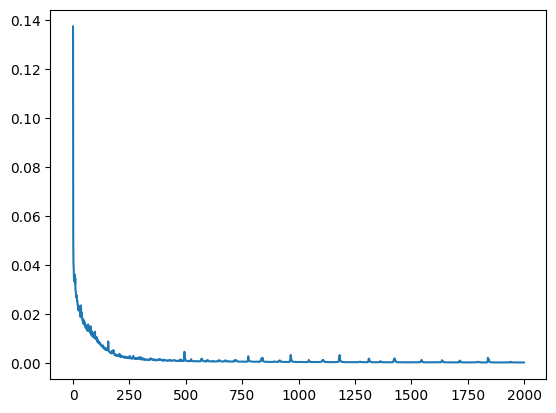

In [31]:
plt.plot(loss)
plt.show()

# Comparing a single image

In [32]:
h = Image.open("/kaggle/input/lol-dataset/lol_dataset/eval15/high/1.png")
h = h.resize((256, 256))
l = Image.open("/kaggle/input/lol-dataset/lol_dataset/eval15/low/1.png")
l = l.resize((256,256))
h = input_transform(h)
l = input_transform(l)

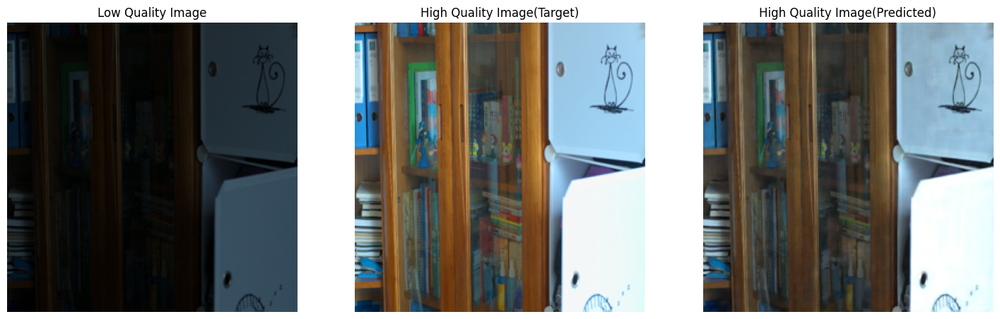

21.86241807309016
-0.06420559036991744


In [33]:
Model.eval()
i = l.unsqueeze(0)
i = i.to(device)
d = Model(i)
d = d.to("cpu")
d = d.squeeze()
d = d.detach().numpy()
d = np.transpose(d,(1,2,0))
l = np.transpose(l.numpy(),(1,2,0))
h = np.transpose(h.numpy(),(1,2,0))
dis_img_test(l*255, h*255, d*255,)
psnr =  calculate_psnr(d, h)
print(psnr)
psnr = calculate_psnr(l, h)
print(psnr)

# Uploading the model to huggingface

In [34]:
model = Model.to("cpu")

In [35]:
token = "hugging_face_token"
HfFolder.save_token(token)

In [36]:
api = HfApi()
repo_id = "vaibhavprajapati22/Image_Denoising_CBDNet"  
api.create_repo(repo_id=repo_id, repo_type="model", token=token, exist_ok=True)

RepoUrl('https://huggingface.co/vaibhavprajapati22/Image_Denoising_CBDNet', endpoint='https://huggingface.co', repo_type='model', repo_id='vaibhavprajapati22/Image_Denoising_CBDNet')

In [37]:
output_dir = "./Image_Denoising_CBDNet"
if not os.path.exists(output_dir):
    os.makedirs(output_dir)
torch.save(model.state_dict(), os.path.join(output_dir, "pytorch_model.bin"))

In [38]:
config = {
  "model": {
    "Noise_Estimation": {
      "conv1": {"in_channels": 3, "out_channels": 32, "kernel_size": [3, 3], "padding": "same"},
      "relu1": {},
      "conv2": {"in_channels": 32, "out_channels": 32, "kernel_size": [3, 3], "padding": "same"},
      "relu2": {},
      "conv3": {"in_channels": 32, "out_channels": 32, "kernel_size": [3, 3], "padding": "same"},
      "relu3": {},
      "conv4": {"in_channels": 32, "out_channels": 32, "kernel_size": [3, 3], "padding": "same"},
      "relu4": {},
      "conv5": {"in_channels": 32, "out_channels": 3, "kernel_size": [3, 3], "padding": "same"},
      "relu5": {}
    },
    "Denoising": {
      "conv1": {"in_channels": 6, "out_channels": 64, "kernel_size": [3, 3], "padding": "same"},
      "relu1": {},
      "conv2": {"in_channels": 64, "out_channels": 64, "kernel_size": [3, 3], "padding": "same"},
      "relu2": {},
      "pool1": {"kernel_size": [2, 2], "padding": 0},
      "conv3": {"in_channels": 64, "out_channels": 128, "kernel_size": [3, 3], "padding": "same"},
      "relu3": {},
      "conv4": {"in_channels": 128, "out_channels": 128, "kernel_size": [3, 3], "padding": "same"},
      "relu4": {},
      "conv5": {"in_channels": 128, "out_channels": 128, "kernel_size": [3, 3], "padding": "same"},
      "relu5": {},
      "pool2": {"kernel_size": [2, 2], "padding": 0},
      "conv6": {"in_channels": 128, "out_channels": 256, "kernel_size": [3, 3], "padding": "same"},
      "relu6": {},
      "conv7": {"in_channels": 256, "out_channels": 256, "kernel_size": [3, 3], "padding": "same"},
      "relu7": {},
      "conv8": {"in_channels": 256, "out_channels": 256, "kernel_size": [3, 3], "padding": "same"},
      "relu8": {},
      "conv9": {"in_channels": 256, "out_channels": 256, "kernel_size": [3, 3], "padding": "same"},
      "relu9": {},
      "conv10": {"in_channels": 256, "out_channels": 256, "kernel_size": [3, 3], "padding": "same"},
      "relu10": {},
      "conv11": {"in_channels": 256, "out_channels": 256, "kernel_size": [3, 3], "padding": "same"},
      "relu11": {},
      "convT1": {"in_channels": 256, "out_channels": 128, "kernel_size": [2, 2], "stride": 2},
      "reluT1": {},
      "conv12": {"in_channels": 128, "out_channels": 128, "kernel_size": [3, 3], "padding": "same"},
      "relu12": {},
      "conv13": {"in_channels": 128, "out_channels": 128, "kernel_size": [3, 3], "padding": "same"},
      "relu13": {},
      "conv14": {"in_channels": 128, "out_channels": 128, "kernel_size": [3, 3], "padding": "same"},
      "relu14": {},
      "convT2": {"in_channels": 128, "out_channels": 64, "kernel_size": [2, 2], "stride": 2},
      "reluT2": {},
      "conv15": {"in_channels": 64, "out_channels": 64, "kernel_size": [3, 3], "padding": "same"},
      "relu15": {},
      "conv16": {"in_channels": 64, "out_channels": 64, "kernel_size": [3, 3], "padding": "same"},
      "relu16": {},
      "conv17": {"in_channels": 64, "out_channels": 3, "kernel_size": [3, 3], "padding": "same"},
      "relu17": {}
    },
    "CBDNet": {
      "noise_estimation": "Noise_Estimation",
      "denoising": "Denoising"
    }
  }
}

with open(os.path.join(output_dir, "config.json"), 'w') as f:
    json.dump(config, f)

In [39]:
readme = """
---
language: en
tags:
- image-processing
- image-denoising
- deep-learning
license: apache-2.0
model_name: Image Denoising Model
---

# Convolutional Blind Denoising 

This Repo contains the weights and config of CBDNet Model.

# Datasets

- LOL Dataset
- Smartphone Image Denoising Dataset

# References
https://arxiv.org/pdf/1807.04686v2.pdf

"""
with open(os.path.join(output_dir, "README.md"), 'w') as f:
    f.write(readme)

In [40]:
api.upload_folder(
    folder_path=output_dir,
    repo_id=repo_id,
    repo_type="model",
    commit_message="Initial commit",
    token=token
)

print(f"Model successfully uploaded to https://huggingface.co/{repo_id}")

pytorch_model.bin:   0%|          | 0.00/17.5M [00:00<?, ?B/s]

Model successfully uploaded to https://huggingface.co/vaibhavprajapati22/Image_Denoising_CBDNet
